In [58]:
import glob,os,re,string
import pytz
import datetime
import pymongo
import re
import numpy as np
import pandas as pd
from datetime import timedelta
import json
from sklearn.metrics import accuracy_score, hamming_loss, precision_score, recall_score, f1_score, jaccard_score, confusion_matrix
import warnings
warnings.filterwarnings('ignore')

try:
    # password authentication to login to MongoDB
    client = pymongo.MongoClient(
        host='localhost',
        port=27017
    )
    # access Openup Database and authenticate
    db = client['OpenupDB']
    print(f'Collections: {db.list_collection_names()}')

except:
    print('Cannot access OpenUp database.')
    if client:
        client.close()
        
def conversation_extractor(start_time, end_time):
    d=timedelta(hours=8)
    cs = pd.DataFrame(list(db['Conversation'].find()))
    #valid_cs = cs[cs['pingpongCount']>=4].copy()
    
    cs['startDateTime'] = cs['startDateTime']+d
    cs['ongoingDateTime'] = cs['ongoingDateTime']+d
    
    cs['updatedTime'] = cs['updatedTime']+d
    cs['startQueueTime'] = cs['startQueueTime']+d
    cs['endQueueTime'] = cs['endQueueTime']+d
    cs['endDateTime'] = cs['endDateTime']+d
    
    cs1 = cs[(cs['startDateTime']>=pd.to_datetime(start_time))&(cs['startDateTime']<pd.to_datetime(end_time))]

    #cs1['user_id'] = cs1['chatParticipants'].apply(lambda x:x[0]['participantId'])
    #cs1['unique_ip'] = cs1['ipAddress'].fillna(cs1['user_id'])
    
    valid_cs1 = cs1[cs1['pingpongCount']>=4].copy()
    
    print('The count of total sessions from %s to %s: %s'%(str(start_time), str(end_time), len(cs1['uuid'].unique())))
    print('The count of valid sessions from %s to %s: %s'%(str(start_time), str(end_time), len(valid_cs1['uuid'].unique())))
    
    return cs1, valid_cs1

def history_extractor(conversationId_list):
    d=timedelta(hours=8)
    projectionFields = ['conversationId', 'datetime', 'message', 'source']  # 用字典指定
    his = pd.DataFrame(list(db['History'].find({'conversationId':{'$in':conversationId_list}, 'nature':{'$in':['REGULAR_MESSAGE']}}, projection = projectionFields)))
    #his = pd.DataFrame(list(db['History'].find({'conversationId':{'$in':conversationId_list}})))
    
    his['datetime'] = his['datetime']+d
    his['msg'] = his['message'].apply(lambda x:x['payload'])
    his['from_whom'] = his['source'].apply(lambda x:x['bHelpSeeker'])
    
    print('The count of chat messages: %s'%(len(his)))
    return his

Collections: ['RoleReport', 'EvaluationForm', 'ServiceHourReport', 'OauthToken', 'RiskLevelReport', 'Counsellor', 'ReferralCase', 'EvaluationQuestionSets', 'RiskassessmentQuestionSets', 'ConnectednessCare', 'AuditLog', 'ConversationNote', 'RiskAssessmentRecord', 'RiskassessmentQuestions', 'HighlightKeyword', 'ConnectednessCareReport', 'HelpSeekerDemographicsReport', 'RiskAssessmentTotalScores', 'EvaluationQuestions', 'HelpSeeker', 'masked_Conversation', 'BlacklistUser', 'SafetyPlan', 'History', 'masked_HelpSeeker', 'ConvList', 'DailyTimeStat', 'HelpSeekerMainConcernReport', 'Conversation', 'ChatReportByStartDate', 'masked_History', 'masked_ConversationNote', 'InterventionReport', 'ReferralCaseHistoryReport', 'masked_BlacklistUser']


In [623]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', 60)
pd.set_option('display.max_colwidth', 100)

In [4]:
db_name = input('Please input the database you want to get: ')

if db_name == 'Conversation':
    start_time = input('Please input the start time: ')
    end_time = input('Please input the end time: ')

    cs, valid_cs = conversation_extractor(start_time, end_time)
    conversationId_list = valid_cs['uuid'].unique().tolist()

    print(valid_cs.head())

The count of total sessions from 2021/11/10 00:00:00 to 2024/07/01 00:00:00: 222005
The count of valid sessions from 2021/11/10 00:00:00 to 2024/07/01 00:00:00: 78959
                         _id  alertFlag  block category  \
1   6442c0560f60de46ede96493      False   True            
4   644324070f60de46ed10824b      False   True            
8   6443bfe40f60de46ed4dcc5d      False   True            
9   6443e0800f60de46ed57f771      False   True            
10  6443e9230f60de46ed5aad95      False  False            

                                                                                       chatParticipants  \
1   [{'bHelpSeeker': True, 'lastMsgTime': 2023-04-21 16:56:53.954000, 'locale': 'zh_TW', 'mccisId': ...   
4   [{'bHelpSeeker': True, 'lastMsgTime': 2023-04-22 00:02:14.004000, 'locale': 'zh_TW', 'mccisId': ...   
8   [{'bHelpSeeker': True, 'lastMsgTime': 2023-04-22 11:07:16.309000, 'locale': 'zh_TW', 'mccisId': ...   
9   [{'bHelpSeeker': True, 'ipAddress': '113.252.1

In [5]:
cs.shape

(222005, 49)

In [6]:
5809/18284

0.31770947276307154

In [7]:
valid_cs.shape

(78959, 49)

In [8]:
# extract MCCISID and platform
cs['MCCISID'] = [i[0]['mccisId'] if i and i[0].get('mccisId') else '' for i in cs['chatParticipants']]
cs['platform'] = [i[0]['platform'] if i and i[0].get('platform') else '' for i in cs['chatParticipants']]

valid_cs['MCCISID'] = [i[0]['mccisId']  for i in valid_cs['chatParticipants']]
valid_cs['platform'] = [i[0]['platform'] if i and i[0].get('platform') else '' for i in valid_cs['chatParticipants']]

In [9]:
# select the 1st chat of each user
cs_old2new = valid_cs.sort_values(by='startDateTime', ascending=True)

## select chats from web & chats from non-web channels
cs_old2new_web = cs_old2new[(cs_old2new['platform']=='FIREBASE')]
cs_old2new_nonweb = cs_old2new[(cs_old2new['platform']!='FIREBASE')]

## if from web, select the oldest chat based on ip address; if from non-web, select the oldest chat based on MCCISID
cs_web_unique = cs_old2new_web.drop_duplicates(subset = ['ipAddress'], keep = 'first')
cs_nonweb_unique = cs_old2new_nonweb.drop_duplicates(subset = ['MCCISID'], keep = 'first')

## concat the two groups of first-time visit sessions
cs_unique = pd.concat([cs_web_unique, cs_nonweb_unique], axis=0)

print("There are %s valid unique first-time visit sessions from 2022/07/01 to 2024-07-01."%(cs_unique.shape[0]))

There are 32063 valid unique first-time visit sessions from 2022/07/01 to 2024-07-01.


In [10]:
cs_unique['language'] = [i[0]['locale']  for i in cs_unique['chatParticipants']]
cs_unique['language'].value_counts()

zh_TW    31116
en         713
zh_CN      234
Name: language, dtype: int64

In [11]:
cs_uni_canto = cs_unique[(cs_unique['language']=='zh_TW')]
cs_uni_canto.shape

(31116, 52)

chat_history = history_extractor(cs['uuid'].unique().tolist())

In [12]:
chat_history_canto = history_extractor(cs_uni_canto['uuid'].unique().tolist())

The count of chat messages: 2879640


In [13]:
def prechat_inchat_extractor_stage1(chat_history):
    chat_history['ask_age'] = chat_history['msg'].str.contains('請問您的年齡是')
    chat_history['ask_loc'] = chat_history['msg'].str.contains('請問您所居住的地區是')
    chat_history['humanchat_msg1'] = chat_history['msg'].str.contains('Open噏輔導員將會盡快與您對話|Open噏正為您安排輔導員進行對話|再次感謝您的回答，Open噏輔導員將會盡快與您對話')
    chat_history['humanchat_msg2'] = chat_history['msg'].str.contains('請問還在線嗎')
    chat_history['humanchat_msg3'] = chat_history['msg'].str.contains('歡迎有需要時再使用Open噏與我們的輔導員對話')
    chat_history['humanchat_msg4'] = chat_history['msg'].str.contains('感謝您提供的資訊')
    chat_history['humanchat_msg5'] = chat_history['msg'].str.contains('現時Open噏線路極為繁忙')
    chat_history['humanchat_msg6'] = chat_history['msg'].str.contains('似乎你都係想同我哋嘅輔導員直接傾|因為仲有人排緊隊，麻煩你耐心等候|輔導員很快會跟進你的個案')
    chat_history['humanchat_msg7'] = chat_history['msg'].str.contains('所以麻煩你稍稍等候，我哋會儘快安排一位輔導員俾你')
    chat_history['humanchat_msg8'] = chat_history['msg'].str.contains('感謝您的回答，雖然Open噏是一個專為11-35歲年青人服務的平台，但我們依然關心您的情況，輔導員將會盡快與你對話，請稍侯...')
    # 多謝你嘅回覆。我哋會好快為你安排一位輔導員。
    
    # get the last message of the human chatbot
    human_chatbot = chat_history[(chat_history['ask_age'] == True)|(chat_history['ask_loc'] == True)|\
                                (chat_history['humanchat_msg1'] == True)|(chat_history['humanchat_msg2'] == True)|\
                                (chat_history['humanchat_msg3'] == True)|(chat_history['humanchat_msg4'] == True)|\
                                (chat_history['humanchat_msg5'] == True)|(chat_history['humanchat_msg6'] == True)|\
                                (chat_history['humanchat_msg7'] == True)|(chat_history['humanchat_msg8'] == True)].copy()

    
    human_chatbot = human_chatbot.sort_values(by=['conversationId','datetime'])
    human_chatbot = human_chatbot.drop_duplicates(subset=['conversationId'],keep='last')
    human_chatbot_subset = human_chatbot[['conversationId','datetime']].copy()
    
    ## define the last message in the human chatbot as the new ongoingdatetime
    human_chatbot_subset = human_chatbot_subset.rename(columns={'datetime':'last_humanChatbot_message_datetime_v1'})
    
    chat_history_human_chatbot = chat_history.join(human_chatbot_subset.set_index('conversationId'),
                                                   on='conversationId',how='left')
    
    in_chat = chat_history_human_chatbot[chat_history_human_chatbot['datetime']>chat_history_human_chatbot['last_humanChatbot_message_datetime_v1']].copy()
    pre_chat = chat_history_human_chatbot[chat_history_human_chatbot['datetime']<=chat_history_human_chatbot['last_humanChatbot_message_datetime_v1']].copy()
    
    return in_chat, pre_chat

def prechat_inchat_extractor_stage2(in_chat):
    # between pre-chat and in-chat, there are some grey zones
    in_chat = in_chat.assign(msg_rank=in_chat.groupby('conversationId')['datetime'].rank(ascending=True))
    in_chat['humanchat_msg9'] = in_chat['msg'].str.contains('香港青少年服務處') & in_chat['msg'].str.contains('一微') & in_chat['msg'].str.contains('網上青年支援隊') & in_chat['msg'].str.contains('#esmileyhk') & in_chat['msg_rank'].isin([0,1,2,3,4])
    in_chat['humanchat_msg10'] = in_chat['msg'].str.contains('聖雅各福群會 - 6PM 網上青年支援隊') & in_chat['msg'].str.contains('星期一') & in_chat['msg'].str.contains('星期二') & in_chat['msg'].str.contains('星期日及公眾假期休息') & in_chat['msg_rank'].isin([0,1,2,3,4])
    in_chat['humanchat_msg11'] = in_chat['msg'].str.contains('香港青年協會– uTouch #utouch.hk') & in_chat['msg_rank'].isin([0,1,2,3,4])
    in_chat['humanchat_msg12'] = in_chat['msg'].str.contains('香港明愛-連線Teen地 Infinity Teens #caritasinfinityteens') & in_chat['msg_rank'].isin([0,1,2,3,4])
    in_chat['humanchat_msg13'] = in_chat['msg'].str.contains('聖雅各福群會 - 第六點Six Degree Hubs # SJSSDH') & in_chat['msg_rank'].isin([0,1,2,3,4])
    in_chat['humanchat_msg14'] = in_chat['msg'].str.contains('香港小童群益會 – 夜貓ONLINE #nitecatonline') & in_chat['msg_rank'].isin([0,1,2,3,4])
    in_chat['humanchat_msg15'] = in_chat['msg'].str.contains('請問你過去半年有否接受其他青少年服務？') & in_chat['msg'].str.contains('Levelmind平行心間') & in_chat['msg'].str.contains('網上青年支援隊') & in_chat['msg'].str.contains('學校社工') & in_chat['msg_rank'].isin([0,1,2,3,4])

    # get the last message of the human chatbot
    human_chatbot = in_chat[(in_chat['humanchat_msg9'] == True)|(in_chat['humanchat_msg10'] == True)|\
                                (in_chat['humanchat_msg11'] == True)|(in_chat['humanchat_msg12'] == True)|\
                                (in_chat['humanchat_msg13'] == True)|(in_chat['humanchat_msg14'] == True)|\
                                (in_chat['humanchat_msg15'] == True)].copy()
    human_chatbot = human_chatbot.sort_values(by=['conversationId','datetime'])
    human_chatbot = human_chatbot.drop_duplicates(subset=['conversationId'],keep='last')
    human_chatbot_subset = human_chatbot[['conversationId','datetime']].copy()
    
    # define the last message in the human chatbot as the new ongoingdatetime
    human_chatbot_subset = human_chatbot_subset.rename(columns={'datetime':'last_humanChatbot_message_datetime_v2'})
    
    in_chat_human_chatbot = in_chat.join(human_chatbot_subset.set_index('conversationId'),
                                                   on='conversationId',how='left')
    in_chat_human_chatbot['last_humanChatbot_message_datetime'] = in_chat_human_chatbot['last_humanChatbot_message_datetime_v2'].fillna(in_chat_human_chatbot['last_humanChatbot_message_datetime_v1'])
    
    in_chat = in_chat_human_chatbot[in_chat_human_chatbot['datetime']>in_chat_human_chatbot['last_humanChatbot_message_datetime']].copy()

    return in_chat
    
def prechat_inchat_extractor_stage3(chat_history, in_chat, cs_meta):
    # first_counselor_message after human_chatbot
    hcfcm = in_chat[in_chat['from_whom']==False].copy()
    hcfcm = hcfcm.sort_values(by=['conversationId','datetime'])
    hcfcmt = hcfcm.drop_duplicates(subset=['conversationId'],keep='first')
    hcfcmt = hcfcmt[['datetime','conversationId']].copy()
    hcfcmt = hcfcmt.rename(columns={'datetime':'1st_counselor_message_after_humanChatbot_datetime'})
    
    chat_history_case_final = hcfcmt.join(cs_meta[['uuid','ongoingDateTime','endDateTime']].set_index('uuid'), on='conversationId', how='right')
    
    # fill in final start time with the conversations that have no human chatbot
    chat_history_case_final['new_inChat_startTime'] = chat_history_case_final['1st_counselor_message_after_humanChatbot_datetime'].fillna(chat_history_case_final['ongoingDateTime'])
    
    chat_history_final = chat_history.join(
                                            chat_history_case_final[['new_inChat_startTime','endDateTime','conversationId']].set_index('conversationId'),
                                            on='conversationId', how='left')
    # clean data
    in_chat_clean = chat_history_final[chat_history_final['datetime'] >= chat_history_final['new_inChat_startTime']].copy()
    pre_chat_clean = chat_history_final[chat_history_final['datetime'] < chat_history_final['new_inChat_startTime']].copy()
    
    in_chat_clean = in_chat_clean.sort_values(by=['conversationId', 'datetime'], ascending = True)
    pre_chat_clean = pre_chat_clean.sort_values(by=['conversationId', 'datetime'], ascending = True)
    
    return in_chat_clean, pre_chat_clean

def new_pingpong(chat):
    chat['from_whom_shift'] = chat.groupby('conversationId')['from_whom'].transform(lambda x:x.shift(1))
    chat['from_whom_shift'] = chat.groupby('conversationId')['from_whom_shift'].transform(lambda x:x.bfill())
    chat['inc'] = np.where((chat['from_whom'] != chat['from_whom_shift']), 'inc', 'no_inc')
    
    chat = chat.join((chat[chat['inc']=='inc'].groupby('conversationId').cumcount()+1).to_frame())
    chat.rename(columns={0: 'pp'}, inplace=True)
    chat['pp'] = chat.groupby('conversationId')['pp'].transform(lambda x: x.ffill())
    max_pp =chat.groupby('conversationId')['pp'].max().reset_index()
    in_chat_final = chat.join(max_pp.rename(columns={'pp':'max_pp'}).set_index('conversationId'),on='conversationId')
    in_chat_final['max_pp'] = in_chat_final['max_pp'].fillna(0)
    in_chat_final['max_pp'] = (in_chat_final['max_pp']//2).astype(int)
    
    in_chat_final = in_chat_final.sort_values(by=['conversationId', 'datetime'], ascending = True)
    
    return in_chat_final

In [14]:
in_chat, pre_chat = prechat_inchat_extractor_stage1(chat_history_canto)

in_chat = prechat_inchat_extractor_stage2(in_chat)

# remember to set 'cs_meta' as 'cs' for all chat history / set 'cs_meta' as 'valid_cs' for all valid chat history
in_chat_clean, pre_chat_clean = prechat_inchat_extractor_stage3(chat_history_canto, in_chat, cs_uni_canto)

In [15]:
in_chat_clean.columns

Index(['_id', 'conversationId', 'datetime', 'message', 'source', 'msg',
       'from_whom', 'ask_age', 'ask_loc', 'humanchat_msg1', 'humanchat_msg2',
       'humanchat_msg3', 'humanchat_msg4', 'humanchat_msg5', 'humanchat_msg6',
       'humanchat_msg7', 'humanchat_msg8', 'new_inChat_startTime',
       'endDateTime'],
      dtype='object')

In [16]:
in_chat_cleann = in_chat_clean[['conversationId', 'datetime', 'msg', 'from_whom', 'new_inChat_startTime', 'endDateTime']].copy()

# Prechat questions

In [17]:
Q0 = '同您傾計之前，為咗了解您多啲，我哋邀請您用1分鐘時間回答8條選擇題。您嘅答案唔會構成診斷，亦唔會影響排隊順序。如果願意的話請回覆1，如果不願意的的話回覆2繼續等候。|\
跟您聊天之前，为了多一点了解您，我们邀请您用1分钟的时间回答8条选择题。您的答案不构成诊断，也不会影响排队顺序。如果愿意的话请回复1，如果不愿意的话回复2继续等候。|\
Before we start, we invite you to answer 8 multiple choice questions on how you have been feeling. The questions shouldn’t take you more than a minute to answer. Your answers will not affect your position in the queue nor constitute a diagnosis. If you are willing to answer the questions, please press 1, otherwise please press 2.'

In [18]:
first_question = '今次上來OpenUp，係什麼問題最困擾您|这次来OpenUp，最困扰您的是什么问题|What concerns you most? Please enter the number'

In [19]:
last_question = '最近兩個星期，您是否有過傷害自己或自殺的想法|最近两个星期， 您是否有过伤害自己或自杀的想法|In the past two weeks, have you had thoughts about hurting'

In [20]:
pre_chat_clean['Q0']= pre_chat_clean['msg'].str.contains(Q0)

In [21]:
pre_chat_clean['Q0'].value_counts()

False    654075
True      30324
Name: Q0, dtype: int64

In [22]:
pre_chat_clean['Q1'] = pre_chat_clean['msg'].str.contains(first_question)

In [23]:
pre_chat_clean['Q1'].value_counts()

False    664271
True      20128
Name: Q1, dtype: int64

In [24]:
pre_chat_clean['Qlast1'] = pre_chat_clean['msg'].str.contains(last_question)

In [25]:
pre_chat_clean['Qlast1'].value_counts()

False    664744
True      19655
Name: Qlast1, dtype: int64

In [26]:
q1_time = pre_chat_clean[(pre_chat_clean['Q1']==True) & (pre_chat_clean['from_whom']==False)].drop_duplicates(subset=['conversationId'],keep='last')[['conversationId','datetime']].copy()
qlast1_time = pre_chat_clean[(pre_chat_clean['Qlast1']==True) & (pre_chat_clean['from_whom']==False)].drop_duplicates(subset=['conversationId'],keep='last')[['conversationId','datetime']].copy()

In [27]:
pre_chat_join = pre_chat_clean.join(q1_time.rename(columns={'datetime':'q1_time'}).set_index('conversationId'),
                                        on='conversationId',how='left')

pre_chat_join = pre_chat_join.join(
    qlast1_time.rename(columns={'datetime':'qlast1_time'}).set_index('conversationId'),on='conversationId',how='left')

In [28]:
pre_chat_filled = pre_chat_join[(pre_chat_join['q1_time'].notna()) & (pre_chat_join['datetime']>=(pre_chat_join['q1_time']))].copy()
pre_chat_filled

,_id,conversationId,datetime,message,source,msg,from_whom,ask_age,ask_loc,humanchat_msg1,humanchat_msg2,humanchat_msg3,humanchat_msg4,humanchat_msg5,humanchat_msg6,humanchat_msg7,humanchat_msg8,new_inChat_startTime,endDateTime,Q0,Q1,Qlast1,q1_time,qlast1_time
1624782,63b6c313dda339503c909c53,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:31:15.772,{'metadata': '1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等;2. 家庭關係，例如父子關係;3. 親密關係，例如男女朋友;4. 朋輩關係，同事關係，或其他人際關係...,"{'bHelpSeeker': False, 'participantId': 'UNKNOWN', 'platform': 'CHATBOT'}",今次上來OpenUp，係什麼問題最困擾您？請輸入最符合嘅選項數字。\n1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等\n2. 家庭關係，例如父子關係\n3. 親密關係，例如男女朋...,False,False,False,False,False,False,False,False,False,False,False,2023-01-05 20:38:59.914,2023-01-05 21:12:57.565,False,True,False,2023-01-05 20:31:15.772,2023-01-05 20:33:15.278
1624783,63b6c348dda339503c90b21a,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:32:08.775,"{'payload': '1', 'type': 'TEXT'}","{'bHelpSeeker': True, 'participantId': '63b6c2ebff729f1c901b3724', 'platform': 'FIREBASE', 'syst...",1,True,False,False,False,False,False,False,False,False,False,False,2023-01-05 20:38:59.914,2023-01-05 21:12:57.565,False,False,False,2023-01-05 20:31:15.772,2023-01-05 20:33:15.278
1624784,63b6c349dda339503c90b245,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:32:09.004,"{'metadata': '1. 完全沒有;2. 很少時候;3. 有些時候;4. 大部分時候;5. 全部時候', 'payload': '過去30天內，您有多少時候覺得緊張？請輸入最符...","{'bHelpSeeker': False, 'participantId': 'UNKNOWN', 'platform': 'CHATBOT'}",過去30天內，您有多少時候覺得緊張？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,False,False,False,False,False,False,False,False,False,False,False,2023-01-05 20:38:59.914,2023-01-05 21:12:57.565,False,False,False,2023-01-05 20:31:15.772,2023-01-05 20:33:15.278
1624785,63b6c350dda339503c90b62a,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:32:16.831,"{'payload': '4', 'type': 'TEXT'}","{'bHelpSeeker': True, 'participantId': '63b6c2ebff729f1c901b3724', 'platform': 'FIREBASE', 'syst...",4,True,False,False,False,False,False,False,False,False,False,False,2023-01-05 20:38:59.914,2023-01-05 21:12:57.565,False,False,False,2023-01-05 20:31:15.772,2023-01-05 20:33:15.278
1624786,63b6c351dda339503c90b67b,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:32:17.071,"{'metadata': '1. 完全沒有;2. 很少時候;3. 有些時候;4. 大部分時候;5. 全部時候', 'payload': '過去30天內，您有多少時候覺得完全沒有希望？請...","{'bHelpSeeker': False, 'participantId': 'UNKNOWN', 'platform': 'CHATBOT'}",過去30天內，您有多少時候覺得完全沒有希望？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,False,False,False,False,False,False,False,False,False,False,False,2023-01-05 20:38:59.914,2023-01-05 21:12:57.565,False,False,False,2023-01-05 20:31:15.772,2023-01-05 20:33:15.278
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
623461,620d92ed00ce4ff0227597c5,fffb559d-ec5d-4308-b4e3-a756eaef9a7f,2022-02-17 08:12:29.254,"{'metadata': '1. 完全沒有;2. 很少時候;3. 有些時候;4. 大部分時候;5. 全部時候', 'payload': '過去30天內，您有多少時候覺得自己沒有用？請輸...","{'bHelpSeeker': False, 'participantId': 'UNKNOWN', 'platform': 'CHATBOT'}",過去30天內，您有多少時候覺得自己沒有用？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,False,False,False,False,False,False,False,False,False,False,False,2022-02-17 08:13:07.378,2022-02-17 08:28:45.269,False,False,False,2022-02-17 08:11:51.497,2022-02-17 08:12:33.242
623462,620d92f100ce4ff0227598cd,fffb559d-ec5d-4308-b4e3-a756eaef9a7f,2022-02-17 08:12:32.990,"{'payload': '5', 'type': 'TEXT'}","{'bHelpSeeker': True, 'participantId': '620d92b6ff729f204c7a19ea', 'platform': 'FIREBASE', 'syst...",5,True,False,False,False,False,False,False,False,False,False,False,2022-02-17 08:13:07.378,2022-02-17 08:28:45.269,False,False,False,2022-02-17 08:11:51.497,2022-02-17 08:12:33.242
623463,620d92f100ce4ff022759901,fffb559d-ec5d-4308-b4e3-a756eaef9a7f,2022-02-17 08:12:33.242,"{'metadata': '1. 有;2. 沒有', 'payload': '最近兩個星期，您是否有過傷害自己或自殺的想法？如果有請回覆1，如果沒有請回覆2。您的答覆不會改變排隊順序，如需緊急...","{'bHelpSeeker': False, 'participantId': 'UNKNOWN', 'platform': 'CHATBOT'}",最近兩個星期，您是

# question and answer matching

In [29]:
replace_tag = {#'請輸入數字 1 至 14':'今次上來OpenUp，係什麼問題最困擾您？請輸入最符合嘅選項數字。\n1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等\n2.  家庭關係，例如父子關係\n3.  親密關係，例如男女朋友\n4.  朋輩關係，同事關係，或其他人際關係\n5.  學業/升學，例如公開考試等\n6.  事業，例如工作壓力，職業前景，失業等\n7.  負面生活經歷，例如被欺凌，虐待，債務問題，性侵等\n8.  生理健康問题，例如身型，皮膚，身體疾病等\n9.  個人成長，例如性格發展，自我認知，適應接納等\n10.  性傾向/性別困擾\n11.  成癮行為， 例如物質濫用，賭博，購物成癮等\n12.  社會事件\n13.  新冠肺炎\n14.  其他',
              '这次来OpenUp，最困扰您的是什么问题？请输入最符合的选项数字。\n1. 精神健康，例如情绪问题，精神疾病，自我伤害，自杀等\n2.  家庭关系，例如父子关系\n3.  亲密关系，例如男女朋友\n4.  朋辈关系，同事关系，或其他人际关系\n5.  学业/升学，例如公开考试等\n6.  事业，例如工作压力，职业前景，失业等\n7.  负面生活经历，例如被欺凌，虐待，债务问题，性侵等\n8.  生理健康问题，例如身形，皮肤，身体疾病等\n9.  个人成长，例如性格发展，自我认知，适应接纳等\n10.  性倾向/性别困扰\n11.  成瘾行为，例如物质滥用，赌博，购物成瘾等\n12.  社会事件\n13.  新冠肺炎\n14.  其他':'今次上來OpenUp，係什麼問題最困擾您？請輸入最符合嘅選項數字。\n1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等\n2.  家庭關係，例如父子關係\n3.  親密關係，例如男女朋友\n4.  朋輩關係，同事關係，或其他人際關係\n5.  學業/升學，例如公開考試等\n6.  事業，例如工作壓力，職業前景，失業等\n7.  負面生活經歷，例如被欺凌，虐待，債務問題，性侵等\n8.  生理健康問题，例如身型，皮膚，身體疾病等\n9.  個人成長，例如性格發展，自我認知，適應接納等\n10.  性傾向/性別困擾\n11.  成癮行為， 例如物質濫用，賭博，購物成癮等\n12.  社會事件\n13.  新冠肺炎\n14.  其他',
              #'请输入数字 1 至 14':'今次上來OpenUp，係什麼問題最困擾您？請輸入最符合嘅選項數字。\n1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等\n2.  家庭關係，例如父子關係\n3.  親密關係，例如男女朋友\n4.  朋輩關係，同事關係，或其他人際關係\n5.  學業/升學，例如公開考試等\n6.  事業，例如工作壓力，職業前景，失業等\n7.  負面生活經歷，例如被欺凌，虐待，債務問題，性侵等\n8.  生理健康問题，例如身型，皮膚，身體疾病等\n9.  個人成長，例如性格發展，自我認知，適應接納等\n10.  性傾向/性別困擾\n11.  成癮行為， 例如物質濫用，賭博，購物成癮等\n12.  社會事件\n13.  新冠肺炎\n14.  其他',
              '过去30天内，您有多少时候觉得烦躁或不安？请输入最符合的选项数字。\n1. 完全没有\n2.  很少时候\n3.  有些时候\n4.  大部分时候\n5.  全部时候':'過去30天內，您有多少時候覺得煩躁或不安？請輸入最符合嘅選項數字。\r\n\n1. 完全沒有\n2.  很少時候\n3.  有些時候\n4.  大部分時候\n5.  全部時候',
              '过去30天内，您有多少时候觉得自己没有用？请输入最符合的选项数字。\n1. 完全没有\n2.  很少时候\n3.  有些时候\n4.  大部分时候\n5.  全部时候':'過去30天內，您有多少時候覺得自己沒有用？請輸入最符合嘅選項數字。\n1. 完全沒有\n2.  很少時候\n3.  有些時候\n4.  大部分時候\n5.  全部時候',
              '过去30天内，您有多少时候觉得做什么事也感到吃力？请输入最符合的选项数字。\n1. 完全没有\n2.  很少时候\n3.  有些时候\n4.  大部分时候\n5.  全部时候':'過去30天內，您有多少時候覺得做什麼事也感到吃力？請輸入最符合嘅選項數字。\n1. 完全沒有\n2.  很少時候\n3.  有些時候\n4.  大部分時候\n5.  全部時候',
              '过去30天内，您有多少时候觉得情绪低落至没有东西令你开心？请输入最符合的选项数字。\n1. 完全没有\n2.  很少时候\n3.  有些时候\n4.  大部分时候\n5.  全部时候':'過去30天內，您有多少時候覺得情緒低落至沒有東西令你開心？請輸入最符合嘅選項數字。\n1. 完全沒有\n2.  很少時候\n3.  有些時候\n4.  大部分時候\n5.  全部時候',
              '过去30天内，您有多少时候觉得完全没有希望？请输入最符合的选项数字。\n1. 完全没有\n2.  很少时候\n3.  有些时候\n4.  大部分时候\n5.  全部时候':'過去30天內，您有多少時候覺得完全沒有希望？請輸入最符合嘅選項數字。\n1. 完全沒有\n2.  很少時候\n3.  有些時候\n4.  大部分時候\n5.  全部時候',
              '过去30天内，您有多少时候觉得紧张？请输入最符合的选项数字。\n1. 完全没有\n2.  很少时候\n3.  有些时候\n4.  大部分时候\n5.  全部时候':'過去30天內，您有多少時候覺得緊張？請輸入最符合嘅選項數字。\n1. 完全沒有\n2.  很少時候\n3.  有些時候\n4.  大部分時候\n5.  全部時候',
              '最近两个星期，您是否有过伤害自己或自杀的想法？如果有请回复1，如果没有请回复2。您的答复不会改变排队顺序，如需紧急协助，请拨打[***phone***]报警电话求助。\n1. 有\n2. 没有':'最近兩個星期，您是否有過傷害自己或自殺的想法？如果有請回覆1，如果沒有請回覆2。您的答覆不會改變排隊順序，如需緊急協助，請撥打[***phone***]報警電話求助。 \n1. 有\n2. 沒有',
              '最近兩個星期，您是否有過傷害自己或自殺的想法？如果有請回覆1，如果沒有請回覆2。您的答覆不會改變排隊順序，如需緊急協助，請撥打999報警電話求助。 \n1. 有\n2. 沒有':'最近兩個星期，您是否有過傷害自己或自殺的想法？如果有請回覆1，如果沒有請回覆2。您的答覆不會改變排隊順序，如需緊急協助，請撥打[***phone***]報警電話求助。 \n1. 有\n2. 沒有',
              '今次上來OpenUp，係什麼問題最困擾您？請輸入最符合嘅選項數字。\n1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等\n2.  家庭關係，例如父子關係\n3.  親密關係，例如男女朋友\n4.  朋輩關係，同事關係，或其他人際關係\n5.  學業/升學，例如公開考試等\n6.  事業，例如工作壓力，職業前景，失業等\n7.  負面生活經歷，例如被欺凌，虐待，債務問題，性侵等\n8.  生理健康問题，例如身型，皮膚，身體疾病等\n9.  個人成長，例如性格發展，自我認知，適應接納等\n[***name***].  性傾向/性別困擾\n11.  成癮行為， 例如物質濫用，賭博，購物成癮等\n12.  社會事件\n13.  新冠肺炎\n14.  其他':'今次上來OpenUp，係什麼問題最困擾您？請輸入最符合嘅選項數字。\n1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等\n2.  家庭關係，例如父子關係\n3.  親密關係，例如男女朋友\n4.  朋輩關係，同事關係，或其他人際關係\n5.  學業/升學，例如公開考試等\n6.  事業，例如工作壓力，職業前景，失業等\n7.  負面生活經歷，例如被欺凌，虐待，債務問題，性侵等\n8.  生理健康問题，例如身型，皮膚，身體疾病等\n9.  個人成長，例如性格發展，自我認知，適應接納等\n10.  性傾向/性別困擾\n11.  成癮行為， 例如物質濫用，賭博，購物成癮等\n12.  社會事件\n13.  新冠肺炎\n14.  其他',
              'What concerns you most? Please enter the number that best represents your concern.  \n1. Mental health: e.g. emotional problems\n diagnosed mental disorders\n self-harm\n suicide\n2.   Family relationship: e.g. parent-child relationship\n3.   Intimate relationship: e.g. romantic partnership\n4.  Interpersonal relationship: e.g. relationship with friends and colleagues\n5.  Study: e.g. public exams\n6.  Career: e.g. work stress\n career prospects\n unemployment\n7.  Traumatic experience: e.g. being bullied\n abused\n sexually abused\n debt problems\n8.   Physical health: e.g. body shape\n skin condition\n diseases\n9.  Personal development: e.g. personality development\n self-awareness\n adaptation and acceptance\n10.   Sexual orientation/gender distress\n11.  Addictive behavior: e.g. drug abuse\n gambling\n shopping addiction\n12.  Social incidents\n13.  COVID-19\n14.  Others ':'今次上來OpenUp，係什麼問題最困擾您？請輸入最符合嘅選項數字。\n1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等\n2.  家庭關係，例如父子關係\n3.  親密關係，例如男女朋友\n4.  朋輩關係，同事關係，或其他人際關係\n5.  學業/升學，例如公開考試等\n6.  事業，例如工作壓力，職業前景，失業等\n7.  負面生活經歷，例如被欺凌，虐待，債務問題，性侵等\n8.  生理健康問题，例如身型，皮膚，身體疾病等\n9.  個人成長，例如性格發展，自我認知，適應接納等\n10.  性傾向/性別困擾\n11.  成癮行為， 例如物質濫用，賭博，購物成癮等\n12.  社會事件\n13.  新冠肺炎\n14.  其他',
              'During the past 30 days, how often did you feel restless or fidgety? Please press the number of your choice.  \n1. None of the time\n2.  A little of the time\n3.  Some of the time\n4.   Most of the time\n5.  All of the time':'過去30天內，您有多少時候覺得煩躁或不安？請輸入最符合嘅選項數字。\r\n\n1. 完全沒有\n2.  很少時候\n3.  有些時候\n4.  大部分時候\n5.  全部時候',
              'During the past 30 days, how often did you feel hopeless? Please press the number of your choice.  \n1. None of the time\n2.  A little of the time\n3.  Some of the time\n4.   Most of the time\n5.  All of the time':'過去30天內，您有多少時候覺得完全沒有希望？請輸入最符合嘅選項數字。\n1. 完全沒有\n2.  很少時候\n3.  有些時候\n4.  大部分時候\n5.  全部時候',
              'During the past 30 days, how often did you feel nervous? Please press the number of your choice.  \n1. None of the time\n2.  A little of the time\n3.  Some of the time\n4.   Most of the time\n5.  All of the time':'過去30天內，您有多少時候覺得緊張？請輸入最符合嘅選項數字。\n1. 完全沒有\n2.  很少時候\n3.  有些時候\n4.  大部分時候\n5.  全部時候',
              'During the past 30 days, how often did you feel so depressed that nothing could cheer you up? Please press the number of your choice.\n1. None of the time\n2.  A little of the time\n3.  Some of the time\n4.   Most of the time\n5.  All of the time':'過去30天內，您有多少時候覺得情緒低落至沒有東西令你開心？請輸入最符合嘅選項數字。\n1. 完全沒有\n2.  很少時候\n3.  有些時候\n4.  大部分時候\n5.  全部時候',
              'During the past 30 days, how often did you feel worthless? Please press the number of your choice.  \n1. None of the time\n2.  A little of the time\n3.  Some of the time\n4.   Most of the time\n5.  All of the time':'過去30天內，您有多少時候覺得自己沒有用？請輸入最符合嘅選項數字。\n1. 完全沒有\n2.  很少時候\n3.  有些時候\n4.  大部分時候\n5.  全部時候',
              'During the past 30 days, how often did you feel that everything was an effort? Please press the number of your choice.  \n1. None of the time\n2.  A little of the time\n3.  Some of the time\n4.   Most of the time\n5.  All of the time':'過去30天內，您有多少時候覺得做什麼事也感到吃力？請輸入最符合嘅選項數字。\n1. 完全沒有\n2.  很少時候\n3.  有些時候\n4.  大部分時候\n5.  全部時候',
               'In the past two weeks, have you had thoughts about hurting or killing yourself? Press 1 if you have had these thoughts, press 2 if you haven’t had these thoughts. Your answer will not affect your position in the queue. If you need emergency service, please dial 999 for help. \n1. Yes\n2. No':'最近兩個星期，您是否有過傷害自己或自殺的想法？如果有請回覆1，如果沒有請回覆2。您的答覆不會改變排隊順序，如需緊急協助，請撥打[***phone***]報警電話求助。 \n1. 有\n2. 沒有',
               
                '最近兩個星期，您是否有過傷害自己或自殺的想法？[***name***]有請回覆1，[***name***]沒有請回覆2。您的答覆不會改變排隊順序，如需緊急協助，請撥打[***phone***]報警電話求助。 \n1. 有\n2. 沒有':'最近兩個星期，您是否有過傷害自己或自殺的想法？如果有請回覆1，如果沒有請回覆2。您的答覆不會改變排隊順序，如需緊急協助，請撥打[***phone***]報警電話求助。 \n1. 有\n2. 沒有'
               
        }
    

In [30]:
# transfer questions to standard format
pre_chat_filled['msg_replace'] = pre_chat_filled['msg'].replace(replace_tag)

In [31]:
# get each message's following 1,2,3,4,5 message in its row
pre_chat_filled['msg_shift'] = pre_chat_filled.groupby('conversationId')['msg_replace'].transform(lambda x:x.shift(-1))
pre_chat_filled['msg_shift2'] = pre_chat_filled.groupby('conversationId')['msg_replace'].transform(lambda x:x.shift(-2))
pre_chat_filled['msg_shift3'] = pre_chat_filled.groupby('conversationId')['msg_replace'].transform(lambda x:x.shift(-3))
pre_chat_filled['msg_shift4'] = pre_chat_filled.groupby('conversationId')['msg_replace'].transform(lambda x:x.shift(-4))
pre_chat_filled['msg_shift5'] = pre_chat_filled.groupby('conversationId')['msg_replace'].transform(lambda x:x.shift(-5))

In [32]:
# remove each message whose next message is empty
pre_chat_notna = pre_chat_filled[(pre_chat_filled['msg_shift'].notna())].copy()

In [33]:
# get standard formatted questions
from collections import Counter
clean_question_list = list(Counter(replace_tag.values()))
# + ['請輸入數字 1 至 14', '请输入数字 1 至 14', '請輸入數字 1 至 5',  '请输入数字 1 至 5', '請輸入數字 1 或 2', '请输入数字 1 或 2']
clean_question_list

['今次上來OpenUp，係什麼問題最困擾您？請輸入最符合嘅選項數字。\n1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等\n2.  家庭關係，例如父子關係\n3.  親密關係，例如男女朋友\n4.  朋輩關係，同事關係，或其他人際關係\n5.  學業/升學，例如公開考試等\n6.  事業，例如工作壓力，職業前景，失業等\n7.  負面生活經歷，例如被欺凌，虐待，債務問題，性侵等\n8.  生理健康問题，例如身型，皮膚，身體疾病等\n9.  個人成長，例如性格發展，自我認知，適應接納等\n10.  性傾向/性別困擾\n11.  成癮行為， 例如物質濫用，賭博，購物成癮等\n12.  社會事件\n13.  新冠肺炎\n14.  其他',
 '過去30天內，您有多少時候覺得煩躁或不安？請輸入最符合嘅選項數字。\r\n\n1. 完全沒有\n2.  很少時候\n3.  有些時候\n4.  大部分時候\n5.  全部時候',
 '過去30天內，您有多少時候覺得自己沒有用？請輸入最符合嘅選項數字。\n1. 完全沒有\n2.  很少時候\n3.  有些時候\n4.  大部分時候\n5.  全部時候',
 '過去30天內，您有多少時候覺得做什麼事也感到吃力？請輸入最符合嘅選項數字。\n1. 完全沒有\n2.  很少時候\n3.  有些時候\n4.  大部分時候\n5.  全部時候',
 '過去30天內，您有多少時候覺得情緒低落至沒有東西令你開心？請輸入最符合嘅選項數字。\n1. 完全沒有\n2.  很少時候\n3.  有些時候\n4.  大部分時候\n5.  全部時候',
 '過去30天內，您有多少時候覺得完全沒有希望？請輸入最符合嘅選項數字。\n1. 完全沒有\n2.  很少時候\n3.  有些時候\n4.  大部分時候\n5.  全部時候',
 '過去30天內，您有多少時候覺得緊張？請輸入最符合嘅選項數字。\n1. 完全沒有\n2.  很少時候\n3.  有些時候\n4.  大部分時候\n5.  全部時候',
 '最近兩個星期，您是否有過傷害自己或自殺的想法？如果有請回覆1，如果沒有請回覆2。您的答覆不會改變排隊順序，如需緊急協助，請撥打[***phone***]報警電話求助。 \n1. 有\n2. 沒有']

In [34]:
# only use rows that belong to one of the 8 quesions 
pre_chat_ques = pre_chat_notna[(pre_chat_notna['msg_replace'].isin(clean_question_list))]
pre_chat_ques

,_id,conversationId,datetime,message,source,msg,from_whom,ask_age,ask_loc,humanchat_msg1,humanchat_msg2,humanchat_msg3,humanchat_msg4,humanchat_msg5,humanchat_msg6,humanchat_msg7,humanchat_msg8,new_inChat_startTime,endDateTime,Q0,Q1,Qlast1,q1_time,qlast1_time,msg_replace,msg_shift,msg_shift2,msg_shift3,msg_shift4,msg_shift5
1624782,63b6c313dda339503c909c53,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:31:15.772,{'metadata': '1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等;2. 家庭關係，例如父子關係;3. 親密關係，例如男女朋友;4. 朋輩關係，同事關係，或其他人際關係...,"{'bHelpSeeker': False, 'participantId': 'UNKNOWN', 'platform': 'CHATBOT'}",今次上來OpenUp，係什麼問題最困擾您？請輸入最符合嘅選項數字。\n1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等\n2. 家庭關係，例如父子關係\n3. 親密關係，例如男女朋...,False,False,False,False,False,False,False,False,False,False,False,2023-01-05 20:38:59.914,2023-01-05 21:12:57.565,False,True,False,2023-01-05 20:31:15.772,2023-01-05 20:33:15.278,今次上來OpenUp，係什麼問題最困擾您？請輸入最符合嘅選項數字。\n1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等\n2. 家庭關係，例如父子關係\n3. 親密關係，例如男女朋...,1,過去30天內，您有多少時候覺得緊張？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,4,過去30天內，您有多少時候覺得完全沒有希望？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,2
1624784,63b6c349dda339503c90b245,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:32:09.004,"{'metadata': '1. 完全沒有;2. 很少時候;3. 有些時候;4. 大部分時候;5. 全部時候', 'payload': '過去30天內，您有多少時候覺得緊張？請輸入最符...","{'bHelpSeeker': False, 'participantId': 'UNKNOWN', 'platform': 'CHATBOT'}",過去30天內，您有多少時候覺得緊張？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,False,False,False,False,False,False,False,False,False,False,False,2023-01-05 20:38:59.914,2023-01-05 21:12:57.565,False,False,False,2023-01-05 20:31:15.772,2023-01-05 20:33:15.278,過去30天內，您有多少時候覺得緊張？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,4,過去30天內，您有多少時候覺得完全沒有希望？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,2,過去30天內，您有多少時候覺得煩躁或不安？請輸入最符合嘅選項數字。\r\n\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,4
1624786,63b6c351dda339503c90b67b,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:32:17.071,"{'metadata': '1. 完全沒有;2. 很少時候;3. 有些時候;4. 大部分時候;5. 全部時候', 'payload': '過去30天內，您有多少時候覺得完全沒有希望？請...","{'bHelpSeeker': False, 'participantId': 'UNKNOWN', 'platform': 'CHATBOT'}",過去30天內，您有多少時候覺得完全沒有希望？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,False,False,False,False,False,False,False,False,False,False,False,2023-01-05 20:38:59.914,2023-01-05 21:12:57.565,False,False,False,2023-01-05 20:31:15.772,2023-01-05 20:33:15.278,過去30天內，您有多少時候覺得完全沒有希望？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,2,過去30天內，您有多少時候覺得煩躁或不安？請輸入最符合嘅選項數字。\r\n\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,4,過去30天內，您有多少時候覺得情緒低落至沒有東西令你開心？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,2
1624788,63b6c365dda339503c90c099,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:32:37.730,"{'metadata': '1. 完全沒有;2. 很少時候;3. 有些時候;4. 大部分時候;5. 全部時候', 'payload': '過去30天內，您有多少時候覺得煩躁或不安？請輸...","{'bHelpSeeker': False, 'participantId': 'UNKNOWN', 'platform': 'CHATBOT'}",過去30天內，您有多少時候覺得煩躁或不安？請輸入最符合嘅選項數字。\r\n\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,False,False,False,False,False,False,False,False,False,False,False,2023-01-05 20:38:59.914,2023-01-05 21:12:57.565,False,False,False,2023-01-05 20:31:15.772,2023-01-05 20:33:15.278,過去30天內，您有多少時候覺得煩躁或不安？請輸入最符合嘅選項數字。\r\n\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,4,過去30天內，您有多少時候覺得情緒低落至沒有東西令你開心？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,2,過去30天內，您有多少時候覺得做什麼事也感到吃力？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,3
1624790,63b6c36bdda339503c90c300,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:32:43.813,"{'metadata': '1. 完全沒有;2. 很少時候;3. 有些時候;4. 大部分時候;5. 全部時候', 'payload': '過去30天內，您有多少時候覺得情緒低落至沒有東...","{'bHelpSeeker': False, 'participantId': 'UNKNOWN', 'platform': 'CHATBOT'}",過去30天內，您有多少時候覺得情緒低落至沒有東西令你開心？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,False,False,False,False,False,False,False,False,False,False,False,2023-01-05 20:38:59.914,2023-01-05 21:12:57.565,False,False,False,2023-01-05 20:31:15.772,2

In [35]:
pre_chat_ques.reset_index(inplace=True, drop=True)

In [36]:
pre_chat_ques = pre_chat_ques.fillna('nan')

In [37]:
# get the corresponding answer for each question. The method is: 
# 1) if there is no '請輸入數字' in the 2nd following message, which means the first attempt is correct. The end.
# 2) if there is '請輸入數字' in the 2nd following message, which means the first attempt is wrong. We conduct step3.
# 3) if there is no '請輸入數字' in the 4nd following message, which means the third attempt is correct. The end.
# 4) if  there is '請輸入數字' in the 4nd following message, which means the third attempt is wrong and the fifth attempt is correct. The end.

msg_shift_replace = []

for i in range(len(pre_chat_ques)):
    if '請輸入數字' not in pre_chat_ques['msg_shift2'][i] and '请输入数字' not in pre_chat_ques['msg_shift2'][i]:
        msg_shift_replace.append(pre_chat_ques['msg_shift'][i])
        continue
        
    if '請輸入數字' not in pre_chat_ques['msg_shift4'][i] and '请输入数字' not in pre_chat_ques['msg_shift4'][i]:
        msg_shift_replace.append(pre_chat_ques['msg_shift3'][i])
    else:
        msg_shift_replace.append(pre_chat_ques['msg_shift5'][i])
        
pre_chat_ques['msg_shift_replace'] = msg_shift_replace
pre_chat_ques

,_id,conversationId,datetime,message,source,msg,from_whom,ask_age,ask_loc,humanchat_msg1,humanchat_msg2,humanchat_msg3,humanchat_msg4,humanchat_msg5,humanchat_msg6,humanchat_msg7,humanchat_msg8,new_inChat_startTime,endDateTime,Q0,Q1,Qlast1,q1_time,qlast1_time,msg_replace,msg_shift,msg_shift2,msg_shift3,msg_shift4,msg_shift5,msg_shift_replace
0,63b6c313dda339503c909c53,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:31:15.772,{'metadata': '1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等;2. 家庭關係，例如父子關係;3. 親密關係，例如男女朋友;4. 朋輩關係，同事關係，或其他人際關係...,"{'bHelpSeeker': False, 'participantId': 'UNKNOWN', 'platform': 'CHATBOT'}",今次上來OpenUp，係什麼問題最困擾您？請輸入最符合嘅選項數字。\n1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等\n2. 家庭關係，例如父子關係\n3. 親密關係，例如男女朋...,False,False,False,False,False,False,False,False,False,False,False,2023-01-05 20:38:59.914,2023-01-05 21:12:57.565,False,True,False,2023-01-05 20:31:15.772,2023-01-05 20:33:15.278,今次上來OpenUp，係什麼問題最困擾您？請輸入最符合嘅選項數字。\n1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等\n2. 家庭關係，例如父子關係\n3. 親密關係，例如男女朋...,1,過去30天內，您有多少時候覺得緊張？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,4,過去30天內，您有多少時候覺得完全沒有希望？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,2,1
1,63b6c349dda339503c90b245,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:32:09.004,"{'metadata': '1. 完全沒有;2. 很少時候;3. 有些時候;4. 大部分時候;5. 全部時候', 'payload': '過去30天內，您有多少時候覺得緊張？請輸入最符...","{'bHelpSeeker': False, 'participantId': 'UNKNOWN', 'platform': 'CHATBOT'}",過去30天內，您有多少時候覺得緊張？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,False,False,False,False,False,False,False,False,False,False,False,2023-01-05 20:38:59.914,2023-01-05 21:12:57.565,False,False,False,2023-01-05 20:31:15.772,2023-01-05 20:33:15.278,過去30天內，您有多少時候覺得緊張？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,4,過去30天內，您有多少時候覺得完全沒有希望？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,2,過去30天內，您有多少時候覺得煩躁或不安？請輸入最符合嘅選項數字。\r\n\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,4,4
2,63b6c351dda339503c90b67b,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:32:17.071,"{'metadata': '1. 完全沒有;2. 很少時候;3. 有些時候;4. 大部分時候;5. 全部時候', 'payload': '過去30天內，您有多少時候覺得完全沒有希望？請...","{'bHelpSeeker': False, 'participantId': 'UNKNOWN', 'platform': 'CHATBOT'}",過去30天內，您有多少時候覺得完全沒有希望？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,False,False,False,False,False,False,False,False,False,False,False,2023-01-05 20:38:59.914,2023-01-05 21:12:57.565,False,False,False,2023-01-05 20:31:15.772,2023-01-05 20:33:15.278,過去30天內，您有多少時候覺得完全沒有希望？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,2,過去30天內，您有多少時候覺得煩躁或不安？請輸入最符合嘅選項數字。\r\n\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,4,過去30天內，您有多少時候覺得情緒低落至沒有東西令你開心？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,2,2
3,63b6c365dda339503c90c099,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:32:37.730,"{'metadata': '1. 完全沒有;2. 很少時候;3. 有些時候;4. 大部分時候;5. 全部時候', 'payload': '過去30天內，您有多少時候覺得煩躁或不安？請輸...","{'bHelpSeeker': False, 'participantId': 'UNKNOWN', 'platform': 'CHATBOT'}",過去30天內，您有多少時候覺得煩躁或不安？請輸入最符合嘅選項數字。\r\n\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,False,False,False,False,False,False,False,False,False,False,False,2023-01-05 20:38:59.914,2023-01-05 21:12:57.565,False,False,False,2023-01-05 20:31:15.772,2023-01-05 20:33:15.278,過去30天內，您有多少時候覺得煩躁或不安？請輸入最符合嘅選項數字。\r\n\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,4,過去30天內，您有多少時候覺得情緒低落至沒有東西令你開心？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,2,過去30天內，您有多少時候覺得做什麼事也感到吃力？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,3,4
4,63b6c36bdda339503c90c300,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:32:43.813,"{'metadata': '1. 完全沒有;2. 很少時候;3. 有些時候;4. 大部分時候;5. 全部時候', 'payload': '過去30天內，您有多少時候覺得情緒低落至沒有東...","{'bHelpSeeker': False, 'participantId': 'UNKNOWN', 'platform': 'CHATBOT'}",過去30天內，您有多少時候覺得情緒低落至沒有東西令你開心？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,False,False,False,False,False,False,False,False,False,False,False,2023-01-05 20:38:59.914,2023-01-05 21:12:57.565,False,False,False,2023-01-05 20:31:15.772,2023-

In [38]:
# remove spaces in the answers
pre_chat_ques['msg_shift_replace'] = [i.strip() for i in pre_chat_ques['msg_shift_replace']]

In [39]:
# only use question-answer pairs whose answer <= 14
pre_chat_final = pre_chat_ques[(pre_chat_ques['msg_shift_replace'].isin(['1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12', '13', '14']))]
pre_chat_final

,_id,conversationId,datetime,message,source,msg,from_whom,ask_age,ask_loc,humanchat_msg1,humanchat_msg2,humanchat_msg3,humanchat_msg4,humanchat_msg5,humanchat_msg6,humanchat_msg7,humanchat_msg8,new_inChat_startTime,endDateTime,Q0,Q1,Qlast1,q1_time,qlast1_time,msg_replace,msg_shift,msg_shift2,msg_shift3,msg_shift4,msg_shift5,msg_shift_replace
0,63b6c313dda339503c909c53,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:31:15.772,{'metadata': '1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等;2. 家庭關係，例如父子關係;3. 親密關係，例如男女朋友;4. 朋輩關係，同事關係，或其他人際關係...,"{'bHelpSeeker': False, 'participantId': 'UNKNOWN', 'platform': 'CHATBOT'}",今次上來OpenUp，係什麼問題最困擾您？請輸入最符合嘅選項數字。\n1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等\n2. 家庭關係，例如父子關係\n3. 親密關係，例如男女朋...,False,False,False,False,False,False,False,False,False,False,False,2023-01-05 20:38:59.914,2023-01-05 21:12:57.565,False,True,False,2023-01-05 20:31:15.772,2023-01-05 20:33:15.278,今次上來OpenUp，係什麼問題最困擾您？請輸入最符合嘅選項數字。\n1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等\n2. 家庭關係，例如父子關係\n3. 親密關係，例如男女朋...,1,過去30天內，您有多少時候覺得緊張？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,4,過去30天內，您有多少時候覺得完全沒有希望？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,2,1
1,63b6c349dda339503c90b245,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:32:09.004,"{'metadata': '1. 完全沒有;2. 很少時候;3. 有些時候;4. 大部分時候;5. 全部時候', 'payload': '過去30天內，您有多少時候覺得緊張？請輸入最符...","{'bHelpSeeker': False, 'participantId': 'UNKNOWN', 'platform': 'CHATBOT'}",過去30天內，您有多少時候覺得緊張？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,False,False,False,False,False,False,False,False,False,False,False,2023-01-05 20:38:59.914,2023-01-05 21:12:57.565,False,False,False,2023-01-05 20:31:15.772,2023-01-05 20:33:15.278,過去30天內，您有多少時候覺得緊張？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,4,過去30天內，您有多少時候覺得完全沒有希望？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,2,過去30天內，您有多少時候覺得煩躁或不安？請輸入最符合嘅選項數字。\r\n\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,4,4
2,63b6c351dda339503c90b67b,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:32:17.071,"{'metadata': '1. 完全沒有;2. 很少時候;3. 有些時候;4. 大部分時候;5. 全部時候', 'payload': '過去30天內，您有多少時候覺得完全沒有希望？請...","{'bHelpSeeker': False, 'participantId': 'UNKNOWN', 'platform': 'CHATBOT'}",過去30天內，您有多少時候覺得完全沒有希望？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,False,False,False,False,False,False,False,False,False,False,False,2023-01-05 20:38:59.914,2023-01-05 21:12:57.565,False,False,False,2023-01-05 20:31:15.772,2023-01-05 20:33:15.278,過去30天內，您有多少時候覺得完全沒有希望？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,2,過去30天內，您有多少時候覺得煩躁或不安？請輸入最符合嘅選項數字。\r\n\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,4,過去30天內，您有多少時候覺得情緒低落至沒有東西令你開心？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,2,2
3,63b6c365dda339503c90c099,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:32:37.730,"{'metadata': '1. 完全沒有;2. 很少時候;3. 有些時候;4. 大部分時候;5. 全部時候', 'payload': '過去30天內，您有多少時候覺得煩躁或不安？請輸...","{'bHelpSeeker': False, 'participantId': 'UNKNOWN', 'platform': 'CHATBOT'}",過去30天內，您有多少時候覺得煩躁或不安？請輸入最符合嘅選項數字。\r\n\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,False,False,False,False,False,False,False,False,False,False,False,2023-01-05 20:38:59.914,2023-01-05 21:12:57.565,False,False,False,2023-01-05 20:31:15.772,2023-01-05 20:33:15.278,過去30天內，您有多少時候覺得煩躁或不安？請輸入最符合嘅選項數字。\r\n\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,4,過去30天內，您有多少時候覺得情緒低落至沒有東西令你開心？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,2,過去30天內，您有多少時候覺得做什麼事也感到吃力？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,3,4
4,63b6c36bdda339503c90c300,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:32:43.813,"{'metadata': '1. 完全沒有;2. 很少時候;3. 有些時候;4. 大部分時候;5. 全部時候', 'payload': '過去30天內，您有多少時候覺得情緒低落至沒有東...","{'bHelpSeeker': False, 'participantId': 'UNKNOWN', 'platform': 'CHATBOT'}",過去30天內，您有多少時候覺得情緒低落至沒有東西令你開心？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,False,False,False,False,False,False,False,False,False,False,False,2023-01-05 20:38:59.914,2023-01-05 21:12:57.565,False,False,False,2023-01-05 20:31:15.772,2023-

In [40]:
pre_chat_final['msg_replace'].value_counts()

今次上來OpenUp，係什麼問題最困擾您？請輸入最符合嘅選項數字。\n1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等\n2.  家庭關係，例如父子關係\n3.  親密關係，例如男女朋友\n4.  朋輩關係，同事關係，或其他人際關係\n5.  學業/升學，例如公開考試等\n6.  事業，例如工作壓力，職業前景，失業等\n7.  負面生活經歷，例如被欺凌，虐待，債務問題，性侵等\n8.  生理健康問题，例如身型，皮膚，身體疾病等\n9.  個人成長，例如性格發展，自我認知，適應接納等\n10.  性傾向/性別困擾\n11.  成癮行為， 例如物質濫用，賭博，購物成癮等\n12.  社會事件\n13.  新冠肺炎\n14.  其他    19714
過去30天內，您有多少時候覺得緊張？請輸入最符合嘅選項數字。\n1. 完全沒有\n2.  很少時候\n3.  有些時候\n4.  大部分時候\n5.  全部時候                                                                                                                                                                                                                                                     19682
過去30天內，您有多少時候覺得完全沒有希望？請輸入最符合嘅選項數字。\n1. 完全沒有\n2.  很少時候\n3.  有些時候\n4.  大部分時候\n5.  全部時候                                                                                                                                                                                                                                                 19650
過去30天內，

In [41]:
pre_chat_conv_count = pd.DataFrame(pre_chat_final['conversationId'].value_counts())
pre_chat_conv_count.reset_index(inplace=True, drop=False)
pre_chat_conv_count.columns=['conversationId', 'question_count']
pre_chat_conv_count

,conversationId,question_count
0,000000c7-0b79-4a6f-aecd-895fb97aaca7,8
1,a9793ed6-1f60-4172-aed7-8dd9b4b084b8,8
2,a992fd6a-94de-4d96-a9b8-8c615bfb0751,8
3,a98fed7b-dd97-4a06-8e78-fc43d124d4ad,8
4,a9821173-881d-47fa-8e5c-6e6e665a76f4,8
...,...,...
19735,7ddb42ad-a0b7-4c6e-a002-42d7e292d065,1
19736,bd9c82f0-1345-4865-a647-4df5a0dc2583,1
19737,65a43b6e-cd39-43ff-b997-ffa91eae29af,1
19738,67d056d5-446f-4e22-8a0e-4c62811652b9,1


In [42]:
# there are 16,662 cases whose pre-chat question set is complete.
pre_chat_conv_count_8 = pre_chat_conv_count[(pre_chat_conv_count['question_count'] == 8)]
pre_chat_conv_count_8

,conversationId,question_count
0,000000c7-0b79-4a6f-aecd-895fb97aaca7,8
1,a9793ed6-1f60-4172-aed7-8dd9b4b084b8,8
2,a992fd6a-94de-4d96-a9b8-8c615bfb0751,8
3,a98fed7b-dd97-4a06-8e78-fc43d124d4ad,8
4,a9821173-881d-47fa-8e5c-6e6e665a76f4,8
...,...,...
19528,546f9654-2801-45d7-a755-5e9309d02eca,8
19529,53a52efd-2784-4c37-8b08-d4435062a0b0,8
19530,5385c124-89ca-4045-8cd7-65cf73526f20,8
19531,538778ca-0626-446d-97d5-f5008926430c,8


In [43]:
pre_chat_final8 = pre_chat_final[(pre_chat_final['conversationId'].isin(pre_chat_conv_count_8['conversationId']))]
pre_chat_final8

,_id,conversationId,datetime,message,source,msg,from_whom,ask_age,ask_loc,humanchat_msg1,humanchat_msg2,humanchat_msg3,humanchat_msg4,humanchat_msg5,humanchat_msg6,humanchat_msg7,humanchat_msg8,new_inChat_startTime,endDateTime,Q0,Q1,Qlast1,q1_time,qlast1_time,msg_replace,msg_shift,msg_shift2,msg_shift3,msg_shift4,msg_shift5,msg_shift_replace
0,63b6c313dda339503c909c53,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:31:15.772,{'metadata': '1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等;2. 家庭關係，例如父子關係;3. 親密關係，例如男女朋友;4. 朋輩關係，同事關係，或其他人際關係...,"{'bHelpSeeker': False, 'participantId': 'UNKNOWN', 'platform': 'CHATBOT'}",今次上來OpenUp，係什麼問題最困擾您？請輸入最符合嘅選項數字。\n1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等\n2. 家庭關係，例如父子關係\n3. 親密關係，例如男女朋...,False,False,False,False,False,False,False,False,False,False,False,2023-01-05 20:38:59.914,2023-01-05 21:12:57.565,False,True,False,2023-01-05 20:31:15.772,2023-01-05 20:33:15.278,今次上來OpenUp，係什麼問題最困擾您？請輸入最符合嘅選項數字。\n1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等\n2. 家庭關係，例如父子關係\n3. 親密關係，例如男女朋...,1,過去30天內，您有多少時候覺得緊張？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,4,過去30天內，您有多少時候覺得完全沒有希望？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,2,1
1,63b6c349dda339503c90b245,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:32:09.004,"{'metadata': '1. 完全沒有;2. 很少時候;3. 有些時候;4. 大部分時候;5. 全部時候', 'payload': '過去30天內，您有多少時候覺得緊張？請輸入最符...","{'bHelpSeeker': False, 'participantId': 'UNKNOWN', 'platform': 'CHATBOT'}",過去30天內，您有多少時候覺得緊張？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,False,False,False,False,False,False,False,False,False,False,False,2023-01-05 20:38:59.914,2023-01-05 21:12:57.565,False,False,False,2023-01-05 20:31:15.772,2023-01-05 20:33:15.278,過去30天內，您有多少時候覺得緊張？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,4,過去30天內，您有多少時候覺得完全沒有希望？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,2,過去30天內，您有多少時候覺得煩躁或不安？請輸入最符合嘅選項數字。\r\n\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,4,4
2,63b6c351dda339503c90b67b,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:32:17.071,"{'metadata': '1. 完全沒有;2. 很少時候;3. 有些時候;4. 大部分時候;5. 全部時候', 'payload': '過去30天內，您有多少時候覺得完全沒有希望？請...","{'bHelpSeeker': False, 'participantId': 'UNKNOWN', 'platform': 'CHATBOT'}",過去30天內，您有多少時候覺得完全沒有希望？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,False,False,False,False,False,False,False,False,False,False,False,2023-01-05 20:38:59.914,2023-01-05 21:12:57.565,False,False,False,2023-01-05 20:31:15.772,2023-01-05 20:33:15.278,過去30天內，您有多少時候覺得完全沒有希望？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,2,過去30天內，您有多少時候覺得煩躁或不安？請輸入最符合嘅選項數字。\r\n\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,4,過去30天內，您有多少時候覺得情緒低落至沒有東西令你開心？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,2,2
3,63b6c365dda339503c90c099,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:32:37.730,"{'metadata': '1. 完全沒有;2. 很少時候;3. 有些時候;4. 大部分時候;5. 全部時候', 'payload': '過去30天內，您有多少時候覺得煩躁或不安？請輸...","{'bHelpSeeker': False, 'participantId': 'UNKNOWN', 'platform': 'CHATBOT'}",過去30天內，您有多少時候覺得煩躁或不安？請輸入最符合嘅選項數字。\r\n\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,False,False,False,False,False,False,False,False,False,False,False,2023-01-05 20:38:59.914,2023-01-05 21:12:57.565,False,False,False,2023-01-05 20:31:15.772,2023-01-05 20:33:15.278,過去30天內，您有多少時候覺得煩躁或不安？請輸入最符合嘅選項數字。\r\n\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,4,過去30天內，您有多少時候覺得情緒低落至沒有東西令你開心？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,2,過去30天內，您有多少時候覺得做什麼事也感到吃力？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,3,4
4,63b6c36bdda339503c90c300,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:32:43.813,"{'metadata': '1. 完全沒有;2. 很少時候;3. 有些時候;4. 大部分時候;5. 全部時候', 'payload': '過去30天內，您有多少時候覺得情緒低落至沒有東...","{'bHelpSeeker': False, 'participantId': 'UNKNOWN', 'platform': 'CHATBOT'}",過去30天內，您有多少時候覺得情緒低落至沒有東西令你開心？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,False,False,False,False,False,False,False,False,False,False,False,2023-01-05 20:38:59.914,2023-01-05 21:12:57.565,False,False,False,2023-01-05 20:31:15.772,2023-

In [44]:
# there are cases who at least filled in one pre-chat question
pre_chat_conv_count.shape[0]

19740

# issue category

In [45]:
import seaborn as sns
import matplotlib.pyplot as plt
from  matplotlib import cm
import matplotlib as mpl
plt.rcParams['font.sans-serif']=['Microsoft YaHei']

mpl.rcParams['font.sans-serif']=['Microsoft YaHei']
mpl.rcParams['axes.unicode_minus']=False

from IPython.core.pylabtools import figsize # import figsize

plt.rcParams['savefig.dpi'] = 200 # pic resolution
plt.rcParams['figure.dpi'] = 200 # display resolution

In [46]:
df_qa = pd.DataFrame(pre_chat_final8.groupby(['msg_replace', 'msg_shift_replace'])['conversationId'].count())
df_qa.reset_index(inplace = True, drop = False)
df_qa.columns = ['question', 'answer', 'count']
df_qa

,question,answer,count
0,今次上來OpenUp，係什麼問題最困擾您？請輸入最符合嘅選項數字。\n1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等\n2. 家庭關係，例如父子關係\n3. 親密關係，例如男女朋...,1,6355
1,今次上來OpenUp，係什麼問題最困擾您？請輸入最符合嘅選項數字。\n1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等\n2. 家庭關係，例如父子關係\n3. 親密關係，例如男女朋...,10,161
2,今次上來OpenUp，係什麼問題最困擾您？請輸入最符合嘅選項數字。\n1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等\n2. 家庭關係，例如父子關係\n3. 親密關係，例如男女朋...,11,157
3,今次上來OpenUp，係什麼問題最困擾您？請輸入最符合嘅選項數字。\n1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等\n2. 家庭關係，例如父子關係\n3. 親密關係，例如男女朋...,12,87
4,今次上來OpenUp，係什麼問題最困擾您？請輸入最符合嘅選項數字。\n1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等\n2. 家庭關係，例如父子關係\n3. 親密關係，例如男女朋...,13,119
...,...,...,...
47,過去30天內，您有多少時候覺得自己沒有用？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,1,1355
48,過去30天內，您有多少時候覺得自己沒有用？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,2,2793
49,過去30天內，您有多少時候覺得自己沒有用？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,3,5342
50,過去30天內，您有多少時候覺得自己沒有用？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,4,5739


In [47]:
print('\n1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等\n2.  家庭關係，例如父子關係\n3.  親密關係，例如男女朋友\n4.  朋輩關係，同事關係，或其他人際關係\n5.  學業/升學，例如公開考試等\n6.  事業，例如工作壓力，職業前景，失業等\n7.  負面生活經歷，例如被欺凌，虐待，債務問題，性侵等\n8.  生理健康問题，例如身型，皮膚，身體疾病等\n9.  個人成長，例如性格發展，自我認知，適應接納等 10:性傾向/性別困擾, 11:成癮行為, 12:社會事件, 13:新冠肺炎, 14:其他')


1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等
2.  家庭關係，例如父子關係
3.  親密關係，例如男女朋友
4.  朋輩關係，同事關係，或其他人際關係
5.  學業/升學，例如公開考試等
6.  事業，例如工作壓力，職業前景，失業等
7.  負面生活經歷，例如被欺凌，虐待，債務問題，性侵等
8.  生理健康問题，例如身型，皮膚，身體疾病等
9.  個人成長，例如性格發展，自我認知，適應接納等 10:性傾向/性別困擾, 11:成癮行為, 12:社會事件, 13:新冠肺炎, 14:其他


In [48]:
df_qa1 = df_qa.loc[df_qa['question'] == '今次上來OpenUp，係什麼問題最困擾您？請輸入最符合嘅選項數字。\n1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等\n2.  家庭關係，例如父子關係\n3.  親密關係，例如男女朋友\n4.  朋輩關係，同事關係，或其他人際關係\n5.  學業/升學，例如公開考試等\n6.  事業，例如工作壓力，職業前景，失業等\n7.  負面生活經歷，例如被欺凌，虐待，債務問題，性侵等\n8.  生理健康問题，例如身型，皮膚，身體疾病等\n9.  個人成長，例如性格發展，自我認知，適應接納等\n10.  性傾向/性別困擾\n11.  成癮行為， 例如物質濫用，賭博，購物成癮等\n12.  社會事件\n13.  新冠肺炎\n14.  其他']
df_qa1

,question,answer,count
0,今次上來OpenUp，係什麼問題最困擾您？請輸入最符合嘅選項數字。\n1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等\n2. 家庭關係，例如父子關係\n3. 親密關係，例如男女朋...,1,6355
1,今次上來OpenUp，係什麼問題最困擾您？請輸入最符合嘅選項數字。\n1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等\n2. 家庭關係，例如父子關係\n3. 親密關係，例如男女朋...,10,161
2,今次上來OpenUp，係什麼問題最困擾您？請輸入最符合嘅選項數字。\n1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等\n2. 家庭關係，例如父子關係\n3. 親密關係，例如男女朋...,11,157
3,今次上來OpenUp，係什麼問題最困擾您？請輸入最符合嘅選項數字。\n1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等\n2. 家庭關係，例如父子關係\n3. 親密關係，例如男女朋...,12,87
4,今次上來OpenUp，係什麼問題最困擾您？請輸入最符合嘅選項數字。\n1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等\n2. 家庭關係，例如父子關係\n3. 親密關係，例如男女朋...,13,119
...,...,...,...
9,今次上來OpenUp，係什麼問題最困擾您？請輸入最符合嘅選項數字。\n1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等\n2. 家庭關係，例如父子關係\n3. 親密關係，例如男女朋...,5,1481
10,今次上來OpenUp，係什麼問題最困擾您？請輸入最符合嘅選項數字。\n1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等\n2. 家庭關係，例如父子關係\n3. 親密關係，例如男女朋...,6,1956
11,今次上來OpenUp，係什麼問題最困擾您？請輸入最符合嘅選項數字。\n1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等\n2. 家庭關係，例如父子關係\n3. 親密關係，例如男女朋...,7,747
12,今次上來OpenUp，係什麼問題最困擾您？請輸入最符合嘅選項數字。\n1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等\n2. 家庭關係，例如父子關係\n3. 親密關係，例如男女朋...,8,359


In [49]:
df_qa1_desc = df_qa1.sort_values(ascending = False, by = 'count')
df_qa1_desc['answer'] = df_qa1_desc['answer'].astype('int')
replace_tag = {1:'精神健康', 2:'家庭關係', 3:'親密關係', 4:'朋輩關係，同事關係，或其他人際關係', 5:'學業/升學', 6:'事業，例如工作壓力，職業前景，失業等', 7:'負面生活經歷，例如被欺凌，虐待，債務問題，性侵等', 8:'生理健康問题，例如身型，皮膚，身體疾病等', 9:'個人成長，例如性格發展，自我認知，適應接納等', 10:'性傾向/性別困擾', 11:'成癮行為', 12:'社會事件', 13:'新冠肺炎', 14:'其他'}

df_qa1_desc['answer'] = df_qa1_desc['answer'].replace(replace_tag)
df_qa1_desc

,question,answer,count
0,今次上來OpenUp，係什麼問題最困擾您？請輸入最符合嘅選項數字。\n1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等\n2. 家庭關係，例如父子關係\n3. 親密關係，例如男女朋...,精神健康,6355
7,今次上來OpenUp，係什麼問題最困擾您？請輸入最符合嘅選項數字。\n1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等\n2. 家庭關係，例如父子關係\n3. 親密關係，例如男女朋...,親密關係,2909
10,今次上來OpenUp，係什麼問題最困擾您？請輸入最符合嘅選項數字。\n1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等\n2. 家庭關係，例如父子關係\n3. 親密關係，例如男女朋...,事業，例如工作壓力，職業前景，失業等,1956
6,今次上來OpenUp，係什麼問題最困擾您？請輸入最符合嘅選項數字。\n1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等\n2. 家庭關係，例如父子關係\n3. 親密關係，例如男女朋...,家庭關係,1780
9,今次上來OpenUp，係什麼問題最困擾您？請輸入最符合嘅選項數字。\n1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等\n2. 家庭關係，例如父子關係\n3. 親密關係，例如男女朋...,學業/升學,1481
...,...,...,...
12,今次上來OpenUp，係什麼問題最困擾您？請輸入最符合嘅選項數字。\n1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等\n2. 家庭關係，例如父子關係\n3. 親密關係，例如男女朋...,生理健康問题，例如身型，皮膚，身體疾病等,359
1,今次上來OpenUp，係什麼問題最困擾您？請輸入最符合嘅選項數字。\n1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等\n2. 家庭關係，例如父子關係\n3. 親密關係，例如男女朋...,性傾向/性別困擾,161
2,今次上來OpenUp，係什麼問題最困擾您？請輸入最符合嘅選項數字。\n1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等\n2. 家庭關係，例如父子關係\n3. 親密關係，例如男女朋...,成癮行為,157
4,今次上來OpenUp，係什麼問題最困擾您？請輸入最符合嘅選項數字。\n1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等\n2. 家庭關係，例如父子關係\n3. 親密關係，例如男女朋...,新冠肺炎,119


In [50]:
df_qa1_desc['count'].sum()

19533

In [51]:
df_qa1_desc_valid = df_qa1_desc[(~df_qa1_desc['answer'].isin(['其他', '社會事件', '新冠肺炎']))]
df_qa1_desc_valid.reset_index(inplace=True, drop=True)

In [52]:
df_qa1_desc_valid['count'].sum()

18284

In [53]:
19533-18284

1249

In [54]:
# visualize answer count
def issue_vis(df, title):
    #prepare data for x, y axis
    issue = list(df['answer'][::-1])
    iCount = list(df['count'][::-1])
    fig, ax = plt.subplots(figsize=(10,10), facecolor='none')    # set pic size
    plt.ylabel('Issue', fontsize = 15)
    plt.xlabel('Count', fontsize = 15)
    plt.rcParams['savefig.dpi'] = 500 # pic resolution
    plt.rcParams['figure.dpi'] = 400 # display resolution
    plt.barh(issue, iCount, color = '#2e5fa1')
    plt.title(title, fontsize = 15)
    plt.yticks(fontsize = 15)
    plt.yticks(fontsize = 15)
    for index, value in enumerate(iCount):
        plt.text(value, index, str(value) + ' [' + '{:.1f}%'.format(value/sum(df_qa1['count'])*100) + ']', ha='left', color = '#3D1C02', fontsize=15)

    #plt.savefig('./issue.jpg',dpi=200, bbox_inches='tight', transparent=True)
    #plt.tight_layout()
    plt.show()

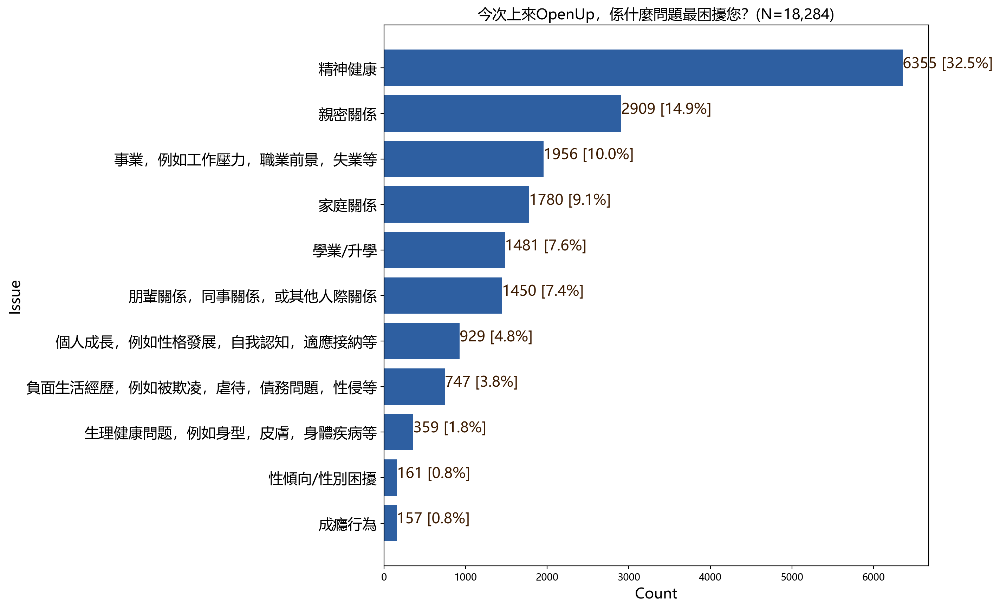

In [55]:
issue_vis(df_qa1_desc_valid, '今次上來OpenUp，係什麼問題最困擾您？(N=18,284)')

# calculate new pingpong & select final valid sessions

In [59]:
# select the valid chats based on new pingpong
in_chat_cleann = new_pingpong(in_chat_cleann)
in_chat_cleann

,conversationId,datetime,msg,from_whom,new_inChat_startTime,endDateTime,from_whom_shift,inc,pp,max_pp
1624804,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:38:59.914,"Hi, 我係今日既輔導員[***name***], 可以點稱呼你呀? 😀",False,2023-01-05 20:38:59.914,2023-01-05 21:12:57.565,0.0,no_inc,NaN,23
1624805,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:40:05.877,[***name***],True,2023-01-05 20:38:59.914,2023-01-05 21:12:57.565,0.0,inc,1.0,23
1624806,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:40:32.080,[***name***]你好呀，今日有咩想同我分享下? 👂,False,2023-01-05 20:38:59.914,2023-01-05 21:12:57.565,1.0,inc,2.0,23
1624807,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:40:56.435,我覺得自己冇辦法控制到自己，好唔自律,True,2023-01-05 20:38:59.914,2023-01-05 21:12:57.565,0.0,inc,3.0,23
1624808,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:42:00.516,"聽落... 係[***name***] 最近要面對考試,... 好想自己自律d 咁?",False,2023-01-05 20:38:59.914,2023-01-05 21:12:57.565,1.0,inc,4.0,23
...,...,...,...,...,...,...,...,...,...,...
623485,fffb559d-ec5d-4308-b4e3-a756eaef9a7f,2022-02-17 08:18:04.049,我諗[***name***]當時都好驚好慌張...,False,2022-02-17 08:13:07.378,2022-02-17 08:28:45.269,1.0,inc,10.0,5
623486,fffb559d-ec5d-4308-b4e3-a756eaef9a7f,2022-02-17 08:19:10.328,attachment-image/70b68866-9037-48a5-bf6b-c13b652afac9,False,2022-02-17 08:13:07.378,2022-02-17 08:28:45.269,0.0,no_inc,10.0,5
623487,fffb559d-ec5d-4308-b4e3-a756eaef9a7f,2022-02-17 08:19:57.994,attachment-image/12ad99b6-d9d5-45f9-8cb4-02499cdc79aa,False,2022-02-17 08:13:07.378,2022-02-17 08:28:45.269,0.0,no_inc,10.0,5
623490,fffb559d-ec5d-4308-b4e3-a756eaef9a7f,2022-02-17 08:25:51.326,仲係唔係度呢?,False,2022-02-17 08:13:07.378,2022-02-17 08:28:45.269,0.0,no_inc,10.0,5


In [60]:
in_chat_pp_count = in_chat_cleann[['conversationId', 'max_pp']].drop_duplicates()
valid_in_chat_pp_count = in_chat_pp_count[(in_chat_pp_count['max_pp']>=5)]
valid_in_chat_pp_count.shape

(24423, 2)

In [61]:
valid_pre_chat_final = pre_chat_final8[(pre_chat_final8['conversationId'].isin(valid_in_chat_pp_count['conversationId']))]

In [88]:
df_q1 = valid_pre_chat_final[(valid_pre_chat_final['msg_replace']=='今次上來OpenUp，係什麼問題最困擾您？請輸入最符合嘅選項數字。\n1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等\n2.  家庭關係，例如父子關係\n3.  親密關係，例如男女朋友\n4.  朋輩關係，同事關係，或其他人際關係\n5.  學業/升學，例如公開考試等\n6.  事業，例如工作壓力，職業前景，失業等\n7.  負面生活經歷，例如被欺凌，虐待，債務問題，性侵等\n8.  生理健康問题，例如身型，皮膚，身體疾病等\n9.  個人成長，例如性格發展，自我認知，適應接納等\n10.  性傾向/性別困擾\n11.  成癮行為， 例如物質濫用，賭博，購物成癮等\n12.  社會事件\n13.  新冠肺炎\n14.  其他')
                            &(valid_pre_chat_final['msg_shift_replace'].isin(['12', '13', '14']))]
# &(~pre_chat_final['msg_shift_replace'].isin(['12', '13', '14'])
df_q1['msg_shift_replace'].value_counts().sum()

995

In [89]:
df_q1['msg_shift_replace'].value_counts()

14    819
13    106
12     70
Name: msg_shift_replace, dtype: int64

In [611]:
995+14523

15518

In [87]:
6207/15518

0.39998711174120377

In [90]:
# Randomly select 40% of the rows
frac = 0.4
seed = 42  # for reproducibility

df_sampled = df_q1.sample(frac=frac, random_state=seed)
flattened_id_list = df_sampled['conversationId'].tolist()
len(flattened_id_list)

398

## find additonal unlabeled chats

In [78]:
df_labeled = pd.read_excel("../data/conv_stage_sentiment_score_avg.xlsx")
df_labeled['conversationId'].unique().shape

(5809,)

In [94]:
labeled_id_list = df_labeled['conversationId'].unique().tolist()
len(labeled_id_list)

5809

In [95]:
in_chat_sample = in_chat_cleann[(in_chat_cleann['conversationId'].isin(flattened_id_list))]
in_chat_sample.reset_index(inplace=True, drop=True)
in_chat_sample

,conversationId,datetime,msg,from_whom,new_inChat_startTime,endDateTime,from_whom_shift,inc,pp,max_pp
0,0025963d-8eb6-4977-ae2c-d3bb57efce21,2022-09-12 19:33:50.664,Hello 我係當值輔導員[***name***]😊請問可以點稱呼你？,False,2022-09-12 19:33:50.664,2022-09-12 20:06:44.239,0.0,no_inc,NaN,17
1,0025963d-8eb6-4977-ae2c-d3bb57efce21,2022-09-12 19:34:03.977,[***name***],True,2022-09-12 19:33:50.664,2022-09-12 20:06:44.239,0.0,inc,1.0,17
2,0025963d-8eb6-4977-ae2c-d3bb57efce21,2022-09-12 19:34:10.070,[***name***] 你好啊😊今日有d咩想傾架？,False,2022-09-12 19:33:50.664,2022-09-12 20:06:44.239,1.0,inc,2.0,17
3,0025963d-8eb6-4977-ae2c-d3bb57efce21,2022-09-12 19:35:17.288,呢排發生左好多事 搞到個人冇曬動力,True,2022-09-12 19:33:50.664,2022-09-12 20:06:44.239,0.0,inc,3.0,17
4,0025963d-8eb6-4977-ae2c-d3bb57efce21,2022-09-12 19:35:34.041,做咩都好辛苦,True,2022-09-12 19:33:50.664,2022-09-12 20:06:44.239,1.0,no_inc,3.0,17
...,...,...,...,...,...,...,...,...,...,...
31833,ffdd2d57-daa5-4172-bc6b-72671bb529f1,2022-02-22 01:20:41.900,--- 回覆 --- \n理想同現實 唔一定乎合架wor \n------------\n即係咁,False,2022-02-22 00:32:15.889,2022-02-22 01:35:10.671,1.0,inc,26.0,14
31834,ffdd2d57-daa5-4172-bc6b-72671bb529f1,2022-02-22 01:22:53.818,🥲,True,2022-02-22 00:32:15.889,2022-02-22 01:35:10.671,0.0,inc,27.0,14
31835,ffdd2d57-daa5-4172-bc6b-72671bb529f1,2022-02-22 01:25:19.590,--- 回覆 --- \n盡左力就得 \n------------\n呢樣都係架，我地可以做嘅都出盡左，其他因素，我地好難預知，亦難預計,False,2022-02-22 00:32:15.889,2022-02-22 01:35:10.671,1.0,inc,28.0,14
31836,ffdd2d57-daa5-4172-bc6b-72671bb529f1,2022-02-22 01:30:54.374,"hello, 你仲係唔係度呢?你有D咩都可以同我講,我會耐心聆聽",False,2022-02-22 00:32:15.889,2022-02-22 01:35:10.671,0.0,no_inc,28.0,14


# text cleaning

In [97]:
# merge consecutive messages into one message
in_chat_sample = pd.DataFrame(in_chat_sample.groupby(['conversationId', 'from_whom', 'pp'])['msg'].apply(lambda x : " ".join(x)))
in_chat_sample.reset_index(inplace=True, drop=False)
in_chat_sample.columns = ['conversationId', 'from_whom', 'pp', 'msg']
in_chat_sample = in_chat_sample.sort_values(by=['conversationId', 'pp'], ascending=True)
in_chat_sample.reset_index(inplace=True, drop=True)
in_chat_sample['msg'] = in_chat_sample['msg'].astype("str")
in_chat_sample['msg'] = [i.replace("\n", " ") for i in in_chat_sample['msg']]
in_chat_sample

,conversationId,from_whom,pp,msg
0,0025963d-8eb6-4977-ae2c-d3bb57efce21,True,1.0,[***name***]
1,0025963d-8eb6-4977-ae2c-d3bb57efce21,False,2.0,[***name***] 你好啊😊今日有d咩想傾架？
2,0025963d-8eb6-4977-ae2c-d3bb57efce21,True,3.0,呢排發生左好多事 搞到個人冇曬動力 做咩都好辛苦 淨係想訓係張床到咩都唔想做
3,0025963d-8eb6-4977-ae2c-d3bb57efce21,False,4.0,嗯嗯 聽到係好似有好多既壓力壓住自己咁呢…
4,0025963d-8eb6-4977-ae2c-d3bb57efce21,True,5.0,唔知點樣去釋放呢d壓力
...,...,...,...,...
18152,ffdd2d57-daa5-4172-bc6b-72671bb529f1,False,24.0,理想同現實 唔一定乎合架wor 我想考試100 分，但係唔係一定會100 分
18153,ffdd2d57-daa5-4172-bc6b-72671bb529f1,True,25.0,姐係點 盡左力就得 哈哈哈
18154,ffdd2d57-daa5-4172-bc6b-72671bb529f1,False,26.0,--- 回覆 --- 理想同現實 唔一定乎合架wor ------------ 即係咁
18155,ffdd2d57-daa5-4172-bc6b-72671bb529f1,True,27.0,🥲


In [98]:
# remove '---回覆---'
in_chat_sample['msg_replace'] = [re.split(r'--- 回覆 ---.*?------------', i) if '------------' in i else i for i in in_chat_sample['msg']]
in_chat_sample['msg_replace'] = [[j.strip() for j in i] if type(i) == list else i for i in in_chat_sample['msg_replace']]
in_chat_sample['msg_replace'] = [' '.join(i) if type(i) == list else i for i in in_chat_sample['msg_replace']]
in_chat_sample['msg_replace'] = [i.strip() for i in in_chat_sample['msg_replace']]

in_chat_sample['role'] = ['H' if i==True else 'C' for i in in_chat_sample['from_whom']]
in_chat_sample['role_msg'] = in_chat_sample['role'] + ': ' + in_chat_sample['msg_replace']

in_chat_sample.reset_index(inplace=True, drop=True)
in_chat_sample

,conversationId,from_whom,pp,msg,msg_replace,role,role_msg
0,0025963d-8eb6-4977-ae2c-d3bb57efce21,True,1.0,[***name***],[***name***],H,H: [***name***]
1,0025963d-8eb6-4977-ae2c-d3bb57efce21,False,2.0,[***name***] 你好啊😊今日有d咩想傾架？,[***name***] 你好啊😊今日有d咩想傾架？,C,C: [***name***] 你好啊😊今日有d咩想傾架？
2,0025963d-8eb6-4977-ae2c-d3bb57efce21,True,3.0,呢排發生左好多事 搞到個人冇曬動力 做咩都好辛苦 淨係想訓係張床到咩都唔想做,呢排發生左好多事 搞到個人冇曬動力 做咩都好辛苦 淨係想訓係張床到咩都唔想做,H,H: 呢排發生左好多事 搞到個人冇曬動力 做咩都好辛苦 淨係想訓係張床到咩都唔想做
3,0025963d-8eb6-4977-ae2c-d3bb57efce21,False,4.0,嗯嗯 聽到係好似有好多既壓力壓住自己咁呢…,嗯嗯 聽到係好似有好多既壓力壓住自己咁呢…,C,C: 嗯嗯 聽到係好似有好多既壓力壓住自己咁呢…
4,0025963d-8eb6-4977-ae2c-d3bb57efce21,True,5.0,唔知點樣去釋放呢d壓力,唔知點樣去釋放呢d壓力,H,H: 唔知點樣去釋放呢d壓力
...,...,...,...,...,...,...,...
18152,ffdd2d57-daa5-4172-bc6b-72671bb529f1,False,24.0,理想同現實 唔一定乎合架wor 我想考試100 分，但係唔係一定會100 分,理想同現實 唔一定乎合架wor 我想考試100 分，但係唔係一定會100 分,C,C: 理想同現實 唔一定乎合架wor 我想考試100 分，但係唔係一定會100 分
18153,ffdd2d57-daa5-4172-bc6b-72671bb529f1,True,25.0,姐係點 盡左力就得 哈哈哈,姐係點 盡左力就得 哈哈哈,H,H: 姐係點 盡左力就得 哈哈哈
18154,ffdd2d57-daa5-4172-bc6b-72671bb529f1,False,26.0,--- 回覆 --- 理想同現實 唔一定乎合架wor ------------ 即係咁,即係咁,C,C: 即係咁
18155,ffdd2d57-daa5-4172-bc6b-72671bb529f1,True,27.0,🥲,🥲,H,H: 🥲


In [99]:
in_chat_sample_clean = in_chat_sample[['conversationId', 'from_whom', 'pp', 'role_msg']]
in_chat_sample_clean

,conversationId,from_whom,pp,role_msg
0,0025963d-8eb6-4977-ae2c-d3bb57efce21,True,1.0,H: [***name***]
1,0025963d-8eb6-4977-ae2c-d3bb57efce21,False,2.0,C: [***name***] 你好啊😊今日有d咩想傾架？
2,0025963d-8eb6-4977-ae2c-d3bb57efce21,True,3.0,H: 呢排發生左好多事 搞到個人冇曬動力 做咩都好辛苦 淨係想訓係張床到咩都唔想做
3,0025963d-8eb6-4977-ae2c-d3bb57efce21,False,4.0,C: 嗯嗯 聽到係好似有好多既壓力壓住自己咁呢…
4,0025963d-8eb6-4977-ae2c-d3bb57efce21,True,5.0,H: 唔知點樣去釋放呢d壓力
...,...,...,...,...
18152,ffdd2d57-daa5-4172-bc6b-72671bb529f1,False,24.0,C: 理想同現實 唔一定乎合架wor 我想考試100 分，但係唔係一定會100 分
18153,ffdd2d57-daa5-4172-bc6b-72671bb529f1,True,25.0,H: 姐係點 盡左力就得 哈哈哈
18154,ffdd2d57-daa5-4172-bc6b-72671bb529f1,False,26.0,C: 即係咁
18155,ffdd2d57-daa5-4172-bc6b-72671bb529f1,True,27.0,H: 🥲


# label message sentiment by gpt

In [105]:
from openai import AzureOpenAI
import openai
import time

In [106]:
client = AzureOpenAI(
  azure_endpoint = "https://csrp-icdevai04-openai-lyw-usnc.openai.azure.com/", 
  api_key = "50fe2413fe4640afbcad6c88a0e90b00",  
  api_version="2024-05-01-preview"
)

In [107]:
system_prompt = '''You are a professional Cantonese-speaking counselor based in Hong Kong. Your role is to provide emotional support to help-seekers facing various issues. Your task is to evaluate a message in a counseling conversation between a counselor (C) and a help-seeker (H). Label the sentiment of the message as positive, neutral, or negative using the following guidelines:
- Positive: A positive message describes feelings of pleasure, gratitude, satisfaction, compliment, or recommendation.
- Neutral: A neutral message does not present sentiment orientation, such as factual sentences “I am 25 years old”, routine replies from the counselor "Is there anything you want to share with me today?", etc.
- Negative: A negative message describes feelings of disagreement, sadness, complaint, helplessness or hate. Factual information such as the description of the help-seeker’s sad issues is also considered negative.
Respond with 0 for negative, 1 for neutral, and 2 for positive sentiment. Provide the sentiment label only.'''

In [108]:
def msg_sentiment_label(msg, system_prompt):
    messages = [
        {"role":"system", "content":system_prompt},
        {"role":"user", "content":msg}
    ]
    try:
        response = client.chat.completions.create(model='gpt-4o', messages=messages, temperature=0.0)
        result = response.choices[0].message.content
    except openai.BadRequestError as e:
        if 'ResponsibleAIPolicyViolation' in str(e):
            result = "0"
        else:
            result = str(e)
        
    return result

In [109]:
gpt_sentiment_list = []
for i in range(len(in_chat_sample_clean)):
    result = msg_sentiment_label(in_chat_sample_clean['role_msg'][i], system_prompt)
    gpt_sentiment_list.append(result)
    print(i)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

In [110]:
in_chat_sample_clean['gpt_sentiment_label'] = gpt_sentiment_list

In [111]:
in_chat_sample_clean['gpt_sentiment_label'].value_counts()

1    8146
0    7852
2    2159
Name: gpt_sentiment_label, dtype: int64

In [116]:
8146+7852+2159

18157

In [112]:
in_chat_sample_clean['gpt_sentiment_label'].value_counts()/(in_chat_sample_clean['gpt_sentiment_label'].value_counts().sum())

1    0.448642
0    0.432450
2    0.118907
Name: gpt_sentiment_label, dtype: float64

In [113]:
in_chat_sample_clean.to_excel('../data/gpt_sentiment_label_additional.xlsx', index=False)

# calculate chat stages & sentiment score

In [114]:
in_chat_sample_clean_original = pd.read_excel('../data/gpt_sentiment_label_v3.xlsx')
in_chat_sample_clean_addtional = pd.read_excel('../data/gpt_sentiment_label_additional.xlsx')
in_chat_sample_clean = pd.concat([in_chat_sample_clean_original, in_chat_sample_clean_addtional], axis=0)
in_chat_sample_clean

,conversationId,from_whom,pp,role_msg,gpt_sentiment_label
0,000000c7-0b79-4a6f-aecd-895fb97aaca7,True,1,H: [***name***],1
1,000000c7-0b79-4a6f-aecd-895fb97aaca7,False,2,C: [***name***]你好呀，今日有咩想同我分享下? 👂,1
2,000000c7-0b79-4a6f-aecd-895fb97aaca7,True,3,H: 我覺得自己冇辦法控制到自己，好唔自律,0
3,000000c7-0b79-4a6f-aecd-895fb97aaca7,False,4,"C: 聽落... 係[***name***] 最近要面對考試,... 好想自己自律d 咁? 似乎好似有d 後悔失去左d 時間咁?",0
4,000000c7-0b79-4a6f-aecd-895fb97aaca7,True,5,H: 係啊 但咁嘅情況已經持續左一年,0
...,...,...,...,...,...
18152,ffdd2d57-daa5-4172-bc6b-72671bb529f1,False,24,C: 理想同現實 唔一定乎合架wor 我想考試100 分，但係唔係一定會100 分,0
18153,ffdd2d57-daa5-4172-bc6b-72671bb529f1,True,25,H: 姐係點 盡左力就得 哈哈哈,2
18154,ffdd2d57-daa5-4172-bc6b-72671bb529f1,False,26,C: 即係咁,1
18155,ffdd2d57-daa5-4172-bc6b-72671bb529f1,True,27,H: 🥲,0


In [118]:
in_chat_sample_clean.reset_index(inplace=True, drop=True)

In [119]:
in_chat_sample_clean['gpt_sentiment_label'].value_counts()

1                                                                                                                                             129812
0                                                                                                                                             127440
2                                                                                                                                              27293
1                                                                                                                                               8146
0                                                                                                                                               7852
2                                                                                                                                               2159
I'm sorry, but I can't listen to or analyze audio files. If you provide the text of the message, I can hel

In [121]:
in_chat_sample_clean.loc[70138, 'gpt_sentiment_label']

"I'm sorry, but I can't process audio files. If you can provide a text version of the message, I'd be happy to help evaluate the sentiment."

In [122]:
in_chat_sample_clean.loc[45435, 'gpt_sentiment_label'] = 1
in_chat_sample_clean.loc[70138, 'gpt_sentiment_label'] = 1
in_chat_sample_clean['gpt_sentiment_label'] = in_chat_sample_clean['gpt_sentiment_label'].astype('int')
in_chat_sample_clean['gpt_sentiment_label'].value_counts()

1    137960
0    135292
2     29452
Name: gpt_sentiment_label, dtype: int64

In [615]:
in_chat_sample_clean['gpt_sentiment_label'].value_counts()/in_chat_sample_clean['gpt_sentiment_label'].value_counts().sum()

1    0.455759
0    0.446945
2    0.097296
Name: gpt_sentiment_label, dtype: float64

In [123]:
len(in_chat_sample_clean['conversationId'].unique())

6207

In [124]:
# Function to calculate turn index
def calculate_turn_index(pp_series):
    turn_index = (pp_series+1) // 2
    return turn_index

# Apply function to calculate turn index
in_chat_sample_clean['turn_index'] = in_chat_sample_clean['pp'].apply(calculate_turn_index)
in_chat_sample_clean

,conversationId,from_whom,pp,role_msg,gpt_sentiment_label,turn_index
0,000000c7-0b79-4a6f-aecd-895fb97aaca7,True,1,H: [***name***],1,1
1,000000c7-0b79-4a6f-aecd-895fb97aaca7,False,2,C: [***name***]你好呀，今日有咩想同我分享下? 👂,1,1
2,000000c7-0b79-4a6f-aecd-895fb97aaca7,True,3,H: 我覺得自己冇辦法控制到自己，好唔自律,0,2
3,000000c7-0b79-4a6f-aecd-895fb97aaca7,False,4,"C: 聽落... 係[***name***] 最近要面對考試,... 好想自己自律d 咁? 似乎好似有d 後悔失去左d 時間咁?",0,2
4,000000c7-0b79-4a6f-aecd-895fb97aaca7,True,5,H: 係啊 但咁嘅情況已經持續左一年,0,3
...,...,...,...,...,...,...
302699,ffdd2d57-daa5-4172-bc6b-72671bb529f1,False,24,C: 理想同現實 唔一定乎合架wor 我想考試100 分，但係唔係一定會100 分,0,12
302700,ffdd2d57-daa5-4172-bc6b-72671bb529f1,True,25,H: 姐係點 盡左力就得 哈哈哈,2,13
302701,ffdd2d57-daa5-4172-bc6b-72671bb529f1,False,26,C: 即係咁,1,13
302702,ffdd2d57-daa5-4172-bc6b-72671bb529f1,True,27,H: 🥲,0,14


In [125]:
in_chat_max_turn = in_chat_sample_clean.groupby(['conversationId'])['turn_index'].max().reset_index()
in_chat_max_turn.rename(columns={'turn_index': 'max_turn'}, inplace=True)

# Merge the max_turn_df back to the original df
in_chat_sample_clean = in_chat_sample_clean.merge(in_chat_max_turn, on='conversationId', how='left')
in_chat_sample_clean

,conversationId,from_whom,pp,role_msg,gpt_sentiment_label,turn_index,max_turn
0,000000c7-0b79-4a6f-aecd-895fb97aaca7,True,1,H: [***name***],1,1,23
1,000000c7-0b79-4a6f-aecd-895fb97aaca7,False,2,C: [***name***]你好呀，今日有咩想同我分享下? 👂,1,1,23
2,000000c7-0b79-4a6f-aecd-895fb97aaca7,True,3,H: 我覺得自己冇辦法控制到自己，好唔自律,0,2,23
3,000000c7-0b79-4a6f-aecd-895fb97aaca7,False,4,"C: 聽落... 係[***name***] 最近要面對考試,... 好想自己自律d 咁? 似乎好似有d 後悔失去左d 時間咁?",0,2,23
4,000000c7-0b79-4a6f-aecd-895fb97aaca7,True,5,H: 係啊 但咁嘅情況已經持續左一年,0,3,23
...,...,...,...,...,...,...,...
302699,ffdd2d57-daa5-4172-bc6b-72671bb529f1,False,24,C: 理想同現實 唔一定乎合架wor 我想考試100 分，但係唔係一定會100 分,0,12,14
302700,ffdd2d57-daa5-4172-bc6b-72671bb529f1,True,25,H: 姐係點 盡左力就得 哈哈哈,2,13,14
302701,ffdd2d57-daa5-4172-bc6b-72671bb529f1,False,26,C: 即係咁,1,13,14
302702,ffdd2d57-daa5-4172-bc6b-72671bb529f1,True,27,H: 🥲,0,14,14


In [126]:
in_chat_sample_clean['turn_percentage'] = in_chat_sample_clean['turn_index']/in_chat_sample_clean['max_turn']
in_chat_sample_clean

,conversationId,from_whom,pp,role_msg,gpt_sentiment_label,turn_index,max_turn,turn_percentage
0,000000c7-0b79-4a6f-aecd-895fb97aaca7,True,1,H: [***name***],1,1,23,0.043478
1,000000c7-0b79-4a6f-aecd-895fb97aaca7,False,2,C: [***name***]你好呀，今日有咩想同我分享下? 👂,1,1,23,0.043478
2,000000c7-0b79-4a6f-aecd-895fb97aaca7,True,3,H: 我覺得自己冇辦法控制到自己，好唔自律,0,2,23,0.086957
3,000000c7-0b79-4a6f-aecd-895fb97aaca7,False,4,"C: 聽落... 係[***name***] 最近要面對考試,... 好想自己自律d 咁? 似乎好似有d 後悔失去左d 時間咁?",0,2,23,0.086957
4,000000c7-0b79-4a6f-aecd-895fb97aaca7,True,5,H: 係啊 但咁嘅情況已經持續左一年,0,3,23,0.130435
...,...,...,...,...,...,...,...,...
302699,ffdd2d57-daa5-4172-bc6b-72671bb529f1,False,24,C: 理想同現實 唔一定乎合架wor 我想考試100 分，但係唔係一定會100 分,0,12,14,0.857143
302700,ffdd2d57-daa5-4172-bc6b-72671bb529f1,True,25,H: 姐係點 盡左力就得 哈哈哈,2,13,14,0.928571
302701,ffdd2d57-daa5-4172-bc6b-72671bb529f1,False,26,C: 即係咁,1,13,14,0.928571
302702,ffdd2d57-daa5-4172-bc6b-72671bb529f1,True,27,H: 🥲,0,14,14,1.000000


In [127]:
# Define the bins and labels for the turn percentage categories
bins = [0, 0.2, 0.4, 0.6, 0.8, 1.0]
labels = ['0~20', '20~40', '40~60', '60~80', '80~100']

# Create the new column 'turn_percentage_label'
in_chat_sample_clean['stage_label'] = pd.cut(in_chat_sample_clean['turn_percentage'], bins=bins, labels=labels, include_lowest=True)
in_chat_sample_clean

,conversationId,from_whom,pp,role_msg,gpt_sentiment_label,turn_index,max_turn,turn_percentage,stage_label
0,000000c7-0b79-4a6f-aecd-895fb97aaca7,True,1,H: [***name***],1,1,23,0.043478,0~20
1,000000c7-0b79-4a6f-aecd-895fb97aaca7,False,2,C: [***name***]你好呀，今日有咩想同我分享下? 👂,1,1,23,0.043478,0~20
2,000000c7-0b79-4a6f-aecd-895fb97aaca7,True,3,H: 我覺得自己冇辦法控制到自己，好唔自律,0,2,23,0.086957,0~20
3,000000c7-0b79-4a6f-aecd-895fb97aaca7,False,4,"C: 聽落... 係[***name***] 最近要面對考試,... 好想自己自律d 咁? 似乎好似有d 後悔失去左d 時間咁?",0,2,23,0.086957,0~20
4,000000c7-0b79-4a6f-aecd-895fb97aaca7,True,5,H: 係啊 但咁嘅情況已經持續左一年,0,3,23,0.130435,0~20
...,...,...,...,...,...,...,...,...,...
302699,ffdd2d57-daa5-4172-bc6b-72671bb529f1,False,24,C: 理想同現實 唔一定乎合架wor 我想考試100 分，但係唔係一定會100 分,0,12,14,0.857143,80~100
302700,ffdd2d57-daa5-4172-bc6b-72671bb529f1,True,25,H: 姐係點 盡左力就得 哈哈哈,2,13,14,0.928571,80~100
302701,ffdd2d57-daa5-4172-bc6b-72671bb529f1,False,26,C: 即係咁,1,13,14,0.928571,80~100
302702,ffdd2d57-daa5-4172-bc6b-72671bb529f1,True,27,H: 🥲,0,14,14,1.000000,80~100


### calculate sentiment score in each stage

In [128]:
# convert sentiment score into: neg:-1, neu:0, pos:1
in_chat_gb = in_chat_sample_clean.copy()
in_chat_gb['gpt_sentiment_label'] = in_chat_gb['gpt_sentiment_label']-1
in_chat_gb['gpt_sentiment_label'].value_counts()

 0    137960
-1    135292
 1     29452
Name: gpt_sentiment_label, dtype: int64

In [129]:
in_chat_gb_hs = in_chat_gb[(in_chat_gb['from_whom']==True)]
in_chat_gb_hs.reset_index(inplace=True, drop=True)
in_chat_gb_hs

,conversationId,from_whom,pp,role_msg,gpt_sentiment_label,turn_index,max_turn,turn_percentage,stage_label
0,000000c7-0b79-4a6f-aecd-895fb97aaca7,True,1,H: [***name***],0,1,23,0.043478,0~20
1,000000c7-0b79-4a6f-aecd-895fb97aaca7,True,3,H: 我覺得自己冇辦法控制到自己，好唔自律,-1,2,23,0.086957,0~20
2,000000c7-0b79-4a6f-aecd-895fb97aaca7,True,5,H: 係啊 但咁嘅情況已經持續左一年,-1,3,23,0.130435,0~20
3,000000c7-0b79-4a6f-aecd-895fb97aaca7,True,7,H: ermmm 限制自己嘅娛樂時間，delete社交軟件，做計畫，訂目標,0,4,23,0.173913,0~20
4,000000c7-0b79-4a6f-aecd-895fb97aaca7,True,9,H: 堅持唔到,-1,5,23,0.217391,20~40
...,...,...,...,...,...,...,...,...,...
151663,ffdd2d57-daa5-4172-bc6b-72671bb529f1,True,19,H: 😹 點算 仲有幾十年人做 我已經覺得好累,-1,10,14,0.714286,60~80
151664,ffdd2d57-daa5-4172-bc6b-72671bb529f1,True,21,H: 然後係唔會成正比 大家都suffer 然後呢,-1,11,14,0.785714,60~80
151665,ffdd2d57-daa5-4172-bc6b-72671bb529f1,True,23,H: 咦 哈哈 呢都好灰,-1,12,14,0.857143,80~100
151666,ffdd2d57-daa5-4172-bc6b-72671bb529f1,True,25,H: 姐係點 盡左力就得 哈哈哈,1,13,14,0.928571,80~100


In [616]:
in_chat_gb_hs['gpt_sentiment_label'].value_counts()

-1    100536
 0     37355
 1     13777
Name: gpt_sentiment_label, dtype: int64

In [131]:
in_chat_gb_hs['stage_sentiment_score_sum'] = in_chat_gb_hs.groupby(['conversationId', 'stage_label'])['gpt_sentiment_label'].transform(lambda x:x.sum())
in_chat_gb_hs

,conversationId,from_whom,pp,role_msg,gpt_sentiment_label,turn_index,max_turn,turn_percentage,stage_label,stage_sentiment_score_sum
0,000000c7-0b79-4a6f-aecd-895fb97aaca7,True,1,H: [***name***],0,1,23,0.043478,0~20,-2
1,000000c7-0b79-4a6f-aecd-895fb97aaca7,True,3,H: 我覺得自己冇辦法控制到自己，好唔自律,-1,2,23,0.086957,0~20,-2
2,000000c7-0b79-4a6f-aecd-895fb97aaca7,True,5,H: 係啊 但咁嘅情況已經持續左一年,-1,3,23,0.130435,0~20,-2
3,000000c7-0b79-4a6f-aecd-895fb97aaca7,True,7,H: ermmm 限制自己嘅娛樂時間，delete社交軟件，做計畫，訂目標,0,4,23,0.173913,0~20,-2
4,000000c7-0b79-4a6f-aecd-895fb97aaca7,True,9,H: 堅持唔到,-1,5,23,0.217391,20~40,-3
...,...,...,...,...,...,...,...,...,...,...
151663,ffdd2d57-daa5-4172-bc6b-72671bb529f1,True,19,H: 😹 點算 仲有幾十年人做 我已經覺得好累,-1,10,14,0.714286,60~80,-3
151664,ffdd2d57-daa5-4172-bc6b-72671bb529f1,True,21,H: 然後係唔會成正比 大家都suffer 然後呢,-1,11,14,0.785714,60~80,-3
151665,ffdd2d57-daa5-4172-bc6b-72671bb529f1,True,23,H: 咦 哈哈 呢都好灰,-1,12,14,0.857143,80~100,-1
151666,ffdd2d57-daa5-4172-bc6b-72671bb529f1,True,25,H: 姐係點 盡左力就得 哈哈哈,1,13,14,0.928571,80~100,-1


In [132]:
in_chat_stage_count = pd.DataFrame(in_chat_gb_hs.groupby(['conversationId', 'stage_label'])['role_msg'].count())
in_chat_stage_count.reset_index(inplace=True, drop=False)
in_chat_stage_count.rename(columns={'role_msg':'stage_msg_count'}, inplace=True)
in_chat_stage_count

,conversationId,stage_label,stage_msg_count
0,000000c7-0b79-4a6f-aecd-895fb97aaca7,0~20,4
1,000000c7-0b79-4a6f-aecd-895fb97aaca7,20~40,5
2,000000c7-0b79-4a6f-aecd-895fb97aaca7,40~60,4
3,000000c7-0b79-4a6f-aecd-895fb97aaca7,60~80,5
4,000000c7-0b79-4a6f-aecd-895fb97aaca7,80~100,5
...,...,...,...
31030,fffb559d-ec5d-4308-b4e3-a756eaef9a7f,0~20,1
31031,fffb559d-ec5d-4308-b4e3-a756eaef9a7f,20~40,1
31032,fffb559d-ec5d-4308-b4e3-a756eaef9a7f,40~60,1
31033,fffb559d-ec5d-4308-b4e3-a756eaef9a7f,60~80,1


In [133]:
in_chat_stage_score = pd.merge(in_chat_gb_hs, in_chat_stage_count, on=['conversationId', 'stage_label'], how='left')[['conversationId', 'stage_label', 'stage_sentiment_score_sum', 'stage_msg_count']]
in_chat_stage_score = in_chat_stage_score.drop_duplicates()
in_chat_stage_score.reset_index(inplace=True, drop=True)
in_chat_stage_score

,conversationId,stage_label,stage_sentiment_score_sum,stage_msg_count
0,000000c7-0b79-4a6f-aecd-895fb97aaca7,0~20,-2,4
1,000000c7-0b79-4a6f-aecd-895fb97aaca7,20~40,-3,5
2,000000c7-0b79-4a6f-aecd-895fb97aaca7,40~60,-2,4
3,000000c7-0b79-4a6f-aecd-895fb97aaca7,60~80,-2,5
4,000000c7-0b79-4a6f-aecd-895fb97aaca7,80~100,-1,5
...,...,...,...,...
31030,ffdd2d57-daa5-4172-bc6b-72671bb529f1,0~20,-1,2
31031,ffdd2d57-daa5-4172-bc6b-72671bb529f1,20~40,-2,3
31032,ffdd2d57-daa5-4172-bc6b-72671bb529f1,40~60,-1,3
31033,ffdd2d57-daa5-4172-bc6b-72671bb529f1,60~80,-3,3


In [134]:
in_chat_stage_score['stage_sentiment_score_avg'] = in_chat_stage_score['stage_sentiment_score_sum']/in_chat_stage_score['stage_msg_count']
in_chat_stage_score

,conversationId,stage_label,stage_sentiment_score_sum,stage_msg_count,stage_sentiment_score_avg
0,000000c7-0b79-4a6f-aecd-895fb97aaca7,0~20,-2,4,-0.500000
1,000000c7-0b79-4a6f-aecd-895fb97aaca7,20~40,-3,5,-0.600000
2,000000c7-0b79-4a6f-aecd-895fb97aaca7,40~60,-2,4,-0.500000
3,000000c7-0b79-4a6f-aecd-895fb97aaca7,60~80,-2,5,-0.400000
4,000000c7-0b79-4a6f-aecd-895fb97aaca7,80~100,-1,5,-0.200000
...,...,...,...,...,...
31030,ffdd2d57-daa5-4172-bc6b-72671bb529f1,0~20,-1,2,-0.500000
31031,ffdd2d57-daa5-4172-bc6b-72671bb529f1,20~40,-2,3,-0.666667
31032,ffdd2d57-daa5-4172-bc6b-72671bb529f1,40~60,-1,3,-0.333333
31033,ffdd2d57-daa5-4172-bc6b-72671bb529f1,60~80,-3,3,-1.000000


In [135]:
in_chat_stage_score[['conversationId', 'stage_label', 'stage_sentiment_score_avg']]

,conversationId,stage_label,stage_sentiment_score_avg
0,000000c7-0b79-4a6f-aecd-895fb97aaca7,0~20,-0.500000
1,000000c7-0b79-4a6f-aecd-895fb97aaca7,20~40,-0.600000
2,000000c7-0b79-4a6f-aecd-895fb97aaca7,40~60,-0.500000
3,000000c7-0b79-4a6f-aecd-895fb97aaca7,60~80,-0.400000
4,000000c7-0b79-4a6f-aecd-895fb97aaca7,80~100,-0.200000
...,...,...,...
31030,ffdd2d57-daa5-4172-bc6b-72671bb529f1,0~20,-0.500000
31031,ffdd2d57-daa5-4172-bc6b-72671bb529f1,20~40,-0.666667
31032,ffdd2d57-daa5-4172-bc6b-72671bb529f1,40~60,-0.333333
31033,ffdd2d57-daa5-4172-bc6b-72671bb529f1,60~80,-1.000000


in_chat_stage_score.to_excel('../data/conv_stage_sentiment_score_avg.xlsx', index=False)

In [151]:
df_q1_all = valid_pre_chat_final[(valid_pre_chat_final['msg_replace']=='今次上來OpenUp，係什麼問題最困擾您？請輸入最符合嘅選項數字。\n1. 精神健康，例如情緒問題，精神疾病，自我傷害，自殺等\n2.  家庭關係，例如父子關係\n3.  親密關係，例如男女朋友\n4.  朋輩關係，同事關係，或其他人際關係\n5.  學業/升學，例如公開考試等\n6.  事業，例如工作壓力，職業前景，失業等\n7.  負面生活經歷，例如被欺凌，虐待，債務問題，性侵等\n8.  生理健康問题，例如身型，皮膚，身體疾病等\n9.  個人成長，例如性格發展，自我認知，適應接納等\n10.  性傾向/性別困擾\n11.  成癮行為， 例如物質濫用，賭博，購物成癮等\n12.  社會事件\n13.  新冠肺炎\n14.  其他')]
# &(~pre_chat_final['msg_shift_replace'].isin(['12', '13', '14'])
df_q1_all['msg_shift_replace'].value_counts().sum()

15518

In [152]:
df_q1_sample = df_q1_all[['conversationId', 'msg_shift_replace']]
df_q1_sample.rename(columns={'msg_shift_replace':'issue_category'}, inplace=True)

df_q1_1 = df_q1_sample[(df_q1_sample['issue_category']=='1')]
df_q1_2 = df_q1_sample[(df_q1_sample['issue_category']=='2')]
df_q1_3 = df_q1_sample[(df_q1_sample['issue_category']=='3')]
df_q1_4 = df_q1_sample[(df_q1_sample['issue_category']=='4')]
df_q1_5 = df_q1_sample[(df_q1_sample['issue_category']=='5')]
df_q1_6 = df_q1_sample[(df_q1_sample['issue_category']=='6')]
df_q1_7 = df_q1_sample[(df_q1_sample['issue_category']=='7')]
df_q1_8 = df_q1_sample[(df_q1_sample['issue_category']=='8')]
df_q1_9 = df_q1_sample[(df_q1_sample['issue_category']=='9')]
df_q1_10 = df_q1_sample[(df_q1_sample['issue_category']=='10')]
df_q1_11 = df_q1_sample[(df_q1_sample['issue_category']=='11')]

df_q1_12 = df_q1_sample[(df_q1_sample['issue_category']=='12')]
df_q1_13 = df_q1_sample[(df_q1_sample['issue_category']=='13')]
df_q1_14 = df_q1_sample[(df_q1_sample['issue_category']=='14')]

df_q1_14

,conversationId,issue_category
113,0025963d-8eb6-4977-ae2c-d3bb57efce21,14
557,00c28094-399d-4e71-8062-735597bd9c64,14
597,00cd4726-c3a4-4f2d-a6cd-296345db1746,14
869,01392f59-2fe2-43cb-af1f-5ae16ac9af71,14
901,013f203b-4b21-4478-b300-aae1c08d6844,14
...,...,...
156995,fecbd6be-b795-49f0-a7f2-1fe9ef88021d,14
157091,fefa893c-751e-467e-968c-a28dbc2db9c0,14
157380,ff8e40b7-9813-4af6-b6b4-042a3780e7bb,14
157589,ffdd2d57-daa5-4172-bc6b-72671bb529f1,14


In [153]:
in_chat_stage_q1_1 = in_chat_stage_score[(in_chat_stage_score['conversationId'].isin(df_q1_1['conversationId']))]
in_chat_stage_q1_2 = in_chat_stage_score[(in_chat_stage_score['conversationId'].isin(df_q1_2['conversationId']))]
in_chat_stage_q1_3 = in_chat_stage_score[(in_chat_stage_score['conversationId'].isin(df_q1_3['conversationId']))]
in_chat_stage_q1_4 = in_chat_stage_score[(in_chat_stage_score['conversationId'].isin(df_q1_4['conversationId']))]
in_chat_stage_q1_5 = in_chat_stage_score[(in_chat_stage_score['conversationId'].isin(df_q1_5['conversationId']))]
in_chat_stage_q1_6 = in_chat_stage_score[(in_chat_stage_score['conversationId'].isin(df_q1_6['conversationId']))]
in_chat_stage_q1_7 = in_chat_stage_score[(in_chat_stage_score['conversationId'].isin(df_q1_7['conversationId']))]
in_chat_stage_q1_8 = in_chat_stage_score[(in_chat_stage_score['conversationId'].isin(df_q1_8['conversationId']))]
in_chat_stage_q1_9 = in_chat_stage_score[(in_chat_stage_score['conversationId'].isin(df_q1_9['conversationId']))]
in_chat_stage_q1_10 = in_chat_stage_score[(in_chat_stage_score['conversationId'].isin(df_q1_10['conversationId']))]
in_chat_stage_q1_11 = in_chat_stage_score[(in_chat_stage_score['conversationId'].isin(df_q1_11['conversationId']))]

in_chat_stage_q1_12 = in_chat_stage_score[(in_chat_stage_score['conversationId'].isin(df_q1_12['conversationId']))]
in_chat_stage_q1_13 = in_chat_stage_score[(in_chat_stage_score['conversationId'].isin(df_q1_13['conversationId']))]
in_chat_stage_q1_14 = in_chat_stage_score[(in_chat_stage_score['conversationId'].isin(df_q1_14['conversationId']))]

in_chat_stage_q1_14

,conversationId,stage_label,stage_sentiment_score_sum,stage_msg_count,stage_sentiment_score_avg
29045,0025963d-8eb6-4977-ae2c-d3bb57efce21,0~20,-2,3,-0.666667
29046,0025963d-8eb6-4977-ae2c-d3bb57efce21,20~40,-3,3,-1.000000
29047,0025963d-8eb6-4977-ae2c-d3bb57efce21,40~60,-4,4,-1.000000
29048,0025963d-8eb6-4977-ae2c-d3bb57efce21,60~80,-2,3,-0.666667
29049,0025963d-8eb6-4977-ae2c-d3bb57efce21,80~100,-2,4,-0.500000
...,...,...,...,...,...
31030,ffdd2d57-daa5-4172-bc6b-72671bb529f1,0~20,-1,2,-0.500000
31031,ffdd2d57-daa5-4172-bc6b-72671bb529f1,20~40,-2,3,-0.666667
31032,ffdd2d57-daa5-4172-bc6b-72671bb529f1,40~60,-1,3,-0.333333
31033,ffdd2d57-daa5-4172-bc6b-72671bb529f1,60~80,-3,3,-1.000000


In [145]:
df_q1_9

,conversationId,issue_category


In [154]:
def stage_score_avg(df):
    df_stage_score = pd.DataFrame(df.groupby(['stage_label'])['stage_sentiment_score_avg'].mean())
    df_stage_score.reset_index(inplace=True, drop=False)
    return df_stage_score

stage_score_1 = stage_score_avg(in_chat_stage_q1_1)
stage_score_2 = stage_score_avg(in_chat_stage_q1_2)
stage_score_3 = stage_score_avg(in_chat_stage_q1_3)
stage_score_4 = stage_score_avg(in_chat_stage_q1_4)
stage_score_5 = stage_score_avg(in_chat_stage_q1_5)
stage_score_6 = stage_score_avg(in_chat_stage_q1_6)
stage_score_7 = stage_score_avg(in_chat_stage_q1_7)
stage_score_8 = stage_score_avg(in_chat_stage_q1_8)
stage_score_9 = stage_score_avg(in_chat_stage_q1_9)
stage_score_10 = stage_score_avg(in_chat_stage_q1_10)
stage_score_11 = stage_score_avg(in_chat_stage_q1_11)

stage_score_12 = stage_score_avg(in_chat_stage_q1_12)
stage_score_13 = stage_score_avg(in_chat_stage_q1_13)
stage_score_14 = stage_score_avg(in_chat_stage_q1_14)
stage_score_14

,stage_label,stage_sentiment_score_avg
0,0~20,-0.487471
1,20~40,-0.678610
2,40~60,-0.659847
3,60~80,-0.524768
4,80~100,-0.118117


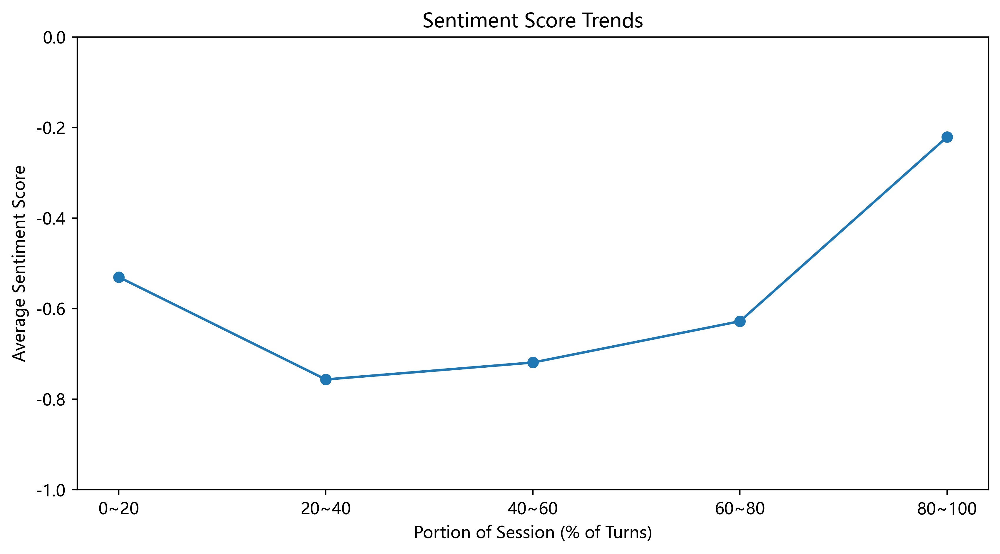

In [155]:
stage_score_total = stage_score_avg(in_chat_stage_score)

# Plotting
plt.figure(figsize=(10, 5))

plt.plot(stage_score_total['stage_label'], stage_score_total['stage_sentiment_score_avg'], marker='o')

plt.ylim(-1, 0)
plt.xlabel('Portion of Session (% of Turns)')
plt.ylabel('Average Sentiment Score')
plt.title('Sentiment Score Trends')
plt.show()

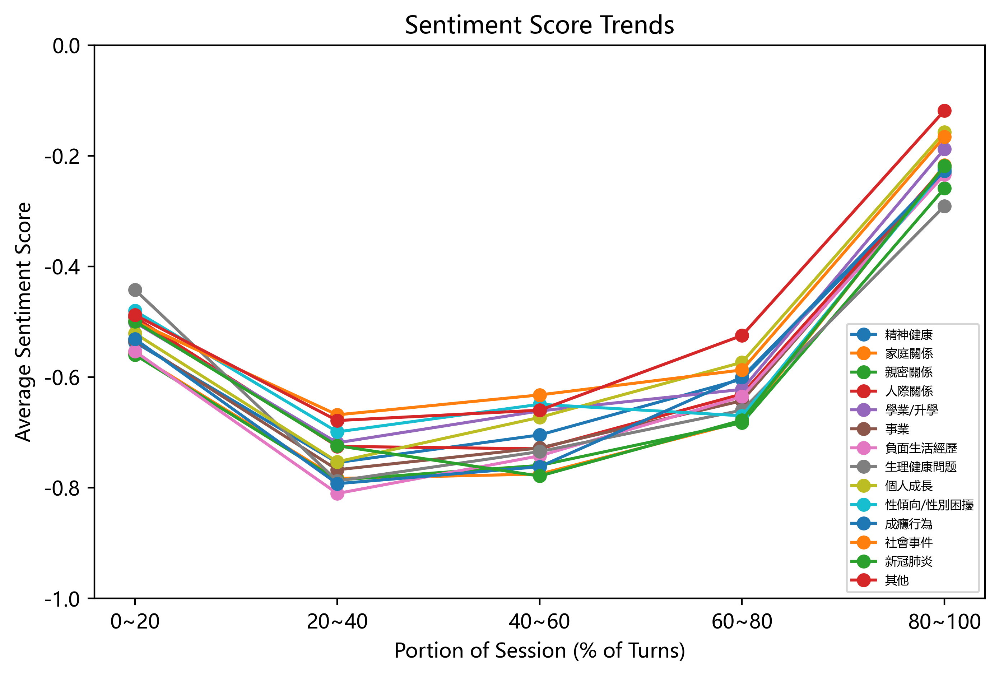

In [156]:
# Combine all DataFrames into a dictionary for easy plotting
stage_score_combined = {
    "stage_score_1": stage_score_1,
    "stage_score_2": stage_score_2,
    "stage_score_3": stage_score_3,
    "stage_score_4": stage_score_4,
    "stage_score_5": stage_score_5,
    "stage_score_6": stage_score_6,
    "stage_score_7": stage_score_7,
    "stage_score_8": stage_score_8,
    "stage_score_9": stage_score_9,
    "stage_score_10": stage_score_10,
    "stage_score_11": stage_score_11,
    "stage_score_12": stage_score_12,
    "stage_score_13": stage_score_13,
    "stage_score_14": stage_score_14
}

issue_dataset_label_mapping = {
     "stage_score_1": "精神健康",
     "stage_score_2": "家庭關係",
     "stage_score_3": "親密關係",
     "stage_score_4": "人際關係",
     "stage_score_5": "學業/升學",
     "stage_score_6": "事業",
     "stage_score_7": "負面生活經歷",
     "stage_score_8": "生理健康問题",
     "stage_score_9": "個人成長",
     "stage_score_10": "性傾向/性別困擾",
     "stage_score_11": "成癮行為",
     "stage_score_12": "社會事件",
     "stage_score_13": "新冠肺炎",
     "stage_score_14": "其他"
}

# Plotting
plt.figure(figsize=(8, 5))

for label, df in stage_score_combined.items():
    plt.plot(df['stage_label'], df['stage_sentiment_score_avg'], marker='o', label=issue_dataset_label_mapping[label])
    
plt.ylim(-1, 0)
plt.xlabel('Portion of Session (% of Turns)')
plt.ylabel('Average Sentiment Score')
plt.title('Sentiment Score Trends')
plt.legend(fontsize=6)
plt.show()

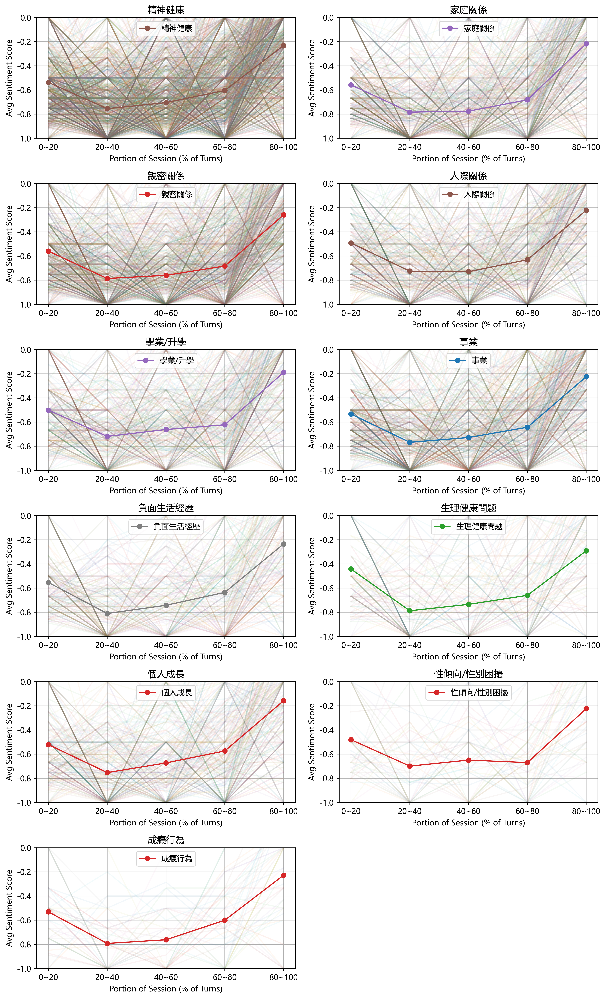

In [661]:
# Combine all DataFrames into a list for easy iteration
dataframes = [stage_score_1, stage_score_2, stage_score_3, stage_score_4, stage_score_5, stage_score_6,
              stage_score_7, stage_score_8, stage_score_9, stage_score_10, stage_score_11]
labels = ['精神健康', '家庭關係', '親密關係', '人際關係', '學業/升學', '事業',
          "負面生活經歷",
          "生理健康問题",
          "個人成長",
          "性傾向/性別困擾",
          "成癮行為"]

dataframes_conv = [in_chat_stage_q1_1, in_chat_stage_q1_2, in_chat_stage_q1_3, in_chat_stage_q1_4, in_chat_stage_q1_5, in_chat_stage_q1_6, in_chat_stage_q1_7, in_chat_stage_q1_8, in_chat_stage_q1_9, in_chat_stage_q1_10, in_chat_stage_q1_11]

# Plotting
fig, axes = plt.subplots(6, 2, figsize=(11, 18))  # 4 rows, 3 columns
axes = axes.flatten()  # Flatten the axes array for easy iteration

for i, (df, label, df_conv) in enumerate(zip(dataframes, labels, dataframes_conv)):
    # Add regression line for each conversation
    for conversation in df_conv['conversationId'].unique():
        subset = df_conv[df_conv['conversationId'] == conversation]
        sns.lineplot(data=subset, x='stage_label', y='stage_sentiment_score_avg', alpha=0.05, ax=axes[i])
    
    axes[i].plot(df['stage_label'], df['stage_sentiment_score_avg'], marker='o', label=label)
    axes[i].set_ylim(bottom=-1, top=0)
    axes[i].set_title(label)
    axes[i].set_xlabel('Portion of Session (% of Turns)')
    axes[i].set_ylabel('Avg Sentiment Score')
    axes[i].grid(True)
    axes[i].legend()

# Remove any empty subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

## statistical analysis

In [160]:
def mean_sd_sentiment_score(df, s):
    df_stage = df[(df['stage_label']==s)]
    print(df_stage['stage_sentiment_score_avg'].describe()[['mean', 'std']].round(2))
    
stage_label = ['0~20', '20~40', '40~60', '60~80', '80~100']
   
for s in stage_label:
    mean_sd_sentiment_score(in_chat_stage_q1_14, s)

mean   -0.49
std     0.33
Name: stage_sentiment_score_avg, dtype: float64
mean   -0.68
std     0.37
Name: stage_sentiment_score_avg, dtype: float64
mean   -0.66
std     0.41
Name: stage_sentiment_score_avg, dtype: float64
mean   -0.52
std     0.46
Name: stage_sentiment_score_avg, dtype: float64
mean   -0.12
std     0.55
Name: stage_sentiment_score_avg, dtype: float64


In [161]:
from scipy.stats import f_oneway
from statsmodels.stats.multicomp import pairwise_tukeyhsd
from itertools import combinations

In [162]:
def anova_f_oneway(df):
    # One-way ANOVA
    anova_result = f_oneway(
        df[df['stage_label'] == "0~20"]['stage_sentiment_score_avg'],
        df[df['stage_label'] == "20~40"]['stage_sentiment_score_avg'],
        df[df['stage_label'] == "40~60"]['stage_sentiment_score_avg'],
        df[df['stage_label'] == "60~80"]['stage_sentiment_score_avg'],
        df[df['stage_label'] == "80~100"]['stage_sentiment_score_avg'])
    print("ANOVA result:", anova_result)
    
    # Post hoc test (Tukey's HSD)
    tukey_result = pairwise_tukeyhsd(
        endog=df['stage_sentiment_score_avg'], 
        groups=df['stage_label'], 
        alpha=0.05)
    print("\nTukey's HSD result:")
    print(tukey_result)
    
    # Create table to present the necessary information
    anova_table = pd.DataFrame({
        'Source of Variation': ['Between Groups', 'Within Groups', 'Total'],
        'Sum of Squares': [anova_result.statistic, 'N/A', 'N/A'],
        'Degrees of Freedom': [4, len(df) - 5, len(df) - 1],
        'Mean Square': [anova_result.statistic / 4, 'N/A', 'N/A'],
        'F-statistic': [anova_result.statistic, 'N/A', 'N/A'],
        'P-value': [anova_result.pvalue, 'N/A', 'N/A']
    })

    print("\nANOVA Table:")
    print(anova_table)
    
    return anova_result, tukey_result, anova_table

In [163]:
anova_result, tukey_result, anova_table = anova_f_oneway(in_chat_stage_score)

ANOVA result: F_onewayResult(statistic=2068.362791341058, pvalue=0.0)

Tukey's HSD result:
Multiple Comparison of Means - Tukey HSD, FWER=0.05
group1 group2 meandiff p-adj  lower   upper  reject
---------------------------------------------------
  0~20  20~40  -0.2264   0.0 -0.2446 -0.2082   True
  0~20  40~60  -0.1889   0.0 -0.2071 -0.1708   True
  0~20  60~80  -0.0978   0.0 -0.1159 -0.0796   True
  0~20 80~100   0.3094   0.0  0.2912  0.3276   True
 20~40  40~60   0.0374   0.0  0.0193  0.0556   True
 20~40  60~80   0.1286   0.0  0.1104  0.1468   True
 20~40 80~100   0.5358   0.0  0.5176   0.554   True
 40~60  60~80   0.0912   0.0   0.073  0.1094   True
 40~60 80~100   0.4984   0.0  0.4802  0.5165   True
 60~80 80~100   0.4072   0.0   0.389  0.4254   True
---------------------------------------------------

ANOVA Table:
  Source of Variation Sum of Squares  Degrees of Freedom Mean Square  \
0      Between Groups    2068.362791                   4  517.090698   
1       Within Groups  

In [164]:
print('精神健康')
anova_result1, tukey_result1, anova_table1 = anova_f_oneway(in_chat_stage_q1_1)
print('家庭關係')
anova_result2, tukey_result2, anova_table2 = anova_f_oneway(in_chat_stage_q1_2)
print('親密關係')
anova_result3, tukey_result3, anova_table3 = anova_f_oneway(in_chat_stage_q1_3)
print('人際關係')
anova_result4, tukey_result4, anova_table4 = anova_f_oneway(in_chat_stage_q1_4)
print('學業/升學')
anova_result5, tukey_result5, anova_table5 = anova_f_oneway(in_chat_stage_q1_5)
print('事業')
anova_result6, tukey_result6, anova_table6 = anova_f_oneway(in_chat_stage_q1_6)
print('負面生活經歷')
anova_result7, tukey_result7, anova_table7 = anova_f_oneway(in_chat_stage_q1_7)
print('生理健康問题')
anova_result8, tukey_result8, anova_table8 = anova_f_oneway(in_chat_stage_q1_8)
print('個人成長')
anova_result9, tukey_result9, anova_table9 = anova_f_oneway(in_chat_stage_q1_9)
print('性傾向/性別困擾')
anova_result10, tukey_result10, anova_table10 = anova_f_oneway(in_chat_stage_q1_10)
print('成癮行為')
anova_result11, tukey_result11, anova_table11 = anova_f_oneway(in_chat_stage_q1_11)

print('社會事件')
anova_result9, tukey_result9, anova_table9 = anova_f_oneway(in_chat_stage_q1_12)
print('新冠肺炎')
anova_result10, tukey_result10, anova_table10 = anova_f_oneway(in_chat_stage_q1_13)
print('其他')
anova_result11, tukey_result11, anova_table11 = anova_f_oneway(in_chat_stage_q1_14)

精神健康
ANOVA result: F_onewayResult(statistic=616.8978599211538, pvalue=0.0)

Tukey's HSD result:
Multiple Comparison of Means - Tukey HSD, FWER=0.05 
group1 group2 meandiff p-adj   lower   upper  reject
----------------------------------------------------
  0~20  20~40  -0.2176    0.0 -0.2496 -0.1857   True
  0~20  40~60  -0.1677    0.0 -0.1996 -0.1357   True
  0~20  60~80  -0.0667    0.0 -0.0987 -0.0348   True
  0~20 80~100    0.306    0.0   0.274   0.338   True
 20~40  40~60     0.05 0.0002   0.018  0.0819   True
 20~40  60~80   0.1509    0.0   0.119  0.1829   True
 20~40 80~100   0.5236    0.0  0.4917  0.5556   True
 40~60  60~80    0.101    0.0   0.069  0.1329   True
 40~60 80~100   0.4737    0.0  0.4417  0.5056   True
 60~80 80~100   0.3727    0.0  0.3408  0.4047   True
----------------------------------------------------

ANOVA Table:
  Source of Variation Sum of Squares  Degrees of Freedom Mean Square  \
0      Between Groups      616.89786                   4  154.224465   
1   

#Plotting the sentiment scores
plt.figure(figsize=(10, 6))
sns.boxplot(x='stage_label', y='stage_sentiment_score_avg', data=in_chat_stage_coun_q1_1)
plt.title('Sentiment Scores Across Stages')
plt.xlabel('Stage of Counseling')
plt.ylabel('Average Sentiment Score')
plt.show()

In [165]:
# Function to calculate Cohen's d
def cohen_d(group1, group2):
    n1, n2 = len(group1), len(group2)
    mean1, mean2 = np.mean(group1), np.mean(group2)
    std1, std2 = np.std(group1, ddof=1), np.std(group2, ddof=1)
    pooled_std = np.sqrt(((n1 - 1) * std1**2 + (n2 - 1) * std2**2) / (n1 + n2 - 2))
    d = (mean1 - mean2) / pooled_std
    return d

def calculate_cohen_d(df):
    # List of stages
    stages = df['stage_label'].unique()

    # Calculate Cohen's d for each pair of stages
    cohen_d_results = []
    for stage1, stage2 in combinations(stages, 2):
        group1 = df[df['stage_label'] == stage1]['stage_sentiment_score_avg']
        group2 = df[df['stage_label'] == stage2]['stage_sentiment_score_avg']
        d = cohen_d(group1, group2)
        cohen_d_results.append((stage1, stage2, d))

    # Convert results to a DataFrame
    cohen_d_df = pd.DataFrame(cohen_d_results, columns=['Stage 1', 'Stage 2', 'Cohen\'s d'])

    # Display the results
    return cohen_d_df

In [167]:
cohend = calculate_cohen_d(in_chat_stage_q1_12)
cohend['Cohen\'s d'] = cohend['Cohen\'s d'].round(2)
print(cohend[((cohend['Stage 1'] == '0~20'))&(cohend['Stage 2'] == '20~40')])
print(cohend[((cohend['Stage 1'] == '20~40'))&(cohend['Stage 2'] == '40~60')])
print(cohend[((cohend['Stage 1'] == '40~60'))&(cohend['Stage 2'] == '60~80')])
print(cohend[((cohend['Stage 1'] == '60~80'))&(cohend['Stage 2'] == '80~100')])
print(cohend[((cohend['Stage 1'] == '0~20'))&(cohend['Stage 2'] == '80~100')])

  Stage 1 Stage 2  Cohen's d
0    0~20   20~40       0.54
  Stage 1 Stage 2  Cohen's d
4   20~40   40~60       -0.1
  Stage 1 Stage 2  Cohen's d
7   40~60   60~80      -0.11
  Stage 1 Stage 2  Cohen's d
9   60~80  80~100      -0.83
  Stage 1 Stage 2  Cohen's d
3    0~20  80~100      -0.71


In [175]:
in_chat_stage_score['stage_label'].value_counts()

0~20      6207
20~40     6207
40~60     6207
60~80     6207
80~100    6207
Name: stage_label, dtype: int64

In [183]:
in_chat_stage_score['stage_sentiment_score_avg'] = round(in_chat_stage_score['stage_sentiment_score_avg'], 3)
in_chat_stage_score

,conversationId,stage_label,stage_sentiment_score_sum,stage_msg_count,stage_sentiment_score_avg
0,000000c7-0b79-4a6f-aecd-895fb97aaca7,0~20,-2,4,-0.500
1,000000c7-0b79-4a6f-aecd-895fb97aaca7,20~40,-3,5,-0.600
2,000000c7-0b79-4a6f-aecd-895fb97aaca7,40~60,-2,4,-0.500
3,000000c7-0b79-4a6f-aecd-895fb97aaca7,60~80,-2,5,-0.400
4,000000c7-0b79-4a6f-aecd-895fb97aaca7,80~100,-1,5,-0.200
...,...,...,...,...,...
31030,ffdd2d57-daa5-4172-bc6b-72671bb529f1,0~20,-1,2,-0.500
31031,ffdd2d57-daa5-4172-bc6b-72671bb529f1,20~40,-2,3,-0.667
31032,ffdd2d57-daa5-4172-bc6b-72671bb529f1,40~60,-1,3,-0.333
31033,ffdd2d57-daa5-4172-bc6b-72671bb529f1,60~80,-3,3,-1.000


In [184]:
in_chat_stage_score.to_excel('../data/conv_stage_sentiment_score_avg_allIssue.xlsx', index=False)

# latent trajectory modeling

In [185]:
df_cm = pd.read_excel('../data/class_membership_20250125.xlsx')
df_score_r = pd.read_excel('../data/conv_stage_avg_sentiment_score_allIssue_r.xlsx')

In [186]:
df_score_r_id = df_score_r[['conversationId', 'conversationId_numeric']]
df_score_r_id = df_score_r_id.drop_duplicates()

In [187]:
df_score_r_id

,conversationId,conversationId_numeric
0,000000c7-0b79-4a6f-aecd-895fb97aaca7,1
5,00062144-d067-49e6-b674-5af3b9aadfd9,2
10,001ffc47-49fd-4751-ab78-6fa7e00758bf,3
15,00258ce1-38d2-40f3-8f26-2d83bdc4a1c8,4
20,002e15e7-21ee-4039-8dbf-015aaae66649,6
...,...,...
31010,fd789a3e-8332-4fe3-9fd8-90cbef8b3e34,6137
31015,feb6566d-73ab-4f0c-b515-8e78e2e3d3bf,6174
31020,fecbd6be-b795-49f0-a7f2-1fe9ef88021d,6176
31025,ff8e40b7-9813-4af6-b6b4-042a3780e7bb,6197


### calculate issue counts in each latent class

In [188]:
df_cm_gb = pd.merge(df_cm, df_score_r_id, on=['conversationId_numeric'], how='left')
df_cm_gb

,conversationId_numeric,class,prob1,prob2,prob3,conversationId
0,1,1,0.693927,0.002196,0.303877,000000c7-0b79-4a6f-aecd-895fb97aaca7
1,2,3,0.002104,0.047198,0.950698,00062144-d067-49e6-b674-5af3b9aadfd9
2,3,3,0.049759,0.013073,0.937167,001ffc47-49fd-4751-ab78-6fa7e00758bf
3,4,3,0.129735,0.246180,0.624085,00258ce1-38d2-40f3-8f26-2d83bdc4a1c8
4,5,3,0.005952,0.088535,0.905513,0025963d-8eb6-4977-ae2c-d3bb57efce21
...,...,...,...,...,...,...
6202,6203,1,0.985007,0.000002,0.014990,ffc936c5-aed6-49bf-9f5b-7f2dbc281c2b
6203,6204,1,0.670482,0.000173,0.329345,ffdc786a-f945-4565-a91b-06994285d88e
6204,6205,3,0.175476,0.107125,0.717399,ffdd2d57-daa5-4172-bc6b-72671bb529f1
6205,6206,3,0.185680,0.102746,0.711574,fff8f2ce-e50c-4946-9648-db5f0756df45


In [190]:
df_cm_gb['class'].value_counts()/6207

3    0.631062
1    0.188658
2    0.180280
Name: class, dtype: float64

In [192]:
df_cm_issue_gb = pd.merge(df_cm_gb, df_q1_sample, on=['conversationId'], how='left')
df_cm_issue_gb

,conversationId_numeric,class,prob1,prob2,prob3,conversationId,issue_category
0,1,1,0.693927,0.002196,0.303877,000000c7-0b79-4a6f-aecd-895fb97aaca7,1
1,2,3,0.002104,0.047198,0.950698,00062144-d067-49e6-b674-5af3b9aadfd9,2
2,3,3,0.049759,0.013073,0.937167,001ffc47-49fd-4751-ab78-6fa7e00758bf,5
3,4,3,0.129735,0.246180,0.624085,00258ce1-38d2-40f3-8f26-2d83bdc4a1c8,1
4,5,3,0.005952,0.088535,0.905513,0025963d-8eb6-4977-ae2c-d3bb57efce21,14
...,...,...,...,...,...,...,...
6202,6203,1,0.985007,0.000002,0.014990,ffc936c5-aed6-49bf-9f5b-7f2dbc281c2b,1
6203,6204,1,0.670482,0.000173,0.329345,ffdc786a-f945-4565-a91b-06994285d88e,9
6204,6205,3,0.175476,0.107125,0.717399,ffdd2d57-daa5-4172-bc6b-72671bb529f1,14
6205,6206,3,0.185680,0.102746,0.711574,fff8f2ce-e50c-4946-9648-db5f0756df45,5


In [193]:
# Group by class and issue category to count the occurrences
issue_counts = df_cm_issue_gb.groupby(['class', 'issue_category']).size().reset_index(name='issue_count')
issue_counts = issue_counts.sort_values(by=['class', 'issue_count'], ascending=False)
issue_counts

,class,issue_category,issue_count
28,3,1,1215
35,3,3,639
38,3,6,418
34,3,2,365
36,3,4,308
...,...,...,...
12,1,8,20
1,1,10,12
3,1,12,9
2,1,11,7


### find the conversations with each stage score in each latent class

In [194]:
df_cm1 = df_cm_issue_gb[(df_cm_issue_gb['class']==1)]
df_cm2 = df_cm_issue_gb[(df_cm_issue_gb['class']==2)]
df_cm3 = df_cm_issue_gb[(df_cm_issue_gb['class']==3)]

In [195]:
# find the conversations with each stage score in each latent class
df_chat_cm1 = in_chat_stage_score[(in_chat_stage_score['conversationId'].isin(df_cm1['conversationId']))]
df_chat_cm2 = in_chat_stage_score[(in_chat_stage_score['conversationId'].isin(df_cm2['conversationId']))]
df_chat_cm3 = in_chat_stage_score[(in_chat_stage_score['conversationId'].isin(df_cm3['conversationId']))]

In [196]:
df_chat_stage_cm1 = stage_score_avg(df_chat_cm1)
df_chat_stage_cm2 = stage_score_avg(df_chat_cm2)
df_chat_stage_cm3 = stage_score_avg(df_chat_cm3)

In [197]:
df_chat_stage_cm1

,stage_label,stage_sentiment_score_avg
0,0~20,-0.487966
1,20~40,-0.488290
2,40~60,-0.322368
3,60~80,-0.251742
4,80~100,0.008983


In [198]:
df_chat_stage_cm2

,stage_label,stage_sentiment_score_avg
0,0~20,-0.424492
1,20~40,-0.808664
2,40~60,-0.843543
3,60~80,-0.852542
4,80~100,-0.917099


In [199]:
df_chat_stage_cm3

,stage_label,stage_sentiment_score_avg
0,0~20,-0.573150
1,20~40,-0.822024
2,40~60,-0.802326
3,60~80,-0.676368
4,80~100,-0.090671


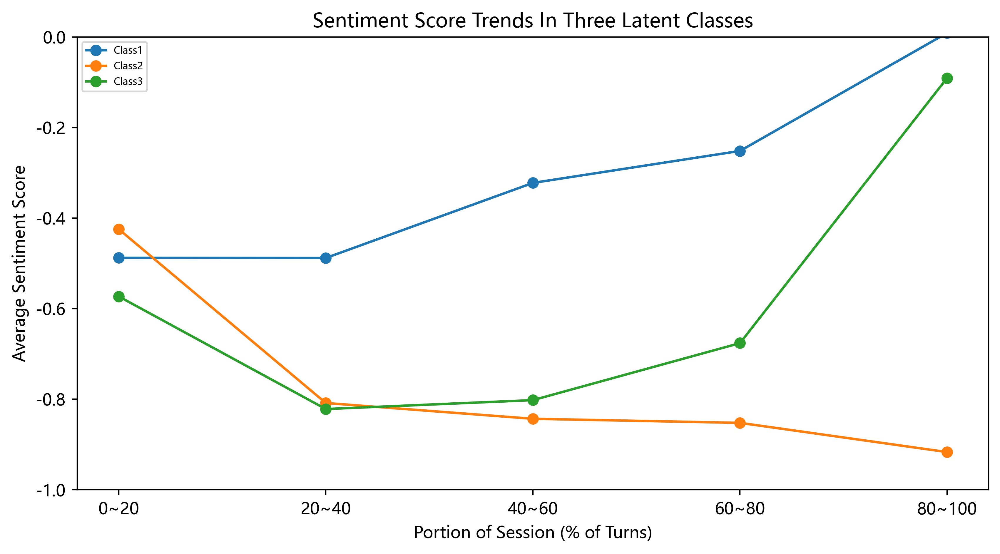

In [200]:
# Combine all DataFrames into a dictionary for easy plotting
latent_class_combined = {
    "chat_stage_1": df_chat_stage_cm1,
    "chat_stage_2": df_chat_stage_cm2,
    "chat_stage_3": df_chat_stage_cm3,
}

latent_class_label_mapping = {
     "chat_stage_1": "Class1",
     "chat_stage_2": "Class2",
     "chat_stage_3": "Class3"
}

# Plotting
plt.figure(figsize=(10, 5))

for label, df in latent_class_combined.items():
    plt.plot(df['stage_label'], df['stage_sentiment_score_avg'], marker='o', label=latent_class_label_mapping[label])
    
plt.ylim(-1, 0)
plt.xlabel('Portion of Session (% of Turns)')
plt.ylabel('Average Sentiment Score')
plt.title('Sentiment Score Trends In Three Latent Classes')
plt.legend(fontsize=6)
plt.show()

# issue group analysis

In [201]:
issue_counts['class_count_sum'] = issue_counts.groupby(['class']).transform('sum')
issue_counts['issue_percentage'] = round(issue_counts['issue_count']/issue_counts['class_count_sum'], 3)
issue_counts.reset_index(inplace=True, drop=True)

In [202]:
issue_counts['issue_category'] = issue_counts['issue_category'].astype(int)
replace_tag = {1:'精神健康', 2:'家庭關係', 3:'親密關係', 4:'朋輩關係，同事關係，或其他人際關係', 5:'學業/升學', 6:'事業，例如工作壓力，職業前景，失業等', 7:'負面生活經歷，例如被欺凌，虐待，債務問題，性侵等', 8:'生理健康問题，例如身型，皮膚，身體疾病等', 9:'個人成長，例如性格發展，自我認知，適應接納等', 10:'性傾向/性別困擾', 11:'成癮行為', 12:'社會事件', 13:'新冠肺炎', 14:'其他'}
issue_counts['issue'] = issue_counts['issue_category'].replace(replace_tag)
issue_counts = issue_counts.sort_values(by=['class', 'issue_count'], ascending=True)

issue_counts

,class,issue_category,issue_count,class_count_sum,issue_percentage,issue
41,1,13,6,1171,0.005,新冠肺炎
40,1,11,7,1171,0.006,成癮行為
39,1,12,9,1171,0.008,社會事件
38,1,10,12,1171,0.010,性傾向/性別困擾
37,1,8,20,1171,0.017,生理健康問题，例如身型，皮膚，身體疾病等
...,...,...,...,...,...,...
4,3,4,308,3917,0.079,朋輩關係，同事關係，或其他人際關係
3,3,2,365,3917,0.093,家庭關係
2,3,6,418,3917,0.107,事業，例如工作壓力，職業前景，失業等
1,3,3,639,3917,0.163,親密關係


In [203]:
issue_colors = {'精神健康', '家庭關係', '親密關係', '朋輩關係，同事關係，或其他人際關係', '學業/升學', '事業，例如工作壓力，職業前景，失業等', '負面生活經歷，例如被欺凌，虐待，債務問題，性侵等', '生理健康問题，例如身型，皮膚，身體疾病等', '個人成長，例如性格發展，自我認知，適應接納等', '性傾向/性別困擾', '成癮行為'}

# Get the tab10 colormap
tab20 = plt.get_cmap('Paired')

# Create the color mapping
issue_colors = {issue: tab20(i) for i, issue in enumerate(issue_colors)}

issue_colors['學業/升學'] = (0.8901960784313725, 0.10196078431372549, 0.10980392156862745, 1.0)
issue_colors['生理健康問题，例如身型，皮膚，身體疾病等'] = (0.6509803921568628, 0.807843137254902, 0.8901960784313725, 1.0)

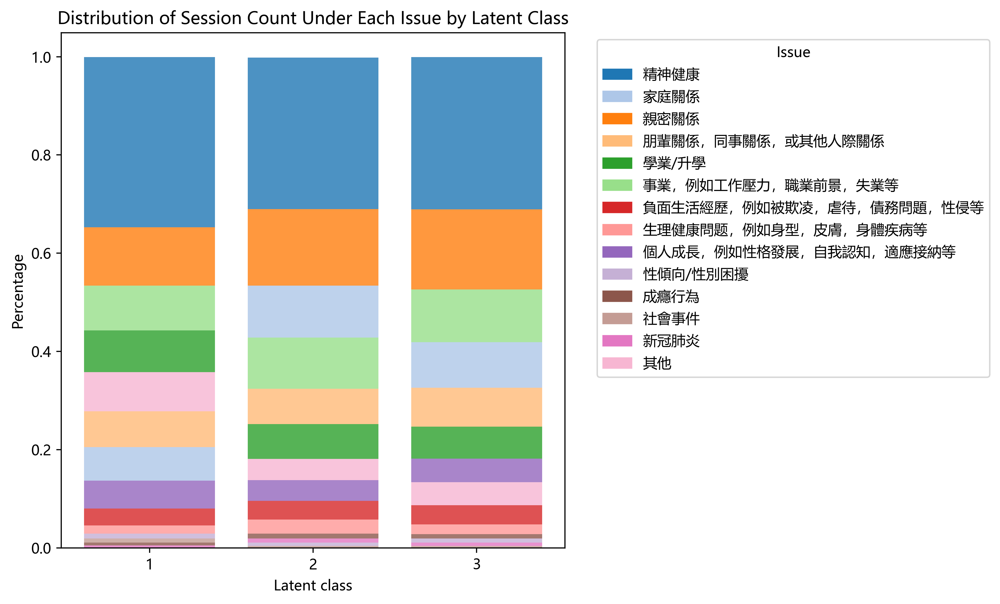

In [204]:
# Use the Set2 colormap for a more academic and visually appealing palette
colormap = plt.get_cmap('tab20')

# Define the issue categories and corresponding colors using Set2 colormap
issue_colors = {
    '精神健康': colormap(0),
    '家庭關係': colormap(1),
    '親密關係': colormap(2),
    '朋輩關係，同事關係，或其他人際關係': colormap(3),
    '學業/升學': colormap(4),
    '事業，例如工作壓力，職業前景，失業等': colormap(5),
    '負面生活經歷，例如被欺凌，虐待，債務問題，性侵等': colormap(6),
    '生理健康問题，例如身型，皮膚，身體疾病等': colormap(7),
    '個人成長，例如性格發展，自我認知，適應接納等': colormap(8),
    '性傾向/性別困擾': colormap(9),
    '成癮行為': colormap(10),
    '社會事件': colormap(11),
    '新冠肺炎': colormap(12),
    '其他': colormap(13)
}

# Initialize the figure
fig, ax = plt.subplots(figsize=(10, 6))

# Initialize bottom_dict to keep track of where each stack starts
bottom_dict = {1: 0, 2: 0, 3: 0}

# Iterate over the rows in the dataframe to plot each issue category
for _, row in issue_counts.iterrows():
    ax.bar(
        row['class'], 
        row['issue_percentage'], 
        bottom=bottom_dict[row['class']], 
        label=row['issue'], 
        color=issue_colors[row['issue']],
        alpha=0.8
    )
    bottom_dict[row['class']] += row['issue_percentage']

# Customizing the plot
ax.set_ylabel('Percentage')
ax.set_xlabel('Latent class')
ax.set_title('Distribution of Session Count Under Each Issue by Latent Class')

ax.set_xticks([1,2,3])
# Create custom legend
handles = [plt.Rectangle((0,0),1,1, color=issue_colors[issue]) for issue in issue_colors]
labels = list(issue_colors.keys())
ax.legend(handles, labels, title='Issue', bbox_to_anchor=(1.05, 1), loc='upper left')

plt.tight_layout()
plt.show()

In [208]:
# Create a contingency table
issue_contingency_table = pd.pivot_table(issue_counts, values='issue_count', index='issue_category', columns='class')
issue_contingency_table.head(14)

class,1,2,3
issue_category,,,
1,405,345,1215
2,80,119,365
3,139,175,639
4,86,81,308
5,100,80,254
6,106,116,418
7,40,43,154
8,20,32,80
9,67,47,189


In [212]:
issue_contingency_table.iloc[:, 2].tolist()

[1215, 365, 639, 308, 254, 418, 154, 80, 189, 33, 35, 15, 29, 183]

In [217]:
from scipy.stats import chi2_contingency

data = {'issue': range(1,15), 
        'class1': [405, 80, 139, 86, 100, 106, 40, 20, 67, 12, 7, 9, 6, 94], 
        'class2': [345, 119, 175, 81, 80, 116, 43, 32, 47, 8, 11, 5, 9, 48], 
        'class3': [1215, 365, 639, 308, 254, 418, 154, 80, 189, 33, 35, 15, 29, 183]}

df = pd.DataFrame(data)
df.set_index('issue', inplace=True)

# Perform the chi-square test
chi2, p, dof, ex = chi2_contingency(df)

print("\nChi-Square Test Results:")
print(f"Chi-Square Statistic: {chi2}")
print(f"P-Value: {p}")
print(f"Degrees of Freedom: {dof}")
print("Expected Frequencies Table:")
print(ex)

# Interpretation
if p < 0.05:
    print("There is a significant association between topic and class.")
else:
    print("There is no significant association between topic and class.")
    
# Calculate Odds Ratios with Continuity Correction
def calc_odds_ratio_with_continuity(table, correction=0.5):
    odds_ratios = {}
    conf_intervals = {}
    
    genders = table.index
    classes = table.columns

    for gender in genders:
        for i in range(len(classes)):
            for j in range(i + 1, len(classes)):
                class1 = classes[i]
                class2 = classes[j]
                
                # Contingency table for the pair of classes for this gender
                a = table.loc[gender, class1] + correction
                b = table.loc[gender, class2] + correction
                c = table[class1].sum() - a + correction
                d = table[class2].sum() - b + correction

                odds_ratio = (a / c) / (b / d)
                se = np.sqrt(1/a + 1/b + 1/c + 1/d)
                conf_interval = np.exp(np.log(odds_ratio) + np.array([-1, 1]) * 1.96 * se)

                key = f'{gender}: {class1} vs {class2}'
                odds_ratios[key] = odds_ratio
                conf_intervals[key] = conf_interval

    return odds_ratios, conf_intervals

odds_ratios, conf_intervals = calc_odds_ratio_with_continuity(df)

print("\nOdds Ratios with 95% Confidence Intervals:")
for key in odds_ratios:
    print(f"{key}: OR = {odds_ratios[key]:.2f}, 95% CI = {conf_intervals[key]}")


Chi-Square Test Results:
Chi-Square Statistic: 68.35423926362334
P-Value: 1.1483642358884146e-05
Degrees of Freedom: 26
Expected Frequencies Table:
[[ 370.71290478  354.25084582 1240.0362494 ]
 [ 106.40309328  101.67810536  355.91880135]
 [ 179.79104237  171.80715321  601.40180441]
 [  89.61253424   85.63315611  299.75430965]
 [  81.8775576    78.24166264  273.88077976]
 [ 120.74109876  115.37941034  403.8794909 ]
 [  44.71193813   42.72643789  149.56162397]
 [  24.90285162   23.79700338   83.300145  ]
 [  57.16336394   54.62493958  191.21169647]
 [   9.99887224    9.55485742   33.44627034]
 [   9.99887224    9.55485742   33.44627034]
 [   5.47108104    5.22812953   18.30078943]
 [   8.30095054    7.93233446   27.766715  ]
 [  61.31383921   58.59110681  205.09505397]]
There is a significant association between topic and class.

Odds Ratios with 95% Confidence Intervals:
1: class1 vs class2: OR = 1.19, 95% CI = [0.99568123 1.41250397]
1: class1 vs class3: OR = 1.18, 95% CI = [1.0249840

In [218]:
# 11 issue groups under class 1
class1_stage_q1_1 = df_chat_cm1[(df_chat_cm1['conversationId'].isin(df_q1_1['conversationId']))]
class1_stage_q1_2 = df_chat_cm1[(df_chat_cm1['conversationId'].isin(df_q1_2['conversationId']))]
class1_stage_q1_3 = df_chat_cm1[(df_chat_cm1['conversationId'].isin(df_q1_3['conversationId']))]
class1_stage_q1_4 = df_chat_cm1[(df_chat_cm1['conversationId'].isin(df_q1_4['conversationId']))]
class1_stage_q1_5 = df_chat_cm1[(df_chat_cm1['conversationId'].isin(df_q1_5['conversationId']))]
class1_stage_q1_6 = df_chat_cm1[(df_chat_cm1['conversationId'].isin(df_q1_6['conversationId']))]
class1_stage_q1_7 = df_chat_cm1[(df_chat_cm1['conversationId'].isin(df_q1_7['conversationId']))]
class1_stage_q1_8 = df_chat_cm1[(df_chat_cm1['conversationId'].isin(df_q1_8['conversationId']))]
class1_stage_q1_9 = df_chat_cm1[(df_chat_cm1['conversationId'].isin(df_q1_9['conversationId']))]
class1_stage_q1_10 = df_chat_cm1[(df_chat_cm1['conversationId'].isin(df_q1_10['conversationId']))]
class1_stage_q1_11 = df_chat_cm1[(df_chat_cm1['conversationId'].isin(df_q1_11['conversationId']))]

class1_stage_q1_12 = df_chat_cm1[(df_chat_cm1['conversationId'].isin(df_q1_12['conversationId']))]
class1_stage_q1_13 = df_chat_cm1[(df_chat_cm1['conversationId'].isin(df_q1_13['conversationId']))]
class1_stage_q1_14 = df_chat_cm1[(df_chat_cm1['conversationId'].isin(df_q1_14['conversationId']))]

# 11 issue groups under class 2
class2_stage_q1_1 = df_chat_cm2[(df_chat_cm2['conversationId'].isin(df_q1_1['conversationId']))]
class2_stage_q1_2 = df_chat_cm2[(df_chat_cm2['conversationId'].isin(df_q1_2['conversationId']))]
class2_stage_q1_3 = df_chat_cm2[(df_chat_cm2['conversationId'].isin(df_q1_3['conversationId']))]
class2_stage_q1_4 = df_chat_cm2[(df_chat_cm2['conversationId'].isin(df_q1_4['conversationId']))]
class2_stage_q1_5 = df_chat_cm2[(df_chat_cm2['conversationId'].isin(df_q1_5['conversationId']))]
class2_stage_q1_6 = df_chat_cm2[(df_chat_cm2['conversationId'].isin(df_q1_6['conversationId']))]
class2_stage_q1_7 = df_chat_cm2[(df_chat_cm2['conversationId'].isin(df_q1_7['conversationId']))]
class2_stage_q1_8 = df_chat_cm2[(df_chat_cm2['conversationId'].isin(df_q1_8['conversationId']))]
class2_stage_q1_9 = df_chat_cm2[(df_chat_cm2['conversationId'].isin(df_q1_9['conversationId']))]
class2_stage_q1_10 = df_chat_cm2[(df_chat_cm2['conversationId'].isin(df_q1_10['conversationId']))]
class2_stage_q1_11 = df_chat_cm2[(df_chat_cm2['conversationId'].isin(df_q1_11['conversationId']))]

class1_stage_q1_12 = df_chat_cm2[(df_chat_cm2['conversationId'].isin(df_q1_12['conversationId']))]
class1_stage_q1_13 = df_chat_cm2[(df_chat_cm2['conversationId'].isin(df_q1_13['conversationId']))]
class1_stage_q1_14 = df_chat_cm2[(df_chat_cm2['conversationId'].isin(df_q1_14['conversationId']))]

# 11 issue groups under class 3
class3_stage_q1_1 = df_chat_cm3[(df_chat_cm3['conversationId'].isin(df_q1_1['conversationId']))]
class3_stage_q1_2 = df_chat_cm3[(df_chat_cm3['conversationId'].isin(df_q1_2['conversationId']))]
class3_stage_q1_3 = df_chat_cm3[(df_chat_cm3['conversationId'].isin(df_q1_3['conversationId']))]
class3_stage_q1_4 = df_chat_cm3[(df_chat_cm3['conversationId'].isin(df_q1_4['conversationId']))]
class3_stage_q1_5 = df_chat_cm3[(df_chat_cm3['conversationId'].isin(df_q1_5['conversationId']))]
class3_stage_q1_6 = df_chat_cm3[(df_chat_cm3['conversationId'].isin(df_q1_6['conversationId']))]
class3_stage_q1_7 = df_chat_cm3[(df_chat_cm3['conversationId'].isin(df_q1_7['conversationId']))]
class3_stage_q1_8 = df_chat_cm3[(df_chat_cm3['conversationId'].isin(df_q1_8['conversationId']))]
class3_stage_q1_9 = df_chat_cm3[(df_chat_cm3['conversationId'].isin(df_q1_9['conversationId']))]
class3_stage_q1_10 = df_chat_cm3[(df_chat_cm3['conversationId'].isin(df_q1_10['conversationId']))]
class3_stage_q1_11 = df_chat_cm3[(df_chat_cm3['conversationId'].isin(df_q1_11['conversationId']))]

class1_stage_q1_12 = df_chat_cm3[(df_chat_cm3['conversationId'].isin(df_q1_12['conversationId']))]
class1_stage_q1_13 = df_chat_cm3[(df_chat_cm3['conversationId'].isin(df_q1_13['conversationId']))]
class1_stage_q1_14 = df_chat_cm3[(df_chat_cm3['conversationId'].isin(df_q1_14['conversationId']))]

In [219]:
# overall
print('class1')
anova_f_oneway(df_chat_cm1)
print('>>>>>>>>>>>>>>>>>>>>>>>>')
print('class2')
anova_f_oneway(df_chat_cm2)
print('>>>>>>>>>>>>>>>>>>>>>>>>')
print('class3')
anova_f_oneway(df_chat_cm3)

class1
ANOVA result: F_onewayResult(statistic=358.5704792106659, pvalue=1.6248176504040864e-276)

Tukey's HSD result:
Multiple Comparison of Means - Tukey HSD, FWER=0.05
group1 group2 meandiff p-adj  lower  upper  reject
--------------------------------------------------
  0~20  20~40  -0.0003   1.0 -0.0422 0.0415  False
  0~20  40~60   0.1656   0.0  0.1237 0.2075   True
  0~20  60~80   0.2362   0.0  0.1944 0.2781   True
  0~20 80~100   0.4969   0.0  0.4551 0.5388   True
 20~40  40~60   0.1659   0.0  0.1241 0.2078   True
 20~40  60~80   0.2365   0.0  0.1947 0.2784   True
 20~40 80~100   0.4973   0.0  0.4554 0.5391   True
 40~60  60~80   0.0706   0.0  0.0288 0.1125   True
 40~60 80~100   0.3314   0.0  0.2895 0.3732   True
 60~80 80~100   0.2607   0.0  0.2189 0.3026   True
--------------------------------------------------

ANOVA Table:
  Source of Variation Sum of Squares  Degrees of Freedom Mean Square  \
0      Between Groups     358.570479                   4    89.64262   
1       W

(F_onewayResult(statistic=3838.722605307157, pvalue=0.0),
   Source of Variation Sum of Squares  Degrees of Freedom Mean Square  \
 0      Between Groups    3838.722605                   4  959.680651   
 1       Within Groups            N/A               19580         N/A   
 2               Total            N/A               19584         N/A   
 
    F-statistic P-value  
 0  3838.722605     0.0  
 1          N/A     N/A  
 2          N/A     N/A  )

In [220]:
print('精神健康')
anova_result1, tukey_result1, anova_table1 = anova_f_oneway(class1_stage_q1_1)
print('家庭關係')
anova_result2, tukey_result2, anova_table2 = anova_f_oneway(class1_stage_q1_2)
print('親密關係')
anova_result3, tukey_result3, anova_table3 = anova_f_oneway(class1_stage_q1_3)
print('人際關係')
anova_result4, tukey_result4, anova_table4 = anova_f_oneway(class1_stage_q1_4)
print('學業/升學')
anova_result5, tukey_result5, anova_table5 = anova_f_oneway(class1_stage_q1_5)
print('事業')
anova_result6, tukey_result6, anova_table6 = anova_f_oneway(class1_stage_q1_6)
print('負面生活經歷')
anova_result7, tukey_result7, anova_table7 = anova_f_oneway(class1_stage_q1_7)
print('生理健康問题')
anova_result8, tukey_result8, anova_table8 = anova_f_oneway(class1_stage_q1_8)
print('個人成長')
anova_result9, tukey_result9, anova_table9 = anova_f_oneway(class1_stage_q1_9)
print('性傾向/性別困擾')
anova_result10, tukey_result10, anova_table10 = anova_f_oneway(class1_stage_q1_10)
print('成癮行為')
anova_result11, tukey_result11, anova_table11 = anova_f_oneway(class1_stage_q1_11)

精神健康
ANOVA result: F_onewayResult(statistic=139.48849296560817, pvalue=2.283491384289552e-105)

Tukey's HSD result:
Multiple Comparison of Means - Tukey HSD, FWER=0.05
group1 group2 meandiff p-adj   lower  upper  reject
---------------------------------------------------
  0~20  20~40  -0.0085 0.9973 -0.0776 0.0606  False
  0~20  40~60   0.1698    0.0  0.1006 0.2389   True
  0~20  60~80   0.2686    0.0  0.1995 0.3377   True
  0~20 80~100   0.5012    0.0   0.432 0.5703   True
 20~40  40~60   0.1783    0.0  0.1091 0.2474   True
 20~40  60~80   0.2771    0.0   0.208 0.3462   True
 20~40 80~100   0.5097    0.0  0.4405 0.5788   True
 40~60  60~80   0.0988 0.0009  0.0297  0.168   True
 40~60 80~100   0.3314    0.0  0.2623 0.4005   True
 60~80 80~100   0.2326    0.0  0.1634 0.3017   True
---------------------------------------------------

ANOVA Table:
  Source of Variation Sum of Squares  Degrees of Freedom Mean Square  \
0      Between Groups     139.488493                   4   34.872123  

In [221]:
print('精神健康')
anova_result1, tukey_result1, anova_table1 = anova_f_oneway(class2_stage_q1_1)
print('家庭關係')
anova_result2, tukey_result2, anova_table2 = anova_f_oneway(class2_stage_q1_2)
print('親密關係')
anova_result3, tukey_result3, anova_table3 = anova_f_oneway(class2_stage_q1_3)
print('人際關係')
anova_result4, tukey_result4, anova_table4 = anova_f_oneway(class2_stage_q1_4)
print('學業/升學')
anova_result5, tukey_result5, anova_table5 = anova_f_oneway(class2_stage_q1_5)
print('事業')
anova_result6, tukey_result6, anova_table6 = anova_f_oneway(class2_stage_q1_6)
print('負面生活經歷')
anova_result7, tukey_result7, anova_table7 = anova_f_oneway(class2_stage_q1_7)
print('生理健康問题')
anova_result8, tukey_result8, anova_table8 = anova_f_oneway(class2_stage_q1_8)
print('個人成長')
anova_result9, tukey_result9, anova_table9 = anova_f_oneway(class2_stage_q1_9)
print('性傾向/性別困擾')
anova_result10, tukey_result10, anova_table10 = anova_f_oneway(class2_stage_q1_10)
print('成癮行為')
anova_result11, tukey_result11, anova_table11 = anova_f_oneway(class2_stage_q1_11)

精神健康
ANOVA result: F_onewayResult(statistic=155.02225868879393, pvalue=2.367215918618956e-113)

Tukey's HSD result:
Multiple Comparison of Means - Tukey HSD, FWER=0.05 
group1 group2 meandiff p-adj   lower   upper  reject
----------------------------------------------------
  0~20  20~40  -0.3691    0.0 -0.4273 -0.3109   True
  0~20  40~60  -0.3664    0.0 -0.4246 -0.3083   True
  0~20  60~80  -0.4186    0.0 -0.4767 -0.3604   True
  0~20 80~100  -0.4753    0.0 -0.5335 -0.4171   True
 20~40  40~60   0.0027 0.9999 -0.0555  0.0608  False
 20~40  60~80  -0.0494 0.1384 -0.1076  0.0087  False
 20~40 80~100  -0.1062    0.0 -0.1644  -0.048   True
 40~60  60~80  -0.0521 0.1035 -0.1103   0.006  False
 40~60 80~100  -0.1089    0.0  -0.167 -0.0507   True
 60~80 80~100  -0.0568 0.0597 -0.1149  0.0014  False
----------------------------------------------------

ANOVA Table:
  Source of Variation Sum of Squares  Degrees of Freedom Mean Square  \
0      Between Groups     155.022259                   4

In [222]:
print('精神健康')
anova_result1, tukey_result1, anova_table1 = anova_f_oneway(class3_stage_q1_1)
print('家庭關係')
anova_result2, tukey_result2, anova_table2 = anova_f_oneway(class3_stage_q1_2)
print('親密關係')
anova_result3, tukey_result3, anova_table3 = anova_f_oneway(class3_stage_q1_3)
print('人際關係')
anova_result4, tukey_result4, anova_table4 = anova_f_oneway(class3_stage_q1_4)
print('學業/升學')
anova_result5, tukey_result5, anova_table5 = anova_f_oneway(class3_stage_q1_5)
print('事業')
anova_result6, tukey_result6, anova_table6 = anova_f_oneway(class3_stage_q1_6)
print('負面生活經歷')
anova_result7, tukey_result7, anova_table7 = anova_f_oneway(class3_stage_q1_7)
print('生理健康問题')
anova_result8, tukey_result8, anova_table8 = anova_f_oneway(class3_stage_q1_8)
print('個人成長')
anova_result9, tukey_result9, anova_table9 = anova_f_oneway(class3_stage_q1_9)
print('性傾向/性別困擾')
anova_result10, tukey_result10, anova_table10 = anova_f_oneway(class3_stage_q1_10)
print('成癮行為')
anova_result11, tukey_result11, anova_table11 = anova_f_oneway(class3_stage_q1_11)

精神健康
ANOVA result: F_onewayResult(statistic=1129.013867850331, pvalue=0.0)

Tukey's HSD result:
Multiple Comparison of Means - Tukey HSD, FWER=0.05 
group1 group2 meandiff p-adj   lower   upper  reject
----------------------------------------------------
  0~20  20~40  -0.2443    0.0 -0.2773 -0.2114   True
  0~20  40~60  -0.2237    0.0 -0.2566 -0.1908   True
  0~20  60~80  -0.0786    0.0 -0.1115 -0.0457   True
  0~20 80~100   0.4628    0.0  0.4299  0.4957   True
 20~40  40~60   0.0206 0.4281 -0.0123  0.0535  False
 20~40  60~80   0.1658    0.0  0.1328  0.1987   True
 20~40 80~100   0.7071    0.0  0.6742  0.7401   True
 40~60  60~80   0.1451    0.0  0.1122   0.178   True
 40~60 80~100   0.6865    0.0  0.6536  0.7194   True
 60~80 80~100   0.5414    0.0  0.5085  0.5743   True
----------------------------------------------------

ANOVA Table:
  Source of Variation Sum of Squares  Degrees of Freedom Mean Square  \
0      Between Groups    1129.013868                   4  282.253467   
1   

#### calculate mean and sd

In [116]:
class_stage_cohend = {
    'overall-class1':df_chat_cm1,
    'class1_stage_q1_1':class1_stage_q1_1,
    'class1_stage_q1_2':class1_stage_q1_2,
    'class1_stage_q1_3':class1_stage_q1_3,
    'class1_stage_q1_4':class1_stage_q1_4,
    'class1_stage_q1_5':class1_stage_q1_5,
    'class1_stage_q1_6':class1_stage_q1_6,
    'class1_stage_q1_7':class1_stage_q1_7,
    'class1_stage_q1_8':class1_stage_q1_8,
    'class1_stage_q1_9':class1_stage_q1_9,
    'class1_stage_q1_10':class1_stage_q1_10,
    'class1_stage_q1_11':class1_stage_q1_11,
    
    'overall-class2':df_chat_cm2,
    'class2_stage_q1_1':class2_stage_q1_1,
    'class2_stage_q1_2':class2_stage_q1_2,
    'class2_stage_q1_3':class2_stage_q1_3,
    'class2_stage_q1_4':class2_stage_q1_4,
    'class2_stage_q1_5':class2_stage_q1_5,
    'class2_stage_q1_6':class2_stage_q1_6,
    'class2_stage_q1_7':class2_stage_q1_7,
    'class2_stage_q1_8':class2_stage_q1_8,
    'class2_stage_q1_9':class2_stage_q1_9,
    'class2_stage_q1_10':class2_stage_q1_10,
    'class2_stage_q1_11':class2_stage_q1_11,
    
    'overall-class3':df_chat_cm3,
    'class3_stage_q1_1':class3_stage_q1_1,
    'class3_stage_q1_2':class3_stage_q1_2,
    'class3_stage_q1_3':class3_stage_q1_3,
    'class3_stage_q1_4':class3_stage_q1_4,
    'class3_stage_q1_5':class3_stage_q1_5,
    'class3_stage_q1_6':class3_stage_q1_6,
    'class3_stage_q1_7':class3_stage_q1_7,
    'class3_stage_q1_8':class3_stage_q1_8,
    'class3_stage_q1_9':class3_stage_q1_9,
    'class3_stage_q1_10':class3_stage_q1_10,
    'class3_stage_q1_11':class3_stage_q1_11
}

In [117]:
def mean_sd_sentiment_score(df, s):
    df_stage = df[(df['stage_label']==s)]
    print(df_stage['stage_sentiment_score_avg'].describe()[['mean', 'std']].round(2))
    
stage_label = ['0~20', '20~40', '40~60', '60~80', '80~100']

for label, df in class_stage_cohend.items():
    print(label)
    for s in stage_label:
        mean_sd_sentiment_score(df, s)
    print(">>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>")

overall-class1
mean   -0.43
std     0.35
Name: stage_sentiment_score_avg, dtype: float64
mean   -0.81
std     0.31
Name: stage_sentiment_score_avg, dtype: float64
mean   -0.84
std     0.28
Name: stage_sentiment_score_avg, dtype: float64
mean   -0.85
std     0.27
Name: stage_sentiment_score_avg, dtype: float64
mean   -0.92
std     0.14
Name: stage_sentiment_score_avg, dtype: float64
>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>
class1_stage_q1_1
mean   -0.44
std     0.35
Name: stage_sentiment_score_avg, dtype: float64
mean   -0.81
std     0.31
Name: stage_sentiment_score_avg, dtype: float64
mean   -0.81
std     0.31
Name: stage_sentiment_score_avg, dtype: float64
mean   -0.86
std     0.25
Name: stage_sentiment_score_avg, dtype: float64
mean   -0.92
std     0.13
Name: stage_sentiment_score_avg, dtype: float64
>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>
class1_stage_q1_2
mean   -0.48
std     0.37
Name: stage_sentiment_score_avg, dtype: float64
mean   -0.8
std     0.3
Name: stage_sentiment_score_avg, dtype: flo

In [118]:
for label, df in class_stage_cohend.items():
    print(label)
    cohend = calculate_cohen_d(df)
    cohend['Cohen\'s d'] = cohend['Cohen\'s d'].round(2)
    print(cohend[((cohend['Stage 1'] == '0~20'))&(cohend['Stage 2'] == '20~40')])
    print(cohend[((cohend['Stage 1'] == '20~40'))&(cohend['Stage 2'] == '40~60')])
    print(cohend[((cohend['Stage 1'] == '40~60'))&(cohend['Stage 2'] == '60~80')])
    print(cohend[((cohend['Stage 1'] == '60~80'))&(cohend['Stage 2'] == '80~100')])
    print(cohend[((cohend['Stage 1'] == '0~20'))&(cohend['Stage 2'] == '80~100')])
    print(">>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>")

overall-class1
  Stage 1 Stage 2  Cohen's d
0    0~20   20~40       1.15
  Stage 1 Stage 2  Cohen's d
4   20~40   40~60       0.09
  Stage 1 Stage 2  Cohen's d
7   40~60   60~80       0.04
  Stage 1 Stage 2  Cohen's d
9   60~80  80~100        0.3
  Stage 1 Stage 2  Cohen's d
3    0~20  80~100       1.82
>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>
class1_stage_q1_1
  Stage 1 Stage 2  Cohen's d
0    0~20   20~40       1.13
  Stage 1 Stage 2  Cohen's d
4   20~40   40~60      -0.02
  Stage 1 Stage 2  Cohen's d
7   40~60   60~80       0.19
  Stage 1 Stage 2  Cohen's d
9   60~80  80~100       0.29
  Stage 1 Stage 2  Cohen's d
3    0~20  80~100       1.81
>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>
class1_stage_q1_2
  Stage 1 Stage 2  Cohen's d
0    0~20   20~40       0.97
  Stage 1 Stage 2  Cohen's d
4   20~40   40~60       0.29
  Stage 1 Stage 2  Cohen's d
7   40~60   60~80       0.04
  Stage 1 Stage 2  Cohen's d
9   60~80  80~100      -0.01
  Stage 1 Stage 2  Cohen's d
3    0~20  80~100       1.45
>>>>>>>>>>>

  Stage 1 Stage 2  Cohen's d
0    0~20   20~40       0.89
  Stage 1 Stage 2  Cohen's d
4   20~40   40~60       0.01
  Stage 1 Stage 2  Cohen's d
7   40~60   60~80      -0.39
  Stage 1 Stage 2  Cohen's d
9   60~80  80~100      -1.72
  Stage 1 Stage 2  Cohen's d
3    0~20  80~100      -1.43
>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>
class3_stage_q1_4
  Stage 1 Stage 2  Cohen's d
0    0~20   20~40       0.97
  Stage 1 Stage 2  Cohen's d
4   20~40   40~60      -0.05
  Stage 1 Stage 2  Cohen's d
7   40~60   60~80      -0.49
  Stage 1 Stage 2  Cohen's d
9   60~80  80~100      -1.59
  Stage 1 Stage 2  Cohen's d
3    0~20  80~100      -1.29
>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>
class3_stage_q1_5
  Stage 1 Stage 2  Cohen's d
0    0~20   20~40       0.98
  Stage 1 Stage 2  Cohen's d
4   20~40   40~60      -0.06
  Stage 1 Stage 2  Cohen's d
7   40~60   60~80      -0.28
  Stage 1 Stage 2  Cohen's d
9   60~80  80~100      -1.88
  Stage 1 Stage 2  Cohen's d
3    0~20  80~100      -1.49
>>>>>>>>>>>>>>>>>>>>>>>>>>

class1: 1.81, 1.45, 1.88, 1.89, 2.15, 1.83, 1.43, 2.51, 1.92, 1.93, 1.96 -> 生理健康問题, 學業/升學, 性傾向/性別困擾 worst

class2: -1.34, -1.23, -1.23, -1, -1.41, -1.31, -1.35, -1.42, -1.31, -0.73, -1.97 -> 成癮行為, 生理健康問题, 學業/升學 most improvement

class3: -1.34, -1.65, -1.43, -1.29, -1.49, -1.45, -1.29, -1.05, -1.44, -1.14, -1.48 -> 家庭關係, 學業/升學, 事業 most improvement

# k6 analysis

In [223]:
pre_chat_k6 = pre_chat_final8[(pre_chat_final8['msg_replace'].str.contains('過去30天內'))]
pre_chat_k6.reset_index(inplace = True, drop = True)
pre_chat_k6_valid = pre_chat_k6[['conversationId', 'datetime', 'msg_replace', 'msg_shift_replace']]
pre_chat_k6_valid

,conversationId,datetime,msg_replace,msg_shift_replace
0,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:32:09.004,過去30天內，您有多少時候覺得緊張？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,4
1,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:32:17.071,過去30天內，您有多少時候覺得完全沒有希望？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,2
2,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:32:37.730,過去30天內，您有多少時候覺得煩躁或不安？請輸入最符合嘅選項數字。\r\n\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,4
3,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:32:43.813,過去30天內，您有多少時候覺得情緒低落至沒有東西令你開心？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,2
4,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:33:00.449,過去30天內，您有多少時候覺得做什麼事也感到吃力？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,3
...,...,...,...,...
117193,fffb559d-ec5d-4308-b4e3-a756eaef9a7f,2022-02-17 08:12:05.299,過去30天內，您有多少時候覺得完全沒有希望？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,3
117194,fffb559d-ec5d-4308-b4e3-a756eaef9a7f,2022-02-17 08:12:11.055,過去30天內，您有多少時候覺得煩躁或不安？請輸入最符合嘅選項數字。\r\n\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,4
117195,fffb559d-ec5d-4308-b4e3-a756eaef9a7f,2022-02-17 08:12:15.925,過去30天內，您有多少時候覺得情緒低落至沒有東西令你開心？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,4
117196,fffb559d-ec5d-4308-b4e3-a756eaef9a7f,2022-02-17 08:12:25.431,過去30天內，您有多少時候覺得做什麼事也感到吃力？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,5


In [224]:
pre_chat_k6_valid['msg_shift_replace'] = pre_chat_k6_valid['msg_shift_replace'].astype('int')

In [225]:
pre_chat_k6_valid['msg_shift_replace'].value_counts()

4    41948
3    38742
5    17131
2    14518
1     4854
6        3
8        1
9        1
Name: msg_shift_replace, dtype: int64

In [226]:
# to make the answers more reasonable, all answers should subtract 1, so that the scale is on 0~4, not 1~5 originally.
pre_chat_k6_valid['msg_shift_replace'] = pre_chat_k6_valid['msg_shift_replace']-1
pre_chat_k6_valid['msg_shift_replace'].value_counts()

3    41948
2    38742
4    17131
1    14518
0     4854
5        3
7        1
8        1
Name: msg_shift_replace, dtype: int64

In [227]:
pre_chat_k6_valid['correct_answer'] = [None]*len(pre_chat_k6_valid)

In [228]:
correct_answer = []
for i in range(len(pre_chat_k6_valid)):
    if pre_chat_k6_valid['msg_shift_replace'][i] <= 4:
        correct_answer.append(pre_chat_k6_valid['msg_shift_replace'][i])
    else:
        correct_answer.append('nan')
pre_chat_k6_valid['correct_answer'] = correct_answer

In [229]:
k6_mean_cal = pre_chat_k6_valid[(pre_chat_k6_valid['correct_answer'] != 'nan')]
k6_mean_value = pd.DataFrame(k6_mean_cal.groupby('conversationId')['correct_answer'].transform('mean'))
k6_mean_value.columns = ['mean_value']
k6_mean_correction = pd.concat([k6_mean_cal, k6_mean_value], axis = 1)[['conversationId', 'mean_value']].drop_duplicates(keep = 'last')
k6_mean_correction

,conversationId,mean_value
5,000000c7-0b79-4a6f-aecd-895fb97aaca7,2.166667
11,00030839-103e-423d-8a25-5deb857924e0,3.000000
17,00045fc7-2ddf-476d-a6cc-60772b19e839,2.166667
23,00062144-d067-49e6-b674-5af3b9aadfd9,2.333333
29,000854d8-69b8-45c1-8b5c-dd74dbca81b8,2.333333
...,...,...
117173,ffec846d-e147-4a24-a362-d79980ed7d05,3.666667
117179,ffecfc91-58ba-425f-9f47-f80c21d85384,2.000000
117185,fff3f761-e6c2-4201-adb0-a2a1e7f410e3,2.666667
117191,fff8f2ce-e50c-4946-9648-db5f0756df45,3.000000


In [230]:
k6_sum_correct = pd.merge(pre_chat_k6_valid, k6_mean_correction,on = 'conversationId', how = 'left')
k6_sum_correct

,conversationId,datetime,msg_replace,msg_shift_replace,correct_answer,mean_value
0,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:32:09.004,過去30天內，您有多少時候覺得緊張？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,3,3,2.166667
1,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:32:17.071,過去30天內，您有多少時候覺得完全沒有希望？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,1,1,2.166667
2,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:32:37.730,過去30天內，您有多少時候覺得煩躁或不安？請輸入最符合嘅選項數字。\r\n\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,3,3,2.166667
3,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:32:43.813,過去30天內，您有多少時候覺得情緒低落至沒有東西令你開心？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,1,1,2.166667
4,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:33:00.449,過去30天內，您有多少時候覺得做什麼事也感到吃力？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,2,2,2.166667
...,...,...,...,...,...,...
117193,fffb559d-ec5d-4308-b4e3-a756eaef9a7f,2022-02-17 08:12:05.299,過去30天內，您有多少時候覺得完全沒有希望？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,2,2,3.166667
117194,fffb559d-ec5d-4308-b4e3-a756eaef9a7f,2022-02-17 08:12:11.055,過去30天內，您有多少時候覺得煩躁或不安？請輸入最符合嘅選項數字。\r\n\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,3,3,3.166667
117195,fffb559d-ec5d-4308-b4e3-a756eaef9a7f,2022-02-17 08:12:15.925,過去30天內，您有多少時候覺得情緒低落至沒有東西令你開心？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,3,3,3.166667
117196,fffb559d-ec5d-4308-b4e3-a756eaef9a7f,2022-02-17 08:12:25.431,過去30天內，您有多少時候覺得做什麼事也感到吃力？請輸入最符合嘅選項數字。\n1. 完全沒有\n2. 很少時候\n3. 有些時候\n4. 大部分時候\n5. 全部時候,4,4,3.166667


In [231]:
final_correct = []
for i in range(len(k6_sum_correct)):
    if k6_sum_correct['correct_answer'][i] == 'nan':
        final_correct.append(k6_sum_correct['mean_value'][i])
    else:
        final_correct.append(k6_sum_correct['correct_answer'][i])

In [232]:
k6_sum_correct['correct_answer'] = final_correct

In [233]:
k6_final = pd.DataFrame(k6_sum_correct.groupby(['conversationId'])['correct_answer'].sum())
k6_final.reset_index(inplace = True, drop = False)
k6_final.columns = ['conversationId', 'k6_sum_by_conv']
k6_final

,conversationId,k6_sum_by_conv
0,000000c7-0b79-4a6f-aecd-895fb97aaca7,13.0
1,00030839-103e-423d-8a25-5deb857924e0,18.0
2,00045fc7-2ddf-476d-a6cc-60772b19e839,13.0
3,00062144-d067-49e6-b674-5af3b9aadfd9,14.0
4,000854d8-69b8-45c1-8b5c-dd74dbca81b8,14.0
...,...,...
19528,ffec846d-e147-4a24-a362-d79980ed7d05,22.0
19529,ffecfc91-58ba-425f-9f47-f80c21d85384,12.0
19530,fff3f761-e6c2-4201-adb0-a2a1e7f410e3,16.0
19531,fff8f2ce-e50c-4946-9648-db5f0756df45,18.0


In [553]:
df_cm_k6 = pd.merge(df_cm_gb, k6_final, on=['conversationId'], how='left')
df_cm_k6

,conversationId_numeric,class,prob1,prob2,prob3,conversationId,k6_sum_by_conv
0,1,1,0.693927,0.002196,0.303877,000000c7-0b79-4a6f-aecd-895fb97aaca7,13.0
1,2,3,0.002104,0.047198,0.950698,00062144-d067-49e6-b674-5af3b9aadfd9,14.0
2,3,3,0.049759,0.013073,0.937167,001ffc47-49fd-4751-ab78-6fa7e00758bf,17.0
3,4,3,0.129735,0.246180,0.624085,00258ce1-38d2-40f3-8f26-2d83bdc4a1c8,14.0
4,5,3,0.005952,0.088535,0.905513,0025963d-8eb6-4977-ae2c-d3bb57efce21,19.0
...,...,...,...,...,...,...,...
6202,6203,1,0.985007,0.000002,0.014990,ffc936c5-aed6-49bf-9f5b-7f2dbc281c2b,14.0
6203,6204,1,0.670482,0.000173,0.329345,ffdc786a-f945-4565-a91b-06994285d88e,12.0
6204,6205,3,0.175476,0.107125,0.717399,ffdd2d57-daa5-4172-bc6b-72671bb529f1,15.0
6205,6206,3,0.185680,0.102746,0.711574,fff8f2ce-e50c-4946-9648-db5f0756df45,18.0


In [554]:
pd.isnull(df_cm_k6['k6_sum_by_conv']).sum()

0

In [555]:
df_cm_k61 = df_cm_k6[(df_cm_k6['class']==1)]
df_cm_k62 = df_cm_k6[(df_cm_k6['class']==2)]
df_cm_k63 = df_cm_k6[(df_cm_k6['class']==3)]

In [556]:
print(df_cm_k6['k6_sum_by_conv'].describe()[['mean', 'std']].round(2))
print('>>>>>>>>>>>>>>>>>>>>>>>>>>')
print(df_cm_k61['k6_sum_by_conv'].describe()[['mean', 'std']].round(2))
print('>>>>>>>>>>>>>>>>>>>>>>>>>>')
print(df_cm_k62['k6_sum_by_conv'].describe()[['mean', 'std']].round(2))
print('>>>>>>>>>>>>>>>>>>>>>>>>>>')
print(df_cm_k63['k6_sum_by_conv'].describe()[['mean', 'std']].round(2))
print('>>>>>>>>>>>>>>>>>>>>>>>>>>')

mean    14.53
std      4.61
Name: k6_sum_by_conv, dtype: float64
>>>>>>>>>>>>>>>>>>>>>>>>>>
mean    13.74
std      4.92
Name: k6_sum_by_conv, dtype: float64
>>>>>>>>>>>>>>>>>>>>>>>>>>
mean    15.09
std      4.59
Name: k6_sum_by_conv, dtype: float64
>>>>>>>>>>>>>>>>>>>>>>>>>>
mean    14.61
std      4.48
Name: k6_sum_by_conv, dtype: float64
>>>>>>>>>>>>>>>>>>>>>>>>>>


#### perform ANOVA and post hoc tests to compare group differences

In [557]:
import statsmodels.api as sm
from statsmodels.formula.api import ols
from statsmodels.stats.anova import anova_lm
from statsmodels.stats.multicomp import pairwise_tukeyhsd
from scipy import stats
from statsmodels.stats.multitest import multipletests
from scipy.stats import chi2_contingency
from statsmodels.stats.proportion import proportion_confint
from scipy.stats import fisher_exact

In [558]:
df_cm_k6 = df_cm_k6.rename(columns={'class': 'group'})

In [559]:
df_cm_k6['group'] = df_cm_k6['group'].astype('category')
print(df_cm_k6.dtypes)
print(df_cm_k6['group'].cat.categories)

conversationId_numeric       int64
group                     category
prob1                      float64
prob2                      float64
prob3                      float64
conversationId              object
k6_sum_by_conv             float64
dtype: object
Int64Index([1, 2, 3], dtype='int64')


In [560]:
# Perform One-Way ANOVA
formula = 'k6_sum_by_conv ~ group'
anova_k6_model = ols(formula, data=df_cm_k6).fit()
anova_k6_results = anova_lm(anova_k6_model)
print("ANOVA Results:")
print(anova_k6_results)

ANOVA Results:
              df         sum_sq     mean_sq          F        PR(>F)
group        2.0    1101.269585  550.634792  26.156759  4.874052e-12
Residual  6204.0  130602.503716   21.051338        NaN           NaN


In [561]:
# Perform Tukey's HSD test for post hoc analysis
tukey_results = pairwise_tukeyhsd(df_cm_k6['k6_sum_by_conv'], df_cm_k6['group'], alpha=0.05)
print("\nTukey's HSD Results:")
print(tukey_results)


Tukey's HSD Results:
Multiple Comparison of Means - Tukey HSD, FWER=0.05
group1 group2 meandiff p-adj   lower  upper  reject
---------------------------------------------------
     1      2   1.3485    0.0  0.8989 1.7982   True
     1      3   0.8639    0.0  0.5057 1.2222   True
     2      3  -0.4846 0.0052 -0.8492  -0.12   True
---------------------------------------------------


In [562]:
# Get unique groups
groups = df_cm_k6['group'].unique()

# Perform pairwise t-tests
p_values = []
comparisons = []
effect_sizes = []

for i in range(len(groups)):
    for j in range(i + 1, len(groups)):
        group1 = df_cm_k6[df_cm_k6['group'] == groups[i]]['k6_sum_by_conv']
        group2 = df_cm_k6[df_cm_k6['group'] == groups[j]]['k6_sum_by_conv']
        t_stat, p_val = stats.ttest_ind(group1, group2)
        p_values.append(p_val)
        comparisons.append(f"Group {groups[i]} vs Group {groups[j]}")
        
        # Calculate Cohen's d
        mean1, mean2 = group1.mean(), group2.mean()
        std1, std2 = group1.std(), group2.std()
        n1, n2 = len(group1), len(group2)
        pooled_std = np.sqrt(((n1 - 1) * std1**2 + (n2 - 1) * std2**2) / (n1 + n2 - 2))
        cohen_d = (mean1 - mean2) / pooled_std
        effect_sizes.append(cohen_d)

# Apply Bonferroni correction
reject, pvals_corrected, _, _ = multipletests(p_values, alpha=0.05, method='bonferroni')

# Create a dataframe to display the results
results_df = pd.DataFrame({
    'Comparison': comparisons,
    'p-value': p_values,
    'p-value_corrected': pvals_corrected,
    'reject_null': reject,
    'Cohen\'s d': effect_sizes
})

print(results_df)

           Comparison       p-value  p-value_corrected  reject_null  Cohen's d
0  Group 1 vs Group 3  1.643283e-08       4.929848e-08         True  -0.188345
1  Group 1 vs Group 2  1.618565e-11       4.855695e-11         True  -0.283065
2  Group 3 vs Group 2  1.523887e-03       4.571661e-03         True  -0.107513


In [563]:
df_cm_k6[df_cm_k6['group'] == 1]['k6_sum_by_conv'].mean()

13.742100768573868

In [564]:
df_cm_k6[df_cm_k6['group'] == 2]['k6_sum_by_conv'].mean()

15.090616621983916

In [565]:
df_cm_k6[df_cm_k6['group'] == 3]['k6_sum_by_conv'].mean()

14.606025019147307

# suicidal ideation analysis

In [566]:
pre_chat_si = pre_chat_final8[(pre_chat_final8['msg_replace'].str.contains('最近兩個星期'))]
pre_chat_si.reset_index(inplace = True, drop = True)
pre_chat_si_valid = pre_chat_si[['conversationId', 'datetime', 'msg_replace', 'msg_shift_replace']]
pre_chat_si_valid

,conversationId,datetime,msg_replace,msg_shift_replace
0,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:33:15.278,最近兩個星期，您是否有過傷害自己或自殺的想法？如果有請回覆1，如果沒有請回覆2。您的答覆不會改變排隊順序，如需緊急協助，請撥打[***phone***]報警電話求助。 \n1. 有\n2. 沒有,2
1,00030839-103e-423d-8a25-5deb857924e0,2024-05-31 19:09:02.173,最近兩個星期，您是否有過傷害自己或自殺的想法？如果有請回覆1，如果沒有請回覆2。您的答覆不會改變排隊順序，如需緊急協助，請撥打[***phone***]報警電話求助。 \n1. 有\n2. 沒有,2
2,00045fc7-2ddf-476d-a6cc-60772b19e839,2022-01-18 14:22:06.140,最近兩個星期，您是否有過傷害自己或自殺的想法？如果有請回覆1，如果沒有請回覆2。您的答覆不會改變排隊順序，如需緊急協助，請撥打[***phone***]報警電話求助。 \n1. 有\n2. 沒有,2
3,00062144-d067-49e6-b674-5af3b9aadfd9,2022-08-19 10:29:56.312,最近兩個星期，您是否有過傷害自己或自殺的想法？如果有請回覆1，如果沒有請回覆2。您的答覆不會改變排隊順序，如需緊急協助，請撥打[***phone***]報警電話求助。 \n1. 有\n2. 沒有,2
4,000854d8-69b8-45c1-8b5c-dd74dbca81b8,2022-12-15 22:50:21.275,最近兩個星期，您是否有過傷害自己或自殺的想法？如果有請回覆1，如果沒有請回覆2。您的答覆不會改變排隊順序，如需緊急協助，請撥打[***phone***]報警電話求助。 \n1. 有\n2. 沒有,2
...,...,...,...,...
19528,ffec846d-e147-4a24-a362-d79980ed7d05,2024-05-07 01:05:31.291,最近兩個星期，您是否有過傷害自己或自殺的想法？如果有請回覆1，如果沒有請回覆2。您的答覆不會改變排隊順序，如需緊急協助，請撥打[***phone***]報警電話求助。 \n1. 有\n2. 沒有,2
19529,ffecfc91-58ba-425f-9f47-f80c21d85384,2023-07-04 21:34:20.454,最近兩個星期，您是否有過傷害自己或自殺的想法？如果有請回覆1，如果沒有請回覆2。您的答覆不會改變排隊順序，如需緊急協助，請撥打[***phone***]報警電話求助。 \n1. 有\n2. 沒有,2
19530,fff3f761-e6c2-4201-adb0-a2a1e7f410e3,2023-06-02 00:11:26.819,最近兩個星期，您是否有過傷害自己或自殺的想法？如果有請回覆1，如果沒有請回覆2。您的答覆不會改變排隊順序，如需緊急協助，請撥打[***phone***]報警電話求助。 \n1. 有\n2. 沒有,1
19531,fff8f2ce-e50c-4946-9648-db5f0756df45,2024-01-28 17:53:24.290,最近兩個星期，您是否有過傷害自己或自殺的想法？如果有請回覆1，如果沒有請回覆2。您的答覆不會改變排隊順序，如需緊急協助，請撥打[***phone***]報警電話求助。 \n1. 有\n2. 沒有,2


In [567]:
pre_chat_si_valid['msg_shift_replace'] = pre_chat_si_valid['msg_shift_replace'].astype('int')
pre_chat_si_valid['msg_shift_replace'] = pre_chat_si_valid['msg_shift_replace'].replace(4, 1).replace(3, 1)
pre_chat_si_valid['msg_shift_replace'].value_counts()

2    12573
1     6960
Name: msg_shift_replace, dtype: int64

In [568]:
si_final = pre_chat_si_valid[['conversationId', 'msg_shift_replace']]
si_final.columns = ['conversationId', 'suicidal_ideation']
si_final

,conversationId,suicidal_ideation
0,000000c7-0b79-4a6f-aecd-895fb97aaca7,2
1,00030839-103e-423d-8a25-5deb857924e0,2
2,00045fc7-2ddf-476d-a6cc-60772b19e839,2
3,00062144-d067-49e6-b674-5af3b9aadfd9,2
4,000854d8-69b8-45c1-8b5c-dd74dbca81b8,2
...,...,...
19528,ffec846d-e147-4a24-a362-d79980ed7d05,2
19529,ffecfc91-58ba-425f-9f47-f80c21d85384,2
19530,fff3f761-e6c2-4201-adb0-a2a1e7f410e3,1
19531,fff8f2ce-e50c-4946-9648-db5f0756df45,2


In [569]:
df_cm_si = pd.merge(df_cm_gb, si_final, on=['conversationId'], how='left')
df_cm_si

,conversationId_numeric,class,prob1,prob2,prob3,conversationId,suicidal_ideation
0,1,1,0.693927,0.002196,0.303877,000000c7-0b79-4a6f-aecd-895fb97aaca7,2
1,2,3,0.002104,0.047198,0.950698,00062144-d067-49e6-b674-5af3b9aadfd9,2
2,3,3,0.049759,0.013073,0.937167,001ffc47-49fd-4751-ab78-6fa7e00758bf,2
3,4,3,0.129735,0.246180,0.624085,00258ce1-38d2-40f3-8f26-2d83bdc4a1c8,2
4,5,3,0.005952,0.088535,0.905513,0025963d-8eb6-4977-ae2c-d3bb57efce21,2
...,...,...,...,...,...,...,...
6202,6203,1,0.985007,0.000002,0.014990,ffc936c5-aed6-49bf-9f5b-7f2dbc281c2b,2
6203,6204,1,0.670482,0.000173,0.329345,ffdc786a-f945-4565-a91b-06994285d88e,2
6204,6205,3,0.175476,0.107125,0.717399,ffdd2d57-daa5-4172-bc6b-72671bb529f1,2
6205,6206,3,0.185680,0.102746,0.711574,fff8f2ce-e50c-4946-9648-db5f0756df45,2


In [570]:
df_si_count = pd.DataFrame(df_cm_si.groupby(['class', 'suicidal_ideation'])['conversationId'].count())
df_si_count.reset_index(inplace=True, drop=False)
df_si_count.rename(columns={'conversationId':'count'}, inplace=True)
df_si_count

,class,suicidal_ideation,count
0,1,1,364
1,1,2,807
2,2,1,458
3,2,2,661
4,3,1,1301
5,3,2,2616


In [571]:
# Create a contingency table
si_contingency_table = pd.pivot_table(df_si_count, values='count', index='suicidal_ideation', columns='class')
si_contingency_table

class,1,2,3
suicidal_ideation,,,
1,364,458,1301
2,807,661,2616


In [572]:
data = {'suicidal_ideation': [1,2], 
        'class1': si_contingency_table.iloc[:, 0].tolist(), 
        'class2': si_contingency_table.iloc[:, 1].tolist(),
        'class3': si_contingency_table.iloc[:, 2].tolist()}
df = pd.DataFrame(data)
df.set_index('suicidal_ideation', inplace=True)

# Perform the chi-square test
chi2, p, dof, ex = chi2_contingency(df)

print("\nChi-Square Test Results:")
print(f"Chi-Square Statistic: {chi2}")
print(f"P-Value: {p}")
print(f"Degrees of Freedom: {dof}")
print("Expected Frequencies Table:")
print(ex)


Chi-Square Test Results:
Chi-Square Statistic: 29.258874007978765
P-Value: 4.4311477973691297e-07
Degrees of Freedom: 2
Expected Frequencies Table:
[[ 400.52086354  382.73513775 1339.74399871]
 [ 770.47913646  736.26486225 2577.25600129]]


In [573]:
# Rename the 'class' column to avoid conflict with reserved keyword
df_cm_si = df_cm_si.rename(columns={'class': 'group', 'suicidal_ideation':'si'})

df_cm_si_class1 = df_cm_si[(df_cm_si['group'] == 1)]
df_cm_si_class2 = df_cm_si[(df_cm_si['group'] == 2)]
df_cm_si_class3 = df_cm_si[(df_cm_si['group'] == 3)]

class1_si_t = np.sum(df_cm_si_class1['si'] == 1)
class1_si_f = np.sum(df_cm_si_class1['si'] == 2)
class2_si_t = np.sum(df_cm_si_class2['si'] == 1)
class2_si_f = np.sum(df_cm_si_class2['si'] == 2)
class3_si_t = np.sum(df_cm_si_class3['si'] == 1)
class3_si_f = np.sum(df_cm_si_class3['si'] == 2)

print("class1 vs class2")
# Create a contingency table
contingency_table = np.array([[class1_si_t, class1_si_f], [class2_si_t, class2_si_f]])
print("Contingency Table:")
print(contingency_table)

# Perform Fisher's Exact Test to determine the significance of the odds ratio
oddsratio, p_value = fisher_exact(contingency_table)

print(f'Odds Ratio: {oddsratio}')
print(f'P-value: {p_value}')

# Interpretation
alpha = 0.05
if p_value < alpha:
    print("The difference in suicidal ideation between the two groups is statistically significant.")
else:
    print("There is no statistically significant difference in suicidal ideation between the two groups.")
    
print(">>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>")
print("class1 vs class3")

# Create a contingency table
contingency_table = np.array([[class1_si_t, class1_si_f], [class3_si_t, class3_si_f]])
print("Contingency Table:")
print(contingency_table)

# Perform Fisher's Exact Test to determine the significance of the odds ratio
oddsratio, p_value = fisher_exact(contingency_table)

print(f'Odds Ratio: {oddsratio}')
print(f'P-value: {p_value}')

# Interpretation
alpha = 0.05
if p_value < alpha:
    print("The difference in suicidal ideation between the two groups is statistically significant.")
else:
    print("There is no statistically significant difference in suicidal ideation between the two groups.")
    

print(">>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>")
print("class2 vs class3")
# Create a contingency table
contingency_table = np.array([[class2_si_t, class2_si_f], [class3_si_t, class3_si_f]])
print("Contingency Table:")
print(contingency_table)

# Perform Fisher's Exact Test to determine the significance of the odds ratio
oddsratio, p_value = fisher_exact(contingency_table)

print(f'Odds Ratio: {oddsratio}')
print(f'P-value: {p_value}')

# Interpretation
alpha = 0.05
if p_value < alpha:
    print("The difference in suicidal ideation between the two groups is statistically significant.")
else:
    print("There is no statistically significant difference in suicidal ideation between the two groups.")

class1 vs class2
Contingency Table:
[[364 807]
 [458 661]]
Odds Ratio: 0.6509742807205511
P-value: 1.0334983317461656e-06
The difference in suicidal ideation between the two groups is statistically significant.
>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>
class1 vs class3
Contingency Table:
[[ 364  807]
 [1301 2616]]
Odds Ratio: 0.9069603307721541
P-value: 0.17753828856661974
There is no statistically significant difference in suicidal ideation between the two groups.
>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>
class2 vs class3
Contingency Table:
[[ 458  661]
 [1301 2616]]
Odds Ratio: 1.3932352746229189
P-value: 2.224596274966363e-06
The difference in suicidal ideation between the two groups is statistically significant.


## demographics analysis (age, age group, gender)

### get the original gender and age from counselor post-chat survey

In [574]:
df_gender = pd.read_excel('../data/conv_gender.xlsx')
df_age = pd.read_excel('../data/conv_age_group.xlsx')

In [575]:
df_gender

,uuid,answer
0,3a9ca13b-2540-4101-915c-f0b2e7216782,女
1,bdc4a801-bd6c-447a-b488-ee4a5142528c,男
2,3b0b0f60-d0e6-4b55-a966-ffc3021a020e,女
3,48716e31-40e3-4bd3-b838-65774ef62fcc,男
4,6fdeee16-910d-4257-a8be-300d7d5a473f,男
...,...,...
102848,a2cbe3d0-d686-40ce-9fce-be909762e016,女
102849,50691fba-46d2-4cf7-8cd4-48e31a7aa814,女
102850,cdde9363-a020-4ff7-82c0-e4c7248ede17,女
102851,c25ab1b3-c7a7-48ab-9c89-d0850dbb58ef,男


In [576]:
df_gender.rename(columns={'uuid':'conversationId', 'answer':'gender'}, inplace=True)
df_age.rename(columns={'uuid':'conversationId', 'answer':'age_group'}, inplace=True)

In [577]:
df_cm_gender = pd.merge(df_cm_gb, df_gender, on=['conversationId'], how='left')
df_cm_gender_age = pd.merge(df_cm_gender, df_age, on=['conversationId'], how='left')
df_cm_gender_age

,conversationId_numeric,class,prob1,prob2,prob3,conversationId,gender,age_group
0,1,1,0.693927,0.002196,0.303877,000000c7-0b79-4a6f-aecd-895fb97aaca7,女,中學生
1,2,3,0.002104,0.047198,0.950698,00062144-d067-49e6-b674-5af3b9aadfd9,女,不知道
2,3,3,0.049759,0.013073,0.937167,001ffc47-49fd-4751-ab78-6fa7e00758bf,NaN,NaN
3,4,3,0.129735,0.246180,0.624085,00258ce1-38d2-40f3-8f26-2d83bdc4a1c8,NaN,NaN
4,5,3,0.005952,0.088535,0.905513,0025963d-8eb6-4977-ae2c-d3bb57efce21,女,非學生的青年人
...,...,...,...,...,...,...,...,...
6202,6203,1,0.985007,0.000002,0.014990,ffc936c5-aed6-49bf-9f5b-7f2dbc281c2b,NaN,NaN
6203,6204,1,0.670482,0.000173,0.329345,ffdc786a-f945-4565-a91b-06994285d88e,不知道,非學生的青年人
6204,6205,3,0.175476,0.107125,0.717399,ffdd2d57-daa5-4172-bc6b-72671bb529f1,NaN,非學生的青年人
6205,6206,3,0.185680,0.102746,0.711574,fff8f2ce-e50c-4946-9648-db5f0756df45,女,中學生


In [578]:
df_inchat_clean = pd.DataFrame(in_chat_sample_clean.groupby(['conversationId'])['role_msg'].apply(lambda x : " ".join(x)))
df_inchat_clean.reset_index(inplace=True, drop=False)
df_inchat_clean.columns = ['conversationId', 'role_msg']
df_inchat_clean.head(1)

,conversationId,role_msg
0,000000c7-0b79-4a6f-aecd-895fb97aaca7,H: [***name***] C: [***name***]你好呀，今日有咩想同我分享下? 👂 H: 我覺得自己冇辦法控制到自己，好唔自律 C: 聽落... 係[***name***] 最近...


In [579]:
df_gender_age_inchat = pd.merge(df_cm_gender_age, df_inchat_clean, on=['conversationId'], how='left')
df_gender_age_inchat.head(1)

,conversationId_numeric,class,prob1,prob2,prob3,conversationId,gender,age_group,role_msg
0,1,1,0.693927,0.002196,0.303877,000000c7-0b79-4a6f-aecd-895fb97aaca7,女,中學生,H: [***name***] C: [***name***]你好呀，今日有咩想同我分享下? 👂 H: 我覺得自己冇辦法控制到自己，好唔自律 C: 聽落... 係[***name***] 最近...


df_gender_age_inchat.to_excel('../data/conv_gender_age_inchat.xlsx', index=False)

### get filled-in age and gender by gpt

In [580]:
df_cm_demo = pd.read_excel('../data/conv_gender_age_fillin.xlsx')
df_cm_demo

,conversationId_numeric,class,prob1,prob2,prob3,conversationId,gender,age_group
0,1,2,0.002054,0.736591,0.261355,000000c7-0b79-4a6f-aecd-895fb97aaca7,女,中學生
1,2,3,0.041303,0.002985,0.955712,00062144-d067-49e6-b674-5af3b9aadfd9,女,不知道
2,3,3,0.012437,0.065094,0.922469,001ffc47-49fd-4751-ab78-6fa7e00758bf,不知道,中學生
3,4,3,0.248630,0.169286,0.582084,00258ce1-38d2-40f3-8f26-2d83bdc4a1c8,女,中學生
4,5,3,0.008338,0.011677,0.979985,002e15e7-21ee-4039-8dbf-015aaae66649,男,中學生
...,...,...,...,...,...,...,...,...
5804,5805,1,0.890487,0.015729,0.093784,ffb54076-81e5-47e0-a278-38d281efce75,女,中學生
5805,5806,2,0.000003,0.986029,0.013968,ffc936c5-aed6-49bf-9f5b-7f2dbc281c2b,不知道,中學生
5806,5807,2,0.000161,0.712847,0.286992,ffdc786a-f945-4565-a91b-06994285d88e,不知道,非學生的青年人
5807,5808,3,0.100985,0.231043,0.667972,fff8f2ce-e50c-4946-9648-db5f0756df45,女,中學生


In [581]:
df_cm_demo.rename(columns={'gender':'gender_gpt', 'age_group':'age_group_gpt'}, inplace=True)
df_cm_demo_gpt = df_cm_demo[['conversationId', 'gender_gpt', 'age_group_gpt']]
df_cm_demo_gpt

,conversationId,gender_gpt,age_group_gpt
0,000000c7-0b79-4a6f-aecd-895fb97aaca7,女,中學生
1,00062144-d067-49e6-b674-5af3b9aadfd9,女,不知道
2,001ffc47-49fd-4751-ab78-6fa7e00758bf,不知道,中學生
3,00258ce1-38d2-40f3-8f26-2d83bdc4a1c8,女,中學生
4,002e15e7-21ee-4039-8dbf-015aaae66649,男,中學生
...,...,...,...
5804,ffb54076-81e5-47e0-a278-38d281efce75,女,中學生
5805,ffc936c5-aed6-49bf-9f5b-7f2dbc281c2b,不知道,中學生
5806,ffdc786a-f945-4565-a91b-06994285d88e,不知道,非學生的青年人
5807,fff8f2ce-e50c-4946-9648-db5f0756df45,女,中學生


In [582]:
df_cm_demo_update = pd.merge(df_cm_gender_age, df_cm_demo_gpt, on=['conversationId'], how='left')
df_cm_demo_update

,conversationId_numeric,class,prob1,prob2,prob3,conversationId,gender,age_group,gender_gpt,age_group_gpt
0,1,1,0.693927,0.002196,0.303877,000000c7-0b79-4a6f-aecd-895fb97aaca7,女,中學生,女,中學生
1,2,3,0.002104,0.047198,0.950698,00062144-d067-49e6-b674-5af3b9aadfd9,女,不知道,女,不知道
2,3,3,0.049759,0.013073,0.937167,001ffc47-49fd-4751-ab78-6fa7e00758bf,NaN,NaN,不知道,中學生
3,4,3,0.129735,0.246180,0.624085,00258ce1-38d2-40f3-8f26-2d83bdc4a1c8,NaN,NaN,女,中學生
4,5,3,0.005952,0.088535,0.905513,0025963d-8eb6-4977-ae2c-d3bb57efce21,女,非學生的青年人,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
6202,6203,1,0.985007,0.000002,0.014990,ffc936c5-aed6-49bf-9f5b-7f2dbc281c2b,NaN,NaN,不知道,中學生
6203,6204,1,0.670482,0.000173,0.329345,ffdc786a-f945-4565-a91b-06994285d88e,不知道,非學生的青年人,不知道,非學生的青年人
6204,6205,3,0.175476,0.107125,0.717399,ffdd2d57-daa5-4172-bc6b-72671bb529f1,NaN,非學生的青年人,NaN,NaN
6205,6206,3,0.185680,0.102746,0.711574,fff8f2ce-e50c-4946-9648-db5f0756df45,女,中學生,女,中學生


In [583]:
df_cm_demo_update['gender'] = df_cm_demo_update['gender'].fillna(df_cm_demo_update['gender_gpt'])
df_cm_demo_update['age_group'] = df_cm_demo_update['age_group'].fillna(df_cm_demo_update['age_group_gpt'])
df_cm_demo_update

,conversationId_numeric,class,prob1,prob2,prob3,conversationId,gender,age_group,gender_gpt,age_group_gpt
0,1,1,0.693927,0.002196,0.303877,000000c7-0b79-4a6f-aecd-895fb97aaca7,女,中學生,女,中學生
1,2,3,0.002104,0.047198,0.950698,00062144-d067-49e6-b674-5af3b9aadfd9,女,不知道,女,不知道
2,3,3,0.049759,0.013073,0.937167,001ffc47-49fd-4751-ab78-6fa7e00758bf,不知道,中學生,不知道,中學生
3,4,3,0.129735,0.246180,0.624085,00258ce1-38d2-40f3-8f26-2d83bdc4a1c8,女,中學生,女,中學生
4,5,3,0.005952,0.088535,0.905513,0025963d-8eb6-4977-ae2c-d3bb57efce21,女,非學生的青年人,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
6202,6203,1,0.985007,0.000002,0.014990,ffc936c5-aed6-49bf-9f5b-7f2dbc281c2b,不知道,中學生,不知道,中學生
6203,6204,1,0.670482,0.000173,0.329345,ffdc786a-f945-4565-a91b-06994285d88e,不知道,非學生的青年人,不知道,非學生的青年人
6204,6205,3,0.175476,0.107125,0.717399,ffdd2d57-daa5-4172-bc6b-72671bb529f1,NaN,非學生的青年人,NaN,NaN
6205,6206,3,0.185680,0.102746,0.711574,fff8f2ce-e50c-4946-9648-db5f0756df45,女,中學生,女,中學生


In [584]:
df_cm_demo_update['gender'] = df_cm_demo_update['gender'].fillna('不知道')
df_cm_demo_update['age_group'] = df_cm_demo_update['age_group'].fillna('不知道')
df_cm_demo_update = df_cm_demo_update.drop(['age_group_gpt','gender_gpt'], axis=1)
df_cm_demo_update

,conversationId_numeric,class,prob1,prob2,prob3,conversationId,gender,age_group
0,1,1,0.693927,0.002196,0.303877,000000c7-0b79-4a6f-aecd-895fb97aaca7,女,中學生
1,2,3,0.002104,0.047198,0.950698,00062144-d067-49e6-b674-5af3b9aadfd9,女,不知道
2,3,3,0.049759,0.013073,0.937167,001ffc47-49fd-4751-ab78-6fa7e00758bf,不知道,中學生
3,4,3,0.129735,0.246180,0.624085,00258ce1-38d2-40f3-8f26-2d83bdc4a1c8,女,中學生
4,5,3,0.005952,0.088535,0.905513,0025963d-8eb6-4977-ae2c-d3bb57efce21,女,非學生的青年人
...,...,...,...,...,...,...,...,...
6202,6203,1,0.985007,0.000002,0.014990,ffc936c5-aed6-49bf-9f5b-7f2dbc281c2b,不知道,中學生
6203,6204,1,0.670482,0.000173,0.329345,ffdc786a-f945-4565-a91b-06994285d88e,不知道,非學生的青年人
6204,6205,3,0.175476,0.107125,0.717399,ffdd2d57-daa5-4172-bc6b-72671bb529f1,不知道,非學生的青年人
6205,6206,3,0.185680,0.102746,0.711574,fff8f2ce-e50c-4946-9648-db5f0756df45,女,中學生


In [585]:
df_cm_demo_update['class'].value_counts()

3    3917
1    1171
2    1119
Name: class, dtype: int64

In [586]:
df_cm_demo_update['age_group'] = df_cm_demo_update['age_group'].replace({'大學生（包括研究生）':'大學生', '大學生(包括研究生)':'大學生', '小學生或更年輕':'中學生'})
df_cm_demo_update['age_group'].value_counts()

非學生的青年人    2097
中學生        1452
不知道        1149
大學生         914
中年人         570
其他           25
Name: age_group, dtype: int64

In [587]:
df_cm_demo_update['gender'].value_counts()

女      3460
不知道    1442
男      1305
Name: gender, dtype: int64

In [588]:
df_cm_demo_class1 = df_cm_demo_update[(df_cm_demo_update['class']==1)]
df_cm_demo_class2 = df_cm_demo_update[(df_cm_demo_update['class']==2)]
df_cm_demo_class3 = df_cm_demo_update[(df_cm_demo_update['class']==3)]

In [589]:
print(round(df_cm_demo_update['gender'].value_counts()/df_cm_demo_update.shape[0], 3))
print('>>>>>>>>>>>>>>>>>>>>>>')
print(round(df_cm_demo_class1['gender'].value_counts()/df_cm_demo_class1.shape[0], 3))
print('>>>>>>>>>>>>>>>>>>>>>>')
print(round(df_cm_demo_class2['gender'].value_counts()/df_cm_demo_class2.shape[0], 3))
print('>>>>>>>>>>>>>>>>>>>>>>')
print(round(df_cm_demo_class3['gender'].value_counts()/df_cm_demo_class3.shape[0], 3))

女      0.557
不知道    0.232
男      0.210
Name: gender, dtype: float64
>>>>>>>>>>>>>>>>>>>>>>
女      0.517
不知道    0.264
男      0.219
Name: gender, dtype: float64
>>>>>>>>>>>>>>>>>>>>>>
女      0.537
不知道    0.281
男      0.182
Name: gender, dtype: float64
>>>>>>>>>>>>>>>>>>>>>>
女      0.575
男      0.215
不知道    0.209
Name: gender, dtype: float64


In [590]:
print(round(df_cm_demo_update['age_group'].value_counts()/df_cm_demo_update.shape[0], 3))
print('>>>>>>>>>>>>>>>>>>>>>>')
print(round(df_cm_demo_class1['age_group'].value_counts()/df_cm_demo_class1.shape[0], 3))
print('>>>>>>>>>>>>>>>>>>>>>>')
print(round(df_cm_demo_class2['age_group'].value_counts()/df_cm_demo_class2.shape[0], 3))
print('>>>>>>>>>>>>>>>>>>>>>>')
print(round(df_cm_demo_class3['age_group'].value_counts()/df_cm_demo_class3.shape[0], 3))

非學生的青年人    0.338
中學生        0.234
不知道        0.185
大學生        0.147
中年人        0.092
其他         0.004
Name: age_group, dtype: float64
>>>>>>>>>>>>>>>>>>>>>>
中學生        0.294
非學生的青年人    0.286
不知道        0.168
大學生        0.161
中年人        0.087
其他         0.004
Name: age_group, dtype: float64
>>>>>>>>>>>>>>>>>>>>>>
非學生的青年人    0.307
不知道        0.242
中學生        0.214
大學生        0.137
中年人        0.093
其他         0.007
Name: age_group, dtype: float64
>>>>>>>>>>>>>>>>>>>>>>
非學生的青年人    0.362
中學生        0.222
不知道        0.174
大學生        0.146
中年人        0.093
其他         0.003
Name: age_group, dtype: float64


#### post hoc tests for gender

In [591]:
df_gender_count = pd.DataFrame(df_cm_demo_update.groupby(['class', 'gender'])['conversationId'].count())
df_gender_count.reset_index(inplace=True, drop=False)
df_gender_count.rename(columns={'conversationId':'count'}, inplace=True)
df_gender_count

,class,gender,count
0,1,不知道,309
1,1,女,605
2,1,男,257
3,2,不知道,314
4,2,女,601
5,2,男,204
6,3,不知道,819
7,3,女,2254
8,3,男,844


In [592]:
# Create a contingency table
gender_contingency_table = pd.pivot_table(df_gender_count, values='count', index='gender', columns='class')
gender_contingency_table

class,1,2,3
gender,,,
不知道,309,314,819
女,605,601,2254
男,257,204,844


In [593]:
# Create a contingency table
gender_contingency_table = pd.pivot_table(df_gender_count, values='count', index='gender', columns='class')
gender_contingency_table
data = {'gender': ['不知道', '女', '男'], 
        'class1': gender_contingency_table.iloc[:, 0].tolist(),
        'class2': gender_contingency_table.iloc[:, 1].tolist(),
        'class3': gender_contingency_table.iloc[:, 2].tolist()}
df = pd.DataFrame(data)
df.set_index('gender', inplace=True)

# Perform the chi-square test
chi2, p, dof, ex = chi2_contingency(df)

print("\nChi-Square Test Results:")
print(f"Chi-Square Statistic: {chi2}")
print(f"P-Value: {p}")
print(f"Degrees of Freedom: {dof}")
print("Expected Frequencies Table:")
print(ex)

# Interpretation
if p < 0.05:
    print("There is a significant association between gender and class.")
else:
    print("There is no significant association between gender and class.")

# Calculate Odds Ratios with Continuity Correction
def calc_odds_ratio_with_continuity(table, correction=0.5):
    odds_ratios = {}
    conf_intervals = {}
    
    genders = table.index
    classes = table.columns

    for gender in genders:
        for i in range(len(classes)):
            for j in range(i + 1, len(classes)):
                class1 = classes[i]
                class2 = classes[j]
                
                # Contingency table for the pair of classes for this gender
                a = table.loc[gender, class1] + correction
                b = table.loc[gender, class2] + correction
                c = table[class1].sum() - a + correction
                d = table[class2].sum() - b + correction

                odds_ratio = (a / c) / (b / d)
                se = np.sqrt(1/a + 1/b + 1/c + 1/d)
                conf_interval = np.exp(np.log(odds_ratio) + np.array([-1, 1]) * 1.96 * se)

                key = f'{gender}: {class1} vs {class2}'
                odds_ratios[key] = odds_ratio
                conf_intervals[key] = conf_interval

    return odds_ratios, conf_intervals

odds_ratios, conf_intervals = calc_odds_ratio_with_continuity(df)

print("\nOdds Ratios with 95% Confidence Intervals:")
for key in odds_ratios:
    print(f"{key}: OR = {odds_ratios[key]:.2f}, 95% CI = {conf_intervals[key]}")


Chi-Square Test Results:
Chi-Square Statistic: 37.090811854906555
P-Value: 1.7253501086033617e-07
Degrees of Freedom: 4
Expected Frequencies Table:
[[ 272.04478814  259.96423393  909.99097793]
 [ 652.75656517  623.76993717 2183.47349766]
 [ 246.19864669  235.2658289   823.53552441]]
There is a significant association between gender and class.

Odds Ratios with 95% Confidence Intervals:
不知道: class1 vs class2: OR = 0.92, 95% CI = [0.76457206 1.10468591]
不知道: class1 vs class3: OR = 1.36, 95% CI = [1.16711494 1.57854896]
不知道: class2 vs class3: OR = 1.48, 95% CI = [1.26944882 1.71830105]
女: class1 vs class2: OR = 0.92, 95% CI = [0.78183718 1.08559383]
女: class1 vs class3: OR = 0.79, 95% CI = [0.69226496 0.89951229]
女: class2 vs class3: OR = 0.86, 95% CI = [0.74951137 0.97885314]
男: class1 vs class2: OR = 1.26, 95% CI = [1.0266987  1.54765668]
男: class1 vs class3: OR = 1.03, 95% CI = [0.8754565  1.20047554]
男: class2 vs class3: OR = 0.81, 95% CI = [0.68636451 0.96364136]


#### post hoc tests for age group

In [594]:
df_age_count = pd.DataFrame(df_cm_demo_update.groupby(['class', 'age_group'])['conversationId'].count())
df_age_count.reset_index(inplace=True, drop=False)
df_age_count.rename(columns={'conversationId':'count'}, inplace=True)
df_age_count

,class,age_group,count
0,1,不知道,197
1,1,中學生,344
2,1,中年人,102
3,1,其他,5
4,1,大學生,188
5,1,非學生的青年人,335
6,2,不知道,271
7,2,中學生,240
8,2,中年人,104
9,2,其他,8


In [595]:
# Create a contingency table
age_contingency_table = pd.pivot_table(df_age_count, values='count', index='age_group', columns='class')
age_contingency_table

class,1,2,3
age_group,,,
不知道,197,271,681
中學生,344,240,868
中年人,102,104,364
其他,5,8,12
大學生,188,153,573
非學生的青年人,335,343,1419


In [596]:
data = {'age': ['不知道', '中學生', '中年人', '其他', '大學生', '非學生的青年人'], 
        'class1': age_contingency_table.iloc[:, 0].tolist(),
        'class2': age_contingency_table.iloc[:, 1].tolist(),
        'class3': age_contingency_table.iloc[:, 2].tolist()}

df = pd.DataFrame(data)
df.set_index('age', inplace=True)

# Perform the chi-square test
chi2, p, dof, ex = chi2_contingency(df)

print("\nChi-Square Test Results:")
print(f"Chi-Square Statistic: {chi2}")
print(f"P-Value: {p}")
print(f"Degrees of Freedom: {dof}")
print("Expected Frequencies Table:")
print(ex)

# Interpretation
if p < 0.05:
    print("There is a significant association between age and class.")
else:
    print("There is no significant association between age and class.")

# Calculate Odds Ratios with Continuity Correction
def calc_odds_ratio_with_continuity(table, correction=0.5):
    odds_ratios = {}
    conf_intervals = {}
    
    genders = table.index
    classes = table.columns

    for gender in genders:
        for i in range(len(classes)):
            for j in range(i + 1, len(classes)):
                class1 = classes[i]
                class2 = classes[j]
                
                # Contingency table for the pair of classes for this gender
                a = table.loc[gender, class1] + correction
                b = table.loc[gender, class2] + correction
                c = table[class1].sum() - a + correction
                d = table[class2].sum() - b + correction

                odds_ratio = (a / c) / (b / d)
                se = np.sqrt(1/a + 1/b + 1/c + 1/d)
                conf_interval = np.exp(np.log(odds_ratio) + np.array([-1, 1]) * 1.96 * se)

                key = f'{gender}: {class1} vs {class2}'
                odds_ratios[key] = odds_ratio
                conf_intervals[key] = conf_interval

    return odds_ratios, conf_intervals

odds_ratios, conf_intervals = calc_odds_ratio_with_continuity(df)

print("\nOdds Ratios with 95% Confidence Intervals:")
for key in odds_ratios:
    print(f"{key}: OR = {odds_ratios[key]:.2f}, 95% CI = {conf_intervals[key]}")


Chi-Square Test Results:
Chi-Square Statistic: 72.15209541337924
P-Value: 1.7001821453595656e-11
Degrees of Freedom: 10
Expected Frequencies Table:
[[ 216.76800387  207.14209763  725.0898985 ]
 [ 273.93136781  261.76703722  916.30159497]
 [ 107.53504108  102.75978734  359.70517158]
 [   4.71644917    4.50700822   15.77654261]
 [ 172.43338167  164.7762204   576.79039794]
 [ 395.6157564   378.0478492  1323.33639439]]
There is a significant association between age and class.

Odds Ratios with 95% Confidence Intervals:
不知道: class1 vs class2: OR = 0.63, 95% CI = [0.51588254 0.77753061]
不知道: class1 vs class3: OR = 0.96, 95% CI = [0.80919691 1.14563792]
不知道: class2 vs class3: OR = 1.52, 95% CI = [1.29586611 1.7835001 ]
中學生: class1 vs class2: OR = 1.52, 95% CI = [1.25891252 1.84127845]
中學生: class1 vs class3: OR = 1.46, 95% CI = [1.26305238 1.69325074]
中學生: class2 vs class3: OR = 0.96, 95% CI = [0.81742807 1.12869882]
中年人: class1 vs class2: OR = 0.93, 95% CI = [0.69987743 1.23928112]
中年人: clas

# premature departure analysis

In [597]:
thematic = in_chat_sample_clean.copy()

In [598]:
# extact last 4 pingpong for detecting premature departure
last_4_pp = thematic[thematic['turn_index']>=(thematic['max_turn']-3)].copy()

In [599]:
# jieba cut words
import re
import jieba
jieba.set_dictionary('../data/tokenization_dict/dict.txt')
jieba.load_userdict('../data/tokenization_dict/hk_dict.txt')
jieba.add_word('好啊')
jieba.add_word('好的')
jieba.add_word('好呀')
jieba.add_word('好丫')
jieba.add_word('好吖')
jieba.add_word('好啦')
jieba.add_word('好la')
jieba.add_word('辛苦你')
jieba.add_word('麻煩晒')

Building prefix dict from c:\Users\Harrison\Documents\HKU\2024_07_24_heterogeneity_gpt\data\tokenization_dict\dict.txt ...
Loading model from cache C:\Users\Harrison\AppData\Local\Temp\jieba.u66ba6a9c7d3ba6faeba9b32d0171a9a6.cache
Loading model cost 0.983 seconds.
Prefix dict has been built successfully.


In [600]:
def text_cut(text): 
    return list(jieba.cut(text))

In [601]:
last_4_pp['role_msg'] = last_4_pp['role_msg'].str.lower()
last_4_pp['role_msg'] = last_4_pp['role_msg'].str.replace(" ", "")
last_4_pp['msg_cut'] = last_4_pp['role_msg'].apply(lambda x:text_cut(x))

#### helpseeker goodbye or indication to leave

In [602]:
hs_last_4_pp = last_4_pp[last_4_pp['from_whom'] == True].copy()

In [603]:
goodbye1 = '88|bye|bai|goodbye|byebye|拜拜|拜|掰掰|掰|晚安|takecare|seeu|seeyou|adios|addios\
gdnight|goodnight|goodnight|\
好呀|好啊|ok|好的|好吖|好丫|好啦|好la|明白|好吧|再見|\
thanks|thankyou|tks|thx|多謝|感激|唔該|吾該|5該|多谢|谢谢|謝謝|感謝|感谢|辛苦你|麻煩晒|3q|👍|👌🏻|👌|❤️|👋|🙏|🥰|'

In [604]:
goodbye1_words = goodbye1.split('|')

In [605]:
## 英文不用空格，因為import 的data 去掉了空格，當時因為export csv 會有亂碼
googbye2 = 'bye|bai|goodbye|seeu|seeyou|seeu|gdnight|goodnight|goodnight|ok|takecare|offline|thanks|thankyou|tks|thx|\
多謝|感激|唔該|吾該|5該|多谢|谢谢|謝謝|感謝|感谢|我差唔多要去|要走啦|要出去了|我走啦|我走喇|我去喇|唔傾住啦|唔講住了|我先下線|我唔講啦|\
我試下先|唔左住你|唔阻你|下線|因為今日線上都比較多人|去溫書|下次|休息再同你傾|再傾|我想離開一下|傾到呢度先|我吃飯了|要睡覺|要瞓覺|\
先去休息|返工先|gotosleep|我再瞓過先|去訓|去瞓|要瞓|瞓觉|我瞓|你都早點休息喇|都是訓了|我要出去食D野先|要食飯|去食饭|去食野|dinner|\
我差唔多食飯|我依家去食|我一会返工|toilet|我要返屋企|我先忙一陣|即時回應|5得閒|我有野要做|你幾時係到|我不能瓊談了|我傾唔到|\
我無事啦|好少少|好左d|好好多|nicejob'

In [606]:
googbye2_words = googbye2.split('|')

In [607]:
hs_last_4_pp['goodbye1'] = hs_last_4_pp['msg_cut'].apply(lambda x:any([word in goodbye1_words for word in x]))

In [608]:
hs_last_4_pp['goodbye1_words'] = hs_last_4_pp['msg_cut'].apply(lambda x:[word for word in x if word in goodbye1_words])

KeyboardInterrupt: 

In [292]:
hs_last_4_pp['googbye2'] = hs_last_4_pp['role_msg'].str.contains(googbye2)

In [293]:
hs_last_4_pp['goodbye2_words'] = hs_last_4_pp['role_msg'].apply(
    lambda x:[word for word in googbye2_words if word in x])

In [294]:
hs_last_4_pp['helpseeker_goodbye'] = hs_last_4_pp['goodbye1']|hs_last_4_pp['googbye2']

In [295]:
hs_goodbye = hs_last_4_pp[hs_last_4_pp['helpseeker_goodbye'] == True].copy()

In [296]:
hs_goodbye_drop = hs_goodbye.drop_duplicates(subset=['conversationId'],keep='last').copy()

In [297]:
hs_goodbye_drop['helpseeker_goodbye_words'] = hs_goodbye_drop['goodbye1_words']+hs_goodbye_drop['goodbye2_words']

In [298]:
hs_goodbye_drop

,conversationId,from_whom,pp,role_msg,gpt_sentiment_label,turn_index,max_turn,turn_percentage,stage_label,msg_cut,goodbye1,goodbye1_words,googbye2,goodbye2_words,helpseeker_goodbye,helpseeker_goodbye_words
42,000000c7-0b79-4a6f-aecd-895fb97aaca7,True,43,h:多謝你😖,0,22,23,0.956522,80~100,"[h, :, 多謝, 你, 😖]",True,[多謝],True,[多謝],True,"[多謝, 多謝]"
61,00062144-d067-49e6-b674-5af3b9aadfd9,True,16,h:okk,1,8,8,1.000000,80~100,"[h, :, ok, k]",True,[ok],True,[ok],True,"[ok, ok]"
114,001ffc47-49fd-4751-ab78-6fa7e00758bf,True,53,h:都好返啲今日唔該晒🙏🙏,2,27,27,1.000000,80~100,"[h, :, 都, 好返啲, 今日, 唔該晒, 🙏, 🙏]",True,"[🙏, 🙏]",True,[唔該],True,"[🙏, 🙏, 唔該]"
198,00258ce1-38d2-40f3-8f26-2d83bdc4a1c8,True,83,h:ok,1,42,42,1.000000,80~100,"[h, :, ok]",True,[ok],True,[ok],True,"[ok, ok]"
268,002e15e7-21ee-4039-8dbf-015aaae66649,True,69,h:ok,1,35,35,1.000000,80~100,"[h, :, ok]",True,[ok],True,[ok],True,"[ok, ok]"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
302467,fcb3d59c-ffe0-439c-af13-15b2dd6b17c7,True,77,h:ok你都辛苦啦我地下次再講𡃵,2,39,39,1.000000,80~100,"[h, :, ok, 你, 都, 辛苦, 啦, 我地, 下次, 再講, 𡃵]",True,[ok],True,"[ok, 下次]",True,"[ok, ok, 下次]"
302493,fd789a3e-8332-4fe3-9fd8-90cbef8b3e34,True,11,h:byeeeeeeee,1,6,6,1.000000,80~100,"[h, :, byeeeeeeee]",False,[],True,[bye],True,[bye]
302544,feb6566d-73ab-4f0c-b515-8e78e2e3d3bf,True,51,h:嗯嗯我要整野先多謝你陪我傾計88,2,26,26,1.000000,80~100,"[h, :, 嗯, 嗯, 我, 要, 整野先, 多謝, 你, 陪, 我, 傾計, 88]",True,"[多謝, 88]",True,[多謝],True,"[多謝, 88, 多謝]"
302606,fecbd6be-b795-49f0-a7f2-1fe9ef88021d,True,61,h:goodnight,1,31,31,1.000000,80~100,"[h, :, goodnight]",True,[goodnight],True,"[goodnight, goodnight]",True,"[goodnight, goodnight, goodnight]"


#### counselor goodbye

In [299]:
cs_last_4_pp = last_4_pp[last_4_pp['from_whom'] == False].copy()

In [300]:
counselor_goodbye = '^(?!.*([一]{0,1}[有]{0,1}段時間[不在線]{0,1}[冇回應]{0,1}|未有回应|未有回應\
無回應|冇打字|^見[到]{0,1}你|離開左|無回覆|不係度|忙緊)).*(今日傾住|先傾住咁多先|傾到呢到|先傾到|休息下先|傾到呢度|傾到依度|講到呢到先|今日線上都比較多人|\
下次見|當值時間|你忙左先|宜家有d忙|唔太方便傾|不如我哋係呢度停一停先|結束對話|對話結束|結束左對話先|結束左對話)'

In [301]:
counselor_goodbye_words = '今日傾住|先傾住咁多先|今日傾到呢到先|先傾到|休息下先|傾到呢度|傾到依度|講到呢到先|今日線上都比較多人|\
下次見|當值時間|你忙左先|宜家有d忙|唔太方便傾|不如我哋係呢度停一停先|對話結束|結束左對話'.split('|')

In [302]:
cs_last_4_pp['counselor_goodbye'] = cs_last_4_pp['role_msg'].apply(lambda x:bool(re.match(counselor_goodbye,x)))

In [303]:
cs_goodbye = cs_last_4_pp[cs_last_4_pp['counselor_goodbye'] == True].copy()

In [304]:
cs_goodbye['counselor_goodbye_words'] = cs_goodbye['role_msg'].apply(
    lambda x:[word for word in counselor_goodbye_words if word in x])

In [305]:
cs_goodbye_drop = cs_goodbye.drop_duplicates(subset=['conversationId'],keep='last')

In [ ]:
in_chat_clean_pd = in_chat_clean[(in_chat_clean['conversationId'].isin(in_chat_sample_clean['conversationId']))]
thematic_case = in_chat_clean_pd.drop_duplicates(subset=['conversationId'])
thematic_case

,_id,conversationId,datetime,message,source,msg,from_whom,ask_age,ask_loc,humanchat_msg1,humanchat_msg2,humanchat_msg3,humanchat_msg4,humanchat_msg5,humanchat_msg6,humanchat_msg7,humanchat_msg8,new_inChat_startTime,endDateTime
1624804,63b6c4e4dda339503c91e368,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:38:59.914,"{'payload': 'Hi, 我係今日既輔導員[***name***], 可以點稱呼你呀? 😀', 'type': 'TEXT'}","{'bHelpSeeker': False, 'participantId': '6243c726ff729f169c8e1697', 'platform': 'FIREBASE', 'sys...","Hi, 我係今日既輔導員[***name***], 可以點稱呼你呀? 😀",False,False,False,False,False,False,False,False,False,False,False,2023-01-05 20:38:59.914,2023-01-05 21:12:57.565
1164823,62fef6612ab0dcfbbbf2d5ad,00062144-d067-49e6-b674-5af3b9aadfd9,2022-08-19 10:33:05.682,"{'payload': 'hi?', 'type': 'TEXT'}","{'bHelpSeeker': True, 'participantId': '62fef52dc826740cba8a609e', 'platform': 'FIREBASE', 'syst...",hi?,True,False,False,False,False,False,False,False,False,False,False,2022-08-19 10:32:19.998,2022-08-19 11:25:07.067
2821662,666812490c4c6b7090f31dd8,001ffc47-49fd-4751-ab78-6fa7e00758bf,2024-06-11 17:00:56.980,"{'payload': 'Hello 你好啊~我係今日當值嘅輔導員，我叫[***name***]，請問可以點稱呼你啊？', 'type': 'TEXT'}","{'bHelpSeeker': False, 'participantId': '62e9fa19ff729f176cb7b3b8', 'platform': 'FIREBASE', 'sys...",Hello 你好啊~我係今日當值嘅輔導員，我叫[***name***]，請問可以點稱呼你啊？,False,False,False,False,False,False,False,False,False,False,False,2024-06-11 17:00:56.980,2024-06-11 17:46:33.345
1898788,64d86def0f60de46ed7cf81f,00258ce1-38d2-40f3-8f26-2d83bdc4a1c8,2023-08-13 13:45:19.080,"{'payload': '你好呀, 我係輔導員 [***name***], 請問可以點稱呼你?', 'type': 'TEXT'}","{'bHelpSeeker': False, 'participantId': '63c10dd7ff729f1c901c1be4', 'platform': 'FIREBASE', 'sys...","你好呀, 我係輔導員 [***name***], 請問可以點稱呼你?",False,False,False,False,False,False,False,False,False,False,False,2023-08-13 13:45:19.080,2023-08-13 14:43:17.856
1246835,631f191e6c0d7daa87fe486c,0025963d-8eb6-4977-ae2c-d3bb57efce21,2022-09-12 19:33:50.664,"{'payload': 'Hello 我係當值輔導員[***name***]😊請問可以點稱呼你？', 'type': 'TEXT'}","{'bHelpSeeker': False, 'participantId': '5f1ea72fff729f14f2db8770', 'platform': 'FIREBASE', 'sys...",Hello 我係當值輔導員[***name***]😊請問可以點稱呼你？,False,False,False,False,False,False,False,False,False,False,False,2022-09-12 19:33:50.664,2022-09-12 20:06:44.239
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1939240,64e87dd87cd59e0a31038d1f,ffc936c5-aed6-49bf-9f5b-7f2dbc281c2b,2023-08-25 18:09:28.311,"{'payload': '你好, 我係你嘅輔導員, 我叫kandodo,可以點樣稱呼你啊?', 'type': 'TEXT'}","{'bHelpSeeker': False, 'participantId': '5e314811c82674197eb6c6f4', 'platform': 'FIREBASE', 'sys...","你好, 我係你嘅輔導員, 我叫kandodo,可以點樣稱呼你啊?",False,False,False,False,False,False,False,False,False,False,False,2023-08-25 18:09:28.311,2023-08-25 19:17:15.217
1523084,638602c8dda339503ce2be3f,ffdc786a-f945-4565-a91b-06994285d88e,2022-11-29 21:02:00.279,"{'payload': 'Hello，我係今日嘅義工輔導員[***name***]，我可以點稱呼你啊？', 'type': 'TEXT'}","{'bHelpSeeker': False, 'participantId': '6295c0f3ff729f15cd168546', 'platform': 'FIREBASE', 'sys...",Hello，我係今日嘅義工輔導員[***name***]，我可以點稱呼你啊？,False,False,False,False,False,False,False,False,False,False,False,2022-11-29 21:01:51.315,2022-11-29 22:05:07.391
637059,6213be9000ce4ff022c1d99b,ffdd2d57-daa5-4172-bc6b-72671bb529f1,2022-02-22 00:32:15.889,"{'payload': 'Hello 我係今日當值嘅輔導員[***name***] 請問點稱呼你?', 'type': 'TEXT'}","{'bHelpSeeker': False, 'participantId': '60a776c4c8267419dad24700', 'platform': 'FIREBASE', 'sys...",Hello 我係今日當值嘅輔導員[***name***]\n請問點稱呼你?,False,False,False,False,False,False,False,False,False,False,False,2022-02-22 00:32:15.889,2022-02-22 01:35:10.671
2452787,65b6269867874e261773fabe,fff8f2ce-e50c-4946-9648-db5f0756df45,2024-01-28 18:04:08.855,"{'payload': '你好，請問你還在線嗎？', 'type': 'TEXT'}","{'bHelpSeeker': False, 'participantId': '5d256c61ff729f03e01226a6', 'platform': 'FIREBASE', 'sys...",你好，請問你還在線嗎？,False,False,False,False,False,False,False,False,False,False,False,2024-01-28 18:04:08.855,2024-01-28 19:11:17.858


In [307]:
thematic_case_join = thematic_case.join(
    hs_goodbye_drop[['conversationId','helpseeker_goodbye','helpseeker_goodbye_words']].set_index('conversationId'),on='conversationId')

In [308]:
thematic_case_join2 = thematic_case_join.join(
    cs_goodbye_drop[['conversationId','counselor_goodbye','counselor_goodbye_words']].set_index('conversationId'),on='conversationId')

#### counselor end check

In [309]:
last_cs_pp = thematic[thematic['turn_index']==thematic['max_turn']].copy()

In [310]:
last_pp_words = '見你一陣都無反應|一段時間無回覆|你暫時唔係度|不在線|冇回應|耐無回應|冇打字|你仲係度嘛|你仲係到嗎|你還在線嗎|你在嗎|\?|\？'

In [311]:
last_pp_words2 = ['見你一陣都無反應','一段時間無回覆','你暫時唔係度',
                  '不在線','冇回應','耐無回應','冇打字','你仲係度嘛','你仲係到嗎',\
                  '你還在線嗎','你在嗎','?','？','不如都休息下先']

In [312]:
last_cs_pp['end_check'] = last_cs_pp['role_msg'].str.contains(last_pp_words)

In [313]:
end_check = last_cs_pp[last_cs_pp['end_check'] == True].copy()

In [314]:
end_check['end_check_words'] = end_check['role_msg'].apply(
    lambda x:[word for word in last_pp_words2 if word in x])

In [315]:
end_check_drop = end_check.drop_duplicates(subset=['conversationId'])

In [316]:
thematic_case_join3 = thematic_case_join2.join(
    end_check_drop[['conversationId','end_check','end_check_words']].set_index('conversationId'),on='conversationId')

#### calcute last response time

In [317]:
in_chat_clean_pd = in_chat_clean[(in_chat_clean['conversationId'].isin(in_chat_sample_clean['conversationId']))]

in_chat_clean_pd['datetime_shift'] = in_chat_clean_pd.groupby('conversationId')['datetime'].transform(lambda x:x.shift(1))

In [318]:
thematic_drop = in_chat_clean_pd.copy()

In [319]:
thematic_drop = thematic_drop[thematic_drop['datetime_shift'].notna()].copy()

In [320]:
thematic_drop['response_time'] = thematic_drop['datetime']- thematic_drop['datetime_shift']

In [ ]:
thematic_drop['from_whom_shift'] = thematic_drop.groupby('conversationId')['from_whom'].transform(lambda x:x.shift(1))
response_time = thematic_drop[thematic_drop['from_whom']!=thematic_drop['from_whom_shift']].copy()
response_time

,_id,conversationId,datetime,message,source,msg,from_whom,ask_age,ask_loc,humanchat_msg1,humanchat_msg2,humanchat_msg3,humanchat_msg4,humanchat_msg5,humanchat_msg6,humanchat_msg7,humanchat_msg8,new_inChat_startTime,endDateTime,datetime_shift,response_time,from_whom_shift
1624805,63b6c525dda339503c921c52,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:40:05.877,"{'payload': '[***name***]', 'type': 'TEXT'}","{'bHelpSeeker': True, 'participantId': '63b6c2ebff729f1c901b3724', 'platform': 'FIREBASE', 'syst...",[***name***],True,False,False,False,False,False,False,False,False,False,False,2023-01-05 20:38:59.914,2023-01-05 21:12:57.565,2023-01-05 20:38:59.914,0 days 00:01:05.963000,NaN
1624806,63b6c540dda339503c923200,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:40:32.080,"{'payload': '[***name***]你好呀，今日有咩想同我分享下? 👂', 'type': 'TEXT'}","{'bHelpSeeker': False, 'participantId': '6243c726ff729f169c8e1697', 'platform': 'FIREBASE', 'sys...",[***name***]你好呀，今日有咩想同我分享下? 👂,False,False,False,False,False,False,False,False,False,False,False,2023-01-05 20:38:59.914,2023-01-05 21:12:57.565,2023-01-05 20:40:05.877,0 days 00:00:26.203000,True
1624807,63b6c558dda339503c92458f,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:40:56.435,"{'payload': '我覺得自己冇辦法控制到自己，好唔自律', 'type': 'TEXT'}","{'bHelpSeeker': True, 'participantId': '63b6c2ebff729f1c901b3724', 'platform': 'FIREBASE', 'syst...",我覺得自己冇辦法控制到自己，好唔自律,True,False,False,False,False,False,False,False,False,False,False,2023-01-05 20:38:59.914,2023-01-05 21:12:57.565,2023-01-05 20:40:32.080,0 days 00:00:24.355000,False
1624808,63b6c598dda339503c927744,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:42:00.516,"{'payload': '聽落... 係[***name***] 最近要面對考試,... 好想自己自律d 咁?', 'type': 'TEXT'}","{'bHelpSeeker': False, 'participantId': '6243c726ff729f169c8e1697', 'platform': 'FIREBASE', 'sys...","聽落... 係[***name***] 最近要面對考試,... 好想自己自律d 咁?",False,False,False,False,False,False,False,False,False,False,False,2023-01-05 20:38:59.914,2023-01-05 21:12:57.565,2023-01-05 20:40:56.435,0 days 00:01:04.081000,True
1624810,63b6c5b6dda339503c928f55,000000c7-0b79-4a6f-aecd-895fb97aaca7,2023-01-05 20:42:30.391,"{'payload': '係啊', 'type': 'TEXT'}","{'bHelpSeeker': True, 'participantId': '63b6c2ebff729f1c901b3724', 'platform': 'FIREBASE', 'syst...",係啊,True,False,False,False,False,False,False,False,False,False,False,2023-01-05 20:38:59.914,2023-01-05 21:12:57.565,2023-01-05 20:42:20.916,0 days 00:00:09.475000,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
623477,620d93b500ce4ff02275d332,fffb559d-ec5d-4308-b4e3-a756eaef9a7f,2022-02-17 08:15:49.453,"{'payload': '--- 回覆 --- 今日我又因為唔舒服無去到面試，我覺得好自責 ------------ 係咩唔舒服呢？', 'type': 'TEXT'}","{'bHelpSeeker': False, 'participantId': '617f8341c8267410f0ca6e26', 'platform': 'FIREBASE', 'sys...",--- 回覆 --- \n今日我又因為唔舒服無去到面試，我覺得好自責 \n------------\n係咩唔舒服呢？,False,False,False,False,False,False,False,False,False,False,False,2022-02-17 08:13:07.378,2022-02-17 08:28:45.269,2022-02-17 08:15:45.659,0 days 00:00:03.794000,True
623478,620d93c100ce4ff02275d65a,fffb559d-ec5d-4308-b4e3-a756eaef9a7f,2022-02-17 08:16:01.799,"{'payload': '驚恐', 'type': 'TEXT'}","{'bHelpSeeker': True, 'participantId': '620d92b6ff729f204c7a19ea', 'platform': 'FIREBASE', 'syst...",驚恐,True,False,False,False,False,False,False,False,False,False,False,2022-02-17 08:13:07.378,2022-02-17 08:28:45.269,2022-02-17 08:15:49.453,0 days 00:00:12.346000,False
623480,620d93ea00ce4ff02275e1ae,fffb559d-ec5d-4308-b4e3-a756eaef9a7f,2022-02-17 08:16:42.682,"{'payload': '嗯....辛苦你啦...', 'type': 'TEXT'}","{'bHelpSeeker': False, 'participantId': '617f8341c8267410f0ca6e26', 'platform': 'FIREBASE', 'sys...",嗯....辛苦你啦...,False,False,False,False,False,False,False,False,False,False,False,2022-02-17 08:13:07.378,2022-02-17 08:28:45.269,2022-02-17 08:16:15.260,0 days 00:00:27.422000,True
623483,620d941200ce4ff02275ec19,fffb559d-ec5d-4308-b4e3-a756eaef9a7f,2022-02-17 08:17:22.294,"{'payload': '係', 'type':

In [322]:
cs_response_time = response_time[response_time['from_whom']==False].copy()

In [323]:
cs_response_time = cs_response_time.sort_values(by=['conversationId','datetime'])

In [324]:
ls_response_time = cs_response_time.drop_duplicates(subset=['conversationId'],keep='last')

In [325]:
ls_response_time['response_time_cast'] = ls_response_time['response_time'].dt.seconds

In [326]:
ls_response_time['response_time_cast'].max()

2894

In [327]:
ls_response_time[['conversationId','response_time_cast']]

,conversationId,response_time_cast
1624897,000000c7-0b79-4a6f-aecd-895fb97aaca7,34
1165066,00062144-d067-49e6-b674-5af3b9aadfd9,139
2821763,001ffc47-49fd-4751-ab78-6fa7e00758bf,51
1899041,00258ce1-38d2-40f3-8f26-2d83bdc4a1c8,29
1246971,0025963d-8eb6-4977-ae2c-d3bb57efce21,12
...,...,...
1939567,ffc936c5-aed6-49bf-9f5b-7f2dbc281c2b,110
1523603,ffdc786a-f945-4565-a91b-06994285d88e,12
637247,ffdd2d57-daa5-4172-bc6b-72671bb529f1,145
2452969,fff8f2ce-e50c-4946-9648-db5f0756df45,96


In [328]:
thematic_case_join4 = thematic_case_join3.join(
ls_response_time[['conversationId','response_time_cast']].set_index(
'conversationId'),on='conversationId',how='left')

In [329]:
length = thematic_case_join4.shape[0]

#### pd classification

In [330]:
pdps=[]
for i in range(0,length):
    if thematic_case_join4.iloc[i]['helpseeker_goodbye'] == True:
        pdp = 0
    elif (thematic_case_join4.iloc[i]['helpseeker_goodbye'] == False) and (thematic_case_join4.iloc[i]['response_time_cast']<180) and (thematic_case_join4.iloc[i]['counselor_goodbye']==True):
        pdp = 0
    else:
        pdp = 1
    pdps.append(pdp)

In [331]:
thematic_case_join4['Premature_departure_predicted'] = pdps

In [332]:
thematic_case_join4['Premature_departure_predicted'].value_counts()

0    4434
1    1773
Name: Premature_departure_predicted, dtype: int64

In [333]:
df_pd = thematic_case_join4[['conversationId', 'Premature_departure_predicted']]
df_pd

,conversationId,Premature_departure_predicted
1624804,000000c7-0b79-4a6f-aecd-895fb97aaca7,0
1164823,00062144-d067-49e6-b674-5af3b9aadfd9,0
2821662,001ffc47-49fd-4751-ab78-6fa7e00758bf,0
1898788,00258ce1-38d2-40f3-8f26-2d83bdc4a1c8,0
1246835,0025963d-8eb6-4977-ae2c-d3bb57efce21,0
...,...,...
1939240,ffc936c5-aed6-49bf-9f5b-7f2dbc281c2b,0
1523084,ffdc786a-f945-4565-a91b-06994285d88e,0
637059,ffdd2d57-daa5-4172-bc6b-72671bb529f1,1
2452787,fff8f2ce-e50c-4946-9648-db5f0756df45,1


In [334]:
df_cm_pd = pd.merge(df_cm_gb, df_pd, on=['conversationId'], how='left')
df_cm_pd

,conversationId_numeric,class,prob1,prob2,prob3,conversationId,Premature_departure_predicted
0,1,1,0.693927,0.002196,0.303877,000000c7-0b79-4a6f-aecd-895fb97aaca7,0
1,2,3,0.002104,0.047198,0.950698,00062144-d067-49e6-b674-5af3b9aadfd9,0
2,3,3,0.049759,0.013073,0.937167,001ffc47-49fd-4751-ab78-6fa7e00758bf,0
3,4,3,0.129735,0.246180,0.624085,00258ce1-38d2-40f3-8f26-2d83bdc4a1c8,0
4,5,3,0.005952,0.088535,0.905513,0025963d-8eb6-4977-ae2c-d3bb57efce21,0
...,...,...,...,...,...,...,...
6202,6203,1,0.985007,0.000002,0.014990,ffc936c5-aed6-49bf-9f5b-7f2dbc281c2b,0
6203,6204,1,0.670482,0.000173,0.329345,ffdc786a-f945-4565-a91b-06994285d88e,0
6204,6205,3,0.175476,0.107125,0.717399,ffdd2d57-daa5-4172-bc6b-72671bb529f1,1
6205,6206,3,0.185680,0.102746,0.711574,fff8f2ce-e50c-4946-9648-db5f0756df45,1


In [335]:
df_pd_count = pd.DataFrame(df_cm_pd.groupby(['class', 'Premature_departure_predicted'])['conversationId'].count())
df_pd_count.reset_index(inplace=True, drop=False)
df_pd_count.rename(columns={'conversationId':'count'}, inplace=True)
df_pd_count

,class,Premature_departure_predicted,count
0,1,0,945
1,1,1,226
2,2,0,321
3,2,1,798
4,3,0,3168
5,3,1,749


In [336]:
# Create a contingency table
pd_contingency_table = pd.pivot_table(df_pd_count, values='count', index='Premature_departure_predicted', columns='class')
pd_contingency_table

class,1,2,3
Premature_departure_predicted,,,
0,945,321,3168
1,226,798,749


In [340]:
pd_contingency_table[1]/pd_contingency_table[1].sum()

Premature_departure_predicted
0    0.807003
1    0.192997
Name: 1, dtype: float64

In [338]:
data = {'pd': [0,1], 
        'class1': pd_contingency_table.iloc[:, 0].tolist(),
        'class2': pd_contingency_table.iloc[:, 1].tolist(),
        'class3': pd_contingency_table.iloc[:, 2].tolist()}
df = pd.DataFrame(data)
df.set_index('pd', inplace=True)

# Perform the chi-square test
chi2, p, dof, ex = chi2_contingency(df)

print("\nChi-Square Test Results:")
print(f"Chi-Square Statistic: {chi2}")
print(f"P-Value: {p}")
print(f"Degrees of Freedom: {dof}")
print("Expected Frequencies Table:")
print(ex)

# Interpretation
if p < 0.05:
    print("There is a significant association between gender and class.")
else:
    print("There is no significant association between gender and class.")

odds_ratios, conf_intervals = calc_odds_ratio_with_continuity(df)

print("\nOdds Ratios with 95% Confidence Intervals:")
for key in odds_ratios:
    print(f"{key}: OR = {odds_ratios[key]:.2f}, 95% CI = {conf_intervals[key]}")


Chi-Square Test Results:
Chi-Square Statistic: 1222.598091782856
P-Value: 3.28244589760227e-266
Degrees of Freedom: 2
Expected Frequencies Table:
[[ 836.50942484  799.36297728 2798.12759787]
 [ 334.49057516  319.63702272 1118.87240213]]
There is a significant association between gender and class.

Odds Ratios with 95% Confidence Intervals:
0: class1 vs class2: OR = 10.38, 95% CI = [ 8.54892262 12.61358768]
0: class1 vs class3: OR = 0.99, 95% CI = [0.83808712 1.16700639]
0: class2 vs class3: OR = 0.10, 95% CI = [0.08180744 0.11087141]
1: class1 vs class2: OR = 0.10, 95% CI = [0.07932772 0.11703292]
1: class1 vs class3: OR = 1.01, 95% CI = [0.85863494 1.19533961]
1: class2 vs class3: OR = 10.51, 95% CI = [ 9.03134393 12.24093147]


# chat duration analysis

In [341]:
in_chat_clean_time = in_chat_clean[(in_chat_clean['conversationId'].isin(in_chat_sample_clean['conversationId']))]
in_chat_clean_time = in_chat_clean_time.drop_duplicates(subset=['conversationId'])
in_chat_clean_time['duration'] = in_chat_clean_time['endDateTime'] - in_chat_clean_time['new_inChat_startTime']

In [342]:
def duration_mins(df):
    df['duration'] = [i.total_seconds() for i in df['duration']]
    df['duration'] = round(df['duration']/60, 0)
    return df

in_chat_clean_time = duration_mins(in_chat_clean_time)

In [343]:
df_chat_duration = in_chat_clean_time[['conversationId', 'duration']]
df_chat_duration

,conversationId,duration
1624804,000000c7-0b79-4a6f-aecd-895fb97aaca7,34.0
1164823,00062144-d067-49e6-b674-5af3b9aadfd9,53.0
2821662,001ffc47-49fd-4751-ab78-6fa7e00758bf,46.0
1898788,00258ce1-38d2-40f3-8f26-2d83bdc4a1c8,58.0
1246835,0025963d-8eb6-4977-ae2c-d3bb57efce21,33.0
...,...,...
1939240,ffc936c5-aed6-49bf-9f5b-7f2dbc281c2b,68.0
1523084,ffdc786a-f945-4565-a91b-06994285d88e,63.0
637059,ffdd2d57-daa5-4172-bc6b-72671bb529f1,63.0
2452787,fff8f2ce-e50c-4946-9648-db5f0756df45,67.0


In [ ]:
df_cm_dur = pd.merge(df_cm_gb, df_chat_duration, on=['conversationId'], how='left')
df_cm_dur

,conversationId_numeric,class,prob1,prob2,prob3,conversationId,duration
0,1,1,0.693927,0.002196,0.303877,000000c7-0b79-4a6f-aecd-895fb97aaca7,34.0
1,2,3,0.002104,0.047198,0.950698,00062144-d067-49e6-b674-5af3b9aadfd9,53.0
2,3,3,0.049759,0.013073,0.937167,001ffc47-49fd-4751-ab78-6fa7e00758bf,46.0
3,4,3,0.129735,0.246180,0.624085,00258ce1-38d2-40f3-8f26-2d83bdc4a1c8,58.0
4,5,3,0.005952,0.088535,0.905513,0025963d-8eb6-4977-ae2c-d3bb57efce21,33.0
...,...,...,...,...,...,...,...
6202,6203,1,0.985007,0.000002,0.014990,ffc936c5-aed6-49bf-9f5b-7f2dbc281c2b,68.0
6203,6204,1,0.670482,0.000173,0.329345,ffdc786a-f945-4565-a91b-06994285d88e,63.0
6204,6205,3,0.175476,0.107125,0.717399,ffdd2d57-daa5-4172-bc6b-72671bb529f1,63.0
6205,6206,3,0.185680,0.102746,0.711574,fff8f2ce-e50c-4946-9648-db5f0756df45,67.0


In [ ]:
df_cm_dur1 = df_cm_dur[(df_cm_dur['class']==1)]
df_cm_dur2 = df_cm_dur[(df_cm_dur['class']==2)]
df_cm_dur3 = df_cm_dur[(df_cm_dur['class']==3)]

print(df_cm_dur['duration'].describe()[['mean', 'std']].round(2))
print('>>>>>>>>>>>>>>>>>>>>>>>>>>')
print(df_cm_dur1['duration'].describe()[['mean', 'std']].round(2))
print('>>>>>>>>>>>>>>>>>>>>>>>>>>')
print(df_cm_dur2['duration'].describe()[['mean', 'std']].round(2))
print('>>>>>>>>>>>>>>>>>>>>>>>>>>')
print(df_cm_dur3['duration'].describe()[['mean', 'std']].round(2))
print('>>>>>>>>>>>>>>>>>>>>>>>>>>')

mean    63.31
std     30.89
Name: duration, dtype: float64
>>>>>>>>>>>>>>>>>>>>>>>>>>
mean    62.67
std     32.26
Name: duration, dtype: float64
>>>>>>>>>>>>>>>>>>>>>>>>>>
mean    54.24
std     28.61
Name: duration, dtype: float64
>>>>>>>>>>>>>>>>>>>>>>>>>>
mean    66.09
std     30.60
Name: duration, dtype: float64
>>>>>>>>>>>>>>>>>>>>>>>>>>


In [346]:
df_cm_dur = df_cm_dur.rename(columns={'class': 'group'})
df_cm_dur['group'] = df_cm_dur['group'].astype('category')
print(df_cm_dur.dtypes)
print(df_cm_dur['group'].cat.categories)

conversationId_numeric       int64
group                     category
prob1                      float64
prob2                      float64
prob3                      float64
conversationId              object
duration                   float64
dtype: object
Int64Index([1, 2, 3], dtype='int64')


In [ ]:
# Perform One-Way ANOVA
formula = 'duration ~ group'
anova_dur_model = ols(formula, data=df_cm_dur).fit()
anova_dur_results = anova_lm(anova_dur_model)
print("ANOVA Results:")
print(anova_dur_results)

ANOVA Results:
              df        sum_sq       mean_sq          F        PR(>F)
group        2.0  1.227650e+05  61382.481212  65.658991  6.057002e-29
Residual  6204.0  5.799920e+06    934.867871        NaN           NaN


In [ ]:
# Perform Tukey's HSD test for post hoc analysis
tukey_results = pairwise_tukeyhsd(df_cm_dur['duration'], df_cm_dur['group'], alpha=0.05)
print("\nTukey's HSD Results:")
print(tukey_results)


Tukey's HSD Results:
 Multiple Comparison of Means - Tukey HSD, FWER=0.05 
group1 group2 meandiff p-adj   lower    upper  reject
-----------------------------------------------------
     1      2  -8.4238    0.0 -11.4203 -5.4274   True
     1      3   3.4238 0.0022   1.0366  5.8111   True
     2      3  11.8477    0.0   9.4181 14.2773   True
-----------------------------------------------------


# waiting time analysis

In [ ]:
waiting_time = pre_chat_clean.drop_duplicates(subset=['conversationId'], keep='first')
waiting_time['waiting_time'] = waiting_time['new_inChat_startTime'] - waiting_time['datetime']
df_wait = waiting_time[['conversationId', 'waiting_time']]
df_wait

,conversationId,waiting_time
1624776,000000c7-0b79-4a6f-aecd-895fb97aaca7,0 days 00:08:21.395000
2788585,00030839-103e-423d-8a25-5deb857924e0,0 days 00:18:02.465000
542658,00045fc7-2ddf-476d-a6cc-60772b19e839,0 days 00:05:18.530000
1164790,00062144-d067-49e6-b674-5af3b9aadfd9,0 days 00:04:20.637000
1568908,000854d8-69b8-45c1-8b5c-dd74dbca81b8,0 days 01:30:29.553000
...,...,...
1493462,fff3a0dd-eed2-42c7-bf7b-097f4236c398,0 days 00:05:16.956000
127075,fff3f761-e6c2-4201-adb0-a2a1e7f410e3,0 days 00:09:35.646000
2452731,fff8f2ce-e50c-4946-9648-db5f0756df45,0 days 00:11:25.914000
2217064,fffa97d7-e651-4f7b-b387-b8e40fbfc50c,0 days 00:00:33.496000


In [ ]:
def waitng_mins(df):
    df['waiting_time'] = [i.total_seconds() for i in df['waiting_time']]
    df['waiting_time'] = round(df['waiting_time']/60, 0)
    return df

df_wait = waitng_mins(df_wait)
df_wait

,conversationId,waiting_time
1624776,000000c7-0b79-4a6f-aecd-895fb97aaca7,8.0
2788585,00030839-103e-423d-8a25-5deb857924e0,18.0
542658,00045fc7-2ddf-476d-a6cc-60772b19e839,5.0
1164790,00062144-d067-49e6-b674-5af3b9aadfd9,4.0
1568908,000854d8-69b8-45c1-8b5c-dd74dbca81b8,90.0
...,...,...
1493462,fff3a0dd-eed2-42c7-bf7b-097f4236c398,5.0
127075,fff3f761-e6c2-4201-adb0-a2a1e7f410e3,10.0
2452731,fff8f2ce-e50c-4946-9648-db5f0756df45,11.0
2217064,fffa97d7-e651-4f7b-b387-b8e40fbfc50c,1.0


In [351]:
df_cm_wait = pd.merge(df_cm_gb, df_wait, on=['conversationId'], how='left')
df_cm_wait

,conversationId_numeric,class,prob1,prob2,prob3,conversationId,waiting_time
0,1,1,0.693927,0.002196,0.303877,000000c7-0b79-4a6f-aecd-895fb97aaca7,8.0
1,2,3,0.002104,0.047198,0.950698,00062144-d067-49e6-b674-5af3b9aadfd9,4.0
2,3,3,0.049759,0.013073,0.937167,001ffc47-49fd-4751-ab78-6fa7e00758bf,10.0
3,4,3,0.129735,0.246180,0.624085,00258ce1-38d2-40f3-8f26-2d83bdc4a1c8,47.0
4,5,3,0.005952,0.088535,0.905513,0025963d-8eb6-4977-ae2c-d3bb57efce21,33.0
...,...,...,...,...,...,...,...
6202,6203,1,0.985007,0.000002,0.014990,ffc936c5-aed6-49bf-9f5b-7f2dbc281c2b,11.0
6203,6204,1,0.670482,0.000173,0.329345,ffdc786a-f945-4565-a91b-06994285d88e,5.0
6204,6205,3,0.175476,0.107125,0.717399,ffdd2d57-daa5-4172-bc6b-72671bb529f1,23.0
6205,6206,3,0.185680,0.102746,0.711574,fff8f2ce-e50c-4946-9648-db5f0756df45,11.0


In [352]:
df_cm_wait1 = df_cm_wait[(df_cm_wait['class']==1)]
df_cm_wait2 = df_cm_wait[(df_cm_wait['class']==2)]
df_cm_wait3 = df_cm_wait[(df_cm_wait['class']==3)]

print(df_cm_wait['waiting_time'].describe()[['mean', 'std']].round(2))
print('>>>>>>>>>>>>>>>>>>>>>>>>>>')
print(df_cm_wait1['waiting_time'].describe()[['mean', 'std']].round(2))
print('>>>>>>>>>>>>>>>>>>>>>>>>>>')
print(df_cm_wait2['waiting_time'].describe()[['mean', 'std']].round(2))
print('>>>>>>>>>>>>>>>>>>>>>>>>>>')
print(df_cm_wait3['waiting_time'].describe()[['mean', 'std']].round(2))
print('>>>>>>>>>>>>>>>>>>>>>>>>>>')

mean    13.04
std     14.71
Name: waiting_time, dtype: float64
>>>>>>>>>>>>>>>>>>>>>>>>>>
mean    13.86
std     16.10
Name: waiting_time, dtype: float64
>>>>>>>>>>>>>>>>>>>>>>>>>>
mean    11.15
std     12.28
Name: waiting_time, dtype: float64
>>>>>>>>>>>>>>>>>>>>>>>>>>
mean    13.33
std     14.86
Name: waiting_time, dtype: float64
>>>>>>>>>>>>>>>>>>>>>>>>>>


In [353]:
df_cm_wait = df_cm_wait.rename(columns={'class': 'group'})
df_cm_wait['group'] = df_cm_wait['group'].astype('category')
print(df_cm_wait.dtypes)
print(df_cm_wait['group'].cat.categories)

conversationId_numeric       int64
group                     category
prob1                      float64
prob2                      float64
prob3                      float64
conversationId              object
waiting_time               float64
dtype: object
Int64Index([1, 2, 3], dtype='int64')


In [354]:
# Perform One-Way ANOVA
formula = 'waiting_time ~ group'
anova_wait_model = ols(formula, data=df_cm_wait).fit()
anova_wait_results = anova_lm(anova_wait_model)
print("ANOVA Results:")
print(anova_wait_results)

ANOVA Results:
              df        sum_sq      mean_sq          F    PR(>F)
group        2.0  5.101267e+03  2550.633373  11.834693  0.000007
Residual  6204.0  1.337097e+06   215.521727        NaN       NaN


In [ ]:
# Perform Tukey's HSD test for post hoc analysis
tukey_results = pairwise_tukeyhsd(df_cm_wait['waiting_time'], df_cm_wait['group'], alpha=0.05)
print("\nTukey's HSD Results:")
print(tukey_results)


Tukey's HSD Results:
Multiple Comparison of Means - Tukey HSD, FWER=0.05 
group1 group2 meandiff p-adj   lower   upper  reject
----------------------------------------------------
     1      2  -2.7064    0.0 -4.1451 -1.2676   True
     1      3  -0.5288 0.5256  -1.675  0.6174  False
     2      3   2.1775    0.0   1.011  3.3441   True
----------------------------------------------------


# channel analysis

In [ ]:
df_channel = valid_cs[(valid_cs['uuid'].isin(in_chat_sample_clean['conversationId']))][['uuid', 'platform']]
df_channel.rename(columns={'platform':'channel', 'uuid':'conversationId'}, inplace=True)
df_channel['channel'] = df_channel['channel'].replace({'FIREBASE':'web', 'WHATSAPP':'non-web', 'FACEBOOK':'non-web', 'MOBILE':'non-web'})
df_channel['channel'].value_counts()

web        5212
non-web     995
Name: channel, dtype: int64

In [ ]:
df_cm_channel = pd.merge(df_cm_gb, df_channel, on=['conversationId'], how='left')
df_cm_channel

,conversationId_numeric,class,prob1,prob2,prob3,conversationId,channel
0,1,1,0.693927,0.002196,0.303877,000000c7-0b79-4a6f-aecd-895fb97aaca7,web
1,2,3,0.002104,0.047198,0.950698,00062144-d067-49e6-b674-5af3b9aadfd9,web
2,3,3,0.049759,0.013073,0.937167,001ffc47-49fd-4751-ab78-6fa7e00758bf,web
3,4,3,0.129735,0.246180,0.624085,00258ce1-38d2-40f3-8f26-2d83bdc4a1c8,web
4,5,3,0.005952,0.088535,0.905513,0025963d-8eb6-4977-ae2c-d3bb57efce21,web
...,...,...,...,...,...,...,...
6202,6203,1,0.985007,0.000002,0.014990,ffc936c5-aed6-49bf-9f5b-7f2dbc281c2b,non-web
6203,6204,1,0.670482,0.000173,0.329345,ffdc786a-f945-4565-a91b-06994285d88e,web
6204,6205,3,0.175476,0.107125,0.717399,ffdd2d57-daa5-4172-bc6b-72671bb529f1,non-web
6205,6206,3,0.185680,0.102746,0.711574,fff8f2ce-e50c-4946-9648-db5f0756df45,web


In [358]:
df_cm_channel_class1 = df_cm_channel[(df_cm_channel['class']==1)]
df_cm_channel_class2 = df_cm_channel[(df_cm_channel['class']==2)]
df_cm_channel_class3 = df_cm_channel[(df_cm_channel['class']==3)]

print(round(df_cm_channel['channel'].value_counts()/df_cm_channel.shape[0], 3))
print('>>>>>>>>>>>>>>>>>>>>>>')
print(round(df_cm_channel_class1['channel'].value_counts()/df_cm_channel_class1.shape[0], 3))
print('>>>>>>>>>>>>>>>>>>>>>>')
print(round(df_cm_channel_class2['channel'].value_counts()/df_cm_channel_class2.shape[0], 3))
print('>>>>>>>>>>>>>>>>>>>>>>')
print(round(df_cm_channel_class3['channel'].value_counts()/df_cm_channel_class3.shape[0], 3))

web        0.84
non-web    0.16
Name: channel, dtype: float64
>>>>>>>>>>>>>>>>>>>>>>
web        0.792
non-web    0.208
Name: channel, dtype: float64
>>>>>>>>>>>>>>>>>>>>>>
web        0.88
non-web    0.12
Name: channel, dtype: float64
>>>>>>>>>>>>>>>>>>>>>>
web        0.842
non-web    0.158
Name: channel, dtype: float64


In [359]:
df_channel_count = pd.DataFrame(df_cm_channel.groupby(['class', 'channel'])['conversationId'].count())
df_channel_count.reset_index(inplace=True, drop=False)
df_channel_count.rename(columns={'conversationId':'count'}, inplace=True)
# Create a contingency table
channel_count_contingency_table = pd.pivot_table(df_channel_count, values='count', index='channel', columns='class')
channel_count_contingency_table

class,1,2,3
channel,,,
non-web,244,134,617
web,927,985,3300


In [360]:
data = {'channel': ['non-web', 'web'], 
        'class1': channel_count_contingency_table.iloc[:, 0].tolist(),
        'class2': channel_count_contingency_table.iloc[:, 1].tolist(),
        'class3': channel_count_contingency_table.iloc[:, 2].tolist()}

df = pd.DataFrame(data)
df.set_index('channel', inplace=True)

# Perform the chi-square test
chi2, p, dof, ex = chi2_contingency(df)

print("\nChi-Square Test Results:")
print(f"Chi-Square Statistic: {chi2}")
print(f"P-Value: {p}")
print(f"Degrees of Freedom: {dof}")
print("Expected Frequencies Table:")
print(ex)

# Interpretation
if p < 0.05:
    print("There is a significant association between channel and class.")
else:
    print("There is no significant association between channel and class.")
    
odds_ratios, conf_intervals = calc_odds_ratio_with_continuity(df)

print("\nOdds Ratios with 95% Confidence Intervals:")
for key in odds_ratios:
    print(f"{key}: OR = {odds_ratios[key]:.2f}, 95% CI = {conf_intervals[key]}")


Chi-Square Test Results:
Chi-Square Statistic: 33.995814068359316
P-Value: 4.148611540769093e-08
Degrees of Freedom: 2
Expected Frequencies Table:
[[ 187.71467698  179.37892702  627.906396  ]
 [ 983.28532302  939.62107298 3289.093604  ]]
There is a significant association between channel and class.

Odds Ratios with 95% Confidence Intervals:
non-web: class1 vs class2: OR = 1.93, 95% CI = [1.53665364 2.42800826]
non-web: class1 vs class3: OR = 1.41, 95% CI = [1.19507669 1.66248003]
non-web: class2 vs class3: OR = 0.73, 95% CI = [0.59768155 0.89095592]
web: class1 vs class2: OR = 0.52, 95% CI = [0.41106217 0.64988574]
web: class1 vs class3: OR = 0.71, 95% CI = [0.60242555 0.83821544]
web: class2 vs class3: OR = 1.37, 95% CI = [1.1257581  1.67907244]


# repeated user analysis

In [ ]:
df_repeat = cs[(cs['uuid'].isin(in_chat_sample_clean['conversationId']))][['uuid', 'platform', 'ipAddress', 'MCCISID', 'startDateTime']]
df_repeat.rename(columns={'uuid':'conversationId'}, inplace=True)
df_repeat.reset_index(inplace=True, drop=True)
df_repeat

,conversationId,platform,ipAddress,MCCISID,startDateTime
0,bdc4a801-bd6c-447a-b488-ee4a5142528c,FIREBASE,49.130.130.102,MGK58133,2023-04-22 22:03:13.418
1,b5990486-7566-4e40-b343-8bfdcebe61e3,FIREBASE,61.92.15.135,IFQ74956,2023-04-22 00:00:37.496
2,7d5cdd3f-23c5-464f-b97d-826fb23d79d0,FIREBASE,183.179.146.40,TMX45424,2023-04-22 01:34:44.011
3,b6fa522a-c66b-42a5-ac27-7afcc97b1ad8,FIREBASE,221.127.72.224,ZNL14715,2023-04-22 09:32:26.357
4,3a54ec15-4ba9-4489-b99e-81bce35d0aa7,FIREBASE,161.81.59.8,FTO31963,2023-04-22 01:00:23.137
...,...,...,...,...,...
6202,a3350c8c-00f3-49ab-bf4b-7a90bed18de9,FIREBASE,58.176.97.184,DKU34374,2024-06-29 21:15:38.946
6203,745ba346-96f8-4c5b-ae29-9231a775f980,FIREBASE,161.81.8.105,XQX47535,2024-06-29 18:19:21.727
6204,b492044f-879a-4a70-8335-d0fbc33a5a32,FIREBASE,61.92.238.117,CVN71194,2024-06-30 00:50:42.801
6205,8868a09f-2245-4bfc-a2b4-1cb0d50b6f88,FIREBASE,182.239.90.54,KLI76552,2024-06-30 02:35:20.836


In [ ]:
repeat_user_list = []
repeat_visit_count_list = []

for i in range(len(df_repeat)):
    if df_repeat['platform'][i] == 'FIREBASE':
        repeat_user = cs[(cs['ipAddress'] == df_repeat['ipAddress'][i])&(cs['startDateTime'] > df_repeat['startDateTime'][i])]
    else:
        repeat_user = cs[(cs['MCCISID'] == df_repeat['MCCISID'][i])&(cs['startDateTime'] > df_repeat['startDateTime'][i])]
    
    repeat_user_list.append(repeat_user.shape[0] >= 1)
    repeat_visit_count_list.append(repeat_user.shape[0])
    
df_repeat['repeated_user'] = repeat_user_list
df_repeat['repeated_visit_count'] = repeat_visit_count_list

df_repeat

,conversationId,platform,ipAddress,MCCISID,startDateTime,repeated_user,repeated_visit_count
0,bdc4a801-bd6c-447a-b488-ee4a5142528c,FIREBASE,49.130.130.102,MGK58133,2023-04-22 22:03:13.418,True,7
1,b5990486-7566-4e40-b343-8bfdcebe61e3,FIREBASE,61.92.15.135,IFQ74956,2023-04-22 00:00:37.496,False,0
2,7d5cdd3f-23c5-464f-b97d-826fb23d79d0,FIREBASE,183.179.146.40,TMX45424,2023-04-22 01:34:44.011,False,0
3,b6fa522a-c66b-42a5-ac27-7afcc97b1ad8,FIREBASE,221.127.72.224,ZNL14715,2023-04-22 09:32:26.357,True,9
4,3a54ec15-4ba9-4489-b99e-81bce35d0aa7,FIREBASE,161.81.59.8,FTO31963,2023-04-22 01:00:23.137,True,2
...,...,...,...,...,...,...,...
6202,a3350c8c-00f3-49ab-bf4b-7a90bed18de9,FIREBASE,58.176.97.184,DKU34374,2024-06-29 21:15:38.946,False,0
6203,745ba346-96f8-4c5b-ae29-9231a775f980,FIREBASE,161.81.8.105,XQX47535,2024-06-29 18:19:21.727,False,0
6204,b492044f-879a-4a70-8335-d0fbc33a5a32,FIREBASE,61.92.238.117,CVN71194,2024-06-30 00:50:42.801,False,0
6205,8868a09f-2245-4bfc-a2b4-1cb0d50b6f88,FIREBASE,182.239.90.54,KLI76552,2024-06-30 02:35:20.836,False,0


In [363]:
df_repeat['repeated_user'].value_counts()

False    3827
True     2380
Name: repeated_user, dtype: int64

In [252]:
# df_repeat.to_excel('../data/repeated_user.xlsx', index=False)

In [ ]:
df_cm_repeat = pd.merge(df_cm_gb, df_repeat[['conversationId', 'repeated_user', 'repeated_visit_count']], on=['conversationId'], how='left')
df_cm_repeat

,conversationId_numeric,class,prob1,prob2,prob3,conversationId,repeated_user,repeated_visit_count
0,1,1,0.693927,0.002196,0.303877,000000c7-0b79-4a6f-aecd-895fb97aaca7,False,0
1,2,3,0.002104,0.047198,0.950698,00062144-d067-49e6-b674-5af3b9aadfd9,True,1
2,3,3,0.049759,0.013073,0.937167,001ffc47-49fd-4751-ab78-6fa7e00758bf,False,0
3,4,3,0.129735,0.246180,0.624085,00258ce1-38d2-40f3-8f26-2d83bdc4a1c8,False,0
4,5,3,0.005952,0.088535,0.905513,0025963d-8eb6-4977-ae2c-d3bb57efce21,True,1
...,...,...,...,...,...,...,...,...
6202,6203,1,0.985007,0.000002,0.014990,ffc936c5-aed6-49bf-9f5b-7f2dbc281c2b,False,0
6203,6204,1,0.670482,0.000173,0.329345,ffdc786a-f945-4565-a91b-06994285d88e,False,0
6204,6205,3,0.175476,0.107125,0.717399,ffdd2d57-daa5-4172-bc6b-72671bb529f1,False,0
6205,6206,3,0.185680,0.102746,0.711574,fff8f2ce-e50c-4946-9648-db5f0756df45,True,1


In [365]:
# include the 1st time visit
df_cm_repeat['repeated_visit_count'] += 1
df_cm_repeat

,conversationId_numeric,class,prob1,prob2,prob3,conversationId,repeated_user,repeated_visit_count
0,1,1,0.693927,0.002196,0.303877,000000c7-0b79-4a6f-aecd-895fb97aaca7,False,1
1,2,3,0.002104,0.047198,0.950698,00062144-d067-49e6-b674-5af3b9aadfd9,True,2
2,3,3,0.049759,0.013073,0.937167,001ffc47-49fd-4751-ab78-6fa7e00758bf,False,1
3,4,3,0.129735,0.246180,0.624085,00258ce1-38d2-40f3-8f26-2d83bdc4a1c8,False,1
4,5,3,0.005952,0.088535,0.905513,0025963d-8eb6-4977-ae2c-d3bb57efce21,True,2
...,...,...,...,...,...,...,...,...
6202,6203,1,0.985007,0.000002,0.014990,ffc936c5-aed6-49bf-9f5b-7f2dbc281c2b,False,1
6203,6204,1,0.670482,0.000173,0.329345,ffdc786a-f945-4565-a91b-06994285d88e,False,1
6204,6205,3,0.175476,0.107125,0.717399,ffdd2d57-daa5-4172-bc6b-72671bb529f1,False,1
6205,6206,3,0.185680,0.102746,0.711574,fff8f2ce-e50c-4946-9648-db5f0756df45,True,2


In [366]:
df_cm_repeat_class1 = df_cm_repeat[(df_cm_repeat['class']==1)]
df_cm_repeat_class2 = df_cm_repeat[(df_cm_repeat['class']==2)]
df_cm_repeat_class3 = df_cm_repeat[(df_cm_repeat['class']==3)]

print(round(df_cm_repeat['repeated_user'].value_counts()/df_cm_repeat.shape[0], 3))
print('>>>>>>>>>>>>>>>>>>>>>>')
print(round(df_cm_repeat_class1['repeated_user'].value_counts()/df_cm_repeat_class1.shape[0], 3))
print('>>>>>>>>>>>>>>>>>>>>>>')
print(round(df_cm_repeat_class2['repeated_user'].value_counts()/df_cm_repeat_class2.shape[0], 3))
print('>>>>>>>>>>>>>>>>>>>>>>')
print(round(df_cm_repeat_class3['repeated_user'].value_counts()/df_cm_repeat_class3.shape[0], 3))

False    0.617
True     0.383
Name: repeated_user, dtype: float64
>>>>>>>>>>>>>>>>>>>>>>
False    0.585
True     0.415
Name: repeated_user, dtype: float64
>>>>>>>>>>>>>>>>>>>>>>
False    0.601
True     0.399
Name: repeated_user, dtype: float64
>>>>>>>>>>>>>>>>>>>>>>
False    0.631
True     0.369
Name: repeated_user, dtype: float64


In [367]:
df_repeat_count = pd.DataFrame(df_cm_repeat.groupby(['class', 'repeated_user'])['conversationId'].count())
df_repeat_count.reset_index(inplace=True, drop=False)
df_repeat_count.rename(columns={'conversationId':'count'}, inplace=True)
# Create a contingency table
repeat_count_contingency_table = pd.pivot_table(df_repeat_count, values='count', index='repeated_user', columns='class')
repeat_count_contingency_table

class,1,2,3
repeated_user,,,
False,685,672,2470
True,486,447,1447


In [368]:
data = {'repeated_user': [False, True], 
        'class1': repeat_count_contingency_table.iloc[:, 0].tolist(),
        'class2': repeat_count_contingency_table.iloc[:, 1].tolist(),
        'class3': repeat_count_contingency_table.iloc[:, 2].tolist()}

df = pd.DataFrame(data)
df.set_index('repeated_user', inplace=True)

# Perform the chi-square test
chi2, p, dof, ex = chi2_contingency(df)

print("\nChi-Square Test Results:")
print(f"Chi-Square Statistic: {chi2}")
print(f"P-Value: {p}")
print(f"Degrees of Freedom: {dof}")
print("Expected Frequencies Table:")
print(ex)

# Interpretation
if p < 0.05:
    print("There is a significant association between repeated user and class.")
else:
    print("There is no significant association between repeated user and class.")
    
odds_ratios, conf_intervals = calc_odds_ratio_with_continuity(df)

print("\nOdds Ratios with 95% Confidence Intervals:")
for key in odds_ratios:
    print(f"{key}: OR = {odds_ratios[key]:.2f}, 95% CI = {conf_intervals[key]}")


Chi-Square Test Results:
Chi-Square Statistic: 9.417060627423762
P-Value: 0.009018021510402813
Degrees of Freedom: 2
Expected Frequencies Table:
[[ 721.99403899  689.93281779 2415.07314323]
 [ 449.00596101  429.06718221 1501.92685677]]
There is a significant association between repeated user and class.

Odds Ratios with 95% Confidence Intervals:
False: class1 vs class2: OR = 0.94, 95% CI = [0.79351521 1.10768836]
False: class1 vs class3: OR = 0.83, 95% CI = [0.72317865 0.94376557]
False: class2 vs class3: OR = 0.88, 95% CI = [0.76908037 1.00963675]
True: class1 vs class2: OR = 1.07, 95% CI = [0.90271271 1.26004906]
True: class1 vs class3: OR = 1.21, 95% CI = [1.06088657 1.38443432]
True: class2 vs class3: OR = 1.14, 95% CI = [0.99177907 1.30193516]


In [369]:
print(df_cm_repeat['repeated_visit_count'].describe()[['mean', 'std']].round(2))
print('>>>>>>>>>>>>>>>>>>>>>>>>>>')
print(df_cm_repeat_class1['repeated_visit_count'].describe()[['mean', 'std']].round(2))
print('>>>>>>>>>>>>>>>>>>>>>>>>>>')
print(df_cm_repeat_class2['repeated_visit_count'].describe()[['mean', 'std']].round(2))
print('>>>>>>>>>>>>>>>>>>>>>>>>>>')
print(df_cm_repeat_class3['repeated_visit_count'].describe()[['mean', 'std']].round(2))
print('>>>>>>>>>>>>>>>>>>>>>>>>>>')

mean     4.13
std     29.32
Name: repeated_visit_count, dtype: float64
>>>>>>>>>>>>>>>>>>>>>>>>>>
mean     4.31
std     16.16
Name: repeated_visit_count, dtype: float64
>>>>>>>>>>>>>>>>>>>>>>>>>>
mean    3.12
std     7.77
Name: repeated_visit_count, dtype: float64
>>>>>>>>>>>>>>>>>>>>>>>>>>
mean     4.36
std     35.59
Name: repeated_visit_count, dtype: float64
>>>>>>>>>>>>>>>>>>>>>>>>>>


In [370]:
df_cm_repeat = df_cm_repeat.rename(columns={'class': 'group'})
df_cm_repeat['group'] = df_cm_repeat['group'].astype('category')
print(df_cm_repeat.dtypes)
print(df_cm_repeat['group'].cat.categories)

conversationId_numeric       int64
group                     category
prob1                      float64
prob2                      float64
prob3                      float64
conversationId              object
repeated_user                 bool
repeated_visit_count         int64
dtype: object
Int64Index([1, 2, 3], dtype='int64')


In [371]:
# Perform One-Way ANOVA
formula = 'repeated_visit_count ~ group'
anova_repeat_model = ols(formula, data=df_cm_repeat).fit()
anova_repeat_results = anova_lm(anova_repeat_model)
print("ANOVA Results:")
print(anova_repeat_results)

ANOVA Results:
              df        sum_sq     mean_sq         F    PR(>F)
group        2.0  1.377222e+03  688.611195  0.800976  0.448937
Residual  6204.0  5.333671e+06  859.714903       NaN       NaN


In [ ]:
# Perform Tukey's HSD test for post hoc analysis
tukey_results = pairwise_tukeyhsd(df_cm_repeat['repeated_visit_count'], df_cm_repeat['group'], alpha=0.05)
print("\nTukey's HSD Results:")
print(tukey_results)


Tukey's HSD Results:
Multiple Comparison of Means - Tukey HSD, FWER=0.05
group1 group2 meandiff p-adj   lower  upper  reject
---------------------------------------------------
     1      2   -1.191 0.5948 -4.0645 1.6825  False
     1      3   0.0436 0.9989 -2.2457 2.3329  False
     2      3   1.2346 0.4283 -1.0953 3.5645  False
---------------------------------------------------


# user's post-chat survey analysis

In [ ]:
df_user_postchat = pd.read_csv('../data/user_postchat_survey.csv')
df_user_postchat.columns

Index(['Response ID', 'Time Started', 'Date Submitted', 'Status', 'Contact ID',
       'Legacy Comments', 'Comments', 'Language', 'Referer', 'SessionID',
       'User Agent', 'Tags', 'IP Address', 'Longitude', 'Latitude', 'Country',
       'City', 'State/Region', 'Postal', '個案編號', 'Auto-submit Case ID',
       '這次服務對您有多大幫助？', '在對話中，輔導員提供的社區服務資料對您有幫助嗎？', '您接受我們轉介的服務嗎？',
       '我想保持匿名:您不接受我們轉介的服務的原因是？您可以選擇多項。',
       '我覺得轉介的服務沒有幫助:您不接受我們轉介的服務的原因是？您可以選擇多項。',
       '轉介的服務用起來不方便:您不接受我們轉介的服務的原因是？您可以選擇多項。',
       '我不信任轉介給我的服務機構:您不接受我們轉介的服務的原因是？您可以選擇多項。',
       '其他 - 請說明:您不接受我們轉介的服務的原因是？您可以選擇多項。',
       '其他 - 請說明:您不接受我們轉介的服務的原因是？您可以選擇多項。.1', '「Open噏」對話系統容易用嗎？  ',
       '其他，請說明:「Open噏」對話系統容易用嗎？  ', '其他，請說明:「Open噏」對話系統容易用嗎？  .1',
       '非常容易使用:「Open噏」對話系統難用，原因是（您可以選擇多項）：  ',
       '容易使用:「Open噏」對話系統難用，原因是（您可以選擇多項）：  ',
       '一般:「Open噏」對話系統難用，原因是（您可以選擇多項）：  ',
       '用户界面:「Open噏」對話系統難用，原因是（您可以選擇多項）：  ',
       '字體大小:「Open噏」對話系統難用，原因是（您可以選擇多項）：  ',
       '經常斷線:「Open噏」對話系統難用，原因是（您可以選擇多項

In [ ]:
df_response_rate = df_user_postchat.copy()
df_response_rate.rename(columns={'個案編號':'conversationId'}, inplace=True)
df_cm_response_rate = pd.merge(df_cm_gb, df_response_rate, on=['conversationId'], how='inner')
df_cm_response_rate = df_cm_response_rate.drop_duplicates(subset=['conversationId'])
df_cm_response_rate.shape

(2578, 83)

In [375]:
df_helpfulness = df_user_postchat[['個案編號', '這次服務對您有多大幫助？']]
df_helpfulness.columns = ['conversationId', 'helpfulness']

In [ ]:
df_cm_helpfulness = pd.merge(df_cm_gb, df_helpfulness, on=['conversationId'], how='left')
pd.isnull(df_cm_helpfulness).sum()

conversationId_numeric       0
class                        0
prob1                        0
prob2                        0
prob3                        0
conversationId               0
helpfulness               4285
dtype: int64

In [377]:
df_cm_helpfulness['helpfulness'] = df_cm_helpfulness['helpfulness'].fillna('不知道')
df_cm_helpfulness['helpfulness'].value_counts()

不知道      4285
有一些幫助     581
有幾大幫助     531
非常有幫助     485
有很小幫助     225
毫無幫助      117
Name: helpfulness, dtype: int64

In [378]:
helpfulness_final = df_cm_helpfulness[['conversationId', 'helpfulness']]

helpfulness_final['helpfulness_missing'] = [1 if i=='不知道' else 0 for i in helpfulness_final['helpfulness']]

In [379]:
helpfulness_final_unique = helpfulness_final.drop_duplicates(subset=['conversationId'], keep='first')
helpfulness_final_unique.reset_index(inplace=True, drop=True)

In [380]:
helpfulness_known = helpfulness_final_unique[(helpfulness_final_unique['helpfulness']!='不知道')]
helpfulness_known.reset_index(inplace=True, drop=True)
helpfulness_known.shape[0]

1932

In [381]:
helpfulness_known['helpfulness'] = helpfulness_known['helpfulness'].replace({'毫無幫助':0, '有很小幫助':1, '有一些幫助':2, '有幾大幫助':3, '非常有幫助':4})

In [382]:
df_cm_helpful = pd.merge(df_cm_gb, helpfulness_known, on=['conversationId'], how='inner')
df_cm_helpful

,conversationId_numeric,class,prob1,prob2,prob3,conversationId,helpfulness
0,1,1,0.693927,0.002196,0.303877,000000c7-0b79-4a6f-aecd-895fb97aaca7,2
1,7,3,0.093623,0.000056,0.906321,00385f64-bfff-45a9-b891-f7fa4ed7ba2e,2
2,10,3,0.335840,0.015596,0.648564,005eef5a-4626-40b4-a0d4-0c7a6525a70a,4
3,13,3,0.001099,0.131941,0.866960,006ac781-2237-498e-97b6-7956abef010f,4
4,14,1,0.653535,0.001249,0.345217,007b5d43-3429-4c66-81f2-80c3210a207c,2
...,...,...,...,...,...,...,...
1927,6200,3,0.309082,0.001395,0.689524,ffb032e0-85db-4326-a324-0b5f1829fe6d,4
1928,6201,3,0.097351,0.000769,0.901881,ffb0ca7e-f046-4c41-abd9-034fa9232bcd,4
1929,6202,2,0.011898,0.884742,0.103360,ffb54076-81e5-47e0-a278-38d281efce75,2
1930,6204,1,0.670482,0.000173,0.329345,ffdc786a-f945-4565-a91b-06994285d88e,2


In [383]:
df_cm_helpful1 = df_cm_helpful[(df_cm_helpful['class']==1)]
df_cm_helpful2 = df_cm_helpful[(df_cm_helpful['class']==2)]
df_cm_helpful3 = df_cm_helpful[(df_cm_helpful['class']==3)]

print(df_cm_helpful['helpfulness'].describe()[['mean', 'std']].round(2))
print('>>>>>>>>>>>>>>>>>>>>>>>>>>')
print(df_cm_helpful1['helpfulness'].describe()[['mean', 'std']].round(2))
print('>>>>>>>>>>>>>>>>>>>>>>>>>>')
print(df_cm_helpful2['helpfulness'].describe()[['mean', 'std']].round(2))
print('>>>>>>>>>>>>>>>>>>>>>>>>>>')
print(df_cm_helpful3['helpfulness'].describe()[['mean', 'std']].round(2))
print('>>>>>>>>>>>>>>>>>>>>>>>>>>')

mean    2.54
std     1.16
Name: helpfulness, dtype: float64
>>>>>>>>>>>>>>>>>>>>>>>>>>
mean    2.78
std     1.07
Name: helpfulness, dtype: float64
>>>>>>>>>>>>>>>>>>>>>>>>>>
mean    1.66
std     1.33
Name: helpfulness, dtype: float64
>>>>>>>>>>>>>>>>>>>>>>>>>>
mean    2.60
std     1.09
Name: helpfulness, dtype: float64
>>>>>>>>>>>>>>>>>>>>>>>>>>


In [384]:
df_cm_helpful = df_cm_helpful.rename(columns={'class': 'group'})
df_cm_helpful['group'] = df_cm_helpful['group'].astype('category')
print(df_cm_helpful.dtypes)
print(df_cm_helpful['group'].cat.categories)

conversationId_numeric       int64
group                     category
prob1                      float64
prob2                      float64
prob3                      float64
conversationId              object
helpfulness                  int64
dtype: object
Int64Index([1, 2, 3], dtype='int64')


In [385]:
# Perform One-Way ANOVA
formula = 'helpfulness ~ group'
anova_helpfulness_model = ols(formula, data=df_cm_helpful).fit()
anova_helpfulness_results = anova_lm(anova_helpfulness_model)
print("ANOVA Results:")
print(anova_helpfulness_results)

ANOVA Results:
              df       sum_sq    mean_sq          F        PR(>F)
group        2.0   189.830420  94.915210  76.138827  1.491516e-32
Residual  1929.0  2404.705294   1.246607        NaN           NaN


In [ ]:
# Perform Tukey's HSD test for post hoc analysis
tukey_results = pairwise_tukeyhsd(df_cm_helpful['helpfulness'], df_cm_helpful['group'], alpha=0.05)
print("\nTukey's HSD Results:")
print(tukey_results)


Tukey's HSD Results:
Multiple Comparison of Means - Tukey HSD, FWER=0.05 
group1 group2 meandiff p-adj   lower   upper  reject
----------------------------------------------------
     1      2  -1.1192    0.0 -1.3438 -0.8946   True
     1      3    -0.18 0.0152 -0.3319 -0.0281   True
     2      3   0.9392    0.0  0.7452  1.1332   True
----------------------------------------------------


## analysis of other questions in post-chat survey

### previous helpseeking behaviour

In [387]:
previous_helpseek = df_user_postchat[['個案編號', '有向其他機構或專業人士求助:就今次傾談的問題，你此前有沒有向其他機構或人士尋求求助(您可選擇多於一項)？',
       '有向身邊人求助:就今次傾談的問題，你此前有沒有向其他機構或人士尋求求助(您可選擇多於一項)？',
       '沒有向任何人求助:就今次傾談的問題，你此前有沒有向其他機構或人士尋求求助(您可選擇多於一項)？']]
previous_helpseek.columns = ['conversationId', 'organization', 'people_around', 'nobody']
previous_helpseek

,conversationId,organization,people_around,nobody
0,4474ad9c-486d-46be-abb7-00696ded52bf,NaN,NaN,NaN
1,fd07f7a8-ae67-461d-a9b3-5cecfe7714b0,NaN,NaN,NaN
2,3e0e5317-8f48-4c0d-9535-192a8f1881f9,NaN,NaN,NaN
3,f55d8d35-94e0-4d16-b87e-fd8ef7701b6a,有向其他機構或專業人士求助,NaN,NaN
4,2e6d132b-41d8-40e1-9986-2dca6ba39fbf,NaN,NaN,NaN
...,...,...,...,...
46284,3151a3b7-bed9-40cf-9fd7-1f1de9b3687e,NaN,NaN,沒有向任何人求助
46285,1e3029de-9444-4dc8-bb38-a0ecf5b281bf,NaN,NaN,NaN
46286,3583e894-442c-467c-9377-8a5846198201,NaN,NaN,NaN
46287,bb925f06-69a6-43bd-ba8d-624b67d002b9,NaN,NaN,NaN


### recoded as binary options "沒有向任何人求助" and "有向人求助"

In [ ]:
previous_helpseeking_list = []

for i in range(len(previous_helpseek)):
    helpseek_list = []
    non_null_count = sum(pd.isnull([previous_helpseek['organization'][i], previous_helpseek['people_around'][i], previous_helpseek['nobody'][i]]))
    
    if non_null_count == 3:
        previous_helpseeking_list.append('missing')
    else:
        if (pd.isnull(previous_helpseek['organization'][i]) == False) and (pd.isnull(previous_helpseek['nobody'][i]) == True):
            helpseek_list.append(previous_helpseek['organization'][i])
        if (pd.isnull(previous_helpseek['people_around'][i]) == False) and (pd.isnull(previous_helpseek['nobody'][i]) == True):
            helpseek_list.append(previous_helpseek['people_around'][i])
        if (pd.isnull(previous_helpseek['nobody'][i]) == False) and (pd.isnull(previous_helpseek['organization'][i]) == True) and (pd.isnull(previous_helpseek['people_around'][i]) == True):
            helpseek_list = '沒有向任何人求助'
        previous_helpseeking_list.append(helpseek_list)
        
previous_helpseek['previous_helpseeking_list'] = previous_helpseeking_list
previous_helpseek

,conversationId,organization,people_around,nobody,previous_helpseeking_list
0,4474ad9c-486d-46be-abb7-00696ded52bf,NaN,NaN,NaN,missing
1,fd07f7a8-ae67-461d-a9b3-5cecfe7714b0,NaN,NaN,NaN,missing
2,3e0e5317-8f48-4c0d-9535-192a8f1881f9,NaN,NaN,NaN,missing
3,f55d8d35-94e0-4d16-b87e-fd8ef7701b6a,有向其他機構或專業人士求助,NaN,NaN,[有向其他機構或專業人士求助]
4,2e6d132b-41d8-40e1-9986-2dca6ba39fbf,NaN,NaN,NaN,missing
...,...,...,...,...,...
46284,3151a3b7-bed9-40cf-9fd7-1f1de9b3687e,NaN,NaN,沒有向任何人求助,沒有向任何人求助
46285,1e3029de-9444-4dc8-bb38-a0ecf5b281bf,NaN,NaN,NaN,missing
46286,3583e894-442c-467c-9377-8a5846198201,NaN,NaN,NaN,missing
46287,bb925f06-69a6-43bd-ba8d-624b67d002b9,NaN,NaN,NaN,missing


In [389]:
previous_helpseek_filled = previous_helpseek[(previous_helpseek['previous_helpseeking_list'] != 'missing')]
previous_helpseek_filled

,conversationId,organization,people_around,nobody,previous_helpseeking_list
3,f55d8d35-94e0-4d16-b87e-fd8ef7701b6a,有向其他機構或專業人士求助,NaN,NaN,[有向其他機構或專業人士求助]
6,538778ca-0626-446d-97d5-f5008926430c,NaN,NaN,沒有向任何人求助,沒有向任何人求助
13,c0017f80-639c-46b7-9075-c52a93b47837,NaN,有向身邊人求助,NaN,[有向身邊人求助]
15,4cf01e50-094f-48c9-b657-bb698f34689b,NaN,NaN,沒有向任何人求助,沒有向任何人求助
21,6c829d8a-c12a-43f9-8bc2-9910dcb6e88f,NaN,NaN,沒有向任何人求助,沒有向任何人求助
...,...,...,...,...,...
46243,5b58b899-3dd1-41d8-bc16-213474c850cc,NaN,NaN,沒有向任何人求助,沒有向任何人求助
46246,8dfb328a-0fd2-4833-94ed-b48e82597678,NaN,有向身邊人求助,NaN,[有向身邊人求助]
46253,c7b77058-c633-4212-adfa-7e28b793461a,有向其他機構或專業人士求助,NaN,NaN,[有向其他機構或專業人士求助]
46257,416f8537-c988-44ef-8056-87b7fa9eedb5,有向其他機構或專業人士求助,NaN,NaN,[有向其他機構或專業人士求助]


In [390]:
previous_helpseek_filled['previous_helpseeking_list'] = ['No' if i == '沒有向任何人求助' else 'Yes' for i in previous_helpseek_filled['previous_helpseeking_list']]
previous_helpseek_filled

,conversationId,organization,people_around,nobody,previous_helpseeking_list
3,f55d8d35-94e0-4d16-b87e-fd8ef7701b6a,有向其他機構或專業人士求助,NaN,NaN,Yes
6,538778ca-0626-446d-97d5-f5008926430c,NaN,NaN,沒有向任何人求助,No
13,c0017f80-639c-46b7-9075-c52a93b47837,NaN,有向身邊人求助,NaN,Yes
15,4cf01e50-094f-48c9-b657-bb698f34689b,NaN,NaN,沒有向任何人求助,No
21,6c829d8a-c12a-43f9-8bc2-9910dcb6e88f,NaN,NaN,沒有向任何人求助,No
...,...,...,...,...,...
46243,5b58b899-3dd1-41d8-bc16-213474c850cc,NaN,NaN,沒有向任何人求助,No
46246,8dfb328a-0fd2-4833-94ed-b48e82597678,NaN,有向身邊人求助,NaN,Yes
46253,c7b77058-c633-4212-adfa-7e28b793461a,有向其他機構或專業人士求助,NaN,NaN,Yes
46257,416f8537-c988-44ef-8056-87b7fa9eedb5,有向其他機構或專業人士求助,NaN,NaN,Yes


In [391]:
previous_helpseek_filled['previous_helpseeking_list'].value_counts()

Yes    7111
No     4957
Name: previous_helpseeking_list, dtype: int64

In [ ]:
df_previous_helpseek_binary = pd.merge(df_cm_gb , previous_helpseek_filled[['conversationId', 'previous_helpseeking_list']], on=['conversationId'], how = 'inner')
df_previous_helpseek_binary

,conversationId_numeric,class,prob1,prob2,prob3,conversationId,previous_helpseeking_list
0,1,1,0.693927,0.002196,0.303877,000000c7-0b79-4a6f-aecd-895fb97aaca7,No
1,7,3,0.093623,0.000056,0.906321,00385f64-bfff-45a9-b891-f7fa4ed7ba2e,Yes
2,10,3,0.335840,0.015596,0.648564,005eef5a-4626-40b4-a0d4-0c7a6525a70a,No
3,13,3,0.001099,0.131941,0.866960,006ac781-2237-498e-97b6-7956abef010f,Yes
4,14,1,0.653535,0.001249,0.345217,007b5d43-3429-4c66-81f2-80c3210a207c,Yes
...,...,...,...,...,...,...,...
1735,6200,3,0.309082,0.001395,0.689524,ffb032e0-85db-4326-a324-0b5f1829fe6d,Yes
1736,6201,3,0.097351,0.000769,0.901881,ffb0ca7e-f046-4c41-abd9-034fa9232bcd,No
1737,6202,2,0.011898,0.884742,0.103360,ffb54076-81e5-47e0-a278-38d281efce75,Yes
1738,6204,1,0.670482,0.000173,0.329345,ffdc786a-f945-4565-a91b-06994285d88e,Yes


In [393]:
df_previous_helpseek_binary['previous_helpseeking_list'].value_counts()

Yes    1090
No      650
Name: previous_helpseeking_list, dtype: int64

In [394]:
df_helpseek_binary_count = pd.DataFrame(df_previous_helpseek_binary.groupby(['class', 'previous_helpseeking_list'])['conversationId'].count())
df_helpseek_binary_count.reset_index(inplace=True, drop=False)
df_helpseek_binary_count.rename(columns={'conversationId':'count'}, inplace=True)

# Create a contingency table
helpseek_binary_contingency_table = pd.pivot_table(df_helpseek_binary_count, values='count', index='previous_helpseeking_list', columns='class')
helpseek_binary_contingency_table

class,1,2,3
previous_helpseeking_list,,,
No,129,72,449
Yes,224,96,770


In [395]:
data = {'previous_helpseeking': helpseek_binary_contingency_table.index.tolist(), 
        'class1': helpseek_binary_contingency_table[1].tolist(), 
        'class2': helpseek_binary_contingency_table[2].tolist(), 
        'class3': helpseek_binary_contingency_table[3].tolist()}

df = pd.DataFrame(data)
df.set_index('previous_helpseeking', inplace=True)

# Perform the chi-square test
chi2, p, dof, ex = chi2_contingency(df)

print("\nChi-Square Test Results:")
print(f"Chi-Square Statistic: {chi2}")
print(f"P-Value: {p}")
print(f"Degrees of Freedom: {dof}")
print("Expected Frequencies Table:")
print(ex)

# Interpretation
if p < 0.05:
    print("There is a significant association between previous helpseeking and class.")
else:
    print("There is no significant association between previous helpseeking and class.")

odds_ratios, conf_intervals = calc_odds_ratio_with_continuity(df)

print("\nOdds Ratios with 95% Confidence Intervals:")
for key in odds_ratios:
    print(f"{key}: OR = {odds_ratios[key]:.2f}, 95% CI = {conf_intervals[key]}")


Chi-Square Test Results:
Chi-Square Statistic: 2.4142792633690786
P-Value: 0.2990514545250301
Degrees of Freedom: 2
Expected Frequencies Table:
[[131.86781609  62.75862069 455.37356322]
 [221.13218391 105.24137931 763.62643678]]
There is no significant association between previous helpseeking and class.

Odds Ratios with 95% Confidence Intervals:
No: class1 vs class2: OR = 0.77, 95% CI = [0.52669824 1.11262313]
No: class1 vs class3: OR = 0.99, 95% CI = [0.77462706 1.26611424]
No: class2 vs class3: OR = 1.29, 95% CI = [0.93340955 1.79301269]
Yes: class1 vs class2: OR = 1.30, 95% CI = [0.89310166 1.88782937]
Yes: class1 vs class3: OR = 1.01, 95% CI = [0.79311621 1.29677265]
Yes: class2 vs class3: OR = 0.78, 95% CI = [0.56338069 1.08276715]


### all options, not recoded as binary

In [81]:
previous_helpseeking_list = []

for i in range(len(previous_helpseek)):
    helpseek_list = []
    non_null_count = sum(pd.isnull([previous_helpseek['organization'][i], previous_helpseek['people_around'][i], previous_helpseek['nobody'][i]]))
    
    if non_null_count == 3:
        previous_helpseeking_list.append(['No'])
    else:
        if (pd.isnull(previous_helpseek['organization'][i]) == False) and (pd.isnull(previous_helpseek['nobody'][i]) == True):
            helpseek_list.append(previous_helpseek['organization'][i])
        if (pd.isnull(previous_helpseek['people_around'][i]) == False) and (pd.isnull(previous_helpseek['nobody'][i]) == True):
            helpseek_list.append(previous_helpseek['people_around'][i])
        if (pd.isnull(previous_helpseek['nobody'][i]) == False) and (pd.isnull(previous_helpseek['organization'][i]) == True) and (pd.isnull(previous_helpseek['people_around'][i]) == True):
            helpseek_list.append(previous_helpseek['nobody'][i])
        previous_helpseeking_list.append(helpseek_list)
        
previous_helpseek['previous_helpseeking_list'] = previous_helpseeking_list
previous_helpseek

,conversationId,organization,people_around,nobody,previous_helpseeking_list
0,4474ad9c-486d-46be-abb7-00696ded52bf,NaN,NaN,NaN,[No]
1,fd07f7a8-ae67-461d-a9b3-5cecfe7714b0,NaN,NaN,NaN,[No]
2,3e0e5317-8f48-4c0d-9535-192a8f1881f9,NaN,NaN,NaN,[No]
3,f55d8d35-94e0-4d16-b87e-fd8ef7701b6a,有向其他機構或專業人士求助,NaN,NaN,[有向其他機構或專業人士求助]
4,2e6d132b-41d8-40e1-9986-2dca6ba39fbf,NaN,NaN,NaN,[No]
...,...,...,...,...,...
46284,3151a3b7-bed9-40cf-9fd7-1f1de9b3687e,NaN,NaN,沒有向任何人求助,[沒有向任何人求助]
46285,1e3029de-9444-4dc8-bb38-a0ecf5b281bf,NaN,NaN,NaN,[No]
46286,3583e894-442c-467c-9377-8a5846198201,NaN,NaN,NaN,[No]
46287,bb925f06-69a6-43bd-ba8d-624b67d002b9,NaN,NaN,NaN,[No]


In [82]:
previous_helpseek = previous_helpseek.explode('previous_helpseeking_list')
previous_helpseek

,conversationId,organization,people_around,nobody,previous_helpseeking_list
0,4474ad9c-486d-46be-abb7-00696ded52bf,NaN,NaN,NaN,No
1,fd07f7a8-ae67-461d-a9b3-5cecfe7714b0,NaN,NaN,NaN,No
2,3e0e5317-8f48-4c0d-9535-192a8f1881f9,NaN,NaN,NaN,No
3,f55d8d35-94e0-4d16-b87e-fd8ef7701b6a,有向其他機構或專業人士求助,NaN,NaN,有向其他機構或專業人士求助
4,2e6d132b-41d8-40e1-9986-2dca6ba39fbf,NaN,NaN,NaN,No
...,...,...,...,...,...
46284,3151a3b7-bed9-40cf-9fd7-1f1de9b3687e,NaN,NaN,沒有向任何人求助,沒有向任何人求助
46285,1e3029de-9444-4dc8-bb38-a0ecf5b281bf,NaN,NaN,NaN,No
46286,3583e894-442c-467c-9377-8a5846198201,NaN,NaN,NaN,No
46287,bb925f06-69a6-43bd-ba8d-624b67d002b9,NaN,NaN,NaN,No


In [83]:
df_previous_helpseek = pd.merge(df_cm_gb , previous_helpseek[['conversationId', 'previous_helpseeking_list']], on=['conversationId'], how = 'inner')
df_previous_helpseek['previous_helpseeking_list'] = df_previous_helpseek['previous_helpseeking_list'].replace('No', '沒有向任何人求助')

In [84]:
df_pre_hs = pd.DataFrame(df_previous_helpseek['conversationId'].value_counts())
multi_pre_hs_convid = df_pre_hs[(df_pre_hs['conversationId'] > 1)].index.tolist()

In [85]:
df_previous_helpseek[(df_previous_helpseek['conversationId'].isin(multi_pre_hs_convid))]['class']

6       3
7       3
22      3
23      3
39      3
       ..
2618    3
2632    3
2633    3
2649    3
2650    3
Name: class, Length: 435, dtype: int64

In [86]:
df_previous_helpseek['previous_helpseeking_list'].value_counts().sum()

2603

In [87]:
df_helpseek_count = pd.DataFrame(df_previous_helpseek.groupby(['class', 'previous_helpseeking_list'])['conversationId'].count())
df_helpseek_count.reset_index(inplace=True, drop=False)
df_helpseek_count.rename(columns={'conversationId':'count'}, inplace=True)

# Create a contingency table
helpseek_contingency_table = pd.pivot_table(df_helpseek_count, values='count', index='previous_helpseeking_list', columns='class')
helpseek_contingency_table

class,1,2,3
previous_helpseeking_list,,,
有向其他機構或專業人士求助,38,96,288
有向身邊人求助,73,169,541
沒有向任何人求助,250,275,873


In [88]:
helpseek_contingency_table.index.tolist()

['有向其他機構或專業人士求助', '有向身邊人求助', '沒有向任何人求助']

In [89]:
data = {'previous_helpseeking': helpseek_contingency_table.index.tolist(), 
        'class1': helpseek_contingency_table[1].tolist(), 
        'class2': helpseek_contingency_table[2].tolist(), 
        'class3': helpseek_contingency_table[3].tolist()}

df = pd.DataFrame(data)
df.set_index('previous_helpseeking', inplace=True)

# Perform the chi-square test
chi2, p, dof, ex = chi2_contingency(df)

print("\nChi-Square Test Results:")
print(f"Chi-Square Statistic: {chi2}")
print(f"P-Value: {p}")
print(f"Degrees of Freedom: {dof}")
print("Expected Frequencies Table:")
print(ex)

# Interpretation
if p < 0.05:
    print("There is a significant association between previous helpseeking and class.")
else:
    print("There is no significant association between previous helpseeking and class.")

odds_ratios, conf_intervals = calc_odds_ratio_with_continuity(df)

print("\nOdds Ratios with 95% Confidence Intervals:")
for key in odds_ratios:
    print(f"{key}: OR = {odds_ratios[key]:.2f}, 95% CI = {conf_intervals[key]}")


Chi-Square Test Results:
Chi-Square Statistic: 40.98704573877293
P-Value: 2.7044795813527685e-08
Degrees of Freedom: 4
Expected Frequencies Table:
[[ 58.52554745  87.54514022 275.92931233]
 [108.59124088 162.43565117 511.97310795]
 [193.88321168 290.01920861 914.09757972]]
There is a significant association between previous helpseeking and class.

Odds Ratios with 95% Confidence Intervals:
有向其他機構或專業人士求助: class1 vs class2: OR = 0.55, 95% CI = [0.36755452 0.81828758]
有向其他機構或專業人士求助: class1 vs class3: OR = 0.58, 95% CI = [0.40865918 0.83514587]
有向其他機構或專業人士求助: class2 vs class3: OR = 1.07, 95% CI = [0.82633432 1.37321987]
有向身邊人求助: class1 vs class2: OR = 0.56, 95% CI = [0.4080476  0.76469331]
有向身邊人求助: class1 vs class3: OR = 0.55, 95% CI = [0.41533158 0.72087882]
有向身邊人求助: class2 vs class3: OR = 0.98, 95% CI = [0.79530045 1.20650153]
沒有向任何人求助: class1 vs class2: OR = 2.17, 95% CI = [1.64065723 2.87210417]
沒有向任何人求助: class1 vs class3: OR = 2.14, 95% CI = [1.6799929 2.7305196]
沒有向任何人求助: class2 vs 

In [90]:
df.sum().sum()

2603

### recommend to others

In [396]:
recommend = df_user_postchat[['個案編號', '您會推薦我們的服務給有需要的朋友嗎？']]
recommend.columns = ['conversationId', 'recommend']
recommend = recommend.drop_duplicates(subset=['conversationId'], keep='first')
recommend

,conversationId,recommend
0,4474ad9c-486d-46be-abb7-00696ded52bf,NaN
1,fd07f7a8-ae67-461d-a9b3-5cecfe7714b0,NaN
2,3e0e5317-8f48-4c0d-9535-192a8f1881f9,NaN
3,f55d8d35-94e0-4d16-b87e-fd8ef7701b6a,是
4,2e6d132b-41d8-40e1-9986-2dca6ba39fbf,NaN
...,...,...
46284,3151a3b7-bed9-40cf-9fd7-1f1de9b3687e,NaN
46285,1e3029de-9444-4dc8-bb38-a0ecf5b281bf,NaN
46286,3583e894-442c-467c-9377-8a5846198201,NaN
46287,bb925f06-69a6-43bd-ba8d-624b67d002b9,NaN


In [ ]:
df_rec = pd.merge(df_cm_gb , recommend, on=['conversationId'], how = 'inner')
df_rec = df_rec.dropna(subset=['recommend'])
df_rec.reset_index(inplace=True, drop=True)
df_rec

,conversationId_numeric,class,prob1,prob2,prob3,conversationId,recommend
0,50,3,0.047111,0.062697,0.890193,019132b4-e908-4c58-9336-d00faa01136f,是
1,61,3,0.058053,0.127774,0.814172,01c0277e-941e-4862-9e22-87586f1bc919,是
2,66,3,0.033572,0.006955,0.959474,0211491c-95e1-42c2-bdb0-425400ed8820,否
3,77,3,0.149169,0.000282,0.850549,02c1eb85-0251-47fd-85a0-d4d057cfed2e,是
4,86,1,0.668454,0.000530,0.331016,036bed7a-c078-4111-a7e7-f40abc8e7fc3,是
...,...,...,...,...,...,...,...
348,6159,3,0.089862,0.070299,0.839839,fe595f23-fbb8-40bd-bcda-15a87b7a1dd2,否
349,6180,3,0.140535,0.003750,0.855715,fef6ce25-c8a4-4b76-9929-c51fbeed6d69,是
350,6199,3,0.164662,0.001931,0.833407,ffae45aa-7607-4bc4-bc1a-663e4ee880d2,是
351,6202,2,0.011898,0.884742,0.103360,ffb54076-81e5-47e0-a278-38d281efce75,是


In [398]:
df_rec_count = pd.DataFrame(df_rec.groupby(['class', 'recommend'])['conversationId'].count())
df_rec_count.reset_index(inplace=True, drop=False)
df_rec_count.rename(columns={'conversationId':'count'}, inplace=True)

# Create a contingency table
rec_contingency_table = pd.pivot_table(df_rec_count, values='count', index='recommend', columns='class')
rec_contingency_table

class,1,2,3
recommend,,,
否,7,11,41
是,62,15,217


In [399]:
data = {'recommend': rec_contingency_table.index.tolist(), 
        'class1': rec_contingency_table[1].tolist(), 
        'class2': rec_contingency_table[2].tolist(), 
        'class3': rec_contingency_table[3].tolist()}

df = pd.DataFrame(data)
df.set_index('recommend', inplace=True)

# Perform the chi-square test
chi2, p, dof, ex = chi2_contingency(df)

print("\nChi-Square Test Results:")
print(f"Chi-Square Statistic: {chi2}")
print(f"P-Value: {p}")
print(f"Degrees of Freedom: {dof}")
print("Expected Frequencies Table:")
print(ex)

# Interpretation
if p < 0.05:
    print("There is a significant association between recommendation and class.")
else:
    print("There is no significant association between recommendation and class.")

odds_ratios, conf_intervals = calc_odds_ratio_with_continuity(df)

print("\nOdds Ratios with 95% Confidence Intervals:")
for key in odds_ratios:
    print(f"{key}: OR = {odds_ratios[key]:.2f}, 95% CI = {conf_intervals[key]}")


Chi-Square Test Results:
Chi-Square Statistic: 14.49896155543629
P-Value: 0.0007105432229543976
Degrees of Freedom: 2
Expected Frequencies Table:
[[ 11.5325779    4.34560907  43.12181303]
 [ 57.4674221   21.65439093 214.87818697]]
There is a significant association between recommendation and class.

Odds Ratios with 95% Confidence Intervals:
否: class1 vs class2: OR = 0.16, 95% CI = [0.05363406 0.46417885]
否: class1 vs class3: OR = 0.63, 95% CI = [0.27655646 1.44670043]
否: class2 vs class3: OR = 4.01, 95% CI = [1.73599955 9.25735309]
是: class1 vs class2: OR = 6.34, 95% CI = [ 2.1117525  19.01266132]
是: class1 vs class3: OR = 1.68, 95% CI = [0.71974671 3.93580395]
是: class2 vs class3: OR = 0.27, 95% CI = [0.1144781  0.61631795]


### alternative helpseeking intention

In [291]:
alter_helpseek = df_user_postchat[['個案編號']+df_user_postchat.columns[66:75].tolist()]
alter_helpseek.columns = ['conversationId', 'hotline', 'online_service_other', 'social_service', 'med_service_general', 'med_service_psychiatry', 'emergency_service', 'family_friend', 'nobody', 'dont_know']
alter_helpseek

,conversationId,hotline,online_service_other,social_service,med_service_general,med_service_psychiatry,emergency_service,family_friend,nobody,dont_know
0,4474ad9c-486d-46be-abb7-00696ded52bf,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,fd07f7a8-ae67-461d-a9b3-5cecfe7714b0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,3e0e5317-8f48-4c0d-9535-192a8f1881f9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,f55d8d35-94e0-4d16-b87e-fd8ef7701b6a,NaN,NaN,NaN,NaN,NaN,NaN,NaN,H. 我不會向任何人透露,NaN
4,2e6d132b-41d8-40e1-9986-2dca6ba39fbf,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
46284,3151a3b7-bed9-40cf-9fd7-1f1de9b3687e,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,I. 不知道
46285,1e3029de-9444-4dc8-bb38-a0ecf5b281bf,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
46286,3583e894-442c-467c-9377-8a5846198201,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
46287,bb925f06-69a6-43bd-ba8d-624b67d002b9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [292]:
alter_helpseek.columns

Index(['conversationId', 'hotline', 'online_service_other', 'social_service',
       'med_service_general', 'med_service_psychiatry', 'emergency_service',
       'family_friend', 'nobody', 'dont_know'],
      dtype='object')

In [293]:
alter_helpseeking_list = []

for i in range(len(alter_helpseek)):
    alter_helpseek_list = []
    non_null_count = sum(pd.isnull([alter_helpseek['hotline'][i], alter_helpseek['online_service_other'][i], alter_helpseek['social_service'][i], alter_helpseek['med_service_general'][i], alter_helpseek['med_service_psychiatry'][i], alter_helpseek['emergency_service'][i], alter_helpseek['family_friend'][i], alter_helpseek['nobody'][i], alter_helpseek['dont_know'][i]]))
    
    if non_null_count == 9:
        alter_helpseeking_list.append(['Unknown'])
    else:
        if pd.notnull(alter_helpseek['hotline'][i]) and pd.isnull(alter_helpseek['nobody'][i]) and pd.isnull(alter_helpseek['dont_know'][i]):
            alter_helpseek_list.append(alter_helpseek['hotline'][i])
        if pd.notnull(alter_helpseek['online_service_other'][i]) and pd.isnull(alter_helpseek['nobody'][i]) and pd.isnull(alter_helpseek['dont_know'][i]):
            alter_helpseek_list.append(alter_helpseek['online_service_other'][i])
        if pd.notnull(alter_helpseek['social_service'][i]) and pd.isnull(alter_helpseek['nobody'][i]) and pd.isnull(alter_helpseek['dont_know'][i]):
            alter_helpseek_list.append(alter_helpseek['social_service'][i])
        if pd.notnull(alter_helpseek['med_service_general'][i]) and pd.isnull(alter_helpseek['nobody'][i]) and pd.isnull(alter_helpseek['dont_know'][i]):
            alter_helpseek_list.append(alter_helpseek['med_service_general'][i])
        if pd.notnull(alter_helpseek['med_service_psychiatry'][i]) and pd.isnull(alter_helpseek['nobody'][i]) and pd.isnull(alter_helpseek['dont_know'][i]):
            alter_helpseek_list.append(alter_helpseek['med_service_psychiatry'][i])
        if pd.notnull(alter_helpseek['emergency_service'][i]) and pd.isnull(alter_helpseek['nobody'][i]) and pd.isnull(alter_helpseek['dont_know'][i]):
            alter_helpseek_list.append(alter_helpseek['emergency_service'][i])
        if pd.notnull(alter_helpseek['family_friend'][i]) and pd.isnull(alter_helpseek['nobody'][i]) and pd.isnull(alter_helpseek['dont_know'][i]):
            alter_helpseek_list.append(alter_helpseek['family_friend'][i])
        if pd.notnull(alter_helpseek['nobody'][i]) and pd.isnull(alter_helpseek['hotline'][i]) and pd.isnull(alter_helpseek['online_service_other'][i]) and pd.isnull(alter_helpseek['social_service'][i]) and pd.isnull(alter_helpseek['med_service_general'][i]) and pd.isnull(alter_helpseek['med_service_psychiatry'][i]) and pd.isnull(alter_helpseek['emergency_service'][i]) and pd.isnull(alter_helpseek['family_friend'][i]):
            alter_helpseek_list.append(alter_helpseek['nobody'][i])
        if pd.notnull(alter_helpseek['dont_know'][i]) and pd.isnull(alter_helpseek['hotline'][i]) and pd.isnull(alter_helpseek['online_service_other'][i]) and pd.isnull(alter_helpseek['social_service'][i]) and pd.isnull(alter_helpseek['med_service_general'][i]) and pd.isnull(alter_helpseek['med_service_psychiatry'][i]) and pd.isnull(alter_helpseek['emergency_service'][i]) and pd.isnull(alter_helpseek['family_friend'][i]):
            alter_helpseek_list.append(alter_helpseek['dont_know'][i])
            
        alter_helpseeking_list.append(alter_helpseek_list)
        
alter_helpseek['alter_helpseeking_list'] = alter_helpseeking_list
alter_helpseek

,conversationId,hotline,online_service_other,social_service,med_service_general,med_service_psychiatry,emergency_service,family_friend,nobody,dont_know,alter_helpseeking_list
0,4474ad9c-486d-46be-abb7-00696ded52bf,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,[Unknown]
1,fd07f7a8-ae67-461d-a9b3-5cecfe7714b0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,[Unknown]
2,3e0e5317-8f48-4c0d-9535-192a8f1881f9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,[Unknown]
3,f55d8d35-94e0-4d16-b87e-fd8ef7701b6a,NaN,NaN,NaN,NaN,NaN,NaN,NaN,H. 我不會向任何人透露,NaN,[H. 我不會向任何人透露]
4,2e6d132b-41d8-40e1-9986-2dca6ba39fbf,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,[Unknown]
...,...,...,...,...,...,...,...,...,...,...,...
46284,3151a3b7-bed9-40cf-9fd7-1f1de9b3687e,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,I. 不知道,[I. 不知道]
46285,1e3029de-9444-4dc8-bb38-a0ecf5b281bf,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,[Unknown]
46286,3583e894-442c-467c-9377-8a5846198201,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,[Unknown]
46287,bb925f06-69a6-43bd-ba8d-624b67d002b9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,[Unknown]


In [294]:
alter_helpseek_exploded = alter_helpseek.explode('alter_helpseeking_list')

In [295]:
df_alter_helpseek = pd.merge(df_cm_gb , alter_helpseek_exploded[['conversationId', 'alter_helpseeking_list']], on=['conversationId'], how = 'inner')
df_alter_helpseek['alter_helpseeking_list'] = df_alter_helpseek['alter_helpseeking_list'].replace('Unknown', '我不會向任何人透露')

In [296]:
df_alter_helpseek['alter_helpseeking_list'].value_counts()

我不會向任何人透露                                    867
G. 家人/朋友                                     498
B. 其他網上輔導服務                                  433
A. 電話熱線服務                                    259
H. 我不會向任何人透露                                 253
I. 不知道                                       253
C. 社會服務 (如精神健康綜合社區中心、家庭服務、青少年服務、學校社會工作服務)    235
E. 醫療服務 (如精神科醫生)                             143
D. 醫療服務 (如普通科醫生)                              45
F. 緊急服務 (如急症室、999緊急求助電話)                      18
Name: alter_helpseeking_list, dtype: int64

In [297]:
df_alter_helpseek_count = pd.DataFrame(df_alter_helpseek.groupby(['class', 'alter_helpseeking_list'])['conversationId'].count())
df_alter_helpseek_count.reset_index(inplace=True, drop=False)
df_alter_helpseek_count.rename(columns={'conversationId':'count'}, inplace=True)

# Create a contingency table
alter_helpseek_contingency_table = pd.pivot_table(df_alter_helpseek_count, values='count', index='alter_helpseeking_list', columns='class')
alter_helpseek_contingency_table

class,1,2,3
alter_helpseeking_list,,,
A. 電話熱線服務,32,66,161
B. 其他網上輔導服務,44,97,292
C. 社會服務 (如精神健康綜合社區中心、家庭服務、青少年服務、學校社會工作服務),21,53,161
D. 醫療服務 (如普通科醫生),2,16,27
E. 醫療服務 (如精神科醫生),16,43,84
F. 緊急服務 (如急症室、999緊急求助電話),1,5,12
G. 家人/朋友,39,126,333
H. 我不會向任何人透露,25,46,182
I. 不知道,33,48,172


In [298]:
data = {'alter_helpseeking': alter_helpseek_contingency_table.index.tolist(), 
        'class1': alter_helpseek_contingency_table[1].tolist(), 
        'class2': alter_helpseek_contingency_table[2].tolist(), 
        'class3': alter_helpseek_contingency_table[3].tolist()}

df = pd.DataFrame(data)
df.set_index('alter_helpseeking', inplace=True)

# Perform the chi-square test
chi2, p, dof, ex = chi2_contingency(df)

print("\nChi-Square Test Results:")
print(f"Chi-Square Statistic: {chi2}")
print(f"P-Value: {p}")
print(f"Degrees of Freedom: {dof}")
print("Expected Frequencies Table:")
print(ex)

# Interpretation
if p < 0.05:
    print("There is a significant association between alternative helpseeking intention and class.")
else:
    print("There is no significant association between alternative helpseeking intention and class.")

odds_ratios, conf_intervals = calc_odds_ratio_with_continuity(df)

print("\nOdds Ratios with 95% Confidence Intervals:")
for key in odds_ratios:
    print(f"{key}: OR = {odds_ratios[key]:.2f}, 95% CI = {conf_intervals[key]}")


Chi-Square Test Results:
Chi-Square Statistic: 94.24173195680426
P-Value: 2.480393556809191e-12
Degrees of Freedom: 18
Expected Frequencies Table:
[[ 34.40113182  57.50765646 167.09121172]
 [ 57.51231691  96.14214381 279.34553928]
 [ 31.21338216  52.17876165 151.60785619]
 [  5.97703063   9.99167776  29.03129161]
 [ 18.9936751   31.75133156  92.25499334]
 [  2.39081225   3.99667111  11.61251664]
 [ 66.14580559 110.57456724 321.27962716]
 [ 33.60419441  56.17543276 163.22037284]
 [ 33.60419441  56.17543276 163.22037284]
 [115.15745672 192.5063249  559.33621838]]
There is a significant association between alternative helpseeking intention and class.

Odds Ratios with 95% Confidence Intervals:
A. 電話熱線服務: class1 vs class2: OR = 0.80, 95% CI = [0.51589391 1.24159469]
A. 電話熱線服務: class1 vs class3: OR = 0.97, 95% CI = [0.6575977  1.44379026]
A. 電話熱線服務: class2 vs class3: OR = 1.22, 95% CI = [0.90176766 1.64372626]
B. 其他網上輔導服務: class1 vs class2: OR = 0.73, 95% CI = [0.50188639 1.07003597]
B. 其他

# multinominal regression analysis

df_cm_demo_update.to_excel('../data/conv_gender_age_final.xlsx', index=False)

In [610]:
df_reg = pd.merge(df_cm_gb, df_q1_sample, on=['conversationId'], how='left')
df_reg = pd.merge(df_reg, k6_final, on=['conversationId'], how='left')
df_reg = pd.merge(df_reg, si_final, on=['conversationId'], how='left')
df_reg = pd.merge(df_reg, df_cm_demo_update[['conversationId', 'gender', 'age_group']], on=['conversationId'], how='left')
df_reg = pd.merge(df_reg, df_pd, on=['conversationId'], how='left')
df_reg = pd.merge(df_reg, df_chat_duration, on=['conversationId'], how='left')
df_reg = pd.merge(df_reg, df_wait, on=['conversationId'], how='left')
df_reg = pd.merge(df_reg, df_channel, on=['conversationId'], how='left')
df_reg = pd.merge(df_reg, df_repeat[['conversationId', 'repeated_user']], on=['conversationId'], how='left')
#df_reg = pd.merge(df_reg, helpfulness_final_unique, on=['conversationId'], how='left')
df_reg

,conversationId_numeric,class,prob1,prob2,prob3,conversationId,issue_category,k6_sum_by_conv,suicidal_ideation,gender,age_group,Premature_departure_predicted,duration,waiting_time,channel,repeated_user
0,1,1,0.693927,0.002196,0.303877,000000c7-0b79-4a6f-aecd-895fb97aaca7,1,13.0,2,女,中學生,0,34.0,8.0,web,False
1,2,3,0.002104,0.047198,0.950698,00062144-d067-49e6-b674-5af3b9aadfd9,2,14.0,2,女,不知道,0,53.0,4.0,web,True
2,3,3,0.049759,0.013073,0.937167,001ffc47-49fd-4751-ab78-6fa7e00758bf,5,17.0,2,不知道,中學生,0,46.0,10.0,web,False
3,4,3,0.129735,0.246180,0.624085,00258ce1-38d2-40f3-8f26-2d83bdc4a1c8,1,14.0,2,女,中學生,0,58.0,47.0,web,False
4,5,3,0.005952,0.088535,0.905513,0025963d-8eb6-4977-ae2c-d3bb57efce21,14,19.0,2,女,非學生的青年人,0,33.0,33.0,web,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6202,6203,1,0.985007,0.000002,0.014990,ffc936c5-aed6-49bf-9f5b-7f2dbc281c2b,1,14.0,2,不知道,中學生,0,68.0,11.0,non-web,False
6203,6204,1,0.670482,0.000173,0.329345,ffdc786a-f945-4565-a91b-06994285d88e,9,12.0,2,不知道,非學生的青年人,0,63.0,5.0,web,False
6204,6205,3,0.175476,0.107125,0.717399,ffdd2d57-daa5-4172-bc6b-72671bb529f1,14,15.0,2,不知道,非學生的青年人,1,63.0,23.0,non-web,False
6205,6206,3,0.185680,0.102746,0.711574,fff8f2ce-e50c-4946-9648-db5f0756df45,5,18.0,2,女,中學生,1,67.0,11.0,web,True


In [532]:
df_reg['age_group'] = df_reg['age_group'].replace('其他', '不知道')
df_reg['age_group'] = df_reg['age_group'].replace('大學生（包括研究生）', '大學生').replace('小學生或更年輕', '中學生')

In [ ]:
df_reg = df_reg[['conversationId', 'class', 'k6_sum_by_conv', 'duration', 'waiting_time',  'issue_category', 
       'suicidal_ideation', 'gender', 'age_group',
       'Premature_departure_predicted',  'channel',
       'repeated_user']]
#, 'helpfulness'
df_reg.rename(columns={'k6_sum_by_conv':'k6', 'duration':'chat_duration', 'Premature_departure_predicted':'premature_departure'}, inplace=True)
df_reg

,conversationId,class,k6,chat_duration,waiting_time,issue_category,suicidal_ideation,gender,age_group,premature_departure,channel,repeated_user
0,000000c7-0b79-4a6f-aecd-895fb97aaca7,1,13.0,34.0,8.0,1,2,女,中學生,0,web,False
1,00062144-d067-49e6-b674-5af3b9aadfd9,3,14.0,53.0,4.0,2,2,女,不知道,0,web,True
2,001ffc47-49fd-4751-ab78-6fa7e00758bf,3,17.0,46.0,10.0,5,2,不知道,中學生,0,web,False
3,00258ce1-38d2-40f3-8f26-2d83bdc4a1c8,3,14.0,58.0,47.0,1,2,女,中學生,0,web,False
4,0025963d-8eb6-4977-ae2c-d3bb57efce21,3,19.0,33.0,33.0,14,2,女,非學生的青年人,0,web,True
...,...,...,...,...,...,...,...,...,...,...,...,...
6202,ffc936c5-aed6-49bf-9f5b-7f2dbc281c2b,1,14.0,68.0,11.0,1,2,不知道,中學生,0,non-web,False
6203,ffdc786a-f945-4565-a91b-06994285d88e,1,12.0,63.0,5.0,9,2,不知道,非學生的青年人,0,web,False
6204,ffdd2d57-daa5-4172-bc6b-72671bb529f1,3,15.0,63.0,23.0,14,2,不知道,非學生的青年人,1,non-web,False
6205,fff8f2ce-e50c-4946-9648-db5f0756df45,3,18.0,67.0,11.0,5,2,女,中學生,1,web,True


In [534]:
df_reg.columns

Index(['conversationId', 'class', 'k6', 'chat_duration', 'waiting_time',
       'issue_category', 'suicidal_ideation', 'gender', 'age_group',
       'premature_departure', 'channel', 'repeated_user'],
      dtype='object')

In [535]:
df_reg['age_group'].value_counts()

非學生的青年人    2097
中學生        1452
不知道        1174
大學生         914
中年人         570
Name: age_group, dtype: int64

In [536]:
df_reg_des = df_reg.copy()

In [ ]:
df_reg = pd.get_dummies(df_reg, columns=['issue_category', 'suicidal_ideation', 'gender', 'age_group',
       'premature_departure', 'channel', 'repeated_user'])
#, 'helpfulness'
# Optional: Standardize continuous variables
df_reg['k6'] = (df_reg['k6'] - df_reg['k6'].mean()) / df_reg['k6'].std()
df_reg['chat_duration'] = (df_reg['chat_duration'] - df_reg['chat_duration'].mean()) / df_reg['chat_duration'].std()
df_reg['waiting_time'] = (df_reg['waiting_time'] - df_reg['waiting_time'].mean()) / df_reg['waiting_time'].std()
df_reg

,conversationId,class,k6,chat_duration,waiting_time,issue_category_1,issue_category_10,issue_category_11,issue_category_12,issue_category_13,issue_category_14,issue_category_2,issue_category_3,issue_category_4,issue_category_5,issue_category_6,issue_category_7,issue_category_8,issue_category_9,suicidal_ideation_1,suicidal_ideation_2,gender_不知道,gender_女,gender_男,age_group_不知道,age_group_中學生,age_group_中年人,age_group_大學生,age_group_非學生的青年人,premature_departure_0,premature_departure_1,channel_non-web,channel_web,repeated_user_False,repeated_user_True
0,000000c7-0b79-4a6f-aecd-895fb97aaca7,1,-0.332210,-0.948767,-0.342423,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,0,1,0,0,1,1,0
1,00062144-d067-49e6-b674-5af3b9aadfd9,3,-0.115136,-0.333732,-0.614416,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,1,0,0,0,0,1,0,0,1,0,1
2,001ffc47-49fd-4751-ab78-6fa7e00758bf,3,0.536084,-0.560324,-0.206427,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,1,0,0,0,1,0,0,0,1,0,0,1,1,0
3,00258ce1-38d2-40f3-8f26-2d83bdc4a1c8,3,-0.115136,-0.171880,2.309508,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,0,1,0,0,1,1,0
4,0025963d-8eb6-4977-ae2c-d3bb57efce21,3,0.970231,-0.981137,1.357532,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,1,1,0,0,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6202,ffc936c5-aed6-49bf-9f5b-7f2dbc281c2b,1,-0.115136,0.151823,-0.138428,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,1,0,0,0,1,0,1,0,1,0
6203,ffdc786a-f945-4565-a91b-06994285d88e,1,-0.549283,-0.010029,-0.546418,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,1,1,0,0,1,1,0
6204,ffdd2d57-daa5-4172-bc6b-72671bb529f1,3,0.101937,-0.010029,0.677550,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,1,0,1,1,0,1,0
6205,fff8f2ce-e50c-4946-9648-db5f0756df45,3,0.753158,0.119452,-0.138428,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,0,1,0,0,0,0,1,0,1,0,1


In [538]:
df_reg = df_reg.drop(columns=[
    'issue_category_1', 'suicidal_ideation_2', 'gender_男', 'age_group_非學生的青年人', 
    'premature_departure_0', 'channel_non-web', 'repeated_user_False'
]) # 'helpfulness_不知道'

In [539]:
df_reg.columns

Index(['conversationId', 'class', 'k6', 'chat_duration', 'waiting_time',
       'issue_category_10', 'issue_category_11', 'issue_category_12',
       'issue_category_13', 'issue_category_14', 'issue_category_2',
       'issue_category_3', 'issue_category_4', 'issue_category_5',
       'issue_category_6', 'issue_category_7', 'issue_category_8',
       'issue_category_9', 'suicidal_ideation_1', 'gender_不知道', 'gender_女',
       'age_group_不知道', 'age_group_中學生', 'age_group_中年人', 'age_group_大學生',
       'premature_departure_1', 'channel_web', 'repeated_user_True'],
      dtype='object')

In [540]:
# Reorder the 'class' variable to make the third class the reference
df_reg['class'] = df_reg['class'].astype('category')
df_reg['class'] = df_reg['class'].cat.reorder_categories([3, 1, 2], ordered=True)

In [541]:
# Fit the multinomial logistic regression model
y = df_reg['class']  # Dependent variable: trajectory class
X = df_reg[['k6', 'chat_duration', 'waiting_time',
       'issue_category_10', 'issue_category_11', 'issue_category_12',
       'issue_category_13', 'issue_category_14', 'issue_category_2',
       'issue_category_3', 'issue_category_4', 'issue_category_5',
       'issue_category_6', 'issue_category_7', 'issue_category_8',
       'issue_category_9', 'suicidal_ideation_1', 'gender_不知道', 'gender_女',
       'age_group_不知道', 'age_group_中學生', 'age_group_中年人', 'age_group_大學生',
       'premature_departure_1', 'channel_web', 'repeated_user_True'
       ]]  # 'age_group_其他',  Independent variables: replace with your variables 'helpfulness_有一些幫助', 'helpfulness_有幾大幫助', 'helpfulness_有很小幫助', 'helpfulness_毫無幫助', 'helpfulness_非常有幫助'
X = sm.add_constant(X)  # Add constant to the model

In [ ]:
# Fit the model
model = sm.MNLogit(y, X)
result = model.fit(alpha=0.05)

# Print the summary
print(result.summary())

Optimization terminated successfully.
         Current function value: 0.802532
         Iterations 6
                          MNLogit Regression Results                          
Dep. Variable:                  class   No. Observations:                 6207
Model:                        MNLogit   Df Residuals:                     6153
Method:                           MLE   Df Model:                           52
Date:                Sat, 25 Jan 2025   Pseudo R-squ.:                  0.1220
Time:                        22:46:36   Log-Likelihood:                -4981.3
converged:                       True   LL-Null:                       -5673.3
Covariance Type:            nonrobust   LLR p-value:                1.945e-255
              class=1       coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                    -0.9503      0.133     -7.132      0.000      -1.211      -0.

In [627]:
# Extracting the coefficients and confidence intervals
params = result.params
conf = result.conf_int()
p_values = result.pvalues  # Get p-values from the model

# Compute the odds ratios (exponentiate the coefficients)
odds_ratios = np.exp(params)

# Rename the confidence intervals columns
conf.columns = ['2.5%', '97.5%']

conf

2.5%     97.5%
class                                          
1     const                 -1.211377 -0.689130
      k6                    -0.273105 -0.129137
      chat_duration         -0.155838 -0.017324
      waiting_time          -0.052870  0.077191
      issue_category_10     -0.695944  0.673739
      issue_category_11     -1.406703  0.256751
      issue_category_12     -0.460961  1.243280
      issue_category_13     -1.536173  0.259707
      issue_category_14     -0.058186  0.518594
      issue_category_2      -0.800197 -0.248923
      issue_category_3      -0.661464 -0.205181
      issue_category_4      -0.659595 -0.106979
      issue_category_5      -0.377445  0.170366
      issue_category_6      -0.479458  0.031051
      issue_category_7      -0.605499  0.137591
      issue_category_8      -0.912534  0.111385
      issue_category_9      -0.287670  0.330450
      suicidal_ideation_1   -0.236088  0.087483
      gender_不知道            -0.076896  0.330670
      gender_女              -0.340789  0.001005
      age_group_不知道         -0.146647  0.274994
      age_group_中學生          0.294891  0.672709
      age_group_中年人         -0.083313  0.422710
      age_group_大學生          0.082305  0.506446
      premature_departure_1 -0.190173  0.150525
      channel_web           -0.512424 -0.161804
      repeated_user_True     0.041791  0.316031
2     const                 -3.283738 -2.614379
      k6                    -0.072210  0.095155
      chat_duration         -0.342795 -0.172812
      waiting_time          -0.153242  0.022294
      issue_category_10     -0.773220  0.989993
      issue_category_11     -0.684885  0.877100
      issue_category_12     -0.970282  1.318443
      issue_category_13     -1.129289  0.578874
      issue_category_14     -0.261452  0.503757
      issue_category_2       0.167747  0.726580
      issue_category_3      -0.150990  0.337567
      issue_category_4      -0.248745  0.382430
      issue_category_5      -0.081735  0.579500
      issue_category_6      -0.098883  0.462357
      issue_category_7      -0.440240  0.371177
      issue_category_8       0.020676  1.006743
      issue_category_9      -0.315291  0.457166
      suicidal_ideation_1    0.071255  0.417481
      gender_不知道             0.040967  0.511815
      gender_女              -0.001448  0.400185
      age_group_不知道         -0.030725  0.401826
      age_group_中學生         -0.395211  0.055009
      age_group_中年人         -0.053352  0.505104
      age_group_大學生         -0.216672  0.276935
      premature_departure_1  2.121319  2.434991
      channel_web            0.033658  0.490857
      repeated_user_True    -0.111907  0.197767

In [628]:
conf['OR'] = odds_ratios[0].tolist()+odds_ratios[1].tolist()
conf['p'] = p_values[0].tolist()+p_values[1].tolist()
conf

2.5%     97.5%        OR              p
class                                                                   
1     const                 -1.211377 -0.689130  0.386643   9.856216e-13
      k6                    -0.273105 -0.129137  0.817813   4.348525e-08
      chat_duration         -0.155838 -0.017324  0.917061   1.427609e-02
      waiting_time          -0.052870  0.077191  1.012235   7.139847e-01
      issue_category_10     -0.695944  0.673739  0.988959   9.746525e-01
      issue_category_11     -1.406703  0.256751  0.562718   1.754395e-01
      issue_category_12     -0.460961  1.243280  1.478695   3.682759e-01
      issue_category_13     -1.536173  0.259707  0.528225   1.635917e-01
      issue_category_14     -0.058186  0.518594  1.258857   1.176958e-01
      issue_category_2      -0.800197 -0.248923  0.591816   1.915040e-04
      issue_category_3      -0.661464 -0.205181  0.648351   1.971218e-04
      issue_category_4      -0.659595 -0.106979  0.681617   6.551771e-03
      issue_category_5      -0.377445  0.170366  0.901641   4.587622e-01
      issue_category_6      -0.479458  0.031051  0.799152   8.515296e-02
      issue_category_7      -0.605499  0.137591  0.791398   2.171477e-01
      issue_category_8      -0.912534  0.111385  0.669935   1.251426e-01
      issue_category_9      -0.287670  0.330450  1.021620   8.920988e-01
      suicidal_ideation_1   -0.236088  0.087483  0.928391   3.680450e-01
      gender_不知道            -0.076896  0.330670  1.135289   2.223178e-01
      gender_女              -0.340789  0.001005  0.843756   5.136267e-02
      age_group_不知道         -0.146647  0.274994  1.066277   5.507694e-01
      age_group_中學生          0.294891  0.672709  1.622227   5.180060e-07
      age_group_中年人         -0.083313  0.422710  1.184947   1.886528e-01
      age_group_大學生          0.082305  0.506446  1.342288   6.515746e-03
      premature_departure_1 -0.190173  0.150525  0.980371   8.195785e-01
      channel_web           -0.512424 -0.161804  0.713827   1.639517e-04
      repeated_user_True     0.041791  0.316031  1.195914   1.054850e-02
2     const                 -3.283738 -2.614379  0.052389   7.860967e-67
      k6                    -0.072210  0.095155  1.011539   7.881574e-01
      chat_duration         -0.342795 -0.172812  0.772747   2.762402e-09
      waiting_time          -0.153242  0.022294  0.936624   1.437108e-01
      issue_category_10     -0.773220  0.989993  1.114479   8.095844e-01
      issue_category_11     -0.684885  0.877100  1.100877   8.094082e-01
      issue_category_12     -0.970282  1.318443  1.190152   7.655886e-01
      issue_category_13     -1.129289  0.578874  0.759415   5.276797e-01
      issue_category_14     -0.261452  0.503757  1.128797   5.348455e-01
      issue_category_2       0.167747  0.726580  1.563870   1.709060e-03
      issue_category_3      -0.150990  0.337567  1.097779   4.541579e-01
      issue_category_4      -0.248745  0.382430  1.069127   6.780509e-01
      issue_category_5      -0.081735  0.579500  1.282591   1.400993e-01
      issue_category_6      -0.098883  0.462357  1.199299   2.043249e-01
      issue_category_7      -0.440240  0.371177  0.966058   8.675119e-01
      issue_category_8       0.020676  1.006743  1.671480   4.113595e-02
      issue_category_9      -0.315291  0.457166  1.073514   7.188616e-01
      suicidal_ideation_1    0.071255  0.417481  1.276814   5.662606e-03
      gender_不知道             0.040967  0.511815  1.318364   2.139006e-02
      gender_女              -0.001448  0.400185  1.220631   5.167531e-02
      age_group_不知道         -0.030725  0.401826  1.203881   9.266065e-02
      age_group_中學生         -0.395211  0.055009  0.843579   1.386019e-01
      age_group_中年人         -0.053352  0.505104  1.253420   1.128585e-01
      age_group_大學生         -0.216672  0.276935  1.030590   8.108836e-01
      premature_departure_1  2.121319  2.434991  9.758661  2.761828e-178
      channel_web            0.033658  0.490857  1.299862   2.454148e-02
      repeated_use

In [634]:
conf_round = conf.copy()
conf_round['OR'] = conf_round['OR'].round(2)
conf_round['p'] = conf_round['p'].round(3)
conf_round['2.5%'] = conf_round['2.5%'].round(2)
conf_round['97.5%'] = conf_round['97.5%'].round(2)
conf_round

2.5%  97.5%    OR      p
class                                                
1     const                 -1.21  -0.69  0.39  0.000
      k6                    -0.27  -0.13  0.82  0.000
      chat_duration         -0.16  -0.02  0.92  0.014
      waiting_time          -0.05   0.08  1.01  0.714
      issue_category_10     -0.70   0.67  0.99  0.975
      issue_category_11     -1.41   0.26  0.56  0.175
      issue_category_12     -0.46   1.24  1.48  0.368
      issue_category_13     -1.54   0.26  0.53  0.164
      issue_category_14     -0.06   0.52  1.26  0.118
      issue_category_2      -0.80  -0.25  0.59  0.000
      issue_category_3      -0.66  -0.21  0.65  0.000
      issue_category_4      -0.66  -0.11  0.68  0.007
      issue_category_5      -0.38   0.17  0.90  0.459
      issue_category_6      -0.48   0.03  0.80  0.085
      issue_category_7      -0.61   0.14  0.79  0.217
      issue_category_8      -0.91   0.11  0.67  0.125
      issue_category_9      -0.29   0.33  1.02  0.892
      suicidal_ideation_1   -0.24   0.09  0.93  0.368
      gender_不知道            -0.08   0.33  1.14  0.222
      gender_女              -0.34   0.00  0.84  0.051
      age_group_不知道         -0.15   0.27  1.07  0.551
      age_group_中學生          0.29   0.67  1.62  0.000
      age_group_中年人         -0.08   0.42  1.18  0.189
      age_group_大學生          0.08   0.51  1.34  0.007
      premature_departure_1 -0.19   0.15  0.98  0.820
      channel_web           -0.51  -0.16  0.71  0.000
      repeated_user_True     0.04   0.32  1.20  0.011
2     const                 -3.28  -2.61  0.05  0.000
      k6                    -0.07   0.10  1.01  0.788
      chat_duration         -0.34  -0.17  0.77  0.000
      waiting_time          -0.15   0.02  0.94  0.144
      issue_category_10     -0.77   0.99  1.11  0.810
      issue_category_11     -0.68   0.88  1.10  0.809
      issue_category_12     -0.97   1.32  1.19  0.766
      issue_category_13     -1.13   0.58  0.76  0.528
      issue_category_14     -0.26   0.50  1.13  0.535
      issue_category_2       0.17   0.73  1.56  0.002
      issue_category_3      -0.15   0.34  1.10  0.454
      issue_category_4      -0.25   0.38  1.07  0.678
      issue_category_5      -0.08   0.58  1.28  0.140
      issue_category_6      -0.10   0.46  1.20  0.204
      issue_category_7      -0.44   0.37  0.97  0.868
      issue_category_8       0.02   1.01  1.67  0.041
      issue_category_9      -0.32   0.46  1.07  0.719
      suicidal_ideation_1    0.07   0.42  1.28  0.006
      gender_不知道             0.04   0.51  1.32  0.021
      gender_女              -0.00   0.40  1.22  0.052
      age_group_不知道         -0.03   0.40  1.20  0.093
      age_group_中學生         -0.40   0.06  0.84  0.139
      age_group_中年人         -0.05   0.51  1.25  0.113
      age_group_大學生         -0.22   0.28  1.03  0.811
      premature_departure_1  2.12   2.43  9.76  0.000
      channel_web            0.03   0.49  1.30  0.025
      repeated_user_True    -0.11   0.20  1.04  0.587

In [635]:
conf_round['95% CIs'] = '(' + conf_round['2.5%'].astype(str) + ', ' + conf_round['97.5%'].astype(str) + ')'
conf_round

2.5%  97.5%    OR      p         95% CIs
class                                                                
1     const                 -1.21  -0.69  0.39  0.000  (-1.21, -0.69)
      k6                    -0.27  -0.13  0.82  0.000  (-0.27, -0.13)
      chat_duration         -0.16  -0.02  0.92  0.014  (-0.16, -0.02)
      waiting_time          -0.05   0.08  1.01  0.714   (-0.05, 0.08)
      issue_category_10     -0.70   0.67  0.99  0.975    (-0.7, 0.67)
      issue_category_11     -1.41   0.26  0.56  0.175   (-1.41, 0.26)
      issue_category_12     -0.46   1.24  1.48  0.368   (-0.46, 1.24)
      issue_category_13     -1.54   0.26  0.53  0.164   (-1.54, 0.26)
      issue_category_14     -0.06   0.52  1.26  0.118   (-0.06, 0.52)
      issue_category_2      -0.80  -0.25  0.59  0.000   (-0.8, -0.25)
      issue_category_3      -0.66  -0.21  0.65  0.000  (-0.66, -0.21)
      issue_category_4      -0.66  -0.11  0.68  0.007  (-0.66, -0.11)
      issue_category_5      -0.38   0.17  0.90  0.459   (-0.38, 0.17)
      issue_category_6      -0.48   0.03  0.80  0.085   (-0.48, 0.03)
      issue_category_7      -0.61   0.14  0.79  0.217   (-0.61, 0.14)
      issue_category_8      -0.91   0.11  0.67  0.125   (-0.91, 0.11)
      issue_category_9      -0.29   0.33  1.02  0.892   (-0.29, 0.33)
      suicidal_ideation_1   -0.24   0.09  0.93  0.368   (-0.24, 0.09)
      gender_不知道            -0.08   0.33  1.14  0.222   (-0.08, 0.33)
      gender_女              -0.34   0.00  0.84  0.051    (-0.34, 0.0)
      age_group_不知道         -0.15   0.27  1.07  0.551   (-0.15, 0.27)
      age_group_中學生          0.29   0.67  1.62  0.000    (0.29, 0.67)
      age_group_中年人         -0.08   0.42  1.18  0.189   (-0.08, 0.42)
      age_group_大學生          0.08   0.51  1.34  0.007    (0.08, 0.51)
      premature_departure_1 -0.19   0.15  0.98  0.820   (-0.19, 0.15)
      channel_web           -0.51  -0.16  0.71  0.000  (-0.51, -0.16)
      repeated_user_True     0.04   0.32  1.20  0.011    (0.04, 0.32)
2     const                 -3.28  -2.61  0.05  0.000  (-3.28, -2.61)
      k6                    -0.07   0.10  1.01  0.788    (-0.07, 0.1)
      chat_duration         -0.34  -0.17  0.77  0.000  (-0.34, -0.17)
      waiting_time          -0.15   0.02  0.94  0.144   (-0.15, 0.02)
      issue_category_10     -0.77   0.99  1.11  0.810   (-0.77, 0.99)
      issue_category_11     -0.68   0.88  1.10  0.809   (-0.68, 0.88)
      issue_category_12     -0.97   1.32  1.19  0.766   (-0.97, 1.32)
      issue_category_13     -1.13   0.58  0.76  0.528   (-1.13, 0.58)
      issue_category_14     -0.26   0.50  1.13  0.535    (-0.26, 0.5)
      issue_category_2       0.17   0.73  1.56  0.002    (0.17, 0.73)
      issue_category_3      -0.15   0.34  1.10  0.454   (-0.15, 0.34)
      issue_category_4      -0.25   0.38  1.07  0.678   (-0.25, 0.38)
      issue_category_5      -0.08   0.58  1.28  0.140   (-0.08, 0.58)
      issue_category_6      -0.10   0.46  1.20  0.204    (-0.1, 0.46)
      issue_category_7      -0.44   0.37  0.97  0.868   (-0.44, 0.37)
      issue_category_8       0.02   1.01  1.67  0.041    (0.02, 1.01)
      issue_category_9      -0.32   0.46  1.07  0.719   (-0.32, 0.46)
      suicidal_ideation_1    0.07   0.42  1.28  0.006    (0.07, 0.42)
      gender_不知道             0.04   0.51  1.32  0.021    (0.04, 0.51)
      gender_女              -0.00   0.40  1.22  0.052     (-0.0, 0.4)
      age_group_不知道         -0.03   0.40  1.20  0.093    (-0.03, 0.4)
      age_group_中學生         -0.40   0.06  0.84  0.139    (-0.4, 0.06)
      age_group_中年人         -0.05   0.51  1.25  0.113   (-0.05, 0.51)
      age_group_大學生         -0.22   0.28  1.03  0.811   (-0.22, 0.28)
      premature_departure_1  2.12   2.43  9.76  0.000    (2.12, 2.43)
      channel_web            0.03   0.49  1.30  0.025    (0.03, 0.49)
      repeated_user_True    -0.11   0.20  1.04  0.587    (-0.11, 0.2)

In [636]:
conf_round.to_excel('../data/multinomial_logistic_regression_results.xlsx', index=True)

In [629]:
conf.columns

Index(['2.5%', '97.5%', 'OR', 'p'], dtype='object')

# find the narrative example sessions

In [201]:
df_chat_stage_cm1_r = round(df_chat_stage_cm1, 1)
df_chat_stage_cm1_r

,stage_label,stage_sentiment_score_avg
0,0~20,-0.4
1,20~40,-0.8
2,40~60,-0.8
3,60~80,-0.9
4,80~100,-0.9


In [202]:
df_chat_stage_cm2_r = round(df_chat_stage_cm2, 1)
df_chat_stage_cm2_r

,stage_label,stage_sentiment_score_avg
0,0~20,-0.5
1,20~40,-0.5
2,40~60,-0.3
3,60~80,-0.3
4,80~100,-0.0


In [203]:
df_chat_stage_cm3_r = round(df_chat_stage_cm3, 1)
df_chat_stage_cm3_r

,stage_label,stage_sentiment_score_avg
0,0~20,-0.6
1,20~40,-0.8
2,40~60,-0.8
3,60~80,-0.7
4,80~100,-0.1


In [204]:
chat_nar = in_chat_stage_score[['conversationId', 'stage_label', 'stage_sentiment_score_avg']]
chat_nar

,conversationId,stage_label,stage_sentiment_score_avg
0,000000c7-0b79-4a6f-aecd-895fb97aaca7,0~20,-0.5
1,000000c7-0b79-4a6f-aecd-895fb97aaca7,20~40,-0.6
2,000000c7-0b79-4a6f-aecd-895fb97aaca7,40~60,-0.5
3,000000c7-0b79-4a6f-aecd-895fb97aaca7,60~80,-0.4
4,000000c7-0b79-4a6f-aecd-895fb97aaca7,80~100,-0.2
...,...,...,...
29040,fffb559d-ec5d-4308-b4e3-a756eaef9a7f,0~20,0.0
29041,fffb559d-ec5d-4308-b4e3-a756eaef9a7f,20~40,-1.0
29042,fffb559d-ec5d-4308-b4e3-a756eaef9a7f,40~60,-1.0
29043,fffb559d-ec5d-4308-b4e3-a756eaef9a7f,60~80,-1.0


In [227]:
chat_nar_cm1 = pd.merge(chat_nar, df_chat_stage_cm1_r, on = ['stage_label'], how = 'left')
chat_nar_cm1['stage_sentiment_score_equal'] = (chat_nar_cm1['stage_sentiment_score_avg_x'] == chat_nar_cm1['stage_sentiment_score_avg_y'])
chat_nar_cm1_gb = pd.DataFrame(chat_nar_cm1.groupby(['conversationId'])['stage_sentiment_score_equal'].sum())
chat_nar_cm1_gb.reset_index(inplace=True, drop=False)
chat_nar_cm1_fit = chat_nar_cm1_gb[(chat_nar_cm1_gb['stage_sentiment_score_equal'] == 2)]
chat_nar_cm1_fit

,conversationId,stage_sentiment_score_equal
2,001ffc47-49fd-4751-ab78-6fa7e00758bf,2
17,0087a078-bb7d-4cc3-9830-433deb94eb3b,2
74,03065ffe-a209-448e-876d-533ce0a87142,2
113,04ea7f96-363c-4919-a5a8-86d1d3acd6f3,2
207,089563f5-7df0-4ee3-86c4-783132fae98f,2
449,13ab3d05-684c-40c7-912d-ea074ae9dc07,2
556,1894207e-79b6-49c5-bcc1-f847d0c569d0,2
713,1f610399-0d9e-4bec-87be-4c1555597822,2
854,25c7a9fc-4d7f-4d29-9474-12d2588971bb,2
931,2900a3af-47b8-40ff-99a5-df2ab7f42fd8,2


In [260]:
# Define a function to check the condition
def matches_condition(group):
    scores = group["stage_sentiment_score_avg"].values
    if len(scores) != 5:  # Ensure exactly 5 epochs
        return False
    return (
        scores[1] < scores[0] and  # 2nd epoch decreases compared to 1st
        scores[2] <= scores[1] and  # 3rd epoch equals 2nd epoch
        scores[3] >= scores[4] and  # 4th epoch equals 5th epoch
        scores[3] < scores[2]  and     # 4th epoch decreases compared to 3rd epoch
        scores[0] < -0.3
    )


# Group by conversationId and filter conversations with decreasing sentiment
result = chat_nar.groupby("conversationId").filter(matches_condition)
result

,conversationId,stage_label,stage_sentiment_score_avg
3670,203e9ff1-f2d0-4b8d-9f13-c3a2f7a2a901,0~20,-0.666667
3671,203e9ff1-f2d0-4b8d-9f13-c3a2f7a2a901,20~40,-0.714286
3672,203e9ff1-f2d0-4b8d-9f13-c3a2f7a2a901,40~60,-0.833333
3673,203e9ff1-f2d0-4b8d-9f13-c3a2f7a2a901,60~80,-0.857143
3674,203e9ff1-f2d0-4b8d-9f13-c3a2f7a2a901,80~100,-0.857143
6265,362df637-9d9b-4e6d-94b7-4b8e0c58e7a8,0~20,-0.833333
6266,362df637-9d9b-4e6d-94b7-4b8e0c58e7a8,20~40,-0.857143
6267,362df637-9d9b-4e6d-94b7-4b8e0c58e7a8,40~60,-0.857143
6268,362df637-9d9b-4e6d-94b7-4b8e0c58e7a8,60~80,-1.000000
6269,362df637-9d9b-4e6d-94b7-4b8e0c58e7a8,80~100,-1.000000


In [294]:
df_chat_stage_cm1

,stage_label,stage_sentiment_score_avg
0,0~20,-0.429215
1,20~40,-0.810845
2,40~60,-0.839058
3,60~80,-0.851253
4,80~100,-0.916221


In [261]:
chat_nar[(chat_nar['conversationId'] == '203e9ff1-f2d0-4b8d-9f13-c3a2f7a2a901')]

,conversationId,stage_label,stage_sentiment_score_avg
3670,203e9ff1-f2d0-4b8d-9f13-c3a2f7a2a901,0~20,-0.666667
3671,203e9ff1-f2d0-4b8d-9f13-c3a2f7a2a901,20~40,-0.714286
3672,203e9ff1-f2d0-4b8d-9f13-c3a2f7a2a901,40~60,-0.833333
3673,203e9ff1-f2d0-4b8d-9f13-c3a2f7a2a901,60~80,-0.857143
3674,203e9ff1-f2d0-4b8d-9f13-c3a2f7a2a901,80~100,-0.857143


In [265]:
in_chat_sample_clean[(in_chat_sample_clean['conversationId'] == '203e9ff1-f2d0-4b8d-9f13-c3a2f7a2a901')][['role_msg', 'stage_label']]

,role_msg,stage_label
36055,H: [***name***],0~20
36056,C: 今日上黎有咩想同我地傾架?,0~20
36057,H: 我讀緊polyu 職業治療 final year 實習緊,0~20
36058,C: 嗯嗯~,0~20
36059,H: 岩岩中左新冠,0~20
36060,C: 係 呢期病毒變種 跟住呢...,0~20
36061,H: 我住九龍灣 但要返青山醫院實習 每日淨係搭車來回加埋都三個幾鐘,0~20
36062,C: 都真係好辛苦.... 3個幾鐘做到好多野...,0~20
36063,H: 本身我未中新冠 都係夾硬強忍,0~20
36064,C: 真,0~20


### Implications and Practical Applications

The findings have significant potential for practical applications. Our approach lays a foundation for the development of a predictive tool based on sentiment trajectories to predict the likely trajectory a help-seeker might exhibit. This tool could assist counsellors in real-time by providing insights into help-seekers' emotional dynamics, enabling tailored interventions. To illustrate the practical relevance of our findings, we present three randomly selected sessions representing each latent group (Table 1). The selected session for the Decreasing class demonstrates how this approach can assist counsellors in dealing with challenging cases.

#### Table 1. Summary of Chat Content by Epoch Across Latent Classes
| Epoch       | Decreasing Class (Selected Session)                                                                                     | Increasing Class (To be added)              | V-shape Class (To be added)              |
|-------------|------------------------------------------------------------------------------------------------------------------------|--------------------------------------------|------------------------------------------|
| **0~20**   | The help-seeker expressed initial frustration and fatigue due to a combination of work-related stress and post-COVID symptoms. The counsellor empathized but primarily asked clarifying questions to understand the situation. Sentiment score: -0.667. |                                            |                                          |
| **20~40**  | The help-seeker detailed challenges with long travel times, insufficient rest, and increasing workload. Despite the counsellor’s empathy and practical suggestions, the help-seeker showed heightened negativity. Sentiment score: -0.714. |                                            |                                          |
| **40~60**  | The conversation focused on the help-seeker’s growing sense of hopelessness about balancing health, workload, and financial stress. The counsellor continued offering support but noted the help-seeker’s deteriorating emotional state. Sentiment score: -0.833. |                                            |                                          |
| **60~80**  | The help-seeker explicitly expressed feelings of depression and helplessness, blaming themselves for their situation. The counsellor suggested seeking professional counseling but struggled to lift the help-seeker’s mood. Sentiment score: -0.857. |                                            |                                          |
| **80~100** | The help-seeker revealed a deep sense of failure and exhaustion, considering deferring placement and seeking external support. The counsellor emphasized self-care and encouraged the help-seeker to reach out to the school counselor but acknowledged the severity of the distress. Sentiment score: -0.857. |                                            |                                          |

The selected session from the Decreasing class illustrates how negativity increased as the session progressed, despite the counsellor’s efforts to provide empathy and actionable suggestions. The first epoch revealed a moderate level of frustration and fatigue stemming from work-related stress and health challenges. As the session progressed into the second epoch, the help-seeker’s negativity intensified, driven by prolonged travel times, workload, and insufficient rest. The third epoch marked a noticeable shift as the help-seeker began expressing hopelessness, a trend that persisted and worsened in the fourth epoch, where explicit feelings of depression and helplessness emerged. By the fifth epoch, the help-seeker’s negativity peaked, with a deep sense of failure and exhaustion dominating the dialogue.

This trajectory highlights the importance of identifying the Decreasing class early in the session. If the predictive tool detects a sentiment pattern consistent with this trajectory by the fourth epoch, the counsellor could intervene more proactively, escalating the case to a more experienced counsellor or suggesting immediate professional support. Such actions could mitigate further emotional decline and reduce the risk of premature session termination.

In contrast, the other two classes (Increasing and V-shape) demonstrated distinct trajectories. For instance, in the Increasing class, a significantly less negative sentiment was found in the second epoch, suggesting minor concerns and a casual chat. This insight could prompt the counsellor to conclude the session more promptly. The V-shape class followed a more typical counselling trajectory, with initial negativity increasing as help-seekers discussed their issues but improving due to effective interventions.

In the future, a predictive model could be designed based on real-time sentiment analysis rather than dividing sessions into arbitrary epochs. This would enable just-in-time assistance for counsellors, helping them track help-seekers’ emotional distress dynamically. By identifying the likely trajectory early in the session, counsellors can be more proactive and adaptive in their strategies, ensuring help-seekers receive the most appropriate and timely support.


In [295]:
# Define a function to check the condition
def matches_condition(group):
    scores = group["stage_sentiment_score_avg"].values
    if len(scores) != 5:  # Ensure exactly 5 epochs
        return False
    return (
        scores[1] >= scores[0] and  # 2nd epoch decreases compared to 1st
        scores[2] >= scores[1] and  # 3rd epoch equals 2nd epoch
        scores[3] <= scores[4] and  # 4th epoch equals 5th epoch
        scores[3] >= scores[2]  and     # 4th epoch decreases compared to 3rd epoch
        scores[0] < -0.5 and scores[0] > -0.8
    )


# Group by conversationId and filter conversations with decreasing sentiment
result = chat_nar.groupby("conversationId").filter(matches_condition)
result.head(900)

,conversationId,stage_label,stage_sentiment_score_avg
245,01a53b97-e119-4f18-ad02-36a04f518108,0~20,-0.714286
246,01a53b97-e119-4f18-ad02-36a04f518108,20~40,-0.714286
247,01a53b97-e119-4f18-ad02-36a04f518108,40~60,-0.571429
248,01a53b97-e119-4f18-ad02-36a04f518108,60~80,-0.285714
249,01a53b97-e119-4f18-ad02-36a04f518108,80~100,0.125000
415,03bc455d-495b-4551-b170-edb687ecd8f9,0~20,-0.777778
416,03bc455d-495b-4551-b170-edb687ecd8f9,20~40,-0.555556
417,03bc455d-495b-4551-b170-edb687ecd8f9,40~60,-0.555556
418,03bc455d-495b-4551-b170-edb687ecd8f9,60~80,-0.111111
419,03bc455d-495b-4551-b170-edb687ecd8f9,80~100,-0.111111


In [304]:
chat_nar[(chat_nar['conversationId'] == '03bc455d-495b-4551-b170-edb687ecd8f9')]

,conversationId,stage_label,stage_sentiment_score_avg
415,03bc455d-495b-4551-b170-edb687ecd8f9,0~20,-0.777778
416,03bc455d-495b-4551-b170-edb687ecd8f9,20~40,-0.555556
417,03bc455d-495b-4551-b170-edb687ecd8f9,40~60,-0.555556
418,03bc455d-495b-4551-b170-edb687ecd8f9,60~80,-0.111111
419,03bc455d-495b-4551-b170-edb687ecd8f9,80~100,-0.111111


In [ ]:
in_chat_sample_clean[(in_chat_sample_clean['conversationId'] == '03bc455d-495b-4551-b170-edb687ecd8f9')][['role_msg', 'stage_label']]

In [ ]:
# Define a function to check the condition
def matches_condition(group):
    scores = group["stage_sentiment_score_avg"].values
    if len(scores) != 5:  # Ensure exactly 5 epochs
        return False
    return (
        scores[1] <= scores[0] and  # 2nd epoch decreases compared to 1st
        scores[2] <= scores[1] and  # 3rd epoch equals 2nd epoch
        scores[3] <= scores[4] and  # 4th epoch equals 5th epoch
        scores[3] >= scores[2]  and     # 4th epoch decreases compared to 3rd epoch
        scores[0] < -0.5 and scores[0] > -0.8
    )


# Group by conversationId and filter conversations with decreasing sentiment
result = chat_nar.groupby("conversationId").filter(matches_condition)
result.head(900)

In [303]:
in_chat_sample_clean[(in_chat_sample_clean['conversationId'] == '4a25ccdf-99a3-48ce-a137-b0234f801a11')][['role_msg', 'stage_label']]

,role_msg,stage_label
83670,H: 你好，你可以叫我[***name***],0~20
83671,"C: 你好啊, 今日有咩想同我傾呢?",0~20
83672,H: 最近我嘅情緒時好時壞，今晚更加出現咗想死嘅諗法，所以想搵人傾下,0~20
83673,C: [***name***][***name***]呢排既情緒係點啊..?,0~20
83674,H: 可能係因為工作同學業上嘅壓力，加埋家庭同情感方面嘅煩惱，令我個人嘅情緒越嚟越低落 而家好多時候做嘢都無咩心機,0~20
83675,C: 聽到[***name***]身邊既事都唔係好如意... 好似樣樣野都掌握唔到咁... [***name***]覺得最影響到你心情既係邊樣啊?,0~20
83676,H: 應該係工作上嘅壓力，加上身邊最親密嘅愛人都無辦法理解到我嘅情緒，俾唔到精神上嘅支持我，令我更加痛苦,0~20
83677,C: ic... [***name***]係做咩工作架? [***name***]?,0~20
83678,H: 我係長者中心嘅一位活動幹事，主要工作係負責搞一啲俾長者參加因為我個人無咩自信，做咩都無信心，會驚自己做唔嚟或者做得唔好，所以會容易緊張同有壓力 唔好意思啊，我電腦打字所以打我比較慢,20~40
83679,C: 唔緊要. 咁[***name***]做左呢份工作幾耐喇?,20~40


# final logistic regression conf plot

In [642]:
conf_plot = conf.copy()
conf_plot.reset_index(inplace=True, drop=False)
conf_plot.columns = ['class', 'variable', '2.5%', '97.5%', 'OR', 'p']
conf_plot

,class,variable,2.5%,97.5%,OR,p
0,1,const,-1.211377,-0.689130,0.386643,9.856216e-13
1,1,k6,-0.273105,-0.129137,0.817813,4.348525e-08
2,1,chat_duration,-0.155838,-0.017324,0.917061,1.427609e-02
3,1,waiting_time,-0.052870,0.077191,1.012235,7.139847e-01
4,1,issue_category_10,-0.695944,0.673739,0.988959,9.746525e-01
5,1,issue_category_11,-1.406703,0.256751,0.562718,1.754395e-01
6,1,issue_category_12,-0.460961,1.243280,1.478695,3.682759e-01
7,1,issue_category_13,-1.536173,0.259707,0.528225,1.635917e-01
8,1,issue_category_14,-0.058186,0.518594,1.258857,1.176958e-01
9,1,issue_category_2,-0.800197,-0.248923,0.591816,1.915040e-04


In [643]:
conf_plot['variable_group'] = ['Const', 'K6 score', 'Session duration', 'Queue time']+['Issue/Topic\n(Ref: Mental health)']*13+['Suicidal ideation\n(Ref: No)']+['Gender\n(Ref: Male)']*2+['Age group\n(Ref: Non-student youth)']*4+['Premature departure\n(Ref: No)', 'Channel\n(Ref: Non-anonymous)', 'Repeated user\n(Ref: No)']+['Const', 'K6 score', 'Session duration', 'Queue time']+['Issue/Topic\n(Ref: Mental health)']*13+['Suicidal ideation\n(Ref: No)']+['Gender\n(Ref: Male)']*2+['Age group\n(Ref: Non-student youth)']*4+['Premature departure\n(Ref: No)', 'Channel\n(Ref: Non-anonymous)', 'Repeated user\n(Ref: No)']
#+['Perceived helpfulness\n(Ref: Unknown)']*5

conf_plot['variable_group'] = ['Const', 'K6 score', 'Session duration', 'Queue time']+['Issue/Topic\n(Ref: 精神健康)']*10+['Suicidal ideation\n(Ref: No)']+['Gender\n(Ref: 男)']*2+['Age group\n(Ref: 非學生的青年人)']*4+['Premature departure\n(Ref: No)', 'Channel\n(Ref: Non-web)', 'Repeated user\n(Ref: No)']+['Const', 'K6 score', 'Session duration', 'Queue time']+['Issue/Topic\n(Ref: 精神健康)']*10+['Suicidal ideation\n(Ref: No)']+['Gender\n(Ref: 男)']*2+['Age group\n(Ref: 非學生的青年人)']*4+['Premature departure\n(Ref: No)', 'Channel\n(Ref: Non-web)', 'Repeated user\n(Ref: No)']
#+['Perceived helpfulness\n(Ref: 不知道)']*5

In [644]:
conf_replace_tag = {'const':'Const', 'k6':'K6 score', 'chat_duration':'Session duration', 'waiting_time':'Queue time', 'issue_category_1':'Mental health', 'issue_category_2':'Family relationship', 'issue_category_3':'Intimate relationship', 'issue_category_4':'Interpersonal relationship', 'issue_category_5':'Study', 'issue_category_6':'Career', 'issue_category_7':'Traumatic experience', 'issue_category_8':'Physical health', 'issue_category_9':'Personal development', 'issue_category_10':'Sexual orientation/Gender distress', 'issue_category_11':'Addictive behavior', 'issue_category_12':'Social unrest', 'issue_category_13':'Covid-19', 'issue_category_14':'Others',
                   'suicidal_ideation_1':'Yes', 'gender_不知道':'Unknown', 'gender_男':'Male', 'gender_女':'Female',
                   'age_group_不知道':'Unknown', 'age_group_中學生':'Secondary school student', 'age_group_中年人':'Middle-aged', 'age_group_大學生':'University student', 'age_group_其他':'Others',
                   'premature_departure_1':'Yes', 'channel_web':'Anonymous', 'repeated_user_True':'Yes',
                   'helpfulness_有一些幫助':'Somewhat helpful', 'helpfulness_有幾大幫助':'Extremely helpful', 'helpfulness_有很小幫助':'A little helpful', 'helpfulness_毫無幫助':'Not helpful at all', 'helpfulness_非常有幫助':'Quite helpful'}
conf_plot['variable'] = conf_plot['variable'].replace(conf_replace_tag)
conf_plot

,class,variable,2.5%,97.5%,OR,p,variable_group
0,1,Const,-1.211377,-0.689130,0.386643,9.856216e-13,Const
1,1,K6 score,-0.273105,-0.129137,0.817813,4.348525e-08,K6 score
2,1,Session duration,-0.155838,-0.017324,0.917061,1.427609e-02,Session duration
3,1,Queue time,-0.052870,0.077191,1.012235,7.139847e-01,Queue time
4,1,Sexual orientation/Gender distress,-0.695944,0.673739,0.988959,9.746525e-01,Issue/Topic\n(Ref: Mental health)
5,1,Addictive behavior,-1.406703,0.256751,0.562718,1.754395e-01,Issue/Topic\n(Ref: Mental health)
6,1,Social unrest,-0.460961,1.243280,1.478695,3.682759e-01,Issue/Topic\n(Ref: Mental health)
7,1,Covid-19,-1.536173,0.259707,0.528225,1.635917e-01,Issue/Topic\n(Ref: Mental health)
8,1,Others,-0.058186,0.518594,1.258857,1.176958e-01,Issue/Topic\n(Ref: Mental health)
9,1,Family relationship,-0.800197,-0.248923,0.591816,1.915040e-04,Issue/Topic\n(Ref: Mental health)


conf_replace_tag = {'const':'Const', 'k6':'K6 score', 'chat_duration':'Session duration', 'waiting_time':'Queue time', 'issue_category_1':'精神健康', 'issue_category_2':'家庭關係', 'issue_category_3':'親密關係', 'issue_category_4':'人際關係', 'issue_category_5':'學業', 'issue_category_6':'事業', 'issue_category_7':'負面生活經歷', 'issue_category_8':'生理健康問题', 'issue_category_9':'個人成長', 'issue_category_10':'性傾向/性別困擾', 'issue_category_11':'成癮行為', 'issue_category_12':'社會事件', 'issue_category_13':'新冠肺炎', 'issue_category_14':'其他',
                   'suicidal_ideation_1':'Yes', 'gender_不知道':'不知道', 'gender_男':'男', 'gender_女':'女',
                   'age_group_不知道':'不知道', 'age_group_中學生':'中學生', 'age_group_中年人':'中年人', 'age_group_大學生':'大學生',
                   'premature_departure_1':'Yes', 'channel_web':'Web', 'repeated_user_True':'Yes',
                   'helpfulness_有一些幫助':'有一些幫助', 'helpfulness_有幾大幫助':'有幾大幫助', 'helpfulness_有很小幫助':'有很小幫助', 'helpfulness_毫無幫助':'毫無幫助', 'helpfulness_非常有幫助':'非常有幫助'}
conf_plot['variable'] = conf_plot['variable'].replace(conf_replace_tag)
conf_plot

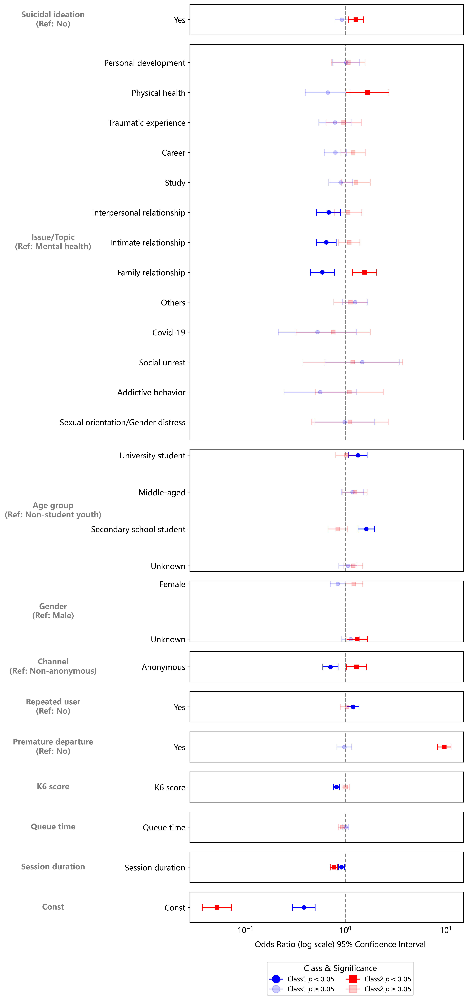

In [645]:
from matplotlib.lines import Line2D

conf_plot['class'] = conf_plot['class'].astype('int')
# Ensure that the dataset is sorted by `variable_group` and `class`
df = conf_plot.sort_values(by=['variable_group', 'class'])

# Define the desired order for the plot blocks
'''
desired_order = ['Suicidal ideation\n(Ref: No)', 'Issue/Topic\n(Ref: 精神健康)', 'Age group\n(Ref: 非學生的青年人)', 'Gender\n(Ref: 男)',
                 'Channel\n(Ref: Non-web)', 'Repeated user\n(Ref: No)', 'Premature departure\n(Ref: No)', 
                 'K6 score', 'Queue time', 'Session duration',  'Const'] #'Perceived helpfulness\n(Ref: 不知道)',
'''

desired_order = ['Suicidal ideation\n(Ref: No)', 'Issue/Topic\n(Ref: Mental health)', 'Age group\n(Ref: Non-student youth)', 'Gender\n(Ref: Male)',
                 'Channel\n(Ref: Non-anonymous)', 'Repeated user\n(Ref: No)', 'Premature departure\n(Ref: No)', 
                 'K6 score', 'Queue time', 'Session duration',  'Const'] #'Perceived helpfulness\n(Ref: 不知道)',

# Ensure that the variable_group follows the desired order
df['variable_group'] = pd.Categorical(df['variable_group'], categories=desired_order, ordered=True)
df = df.sort_values(by=['variable_group', 'class'])  # Sort by the desired order and class

# Dynamically calculate heights based on the number of variables in each group
heights = [len(df[df['variable_group'] == group]) * 0.4 for group in desired_order]

# Initialize the plot with dynamic heights
fig, axes = plt.subplots(nrows=len(desired_order), ncols=1, figsize=(12, sum(heights)), 
                         gridspec_kw={'height_ratios': heights}, sharex=True)

# Define markers and colors for each class
markers = {1: 'o', 2: 's'}  # Circle for Class 1, Square for Class 2
colors = {1: 'blue', 2: 'red'}

# Plot the data for each variable group
for ax, (group, group_data) in zip(axes, df.groupby('variable_group')):
    y_pos = []
    labels = []
    current_y = 0

    # Plot each unique variable within the group
    unique_variables = group_data['variable'].unique()
    for variable in unique_variables:
        variable_data = group_data[group_data['variable'] == variable]

        # Ensure y-ticks and labels are only set once per unique variable
        labels.append(variable)
        y_pos.append(current_y)
        
        for _, row in variable_data.iterrows():
            class_label = row['class']
            lower_error = row['OR'] - np.exp(row['2.5%'])
            upper_error = np.exp(row['97.5%']) - row['OR']
            xerr = [lower_error, upper_error]
            alpha = 1.0 if row['p'] <= 0.05 else 0.2
            
            # Plot the odds ratio
            ax.errorbar(row['OR'], current_y, xerr=[[lower_error], [upper_error]], fmt=markers[class_label], 
                        color=colors[class_label], alpha=alpha, capsize=5)
        
        current_y += 1
    
    # Set y-ticks and labels
    ax.set_yticks(y_pos)
    ax.set_yticklabels(labels, fontsize=12)
    
    # only remove xticks
    ax.xaxis.set_ticks_position('none') #ax.xaxis.set_visible(False) remove both xticks and xlabels
    
    # Add the group label on the left side, aligning it properly
    ax.text(-0.5, np.mean(y_pos), group, va='center', ha='center', fontsize=12, color='gray', fontweight='bold',
            transform=ax.get_yaxis_transform(), clip_on=False)
    
    # Add a vertical line at OR = 1 for reference
    ax.axvline(x=1, color='gray', linestyle='--')

# Set x-axis to log scale
axes[-1].set_xlabel('Odds Ratio (log scale) 95% Confidence Interval', fontsize=12)
axes[-1].xaxis.set_label_coords(.55, -.6)

# Define the custom legend markers with lines
custom_lines = [
    Line2D([0], [1], marker='o', color='blue', linestyle='-', markersize=12, label='Class1 $p < 0.05$'),
    Line2D([0], [1], marker='o', color='blue', linestyle='-', markersize=12, label='Class1 $p \geq 0.05$', alpha=0.2),
    Line2D([0], [1], marker='s', color='red', linestyle='-', markersize=12, label='Class2 $p < 0.05$'),
    Line2D([0], [1], marker='s', color='red', linestyle='-', markersize=12, label='Class2 $p \geq 0.05$', alpha=0.2)
]

# Place the legend with "Class & Significance"
plt.legend(handles=custom_lines, title='Class & Significance', loc='lower center', bbox_to_anchor=(.55, -2.5), ncol=2, frameon=True, fontsize=10, title_fontsize=12)

plt.xscale('log')

plt.xticks(fontsize=12)

plt.tight_layout()
plt.show()

# data descriptives

In [521]:
# dataset used for calculate descriptives
df_reg_des

,conversationId,class,k6,chat_duration,waiting_time,issue_category,suicidal_ideation,gender,age_group,premature_departure,channel,repeated_user
0,000000c7-0b79-4a6f-aecd-895fb97aaca7,1,13.0,34.0,8.0,1,2,女,中學生,0,web,False
1,00062144-d067-49e6-b674-5af3b9aadfd9,3,14.0,53.0,4.0,2,2,女,不知道,0,web,True
2,001ffc47-49fd-4751-ab78-6fa7e00758bf,3,17.0,46.0,10.0,5,2,不知道,中學生,0,web,False
3,00258ce1-38d2-40f3-8f26-2d83bdc4a1c8,3,14.0,58.0,47.0,1,2,女,中學生,0,web,False
4,0025963d-8eb6-4977-ae2c-d3bb57efce21,3,19.0,33.0,33.0,14,2,女,非學生的青年人,0,web,True
...,...,...,...,...,...,...,...,...,...,...,...,...
6202,ffc936c5-aed6-49bf-9f5b-7f2dbc281c2b,1,14.0,68.0,11.0,1,2,不知道,中學生,0,non-web,False
6203,ffdc786a-f945-4565-a91b-06994285d88e,1,12.0,63.0,5.0,9,2,不知道,非學生的青年人,0,web,False
6204,ffdd2d57-daa5-4172-bc6b-72671bb529f1,3,15.0,63.0,23.0,14,2,不知道,非學生的青年人,1,non-web,False
6205,fff8f2ce-e50c-4946-9648-db5f0756df45,3,18.0,67.0,11.0,5,2,女,中學生,1,web,True


In [419]:
df_reg_des.columns

Index(['conversationId', 'class', 'k6', 'chat_duration', 'waiting_time',
       'issue_category', 'suicidal_ideation', 'gender', 'age_group',
       'premature_departure', 'channel', 'repeated_user'],
      dtype='object')

conf_replace_tag = {'const':'Const', 'k6':'K6 score', 'chat_duration':'Session duration', 'waiting_time':'Queue time', 'issue_category_1':'Mental health', 'issue_category_2':'Family relationship', 'issue_category_3':'Intimate relationship', 'issue_category_4':'Interpersonal relationship', 'issue_category_5':'Study', 'issue_category_6':'Career', 'issue_category_7':'Traumatic experience', 'issue_category_8':'Physical health', 'issue_category_9':'Personal development', 'issue_category_10':'Sexual orientation/Gender distress', 'issue_category_11':'Addictive behavior', 'issue_category_12':'Social movement', 'issue_category_13':'COVID-19', 'issue_category_14':'Others',
                   'suicidal_ideation_1':'Yes', 'gender_不知道':'Unknown', 'gender_男':'Male', 'gender_女':'Female',
                   'age_group_不知道':'Unknown', 'age_group_中學生':'Secondary school student', 'age_group_中年人':'Middle-aged', 'age_group_大學生':'University student', 'age_group_其他':'Others',
                   'premature_departure_1':'Yes', 'channel_web':'Web', 'repeated_user_True':'Yes',
                   'helpfulness_有一些幫助':'Somewhat helpful', 'helpfulness_有幾大幫助':'Extremely helpful', 'helpfulness_有很小幫助':'A little helpful', 'helpfulness_毫無幫助':'Not helpful at all', 'helpfulness_非常有幫助':'Quite helpful'}
conf_plot['variable'] = conf_plot['variable'].replace(conf_replace_tag)
conf_plot

In [618]:
for col in df_reg_des.columns:
    if col in ['issue_category', 'suicidal_ideation', 'gender', 'age_group', 'premature_departure', 'channel', 'repeated_user']:
        print('columns name (%s): '%(col))
        print(df_reg_des[col].value_counts())
        print((round(df_reg_des[col].value_counts()/6207, 3))*100)
        print('>>>>>>>>>>>>>>>>>>>>>>>>')
        
    elif col in ['k6', 'chat_duration', 'waiting_time']:
        print('columns name (%s): '%(col))
        print('mean: %s'%(round(df_reg_des[col].describe()['mean'], 2)))
        print('std: %s'%(round(df_reg_des[col].describe()['std'], 2)))
        print('>>>>>>>>>>>>>>>>>>>>>>>>')

columns name (k6): 
mean: 14.53
std: 4.61
>>>>>>>>>>>>>>>>>>>>>>>>
columns name (chat_duration): 
mean: 63.31
std: 30.89
>>>>>>>>>>>>>>>>>>>>>>>>
columns name (waiting_time): 
mean: 13.04
std: 14.71
>>>>>>>>>>>>>>>>>>>>>>>>
columns name (issue_category): 
1     1965
3      953
6      640
2      564
4      475
5      434
14     325
9      303
7      237
8      132
10      53
11      53
13      44
12      29
Name: issue_category, dtype: int64
1     31.7
3     15.4
6     10.3
2      9.1
4      7.7
5      7.0
14     5.2
9      4.9
7      3.8
8      2.1
10     0.9
11     0.9
13     0.7
12     0.5
Name: issue_category, dtype: float64
>>>>>>>>>>>>>>>>>>>>>>>>
columns name (suicidal_ideation): 
2    4084
1    2123
Name: suicidal_ideation, dtype: int64
2    65.8
1    34.2
Name: suicidal_ideation, dtype: float64
>>>>>>>>>>>>>>>>>>>>>>>>
columns name (gender): 
女      3460
不知道    1442
男      1305
Name: gender, dtype: int64
女      55.7
不知道    23.2
男      21.0
Name: gender, dtype: float64
>>>>>>>>>

# multinomial logistic regression (only with baseline variables)

In [421]:
df_reg_des1 = df_reg_des[['class', 'k6', 'waiting_time', 'issue_category', 'suicidal_ideation', 'gender', 'age_group', 'channel', 'repeated_user']]

In [422]:
df_reg_des1 = pd.get_dummies(df_reg_des1, columns=['issue_category', 'suicidal_ideation', 'gender', 'age_group', 
                                              'channel', 'repeated_user'])
#, 'helpfulness'
# Optional: Standardize continuous variables
df_reg_des1['k6'] = (df_reg_des1['k6'] - df_reg_des1['k6'].mean()) / df_reg['k6'].std()
df_reg_des1['waiting_time'] = (df_reg_des1['waiting_time'] - df_reg_des1['waiting_time'].mean()) / df_reg_des1['waiting_time'].std()
df_reg_des1

,class,k6,waiting_time,issue_category_1,issue_category_10,issue_category_11,issue_category_12,issue_category_13,issue_category_14,issue_category_2,issue_category_3,issue_category_4,issue_category_5,issue_category_6,issue_category_7,issue_category_8,issue_category_9,suicidal_ideation_1,suicidal_ideation_2,gender_不知道,gender_女,gender_男,age_group_不知道,age_group_中學生,age_group_中年人,age_group_大學生,age_group_非學生的青年人,channel_non-web,channel_web,repeated_user_False,repeated_user_True
0,1,-1.530401,-0.342423,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,0,0,1,1,0
1,3,-0.530401,-0.614416,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,1,0,0,0,0,0,1,0,1
2,3,2.469599,-0.206427,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,1,0,0,1,0,0,0,0,0,1,1,0
3,3,-0.530401,2.309508,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,1,0,0,0,0,0,1,1,0
4,3,4.469599,1.357532,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,1,0,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6202,1,-0.530401,-0.138428,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,1,0,0,0,0,1,0,1,0
6203,1,-2.530401,-0.546418,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,1,0,1,1,0
6204,3,0.469599,0.677550,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,1,1,0,1,0
6205,3,3.469599,-0.138428,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,0,1,0,0,0,0,1,0,1


In [423]:
df_reg_des1 = df_reg_des1.drop(columns=[
    'issue_category_1', 'suicidal_ideation_2', 'gender_男', 'age_group_非學生的青年人', 
    'channel_non-web', 'repeated_user_False'
]) # 'helpfulness_不知道'

In [424]:
# Reorder the 'class' variable to make the third class the reference
df_reg_des1['class'] = df_reg_des1['class'].astype('category')
df_reg_des1['class'] = df_reg_des1['class'].cat.reorder_categories([3, 1, 2], ordered=True)

In [425]:
# Fit the multinomial logistic regression model
y = df_reg_des1['class']  # Dependent variable: trajectory class
X = df_reg_des1[['k6', 'waiting_time',
       'issue_category_10', 'issue_category_11', 'issue_category_2',
       'issue_category_3', 'issue_category_4', 'issue_category_5',
       'issue_category_6', 'issue_category_7', 'issue_category_8',
       'issue_category_9', 'suicidal_ideation_1', 'gender_不知道', 'gender_女',
       'age_group_不知道', 'age_group_中學生', 'age_group_中年人', 'age_group_大學生',
       'channel_web', 'repeated_user_True'
       ]]  # Independent variables: replace with your variables 'helpfulness_有一些幫助', 'helpfulness_有幾大幫助', 'helpfulness_有很小幫助', 'helpfulness_毫無幫助', 'helpfulness_非常有幫助'
X = sm.add_constant(X)  # Add constant to the model

In [ ]:
# Fit the model
model_des = sm.MNLogit(y, X)
result_des = model_des.fit(alpha=0.05)

# Print the summary
print(result_des.summary())

Optimization terminated successfully.
         Current function value: 0.892921
         Iterations 5
                          MNLogit Regression Results                          
Dep. Variable:                  class   No. Observations:                 6207
Model:                        MNLogit   Df Residuals:                     6163
Method:                           MLE   Df Model:                           42
Date:                Sat, 25 Jan 2025   Pseudo R-squ.:                 0.02309
Time:                        16:49:58   Log-Likelihood:                -5542.4
converged:                       True   LL-Null:                       -5673.3
Covariance Type:            nonrobust   LLR p-value:                 1.406e-33
            class=1       coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                  -0.9506      0.132     -7.202      0.000      -1.209      -0.692
k6

In [427]:
# Extracting the coefficients and confidence intervals
params_des = result_des.params
conf_des = result_des.conf_int()
p_values_des = result_des.pvalues  # Get p-values from the model

# Compute the odds ratios (exponentiate the coefficients)
odds_ratios_des = np.exp(params_des)

# Rename the confidence intervals columns
conf_des.columns = ['2.5%', '97.5%']

conf_des

2.5%     97.5%
class                                       
1     const              -1.209304 -0.691925
      k6                 -0.062299 -0.031703
      waiting_time       -0.058250  0.071041
      issue_category_10  -0.757479  0.605659
      issue_category_11  -1.417120  0.239945
...                            ...       ...
2     age_group_中學生      -0.150697  0.279911
      age_group_中年人      -0.043360  0.488292
      age_group_大學生      -0.184102  0.301506
      channel_web         0.061299  0.474607
      repeated_user_True  0.023338  0.300051

[44 rows x 2 columns]

In [428]:
conf_des['OR'] = odds_ratios_des[0].tolist()+odds_ratios_des[1].tolist()
conf_des['p'] = p_values_des[0].tolist()+p_values_des[1].tolist()
conf_des

2.5%     97.5%        OR             p
class                                                               
1     const              -1.209304 -0.691925  0.386504  5.919082e-13
      k6                 -0.062299 -0.031703  0.954086  1.725602e-09
      waiting_time       -0.058250  0.071041  1.006416  8.462558e-01
      issue_category_10  -0.757479  0.605659  0.926900  8.272016e-01
      issue_category_11  -1.417120  0.239945  0.555111  1.638153e-01
...                            ...       ...       ...           ...
2     age_group_中學生      -0.150697  0.279911  1.066740  5.564416e-01
      age_group_中年人      -0.043360  0.488292  1.249153  1.009500e-01
      age_group_大學生      -0.184102  0.301506  1.060459  6.356047e-01
      channel_web         0.061299  0.474607  1.307285  1.104285e-02
      repeated_user_True  0.023338  0.300051  1.175501  2.198860e-02

[44 rows x 4 columns]

In [429]:
conf_plot_des = conf_des.copy()
conf_plot_des.reset_index(inplace=True, drop=False)
conf_plot_des.columns = ['class', 'variable', '2.5%', '97.5%', 'OR', 'p']
conf_plot_des

,class,variable,2.5%,97.5%,OR,p
0,1,const,-1.209304,-0.691925,0.386504,5.919082e-13
1,1,k6,-0.062299,-0.031703,0.954086,1.725602e-09
2,1,waiting_time,-0.058250,0.071041,1.006416,8.462558e-01
3,1,issue_category_10,-0.757479,0.605659,0.926900,8.272016e-01
4,1,issue_category_11,-1.417120,0.239945,0.555111,1.638153e-01
...,...,...,...,...,...,...
39,2,age_group_中學生,-0.150697,0.279911,1.066740,5.564416e-01
40,2,age_group_中年人,-0.043360,0.488292,1.249153,1.009500e-01
41,2,age_group_大學生,-0.184102,0.301506,1.060459,6.356047e-01
42,2,channel_web,0.061299,0.474607,1.307285,1.104285e-02


In [430]:
conf_plot_des['variable_group'] = ['Const', 'K6 score', 'Queue time']+['Issue/Topic\n(Ref: Mental health)']*10+['Suicidal ideation\n(Ref: No)']+['Gender\n(Ref: Male)']*2+['Age group\n(Ref: Non-student youth)']*4+['Channel\n(Ref: Non-web)', 'Repeated user\n(Ref: No)']+['Const', 'K6 score', 'Queue time']+['Issue/Topic\n(Ref: Mental health)']*10+['Suicidal ideation\n(Ref: No)']+['Gender\n(Ref: Male)']*2+['Age group\n(Ref: Non-student youth)']*4+['Channel\n(Ref: Non-web)', 'Repeated user\n(Ref: No)']
#+['Perceived helpfulness\n(Ref: Unknown)']*5

In [431]:
conf_replace_tag = {'const':'Const', 'k6':'K6 score', 'chat_duration':'Session duration', 'waiting_time':'Queue time', 'issue_category_1':'Mental health', 'issue_category_2':'Family relationship', 'issue_category_3':'Intimate relationship', 'issue_category_4':'Interpersonal relationship', 'issue_category_5':'Study', 'issue_category_6':'Career', 'issue_category_7':'Traumatic experience', 'issue_category_8':'Physical health', 'issue_category_9':'Personal development', 'issue_category_10':'Sexual orientation/Gender distress', 'issue_category_11':'Addictive behavior', 'issue_category_12':'Social incidents', 'issue_category_13':'COVID-19', 'issue_category_14':'Others',
                   'suicidal_ideation_1':'Yes', 'gender_不知道':'Unknown', 'gender_男':'Male', 'gender_女':'Female',
                   'age_group_不知道':'Unknown', 'age_group_中學生':'Secondary school student', 'age_group_中年人':'Middle-aged', 'age_group_大學生':'University student',
                   'premature_departure_1':'Yes', 'channel_web':'Web', 'repeated_user_True':'Yes',
                   'helpfulness_有一些幫助':'Somewhat helpful', 'helpfulness_有幾大幫助':'Extremely helpful', 'helpfulness_有很小幫助':'A little helpful', 'helpfulness_毫無幫助':'Not helpful at all', 'helpfulness_非常有幫助':'Quite helpful'}
conf_plot['variable'] = conf_plot['variable'].replace(conf_replace_tag)
conf_plot

NameError: name 'conf_plot' is not defined

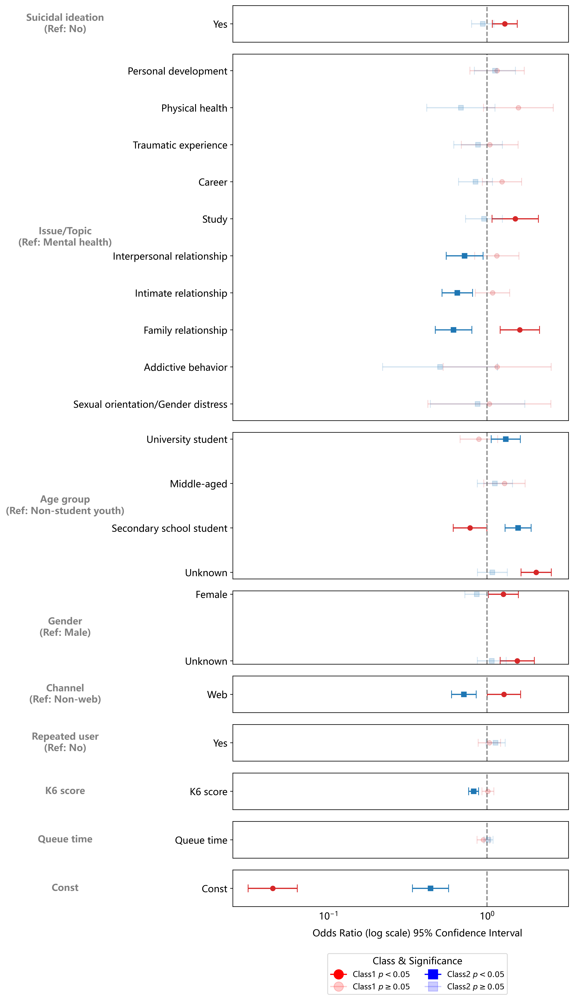

In [464]:
from matplotlib.lines import Line2D

conf_plot['class'] = conf_plot['class'].astype('int')
# Ensure that the dataset is sorted by `variable_group` and `class`
df = conf_plot.sort_values(by=['variable_group', 'class'])

# Define the desired order for the plot blocks
'''
desired_order = ['Suicidal ideation\n(Ref: No)', 'Issue/Topic\n(Ref: 精神健康)', 'Age group\n(Ref: 非學生的青年人)', 'Gender\n(Ref: 男)',
                 'Channel\n(Ref: Non-web)', 'Repeated user\n(Ref: No)', 'Premature departure\n(Ref: No)', 
                 'K6 score', 'Queue time', 'Session duration',  'Const'] #'Perceived helpfulness\n(Ref: 不知道)',
'''

desired_order = ['Suicidal ideation\n(Ref: No)', 'Issue/Topic\n(Ref: Mental health)', 'Age group\n(Ref: Non-student youth)', 'Gender\n(Ref: Male)',
                 'Channel\n(Ref: Non-web)', 'Repeated user\n(Ref: No)',
                 'K6 score', 'Queue time', 'Const'] #'Perceived helpfulness\n(Ref: 不知道)',

# Ensure that the variable_group follows the desired order
df['variable_group'] = pd.Categorical(df['variable_group'], categories=desired_order, ordered=True)
df = df.sort_values(by=['variable_group', 'class'])  # Sort by the desired order and class

# Dynamically calculate heights based on the number of variables in each group
heights = [len(df[df['variable_group'] == group]) * 0.4 for group in desired_order]

# Initialize the plot with dynamic heights
fig, axes = plt.subplots(nrows=len(desired_order), ncols=1, figsize=(12, sum(heights)), 
                         gridspec_kw={'height_ratios': heights}, sharex=True)

# Define markers and colors for each class
markers = {1: 'o', 2: 's'}  # Circle for Class 1, Square for Class 2
colors = {1: colormap(6), 2: colormap(0)}

# Plot the data for each variable group
for ax, (group, group_data) in zip(axes, df.groupby('variable_group')):
    y_pos = []
    labels = []
    current_y = 0

    # Plot each unique variable within the group
    unique_variables = group_data['variable'].unique()
    for variable in unique_variables:
        variable_data = group_data[group_data['variable'] == variable]

        # Ensure y-ticks and labels are only set once per unique variable
        labels.append(variable)
        y_pos.append(current_y)
        
        for _, row in variable_data.iterrows():
            class_label = row['class']
            lower_error = row['OR'] - np.exp(row['2.5%'])
            upper_error = np.exp(row['97.5%']) - row['OR']
            xerr = [lower_error, upper_error]
            alpha = 1.0 if row['p'] <= 0.05 else 0.2
            
            # Plot the odds ratio
            ax.errorbar(row['OR'], current_y, xerr=[[lower_error], [upper_error]], fmt=markers[class_label], 
                        color=colors[class_label], alpha=alpha, capsize=5)
        
        current_y += 1
    
    # Set y-ticks and labels
    ax.set_yticks(y_pos)
    ax.set_yticklabels(labels, fontsize=12)
    
    # only remove xticks
    ax.xaxis.set_ticks_position('none') #ax.xaxis.set_visible(False) remove both xticks and xlabels
    
    # Add the group label on the left side, aligning it properly
    ax.text(-0.5, np.mean(y_pos), group, va='center', ha='center', fontsize=12, color='gray', fontweight='bold',
            transform=ax.get_yaxis_transform(), clip_on=False)
    
    # Add a vertical line at OR = 1 for reference
    ax.axvline(x=1, color='gray', linestyle='--')

# Set x-axis to log scale
axes[-1].set_xlabel('Odds Ratio (log scale) 95% Confidence Interval', fontsize=12)
axes[-1].xaxis.set_label_coords(.55, -.6)

# Define the custom legend markers with lines
custom_lines = [
    Line2D([0], [1], marker='o', color='red', linestyle='-', markersize=12, label='Class1 $p < 0.05$'),
    Line2D([0], [1], marker='o', color='red', linestyle='-', markersize=12, label='Class1 $p \geq 0.05$', alpha=0.2),
    Line2D([0], [1], marker='s', color='blue', linestyle='-', markersize=12, label='Class2 $p < 0.05$'),
    Line2D([0], [1], marker='s', color='blue', linestyle='-', markersize=12, label='Class2 $p \geq 0.05$', alpha=0.2)
]

# Place the legend with "Class & Significance"
plt.legend(handles=custom_lines, title='Class & Significance', loc='lower center', bbox_to_anchor=(.55, -2.5), ncol=2, frameon=True, fontsize=10, title_fontsize=12)

plt.xscale('log')

plt.xticks(fontsize=12)

plt.tight_layout()
plt.show()